# Sleep EDFX (Extended) Dataset: Exploratory Data Analysis

### Tasks included:
- Reading and organising annotations from the edf+ file
- Reading and exploring edf (data file)
- Saving annotations in csv
- Calculate transition matrices

## Imports and system info

In [7]:
import HumachLab_Global 
HumachLab_Global.get_system_info()


List of OS platforms and codes
___________________________________________
0 Darwin
1 Windows
2 Linux
===> "1 - Windows" OS is detected.

Processor (CPU) details: 
___________________________________________
{'python_version': '3.7.10.final.0 (64 bit)', 'cpuinfo_version': [8, 0, 0], 'cpuinfo_version_string': '8.0.0', 'arch': 'X86_64', 'bits': 64, 'count': 40, 'arch_string_raw': 'AMD64', 'vendor_id_raw': 'GenuineIntel', 'brand_raw': 'Intel(R) Xeon(R) CPU E5-2630 v4 @ 2.20GHz', 'hz_advertised_friendly': '2.2000 GHz', 'hz_actual_friendly': '2.2010 GHz', 'hz_advertised': [2200000000, 0], 'hz_actual': [2201000000, 0], 'l2_cache_size': 2621440, 'stepping': 1, 'model': 79, 'family': 6, 'l3_cache_size': 26214400, 'flags': ['3dnow', '3dnowprefetch', 'abm', 'acpi', 'adx', 'aes', 'apic', 'avx', 'avx2', 'bmi1', 'bmi2', 'clflush', 'cmov', 'cx16', 'cx8', 'dca', 'de', 'ds_cpl', 'dtes64', 'dts', 'erms', 'est', 'f16c', 'fma', 'fpu', 'fxsr', 'hle', 'ht', 'ia64', 'intel_pt', 'invpcid', 'lahf_lm', 'mca',

(1,
 'Windows',
 {'brand_raw': 'Intel(R) Xeon(R) CPU E5-2630 v4 @ 2.20GHz',
  'arch_string_raw': 'AMD64',
  'arch': 'X86_64',
  'count': 40,
  'python_version': '3.7.10.final.0 (64 bit)',
  'CPU_usage': 16.6,
  'RAM_usage': 67.9,
  'Total_RAM': 127.9,
  'Used_RAM': 86.8,
  'Available_RAM': 41.1},
 [1, 2, 3, 4, 5, 6],
 1)

In [8]:
'''
Importing necessary modules
'''

import os
import sys
import datetime

print(os.getcwd())
os.chdir(os.getcwd())
print(f"{os.getcwd()}\HumachLab")
sys.path.append(f"{os.getcwd()}\HumachLab")
sys.path.insert(0, os.path.abspath('./HumachLab'))

import re
import pickle
import json

import copy
from pprint import pprint

import glob

import math
import numbers

import numpy as np
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
from matplotlib import rc, rcParams
%matplotlib inline
import seaborn as sns

import HumachLab_Global
from HumachLab import * 
# from HumachLab.HumachLab_Global import *
# import HumachLab_Global
HumachLab_Global.get_system_info()

import mne

# plt.rcParams["figure.figsize"] = plt.rcParamsDefault["figure.figsize"]
plt.rcParams["figure.figsize"] = (20,6)

C:\Users\aliem\OneDrive - Deakin University\_MyResearch\PhD_Research\HML_IHC_Sleep_Data_Analysis
C:\Users\aliem\OneDrive - Deakin University\_MyResearch\PhD_Research\HML_IHC_Sleep_Data_Analysis\HumachLab

List of OS platforms and codes
___________________________________________
0 Darwin
1 Windows
2 Linux
===> "1 - Windows" OS is detected.

Processor (CPU) details: 
___________________________________________
{'python_version': '3.7.10.final.0 (64 bit)', 'cpuinfo_version': [8, 0, 0], 'cpuinfo_version_string': '8.0.0', 'arch': 'X86_64', 'bits': 64, 'count': 40, 'arch_string_raw': 'AMD64', 'vendor_id_raw': 'GenuineIntel', 'brand_raw': 'Intel(R) Xeon(R) CPU E5-2630 v4 @ 2.20GHz', 'hz_advertised_friendly': '2.2000 GHz', 'hz_actual_friendly': '2.2010 GHz', 'hz_advertised': [2200000000, 0], 'hz_actual': [2201000000, 0], 'l2_cache_size': 2621440, 'stepping': 1, 'model': 79, 'family': 6, 'l3_cache_size': 26214400, 'flags': ['3dnow', '3dnowprefetch', 'abm', 'acpi', 'adx', 'aes', 'apic', 'avx', 

## Get directory list

In [9]:
'''
Explore the contents/files in the directory
'''

def get_list_of_paths_from_a_directory(directory, path_type=None, containes=None, extension=None, exclude=None):
    '''
    directory: valid path string, path_type: p_file|p_dir, containes: string, extension: valid string file extension 
    '''
    os_path = os.path
    list_of_paths = []
        
    path_keywords = "*"
    if containes:
        path_keywords = f"{path_keywords}{containes}*"
    
    if extension:
        path_keywords = f"{path_keywords}.{extension}"
        
    complete_path = f"{directory}/{path_keywords}"
    print(f"============> {path_keywords}, {path_type}, {complete_path}")
    
    all_paths = glob.glob(complete_path) 
    all_temp_paths = None
    list_of_paths = None
    
    if path_type:
        if path_type=="p_file":
            all_temp_paths = [path.replace("\\", "/") for path in all_paths if (os_path.exists(path) and os_path.isfile(path))]
        if path_type=="p_dir":
            all_temp_paths = [path.replace("\\", "/") for path in all_paths if (os_path.exists(path) and os_path.isdir(path))]   
    else:
        all_temp_paths = [path.replace("\\", "/") for path in all_paths]
        
    if exclude:
        # print(all_temp_paths)
        # print(len(all_temp_paths), exclude)
        # list_of_paths = [path for path in all_temp_paths for ex in exclude if ex not in path]
        # list_of_paths = [path for ex in exclude for path in all_temp_paths if ex not in path]
        list_of_paths = [path for path in all_temp_paths if not any((ex in path) for ex in exclude)]
        # list_of_paths = [path for ex in exclude if any(ex not in path for path in all_temp_paths)]
        # any(substring in string for substring in substring_list)
        # print(len(list_of_paths))
    else:
        list_of_paths = all_temp_paths.copy()
    
    return list_of_paths

In [104]:
dataset_directory = "D:/aliem/Sleep_EDFX_Dataset" 
prob_cal_from_all = True 
result_subdirectory = ['STP_From_Same_Stages', 'STP_From_All_Stages'][int(prob_cal_from_all)]
result_directory = f"./Results/Sleep_EDFX/{result_subdirectory}"
dataset_subdirectory = ["sleep-cassette", "sleep-telemetry"] 
trimW_states = True #run the normal or the trim version of W->W for leading/trailing W->W sequences 
exclude_contents_in_dataset_directory = ["SHA256SUMS", "RECORDS"]
exclude_contents_in_result_directory = ["SHA256SUMS", "RECORDS", "all_annotations", "annot_sequence", "transition_sequence", "hypno", "DATASET_CHANGELOG", "Demography"]
sleep_stage_labels = ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
sleep_stage_labels_dict = {'W':0, 'S1':1, 'S2':2, 'S3':3, 'S4':4, 'REM':5}
sleep_stage_names_dict = {'W':0, 'S1':1, 'S2':2, 'S3':3, 'S4':4, 'R':5}
list_of_paths = None 
tran_step = 3 

directory = dataset_directory
# list_of_paths = get_list_of_paths_from_a_directory(directory, path_type=None, containes=None, extension=None, exclude=None) 
# list_of_paths = get_list_of_paths_from_a_directory(directory, path_type="p_file", containes=None, extension=None, exclude=None) 
# list_of_paths = get_list_of_paths_from_a_directory(directory, path_type="p_dir", containes=None, extension=None, exclude=None) 
# list_of_paths = get_list_of_paths_from_a_directory(directory, path_type=None, containes="nfle", extension=None, exclude=None) 
# list_of_paths = get_list_of_paths_from_a_directory(directory, path_type=None, containes=None, extension="edf", exclude=None) 
list_of_paths = get_list_of_paths_from_a_directory(directory, path_type=None, containes=None, extension=None, exclude=exclude_contents_in_dataset_directory) 
# list_of_paths = get_list_of_paths_from_a_directory(directory, path_type=None, containes=None, extension=None, exclude=None) 
# pprint(list_of_paths)
list_of_paths

============> *, None, D:/aliem/Sleep_EDFX_Dataset/*


['D:/aliem/Sleep_EDFX_Dataset/Demography-2.csv',
 'D:/aliem/Sleep_EDFX_Dataset/Demography.csv',
 'D:/aliem/Sleep_EDFX_Dataset/Demography_Details.csv',
 'D:/aliem/Sleep_EDFX_Dataset/SC-subjects.csv',
 'D:/aliem/Sleep_EDFX_Dataset/SC-subjects.xls',
 'D:/aliem/Sleep_EDFX_Dataset/sleep-cassette',
 'D:/aliem/Sleep_EDFX_Dataset/sleep-telemetry',
 'D:/aliem/Sleep_EDFX_Dataset/ST-subjects.csv',
 'D:/aliem/Sleep_EDFX_Dataset/ST-subjects.xls']

## Sample data exploration

### Explore data EDF

In [520]:
'''
The EOG and EEG signals were each sampled at 100 Hz.
''' 

# list_of_edfs = []
# # directory = []

# for sub in dataset_subdirectory:
#     directory = f"{dataset_directory}/{sub}"
#     tmp_dir = get_list_of_paths_from_a_directory(directory, path_type=None, containes="PSG", extension="edf", exclude=exclude_contents_in_dataset_directory) 
#     list_of_edfs += tmp_dir
# list_of_edfs

'\nThe EOG and EEG signals were each sampled at 100 Hz.\n'

In [119]:
# test_edf = list_of_edfs[0]
# raw_signal_data = mne.io.read_raw_edf(test_edf)
# raw_signal_data

In [120]:
# raw_signal_data_info = raw_signal_data.__dict__
# raw_signal_data_info

In [121]:
# edf_signal_df = raw_signal_data.to_data_frame()
# edf_signal_df

### Explore annotation EDF: Convert and save edf annotation to csv

***
##### Changes made in the dataset
- None
***

In [46]:
list_of_annot_edfs = []
# directory = []

for sub in dataset_subdirectory:
    directory = f"{dataset_directory}/{sub}"
    tmp_dir = get_list_of_paths_from_a_directory(directory, path_type=None, containes="Hypnogram", extension="edf", exclude=exclude_contents_in_dataset_directory) 
    list_of_annot_edfs += tmp_dir
list_of_annot_edfs

============> *Hypnogram*.edf, None, D:/aliem/Sleep_EDFX_Dataset/sleep-cassette/*Hypnogram*.edf
============> *Hypnogram*.edf, None, D:/aliem/Sleep_EDFX_Dataset/sleep-telemetry/*Hypnogram*.edf


['D:/aliem/Sleep_EDFX_Dataset/sleep-cassette/SC4001EC-Hypnogram.edf',
 'D:/aliem/Sleep_EDFX_Dataset/sleep-cassette/SC4002EC-Hypnogram.edf',
 'D:/aliem/Sleep_EDFX_Dataset/sleep-cassette/SC4011EH-Hypnogram.edf',
 'D:/aliem/Sleep_EDFX_Dataset/sleep-cassette/SC4012EC-Hypnogram.edf',
 'D:/aliem/Sleep_EDFX_Dataset/sleep-cassette/SC4021EH-Hypnogram.edf',
 'D:/aliem/Sleep_EDFX_Dataset/sleep-cassette/SC4022EJ-Hypnogram.edf',
 'D:/aliem/Sleep_EDFX_Dataset/sleep-cassette/SC4031EC-Hypnogram.edf',
 'D:/aliem/Sleep_EDFX_Dataset/sleep-cassette/SC4032EP-Hypnogram.edf',
 'D:/aliem/Sleep_EDFX_Dataset/sleep-cassette/SC4041EC-Hypnogram.edf',
 'D:/aliem/Sleep_EDFX_Dataset/sleep-cassette/SC4042EC-Hypnogram.edf',
 'D:/aliem/Sleep_EDFX_Dataset/sleep-cassette/SC4051EC-Hypnogram.edf',
 'D:/aliem/Sleep_EDFX_Dataset/sleep-cassette/SC4052EC-Hypnogram.edf',
 'D:/aliem/Sleep_EDFX_Dataset/sleep-cassette/SC4061EC-Hypnogram.edf',
 'D:/aliem/Sleep_EDFX_Dataset/sleep-cassette/SC4062EC-Hypnogram.edf',
 'D:/aliem/Sleep_EDF

In [47]:
list_of_annot_edfs[0]

'D:/aliem/Sleep_EDFX_Dataset/sleep-cassette/SC4001EC-Hypnogram.edf'

In [11]:
def parse_annotation_from_EDF_to_CSV(annot_edf, annot_directory, extras=False, remove_unscored=True):
    print(f"Annotation conversion for file: {annot_edf} \n")
    
    raw_annot_data = mne.read_annotations(annot_edf)
    
    data = {"Sleep_Stage": [d.split(" ")[-1] for d in raw_annot_data.description.tolist()], "onset": raw_annot_data.onset.tolist(), "Duration": raw_annot_data.duration.tolist()}
    edf_annot_df = pd.DataFrame.from_dict(data)
    
    if remove_unscored:
        edf_annot_df = edf_annot_df[(edf_annot_df["Sleep_Stage"]!='?')]
    
    edf_annot_df["Event_Type"] = edf_annot_df["Sleep_Stage"]
    edf_annot_df = edf_annot_df.replace({'Event_Type': {'?': 'Unknown', 'time':'SLEEP', 'W':'SLEEP', '1':'SLEEP', '2':'SLEEP', '3':'SLEEP', '4':'SLEEP', 'R':'SLEEP'}})    
    edf_annot_df["Event_Level"] = edf_annot_df["Sleep_Stage"]
    edf_annot_df = edf_annot_df.replace({'Event_Level': {'?': 'Unknown', 'time':'S0', 'W':'S0', '1':'S1', '2':'S2', '3':'S3', '4':'S4', 'R':'REM'}})
    # ### considered unknown state '?' means 'W' state and 'time' means 'W'
    edf_annot_df = edf_annot_df.replace({"Sleep_Stage": {'?': 'W', 'time':'W', '1':'S1', '2':'S2', '3':'S3', '4':'S4', 'R':'R'}}) 
    edf_annot_df["Event"] = edf_annot_df["Event_Type"] +"-"+ edf_annot_df["Event_Level"] 
    edf_annot_df["num_s"] = edf_annot_df["Duration"]/30
    edf_annot_df
    
    edf_annot_df = edf_annot_df.loc[edf_annot_df.index.repeat(edf_annot_df["num_s"])]
    edf_annot_df['Duration'] = np.where(edf_annot_df['Duration'] > 1, edf_annot_df['Duration']/edf_annot_df['num_s'], edf_annot_df['Duration'])  
    
    edf_annot_df['Duration_s'] = edf_annot_df.groupby(['Sleep_Stage', 'onset'])['Duration'].cumsum() 
    edf_annot_df['onset_s'] = np.where(edf_annot_df['Duration_s'] > 1, edf_annot_df['Duration_s']+edf_annot_df['onset'], edf_annot_df['onset']) 
    edf_annot_df['onset_s'] = edf_annot_df.onset_s.shift(1) 
    
    edf_annot_df.reset_index(inplace=True)
    edf_annot_df.at[0, 'onset_s'] = edf_annot_df.at[0, 'onset']  
    edf_annot_df['Time'] = pd.to_datetime(edf_annot_df['onset_s'], unit='s').dt.strftime('%H:%M:%S')
    # edf_annot_df = edf_annot_df[['Sleep Stage', 'Time [hh:mm:ss]', 'Event', 'Duration [s]', 'Event Type', 'Event Level']] 
    # ['File_Name', 'Category', 'Subject_ID', 'Sleep Stage', 'Position', 'Time [hh:mm:ss]', 'Event', 'Duration [s]', 'Location', 'Event Type', 'Event Level', 'Signal Type', 'Channel'] 
    # ['Sleep Stage', 'Time [hh:mm:ss]', 'Event', 'Duration [s]', 'Event Type', 'Event Level']
    # ['File_Name', 'Category', 'Subject_ID', 'Position', 'Location', 'Signal Type', 'Channel'] 
    
    annot_f = annot_edf.split('.')[-2]
    file_name = annot_f.split("/")[-1].split("-")[0] 
    
    annot_csv = f"{annot_directory}/{file_name[:-2]}_annot.csv"
    annot_csv
    
    rows = edf_annot_df.shape[0] 
    edf_annot_df['File_Name'] = [file_name[:-2]]*rows 
    edf_annot_df['Category'] = ['n']*rows 
    edf_annot_df['Subject_ID'] = [file_name[2:5]]*rows   # ([int(file_name[3:5])+100] if "SC" in file_name else [int(file_name[3:5])+200])*rows     
    edf_annot_df['Position'] = ['Unknown']*rows 
    edf_annot_df['Location'] = ['Unknown']*rows 
    edf_annot_df['Signal_Type'] = [file_name[-2:]]*rows  
    edf_annot_df['Channel'] = ['Unknown']*rows 
    
    # cols = ['File_Name', 'Category', 'Subject_ID', 'Sleep Stage', 'Position', 'Time [hh:mm:ss]', 'Event', 'Duration [s]', 'Location'] 
    # if extras:
    #     cols = ['File_Name', 'Category', 'Subject_ID', 'Sleep Stage', 'Position', 'Time [hh:mm:ss]', 'Event', 'Duration [s]', 'Location', 'Event Type', 'Event Level', 'Signal Type', 'Channel'] 
    cols = ['File_Name', 'Category', 'Subject_ID', 'Sleep_Stage', 'Position', 'Time', 'Event', 'Duration', 'Location'] 
    if extras:
        cols = ['File_Name', 'Category', 'Subject_ID', 'Sleep_Stage', 'Position', 'Time', 'Event', 'Duration', 'Location', 'Event_Type', 'Event_Level', 'Signal_Type', 'Channel'] 
    
    edf_annot_df = edf_annot_df[cols] 
    # ['File_Name', 'Category', 'Subject_ID', 'Sleep Stage', 'Position', 'Time [hh:mm:ss]', 'Event', 'Duration [s]', 'Location', 'Event Type', 'Event Level', 'Signal Type', 'Channel'] 
    # ['Sleep Stage', 'Time [hh:mm:ss]', 'Event', 'Duration [s]', 'Event Type', 'Event Level']
    # ['File_Name', 'Category', 'Subject_ID', 'Position', 'Location', 'Signal Type', 'Channel'] 
    
    print(annot_f, file_name, annot_csv)
    edf_annot_df.to_csv(annot_csv, index=False)
    print(f"Annotation saved to file: {annot_csv} \n")
    return  
    
# annot_directory = f"{result_directory}/Annotations"
# annot_edf = list_of_annot_edfs[0]
# parse_annotation_from_EDF_to_CSV(annot_edf, annot_directory, extras=True, remove_unscored=True)

In [125]:
# annot_directory = f"{result_directory}/Annotations"
# annot_edf = list_of_annot_edfs[0]
# # annot_edf = list_of_annot_edfs[7]
# # annot_edf = list_of_annot_edfs[153]
# # annot_edf = list_of_annot_edfs[196]
# parse_annotation_from_EDF_to_CSV(annot_edf, annot_directory, extras=True, remove_unscored=True)

In [126]:
def parse_all_annotation_from_EDF_to_CSV(list_of_annot_edfs, annot_directory, extras=True, remove_unscored=True):
    for annot_edf in list_of_annot_edfs:
        parse_annotation_from_EDF_to_CSV(annot_edf, annot_directory, extras=extras, remove_unscored=remove_unscored) 
    
annot_directory = f"{result_directory}/Annotations"
parse_all_annotation_from_EDF_to_CSV(list_of_annot_edfs, annot_directory, extras=True, remove_unscored=False)


Annotation conversion for file: D:/aliem/Sleep_EDFX_Dataset/sleep-cassette/SC4001EC-Hypnogram.edf 

D:/aliem/Sleep_EDFX_Dataset/sleep-cassette/SC4001EC-Hypnogram SC4001EC ./Results/Sleep_EDFX/STP_From_All_Stages/Annotations/SC4001_annot.csv
Annotation saved to file: ./Results/Sleep_EDFX/STP_From_All_Stages/Annotations/SC4001_annot.csv 

Annotation conversion for file: D:/aliem/Sleep_EDFX_Dataset/sleep-cassette/SC4002EC-Hypnogram.edf 

D:/aliem/Sleep_EDFX_Dataset/sleep-cassette/SC4002EC-Hypnogram SC4002EC ./Results/Sleep_EDFX/STP_From_All_Stages/Annotations/SC4002_annot.csv
Annotation saved to file: ./Results/Sleep_EDFX/STP_From_All_Stages/Annotations/SC4002_annot.csv 

Annotation conversion for file: D:/aliem/Sleep_EDFX_Dataset/sleep-cassette/SC4011EH-Hypnogram.edf 

D:/aliem/Sleep_EDFX_Dataset/sleep-cassette/SC4011EH-Hypnogram SC4011EH ./Results/Sleep_EDFX/STP_From_All_Stages/Annotations/SC4011_annot.csv
Annotation saved to file: ./Results/Sleep_EDFX/STP_From_All_Stages/Annotations/SC

### Combine all annotations

##### Read annotation csv, draw & save hypnogram

In [12]:
def split_array_based_on_same_stages(data, stepsize=0):
    return np.split(data, np.where(np.diff(data) != stepsize)[0]+1)

In [13]:
def trim_additional_leadingAndTrailing_Wake_stages(file_n, data_f): 
    print(f'Triming leading and trailing W for data shape: {data_f.shape} file: {file_n}')
    data_f
    sleep_stage_name_dict = {'W':'W', 'S1':'S', 'S2':'S', 'S3':'S', 'S4':'S', 'R':'S', 'REM':'S', 'MT':'S', 'ART':'S'}
    sleep_stage_dict = {'W':0, 'S':1}

    data_f['Sleep_Stage'].replace(sleep_stage_name_dict, inplace=True)
    data_f['stgs'] = data_f['Sleep_Stage'].values
    data_f['stgs'].replace(sleep_stage_dict, inplace=True)
    data_f 

    stgs = data_f['stgs'].values
    stgs
    stg_lbls = data_f['Sleep_Stage'].values
    stg_lbls
    # print('QQQQ-> ', stgs, data_f['stgs'].unique())

    splitted_array = split_array_based_on_same_stages(stgs, stepsize=0) 
    splitted_array 
    

    indx = 0 
    dat_list = [] 

    for arr in splitted_array:
        # print(len(arr), end=' ')
        count = len(arr)
        row = {'stage':stg_lbls[indx], 'indx':indx, 'count':count} 
        dat_list.append(row)
        indx += len(arr)

    tdf = pd.DataFrame(dat_list)
    tdf 
#     print(tdf.sort_values(by=['stage', 'count']))

#     tmp_indxs = sorted( tdf[(tdf['stage']=='W')].sort_values(by=['count'], ascending=[False])[:2]['indx'].values.tolist() )
#     cnts = sorted( tdf[(tdf['stage']=='W')].sort_values(by=['count'], ascending=[False])[:2]['count'].values.tolist() )
    tmp = tdf[(tdf['stage']=='W')].sort_values(by=['count'], ascending=[False])[:2].sort_values(by=['indx'])
    tmp_indxs = tmp['indx'].values.tolist()
    cnts = tmp['count'].values.tolist()
    print(tmp_indxs, cnts)
    indxs = tmp_indxs.copy() 
    indxs.insert(1,indxs[0]+cnts[0]-1)
    indxs
    indxs.append(indxs[-1]+cnts[1]-1)
    indxs
    indxs.insert(0,0)
    indxs
    indxs.append(len(data_f)-1)
    print(indxs)

    st_ind, en_ind = 0, len(data_f)-1
    
    # check condition if the Wake is 1.5hr=90min or more then consider otherwise keep them | Average sleep cycle duration 90-110 (>1.5hr) minutes
    if cnts[0]>=1*90*2 and cnts[1]>=1*90*2:
        st, md, en = indxs[1]-indxs[0], indxs[3]-indxs[2], indxs[5]-indxs[4] 
        print('Both gaps >90 mins', st, md, en) 
        if st>=md and st>=en: 
            st_ind, en_ind = indxs[0], indxs[1]  
        elif md>=st and md>=en: 
            st_ind, en_ind = indxs[2]+1, indxs[3] 
        elif en>=st and en>=md: 
            st_ind, en_ind = indxs[4]+1, indxs[5]+1  
    elif  cnts[0]>=1*90*2:        
        st, en = indxs[3]-indxs[0], indxs[5]-indxs[4] 
        print('First gap >90 mins', st, en) 
        if st>=en: 
            st_ind, en_ind = indxs[0],  indxs[3] 
        else: 
            st_ind, en_ind = indxs[4]+1, indxs[5]+1  
    elif  cnts[1]>=1*90*2:      
        st, en = indxs[1]-indxs[0], indxs[5]-indxs[2] 
        print('Last gap >90 mins', st, en) 
        if st>=en: 
            st_ind, en_ind = indxs[0],  indxs[1] 
        else: 
            st_ind, en_ind = indxs[2]+1, indxs[5]+1  
    else:
        print('Both gaps <90 mins, thus taking the entire signal')

    print('--->', st_ind, en_ind)
    # take max 20 minutes of Wake from leading and trailing Wakes | 20 minutes = 40 ea, 30sec segments or 40 samples | Average people sleep between 10-20 minutes 
    st_ind, en_ind = st_ind-20*2, en_ind+20*2 
    if st_ind<0:
        st_ind = 0
    if en_ind>len(data_f)-1:
        en_ind = len(data_f)-1
    
    print('===>', st_ind, en_ind)
    return st_ind, en_ind

In [441]:
# annot_csv = './Results/Sleep_EDFX/STP_From_All_Stages/Annotations/SC4191_annot.csv'
# annot_df = pd.read_csv(annot_csv)
# trim_additional_leadingAndTrailing_Wake_stages(annot_csv, annot_df)

In [436]:
# save_file_name_test, annot_df_test = get_annot_data_for_hypnogram(all_annot_df, "SC4191") 
# draw_hypnogram(save_file_name_test, annot_df_test) 

In [623]:
all_annot_df = None

In [48]:
annot_directory = f"{result_directory}/Annotations" 
list_of_annot_csvs = get_list_of_paths_from_a_directory(annot_directory, path_type=None, containes=None, extension="csv", exclude=exclude_contents_in_result_directory) 
list_of_annot_csvs

============> *.csv, None, ./Results/Sleep_EDFX/STP_From_Same_Stages/Annotations/*.csv


['./Results/Sleep_EDFX/STP_From_Same_Stages/Annotations/SC4001_annot.csv',
 './Results/Sleep_EDFX/STP_From_Same_Stages/Annotations/SC4002_annot.csv',
 './Results/Sleep_EDFX/STP_From_Same_Stages/Annotations/SC4011_annot.csv',
 './Results/Sleep_EDFX/STP_From_Same_Stages/Annotations/SC4012_annot.csv',
 './Results/Sleep_EDFX/STP_From_Same_Stages/Annotations/SC4021_annot.csv',
 './Results/Sleep_EDFX/STP_From_Same_Stages/Annotations/SC4022_annot.csv',
 './Results/Sleep_EDFX/STP_From_Same_Stages/Annotations/SC4031_annot.csv',
 './Results/Sleep_EDFX/STP_From_Same_Stages/Annotations/SC4032_annot.csv',
 './Results/Sleep_EDFX/STP_From_Same_Stages/Annotations/SC4041_annot.csv',
 './Results/Sleep_EDFX/STP_From_Same_Stages/Annotations/SC4042_annot.csv',
 './Results/Sleep_EDFX/STP_From_Same_Stages/Annotations/SC4051_annot.csv',
 './Results/Sleep_EDFX/STP_From_Same_Stages/Annotations/SC4052_annot.csv',
 './Results/Sleep_EDFX/STP_From_Same_Stages/Annotations/SC4061_annot.csv',
 './Results/Sleep_EDFX/ST

In [49]:
def get_all_annotations(list_of_annot_csvs):
    all_annot_df = pd.DataFrame()
    for annot_csv in list_of_annot_csvs:
        annot_df = pd.read_csv(annot_csv)
        ## trimW_states: pre-process to remove leading and trailing Ws {'_TrimW' if trimW_states else ''}
        if trimW_states:
            st_ind, en_ind = trim_additional_leadingAndTrailing_Wake_stages(annot_csv, annot_df.copy())
            annot_df = annot_df[st_ind : en_ind]
        all_annot_df = pd.concat([all_annot_df, annot_df], axis=0)

    return all_annot_df

In [50]:
all_annot_df = get_all_annotations(list_of_annot_csvs)
all_annot_df

,File_Name,Category,Subject_ID,Sleep_Stage,Position,Time,Event,Duration,Location,Event_Type,Event_Level,Signal_Type,Channel
0,SC4001,n,400,W,Unknown,00:00:00,SLEEP-S0,30.0,Unknown,SLEEP,S0,EC,Unknown
1,SC4001,n,400,W,Unknown,00:00:30,SLEEP-S0,30.0,Unknown,SLEEP,S0,EC,Unknown
2,SC4001,n,400,W,Unknown,00:01:00,SLEEP-S0,30.0,Unknown,SLEEP,S0,EC,Unknown
3,SC4001,n,400,W,Unknown,00:01:30,SLEEP-S0,30.0,Unknown,SLEEP,S0,EC,Unknown
4,SC4001,n,400,W,Unknown,00:02:00,SLEEP-S0,30.0,Unknown,SLEEP,S0,EC,Unknown
...,...,...,...,...,...,...,...,...,...,...,...,...,...
935,ST7242,n,724,S2,Unknown,08:07:00,SLEEP-S2,30.0,Unknown,SLEEP,S2,JO,Unknown
936,ST7242,n,724,S2,Unknown,08:07:30,SLEEP-S2,30.0,Unknown,SLEEP,S2,JO,Unknown
937,ST7242,n,724,W,Unknown,08:08:00,SLEEP-S0,30.0,Unknown,SLEEP,S0,JO,Unknown
938,ST7242,n,724,W,Unknown,08:08:30,SLEEP-S0,30.0,Unknown,SLEEP,S0,JO,Unknown


In [627]:
all_annot_df["Sleep_Stage"].unique()

array(['W', 'S1', 'S2', 'S3', 'S4', 'R'], dtype=object)

In [628]:
f"{result_directory}/all_annotations{'_TrimW' if trimW_states else ''}.csv"

'./Results/Sleep_EDFX/STP_From_All_Stages/all_annotations_TrimW.csv'

In [629]:
all_annot_df.to_csv(f"{result_directory}/all_annotations{'_TrimW' if trimW_states else ''}.csv", index=False)

In [630]:
all_annot_df = pd.read_csv(f"{result_directory}/all_annotations{'_TrimW' if trimW_states else ''}.csv")
all_annot_df

,File_Name,Category,Subject_ID,Sleep_Stage,Position,Time,Event,Duration,Location,Event_Type,Event_Level,Signal_Type,Channel
0,SC4001,n,400,W,Unknown,08:10:30,SLEEP-S0,30.0,Unknown,SLEEP,S0,EC,Unknown
1,SC4001,n,400,W,Unknown,08:11:00,SLEEP-S0,30.0,Unknown,SLEEP,S0,EC,Unknown
2,SC4001,n,400,W,Unknown,08:11:30,SLEEP-S0,30.0,Unknown,SLEEP,S0,EC,Unknown
3,SC4001,n,400,W,Unknown,08:12:00,SLEEP-S0,30.0,Unknown,SLEEP,S0,EC,Unknown
4,SC4001,n,400,W,Unknown,08:12:30,SLEEP-S0,30.0,Unknown,SLEEP,S0,EC,Unknown
...,...,...,...,...,...,...,...,...,...,...,...,...,...
207974,ST7242,n,724,S2,Unknown,08:06:30,SLEEP-S2,30.0,Unknown,SLEEP,S2,JO,Unknown
207975,ST7242,n,724,S2,Unknown,08:07:00,SLEEP-S2,30.0,Unknown,SLEEP,S2,JO,Unknown
207976,ST7242,n,724,S2,Unknown,08:07:30,SLEEP-S2,30.0,Unknown,SLEEP,S2,JO,Unknown
207977,ST7242,n,724,W,Unknown,08:08:00,SLEEP-S0,30.0,Unknown,SLEEP,S0,JO,Unknown


In [631]:
# all_annot_df[(all_annot_df['Subject_ID']==404)]['File_Name'].unique(), all_annot_df[(all_annot_df['Subject_ID']==704)]['File_Name'].unique() 

In [632]:
### FOR OBSERVATION

In [136]:
# all_annot_df[all_annot_df['Category']=='n']['Sleep_Stage'].value_counts()

In [137]:
### Minimum and maximum duration of records
ffiles = all_annot_df['File_Name'].unique().tolist() 
ffiles

minh, maxh = 0, 0 
for i, f in enumerate(ffiles):
    timeh = (all_annot_df[all_annot_df['File_Name']==f].shape[0]*30)/3600 
#     print( f, timeh ) 
    if i==0:
        minh, maxh = timeh, timeh  
    if timeh<minh: 
        minh = timeh
    if timeh>maxh:
        maxh = timeh 
        
print(minh, maxh) 

6.841666666666667 24.0


In [138]:
### Minimum and maximum duration of records without wake
ffiles = all_annot_df['File_Name'].unique().tolist() 
ffiles

minh, maxh = 0, 0 
for i, f in enumerate(ffiles):
    timeh = (all_annot_df[ (all_annot_df['Sleep_Stage']!='W') & (all_annot_df['File_Name']==f) ].shape[0]*30)/3600 
#     print( f, timeh ) 
    if i==0:
        minh, maxh = timeh, timeh  
    if timeh<minh: 
        minh = timeh
    if timeh>maxh:
        maxh = timeh 
        
print(minh, maxh) 

3.8666666666666667 11.225


##### Read metadata- Demography details

In [15]:
demography_df = pd.read_csv(f"{result_directory}/Demography.csv")
demography_df

,#,Category_Name,Category,Total_Count,Male_Count,Female_Count,Total_AgeRange,Male_AgeRange,Female_AgeRange
0,1,SC,n,153,71,82,25 - 101,26 - 97,25 - 101
1,2,ST,n,44,30,14,18 - 79,18 - 79,20 - 60
2,3,Total,n,197,101,96,19 - 101,19 - 97,21 - 101
3,4,No Pathology (Controls),n,197,101,96,18 - 101,18 - 97,20 - 101
4,5,Total,n,197,101,96,19 - 101,19 - 97,21 - 101


In [16]:
demography_details_df = pd.read_csv(f"{result_directory}/Demography_Details.csv")
demography_details_df

,File_Name,Category,Subject_ID,Gender,Age
0,SC4001,n,0,F,33
1,SC4002,n,0,F,33
2,SC4011,n,1,F,33
3,SC4012,n,1,F,33
4,SC4021,n,2,F,26
...,...,...,...,...,...
192,ST7212,n,21,M,34
193,ST7221,n,22,F,56
194,ST7222,n,22,F,56
195,ST7241,n,24,M,48


In [141]:
demography_details_df['Category'].unique()

array(['n'], dtype=object)

## Draw hypnogram - All hypnograms

In [633]:
sleep_stage_labels, sleep_stage_labels_dict, sleep_stage_names_dict

(['W', 'S1', 'S2', 'S3', 'S4', 'REM'],
 {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5},
 {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'R': 5})

In [17]:
def plot_hypnogram(sleep_stage_pattern, yticks=list(sleep_stage_labels_dict.keys()), ytick_labels=list(sleep_stage_labels_dict.values()), 
                   title="Whole night sleep hypnogram", xlabel="Time duration [s]", ylabel="Sleep Stage", graph_save_filename=f"./Results/Hypnograms{'_TrimW' if trimW_states else ''}"):
    plt.rcParams["figure.figsize"] = (20,6) 
    fig, ax = plt.subplots()
    plt.plot(sleep_stage_pattern)
    ax.set_yticks( yticks )
    ax.set_yticklabels( ytick_labels )
#     plt.title(title)
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.tight_layout()
    plt.savefig(f'{graph_save_filename}.png')
    plt.savefig(f'{graph_save_filename}_hypno.pdf')
    plt.show()
    

In [18]:
def draw_hypnogram(save_file_name, annot_df):
    graph_name = f"{(save_file_name.split('/')[-1])}"
    
    # sleep_stage_labels_dict = {'W':0, 'S1':1, 'S2':2, 'S3':3, 'S4':4, 'REM':5}
    sleep_stage_pattern = annot_df["Sleep_Stage_Number"].values
    
    yticks = list(sleep_stage_labels_dict.values())
    ytick_labels = list(sleep_stage_labels_dict.keys())
    
    title=f"Whole night sleep hypnogram for- {graph_name}"
    xlabel = "Time duration [s]"
    ylabel = "Sleep Stage"
    plot_hypnogram(sleep_stage_pattern, yticks=yticks, ytick_labels=ytick_labels, title=title, xlabel=xlabel, ylabel=ylabel, graph_save_filename=save_file_name)

In [19]:
def sleep_stage_name_to_value_conversion(stage_names):
    tmp_stage_names = {'w':0, 'W':0, 'WAKE':0, 'Wake':0, 'wake':0,
                      's1':1, 'S1':1, 'n1':1, 'N1':1,
                       's2':2, 'S2':2, 'n2':2, 'N2':2, 
                       's3':3, 'S3':3, 'n3':3, 'N3':3, 
                       's4':4, 'S4':4, 'n4':4, 'N4':4, 'sws':4, 'SWS':4,
                       'rem':5, 'REM':5, 'r':5, 'R':5
                       }
    for sname in stage_names:
        # print(sname)
        if sname not in list(tmp_stage_names.keys()):
            tmp_stage_names[sname] = 6
    return tmp_stage_names
        

In [539]:
list_of_annot_csvs[0]

'./Results/Sleep_EDFX/STP_From_Same_Stages/Annotations/SC4001_annot.csv'

In [20]:
def get_annot_data_for_hypnogram(all_annot_df, annot_file_name):
    annot_exist = all_annot_df is not None         
    if annot_exist:
        annot_df = all_annot_df[(all_annot_df["File_Name"]==annot_file_name)].copy() 
    else:
        annot_csv = f"{annot_directory}/{annot_file_name}_annot.csv" 
        annot_df = pd.read_csv(annot_csv)
    annot_df["Sleep_Stage_Number"] = annot_df["Sleep_Stage"]
    
    tmp_stage_names = sleep_stage_name_to_value_conversion(list(annot_df["Sleep_Stage_Number"].unique()))
    # pprint(tmp_stage_names)
    annot_df.replace({"Sleep_Stage_Number": tmp_stage_names}, inplace=True)
    
    save_file_name = f"{result_directory}/Hypnograms{'_TrimW' if trimW_states else ''}/{annot_file_name}_hypno" 
#     print('======', save_file_name)
    return save_file_name, annot_df


In [51]:
list_of_files = demography_details_df["File_Name"].tolist() 
list_of_files

['SC4001',
 'SC4002',
 'SC4011',
 'SC4012',
 'SC4021',
 'SC4022',
 'SC4031',
 'SC4032',
 'SC4041',
 'SC4042',
 'SC4051',
 'SC4052',
 'SC4061',
 'SC4062',
 'SC4071',
 'SC4072',
 'SC4081',
 'SC4082',
 'SC4091',
 'SC4092',
 'SC4101',
 'SC4102',
 'SC4111',
 'SC4112',
 'SC4121',
 'SC4122',
 'SC4131',
 'SC4141',
 'SC4142',
 'SC4151',
 'SC4152',
 'SC4161',
 'SC4162',
 'SC4171',
 'SC4172',
 'SC4181',
 'SC4182',
 'SC4191',
 'SC4192',
 'SC4201',
 'SC4202',
 'SC4211',
 'SC4212',
 'SC4221',
 'SC4222',
 'SC4231',
 'SC4232',
 'SC4241',
 'SC4242',
 'SC4251',
 'SC4252',
 'SC4261',
 'SC4262',
 'SC4271',
 'SC4272',
 'SC4281',
 'SC4282',
 'SC4291',
 'SC4292',
 'SC4301',
 'SC4302',
 'SC4311',
 'SC4312',
 'SC4321',
 'SC4322',
 'SC4331',
 'SC4332',
 'SC4341',
 'SC4342',
 'SC4351',
 'SC4352',
 'SC4362',
 'SC4371',
 'SC4372',
 'SC4381',
 'SC4382',
 'SC4401',
 'SC4402',
 'SC4411',
 'SC4412',
 'SC4421',
 'SC4422',
 'SC4431',
 'SC4432',
 'SC4441',
 'SC4442',
 'SC4451',
 'SC4452',
 'SC4461',
 'SC4462',
 'SC4471',

In [21]:
'''
Defining graph properties
'''
def setup_mpl_graph_properties(
    show_grid=True, border_top=True, border_bottom=True, border_left=True, border_right=True,
    plot_style='seaborn-whitegrid', fig_size=(16, 8), font_size=30, font_family='serif', font_style='normal', font_weight='bold', text_color='black', bg_face_color='white' 
):
    plt.close('all')
    print(f'Font size: {font_size}')

    # What format to use, pgf is the LaTeX friendly format
    use_latex = False #True #False #True

#     if use_latex:
#         matplotlib.use('pgf')
#     else:
#         matplotlib.use('nbagg')

    # Plot style:
    # str: 'bmh', 'classic', 'dark_background', 'fast', 'fivethirtyeight', 'ggplot', 'grayscale', 'seaborn-bright', 'seaborn-colorblind', 'seaborn-dark-palette', 'seaborn-dark',
    # 'seaborn-darkgrid', 'seaborn-deep', 'seaborn-muted', 'seaborn-notebook', 'seaborn-paper', 'seaborn-pastel', 'seaborn-poster', 'seaborn-talk', 'seaborn-ticks', 'seaborn-white',
    # 'seaborn-whitegrid', 'seaborn', 'Solarize_Light2', 'tableau-colorblind10', '_classic_test_patch'
    plt.style.use(plot_style)
#     plt.style.use('classic')

    # Parameter dictionary
    params = {} #dict()

    # Remove/show grid lines
    params['axes.grid'] = show_grid  #bool: true/false

    # Graph frame lines setup
    params['axes.spines.top'] = border_top  #bool: true/false
    params['axes.spines.bottom'] = border_bottom  #bool: true/false
    params['axes.spines.left'] = border_left  #bool: true/false
    params['axes.spines.right'] = border_right  #bool: true/false

    # Axis setup
    params['axes.facecolor'] = bg_face_color #str: white (background color)
#     params['axes.titlecolor'] = text_color #str: black, red, green, etc
    params['axes.titlesize'] = (font_size+5) #int(points): 30p
    params['axes.titleweight'] = 'normal' #font_weight #str: normal, bold
#     params['axes.labelcolor'] = text_color #str: black, red, green, etc
    params['axes.labelsize'] = (font_size+5) #font_size #int(points): 30p
    params['axes.labelweight'] = 'normal' #font_weight #str: normal, bold

    # Figure and dimension setup
    params['figure.figsize'] = fig_size #touple: (width, height) - (16, 8)

    # Legend setup
    params['legend.fontsize'] = (font_size*0.70)

    # Font setup
    params['font.size'] = font_size     #int(points): 30p
    params['font.family'] = font_family  #str: serif, sens-serif
    params['font.style'] = font_style    #str: normal, italic
#     params['font.weight'] = 'normal'  #str: normal, bold
    params['font.weight'] = 'normal' #font_weight  #str: normal, bold

    # Text color setup
#     params['text.color'] = text_color #str: black, red, green, etc

#     # Tick setup
#     params['xtick.color'] = text_color #str: black, red, green, etc
    params['xtick.labelsize'] = (font_size)     #int(points): 30p
#     params['ytick.color'] = text_color #str: black, red, green, etc
    params['ytick.labelsize'] = (font_size)     #int(points): 30p

    # Setup for latex components
    if use_latex:
        params['pgf.texsystem'] = 'pdflatex'
        params['text.usetex'] = True
        params['pgf.rcfonts'] = False
# #         rcParams['text.latex.preamble'] = [r'\usepackage{sfmath} \boldmath']
#         params['pgf.preamble'] = r'\usepackage{sfmath} \boldmath'
#         params['pgf.preamble'] = r'\usepackage{amsmath} \unboldmath'

    # Setup all parameters
    matplotlib.rcParams.update(params)

    return

In [22]:
# Graph settings
graph_font = 25 #35 #30
setup_mpl_graph_properties(
plot_style='seaborn-whitegrid', fig_size=(16, 12), font_size=graph_font, bg_face_color='white', 
show_grid=False, border_top=True, border_bottom=True, border_left=True, border_right=True)

Font size: 25


In [23]:
def draw_all_hypnograms():
    for file in list_of_files:
        save_file_name, annot_df = get_annot_data_for_hypnogram(all_annot_df, file) 
        print('======', save_file_name, "shape", annot_df.shape)
        draw_hypnogram(save_file_name, annot_df)

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4001_hypno shape (801, 14)


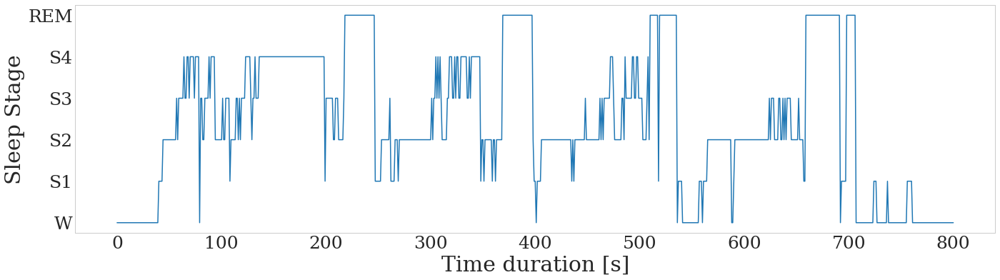

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4002_hypno shape (1088, 14)


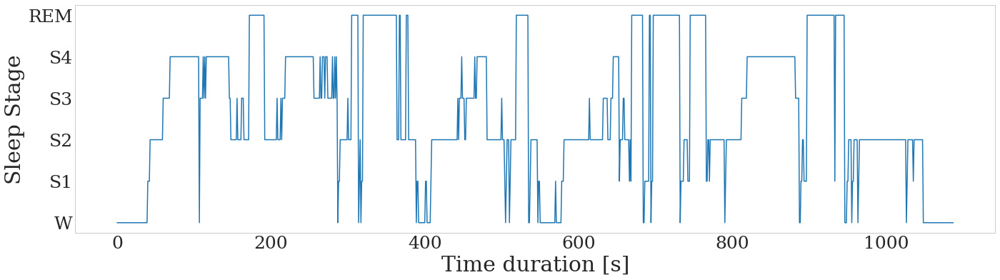

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4011_hypno shape (1063, 14)


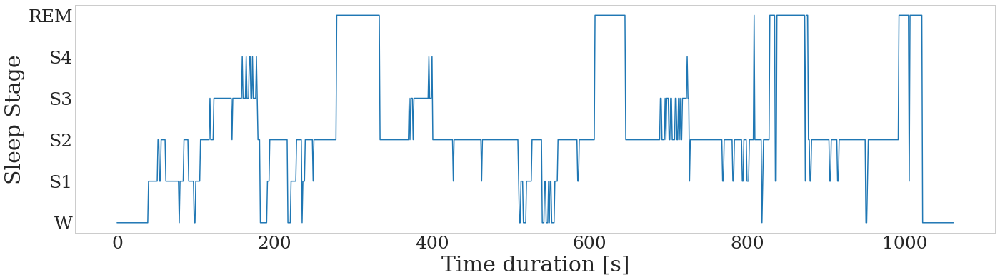

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4012_hypno shape (1146, 14)


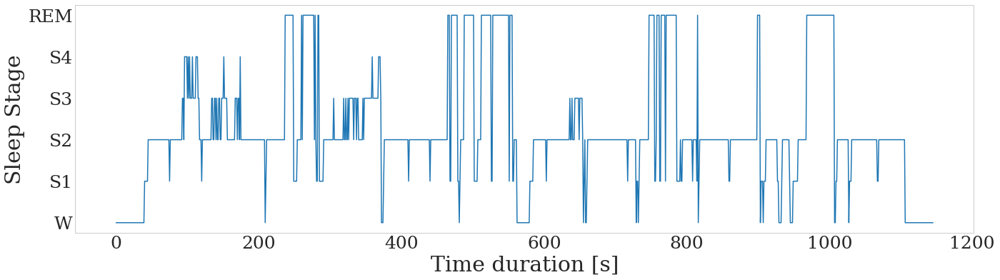

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4021_hypno shape (985, 14)


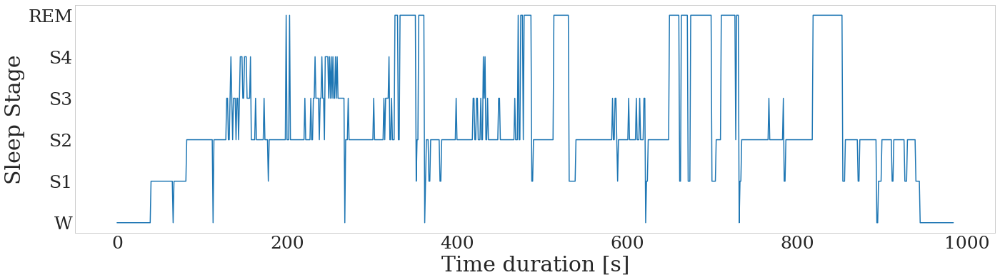

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4022_hypno shape (970, 14)


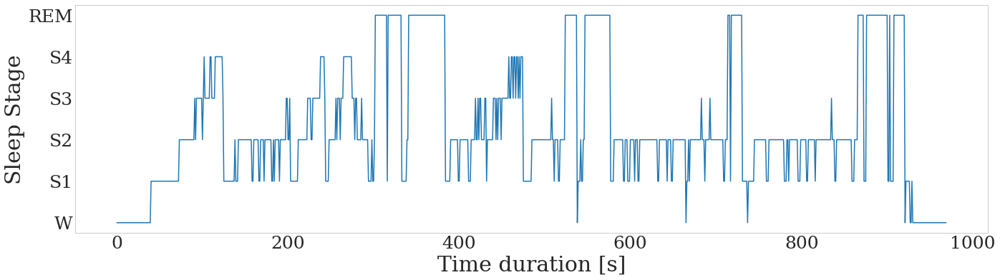

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4031_hypno shape (912, 14)


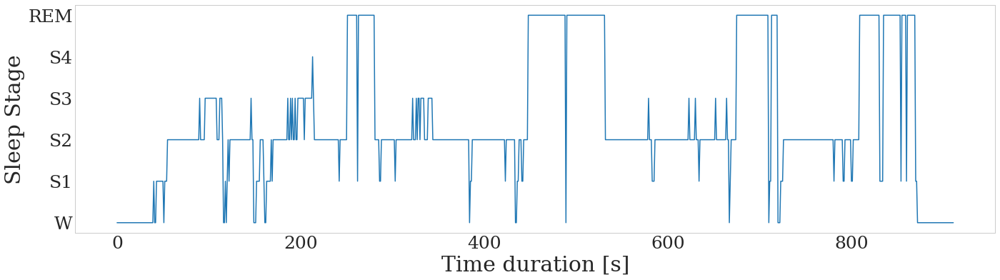

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4032_hypno shape (871, 14)


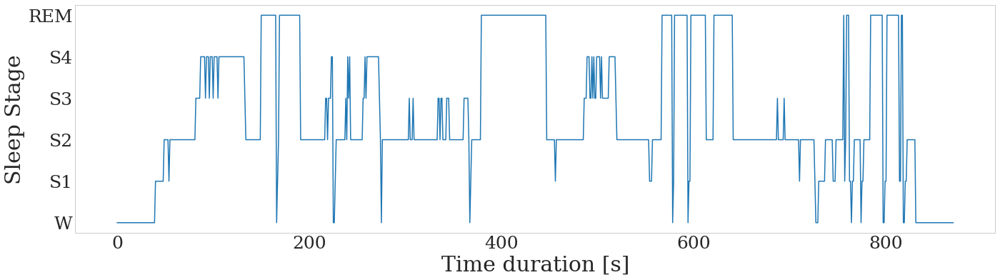

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4041_hypno shape (1196, 14)


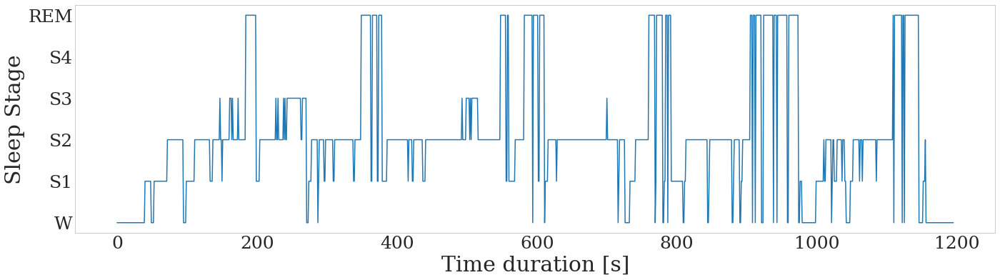

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4042_hypno shape (1164, 14)


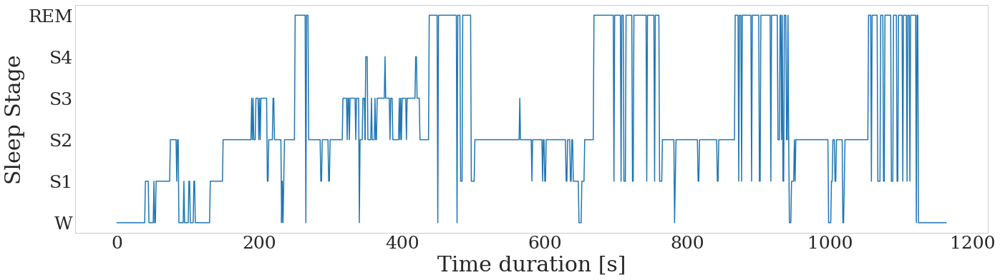

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4051_hypno shape (632, 14)


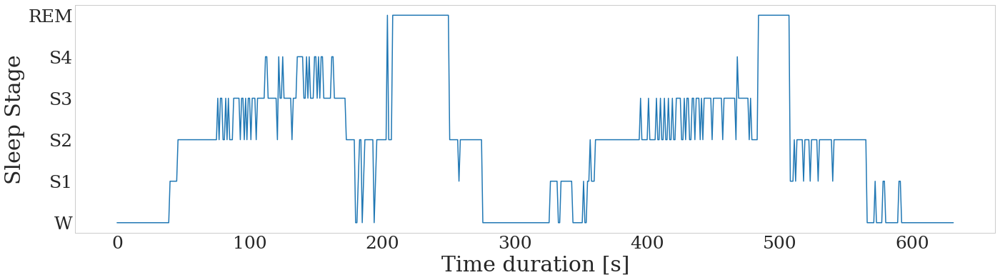

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4052_hypno shape (1208, 14)


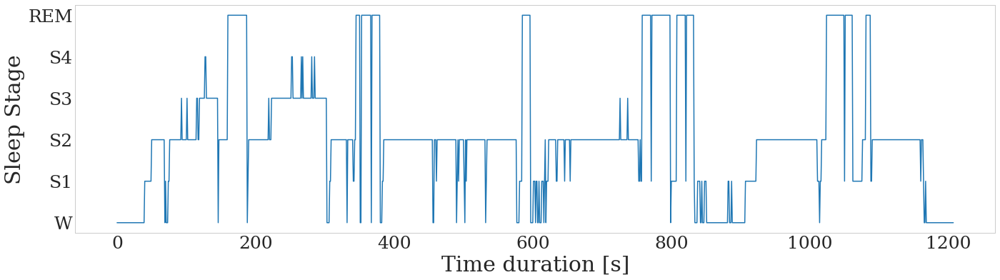

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4061_hypno shape (803, 14)


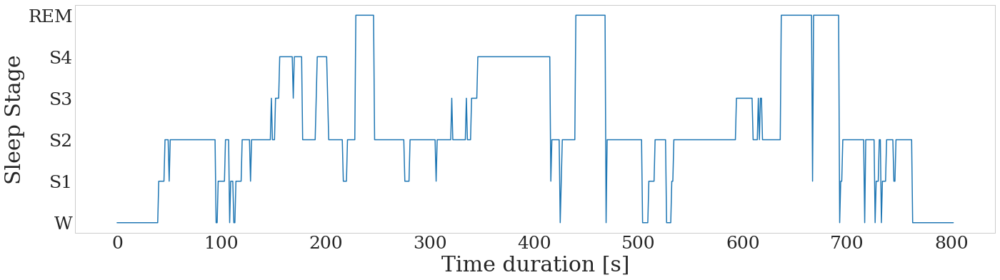

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4062_hypno shape (976, 14)


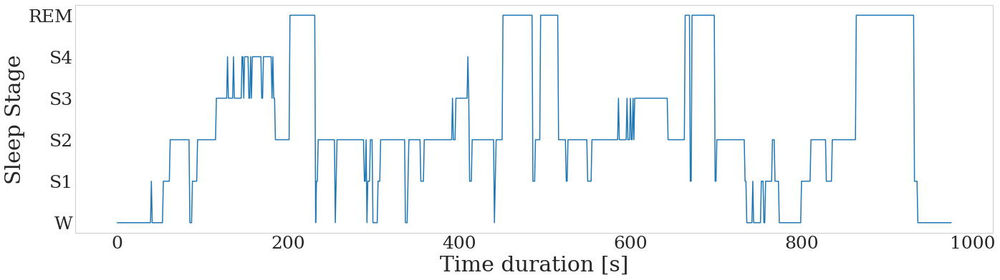

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4071_hypno shape (936, 14)


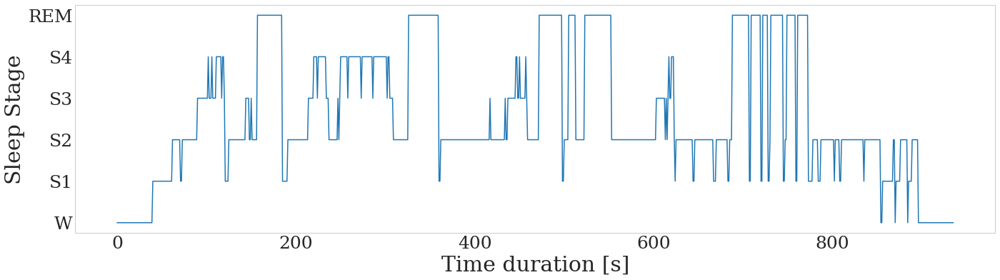

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4072_hypno shape (1233, 14)


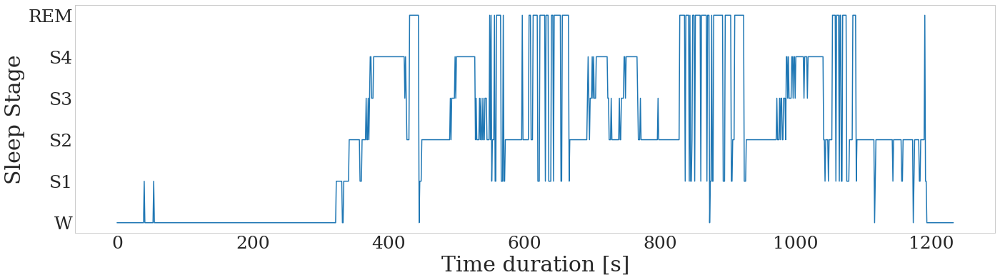

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4081_hypno shape (1094, 14)


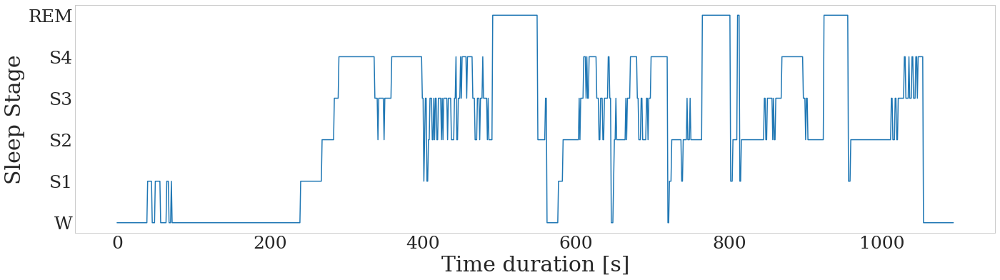

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4082_hypno shape (1014, 14)


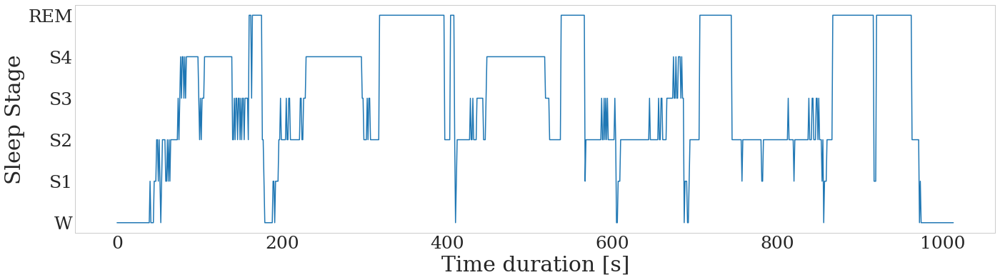

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4091_hypno shape (1103, 14)


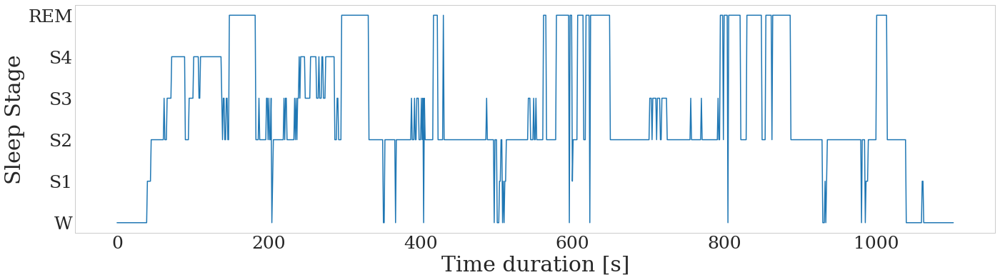

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4092_hypno shape (1076, 14)


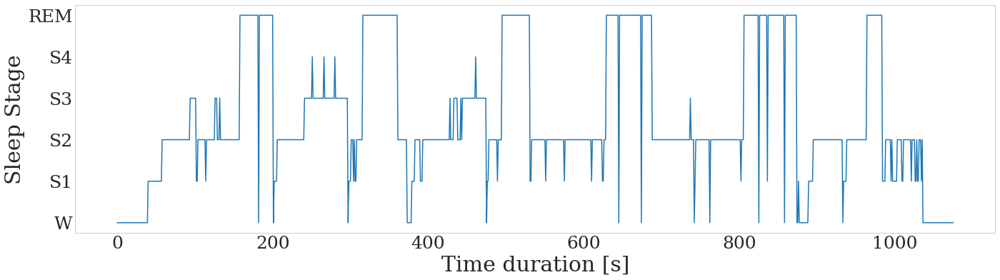

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4101_hypno shape (1065, 14)


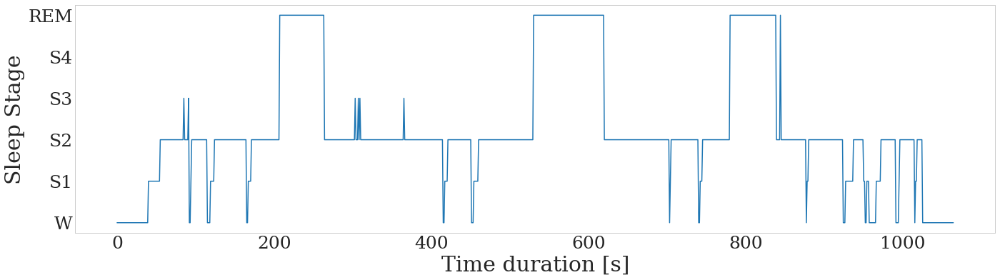

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4102_hypno shape (1053, 14)


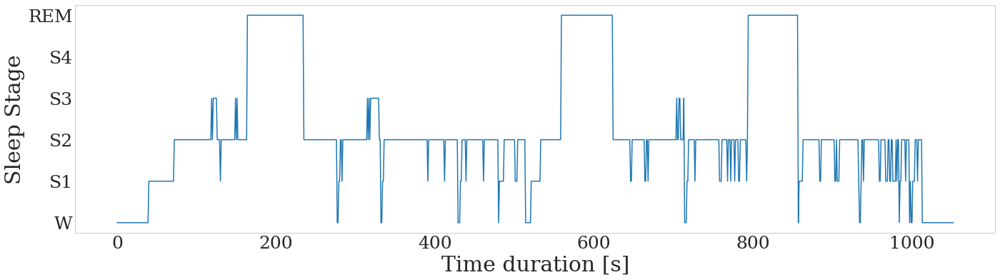

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4111_hypno shape (889, 14)


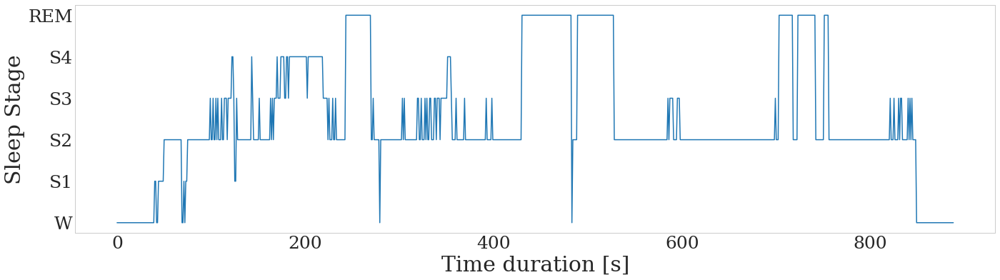

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4112_hypno shape (762, 14)


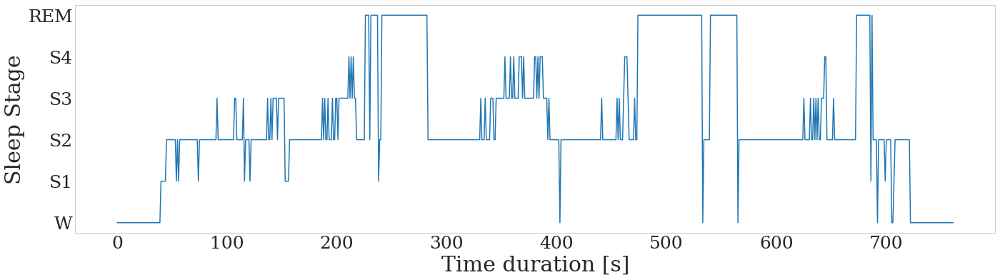

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4121_hypno shape (1012, 14)


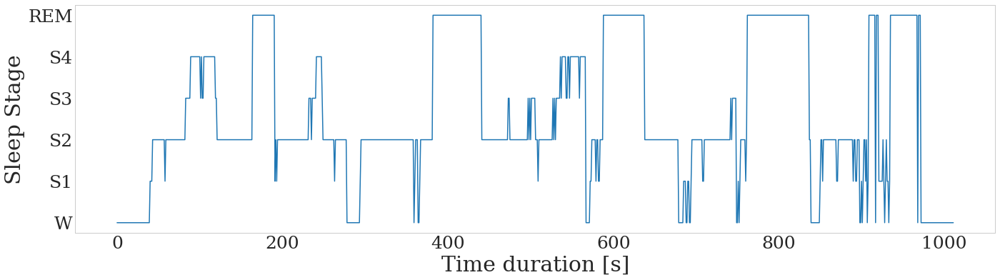

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4122_hypno shape (937, 14)


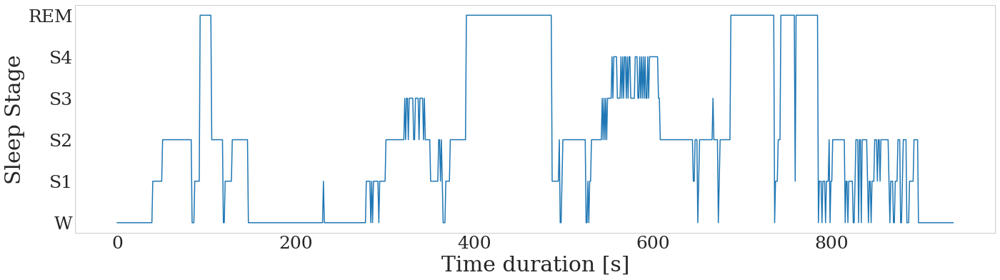

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4131_hypno shape (988, 14)


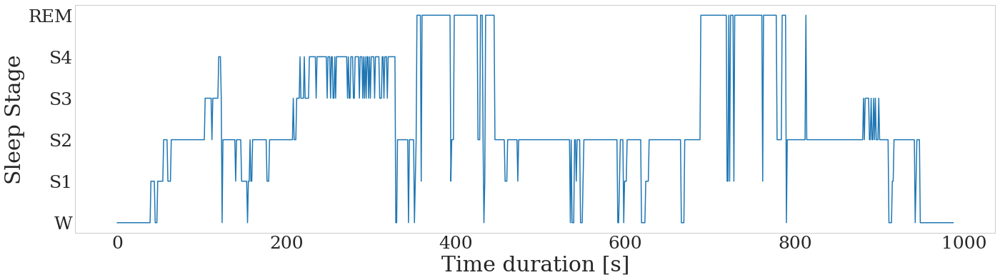

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4141_hypno shape (964, 14)


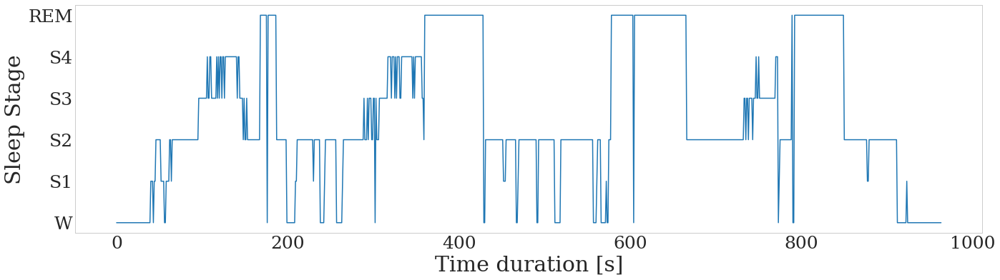

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4142_hypno shape (912, 14)


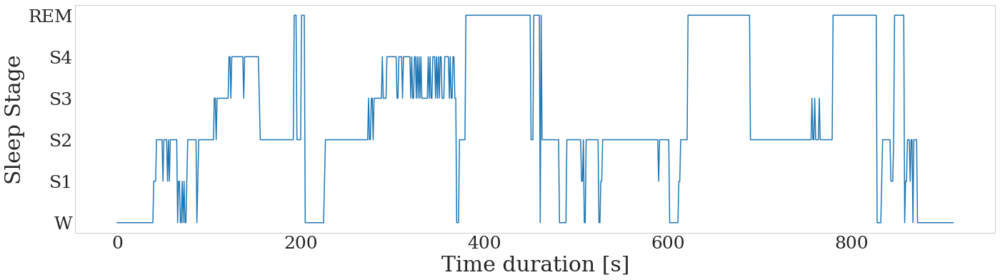

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4151_hypno shape (916, 14)


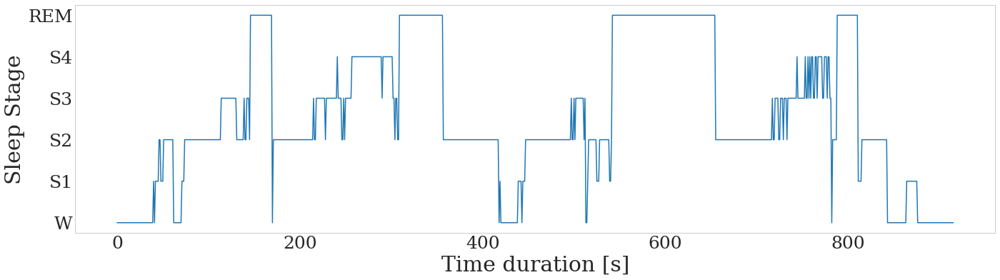

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4152_hypno shape (1012, 14)


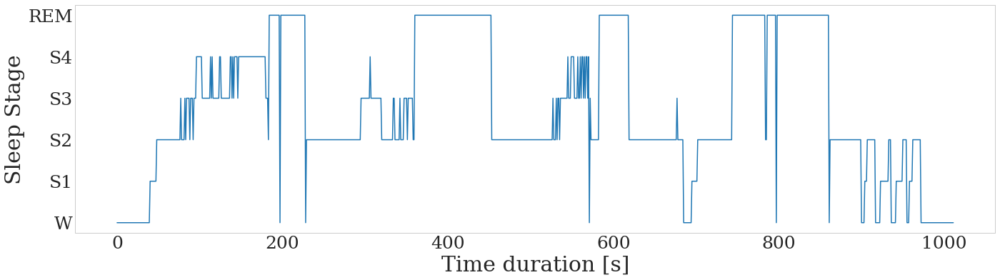

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4161_hypno shape (1109, 14)


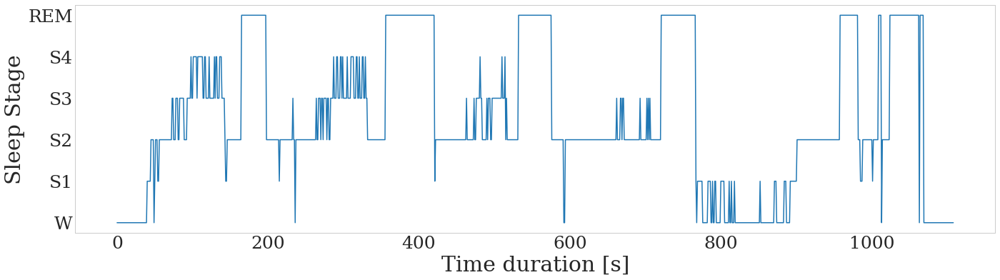

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4162_hypno shape (965, 14)


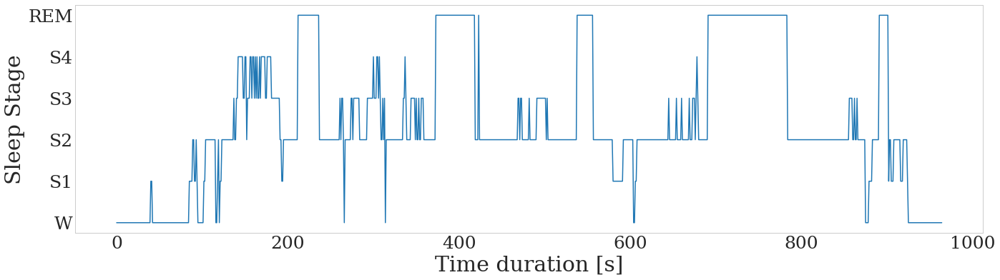

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4171_hypno shape (963, 14)


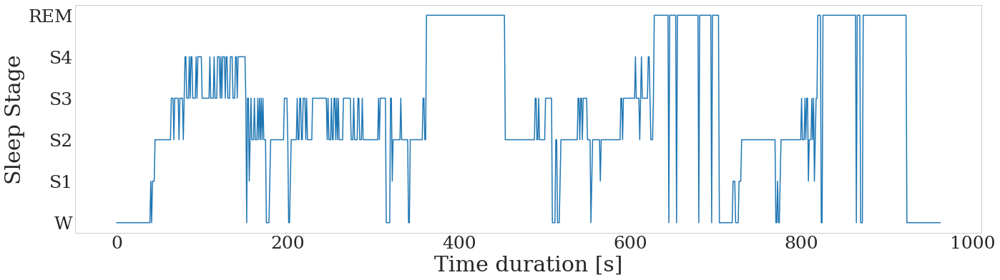

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4172_hypno shape (979, 14)


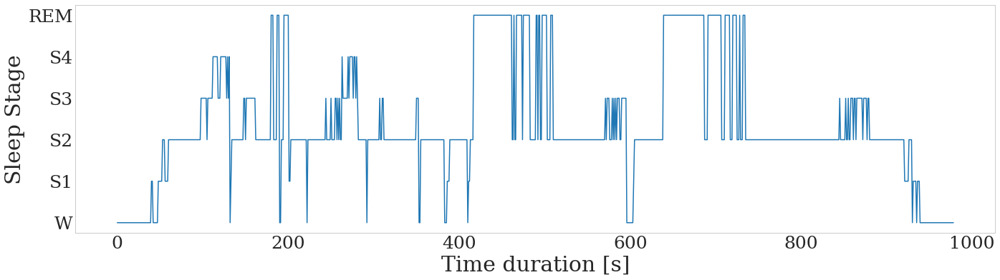

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4181_hypno shape (924, 14)


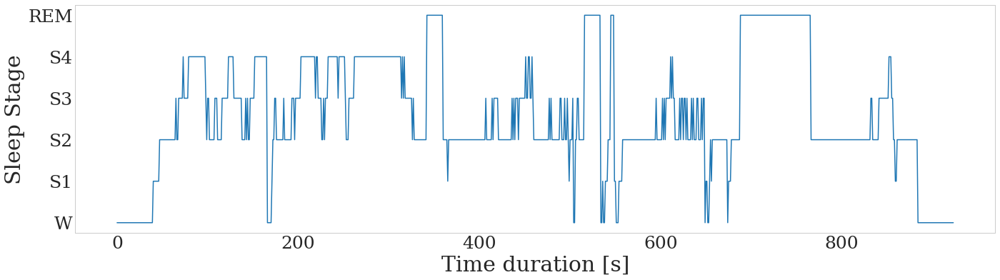

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4182_hypno shape (880, 14)


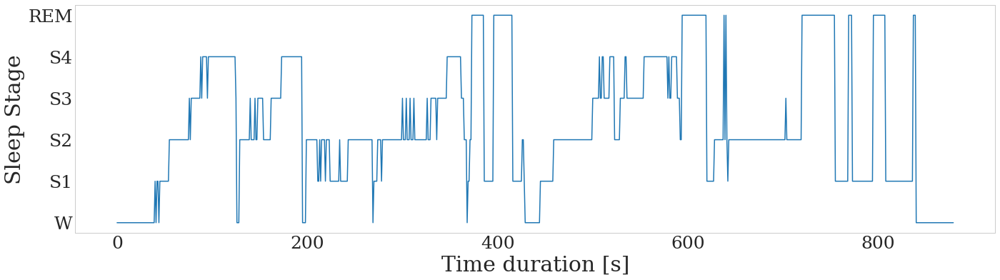

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4191_hypno shape (1495, 14)


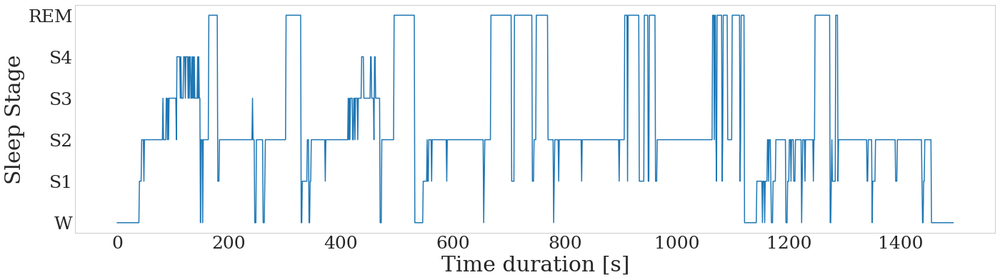

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4192_hypno shape (1239, 14)


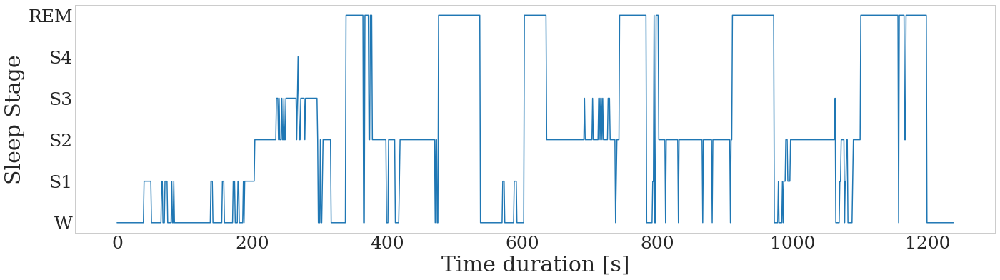

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4201_hypno shape (983, 14)


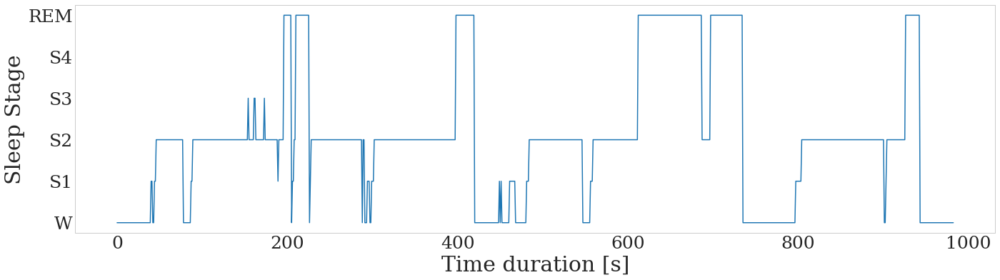

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4202_hypno shape (981, 14)


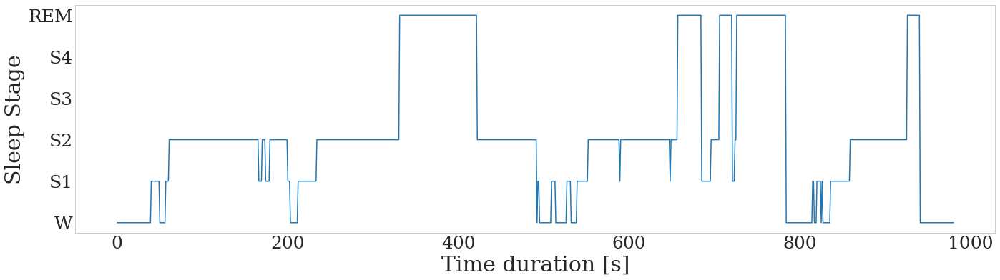

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4211_hypno shape (950, 14)


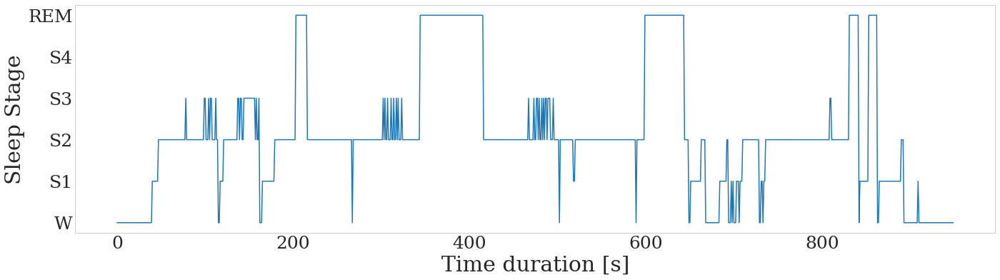

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4212_hypno shape (768, 14)


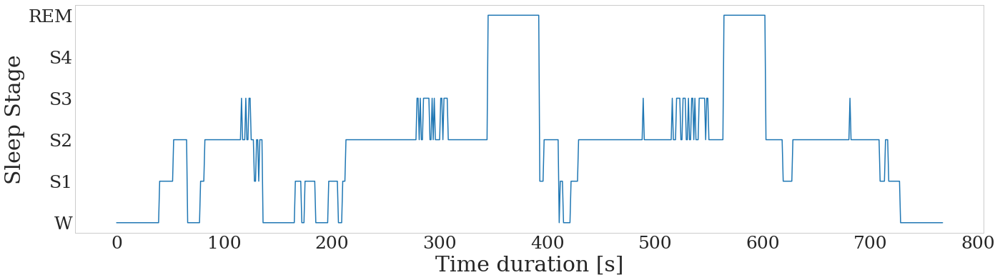

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4221_hypno shape (1059, 14)


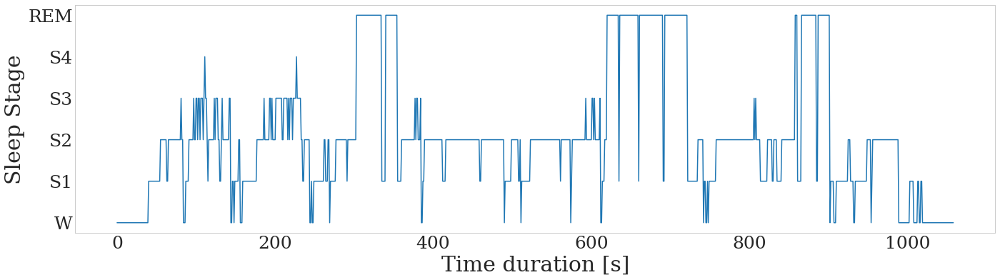

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4222_hypno shape (1068, 14)


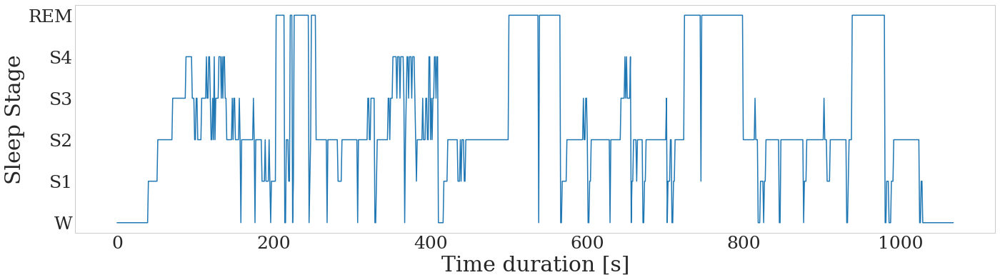

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4231_hypno shape (867, 14)


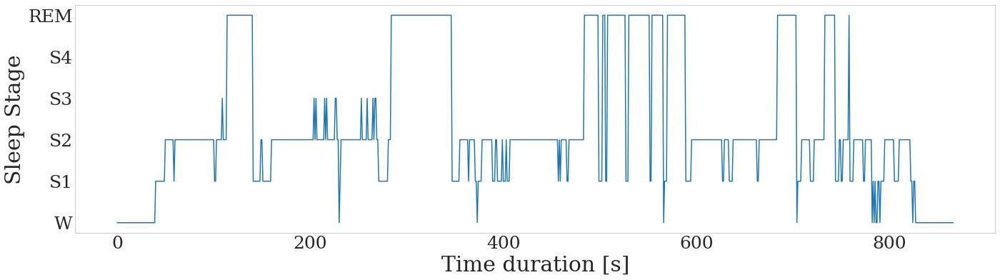

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4232_hypno shape (919, 14)


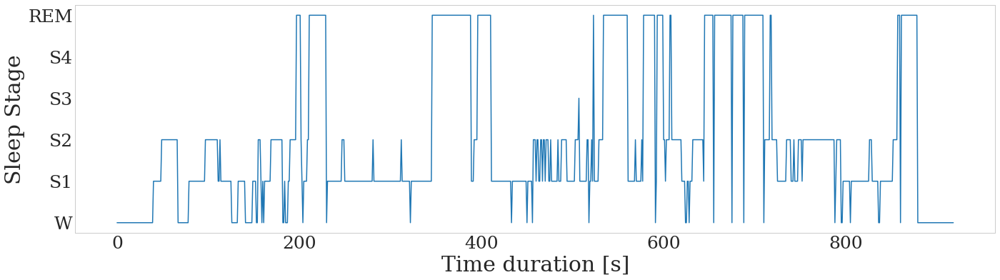

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4241_hypno shape (946, 14)


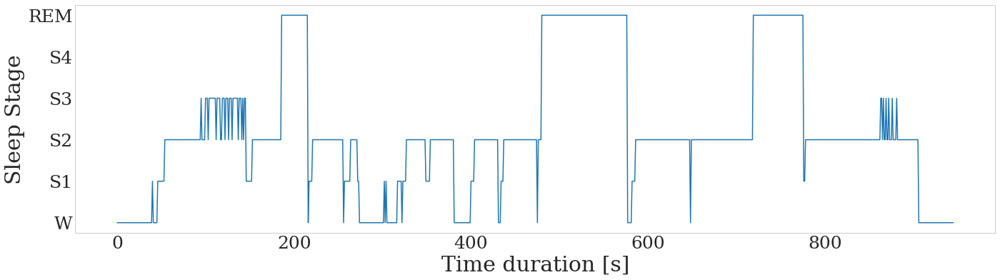

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4242_hypno shape (1029, 14)


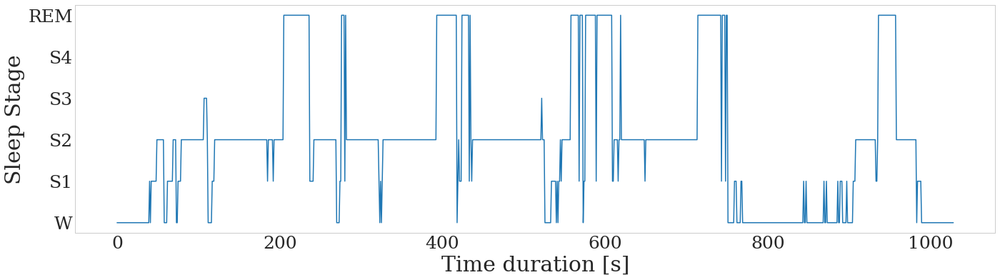

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4251_hypno shape (932, 14)


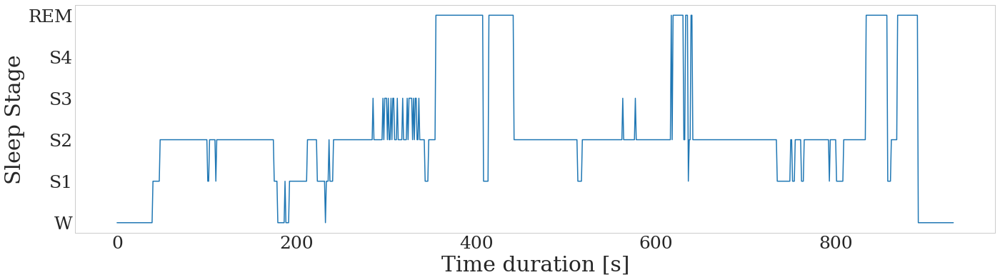

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4252_hypno shape (981, 14)


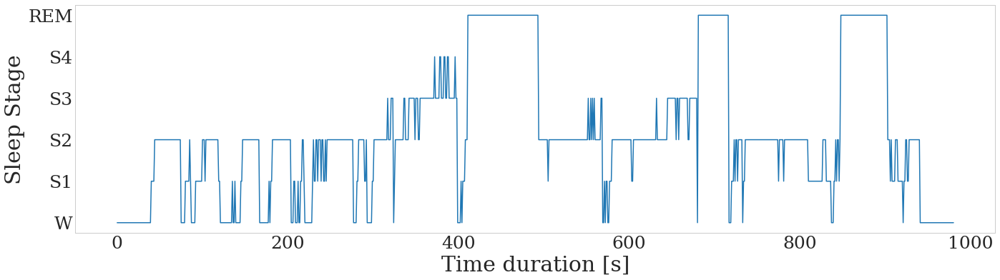

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4261_hypno shape (1557, 14)


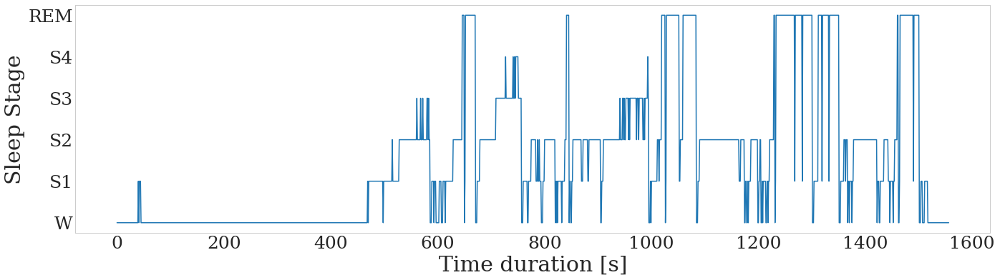

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4262_hypno shape (940, 14)


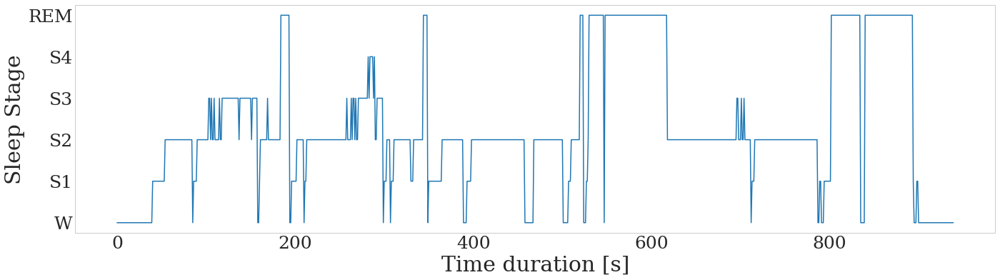

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4271_hypno shape (1012, 14)


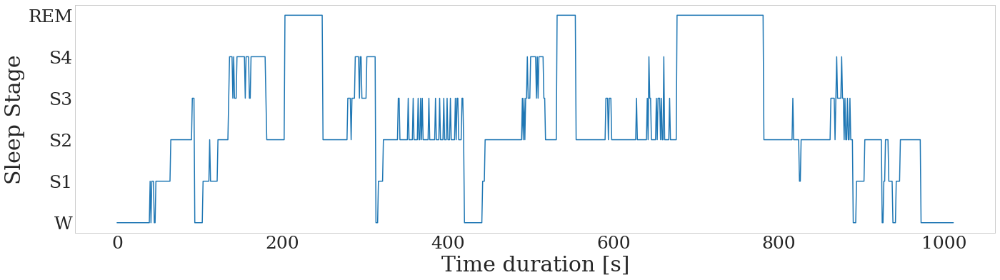

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4272_hypno shape (1050, 14)


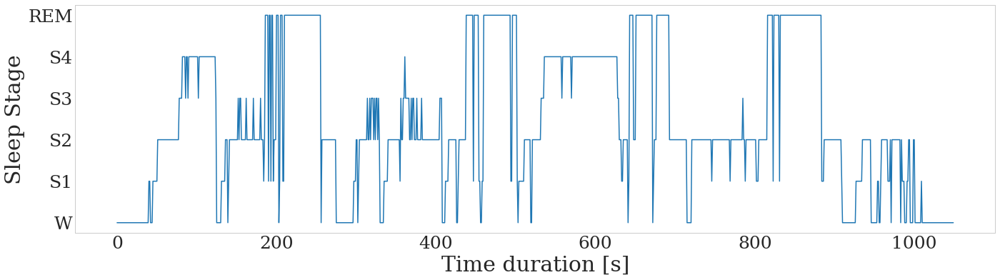

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4281_hypno shape (1087, 14)


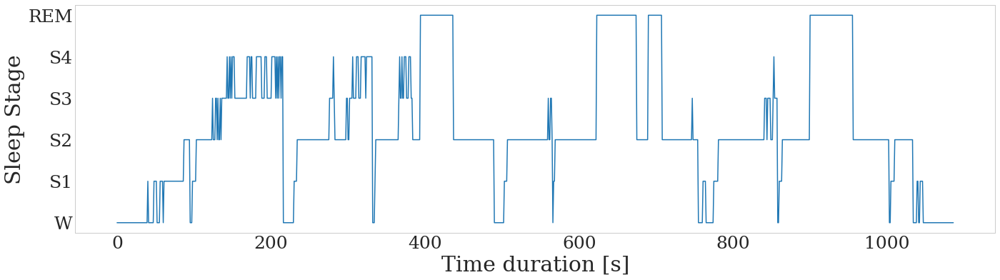

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4282_hypno shape (1030, 14)


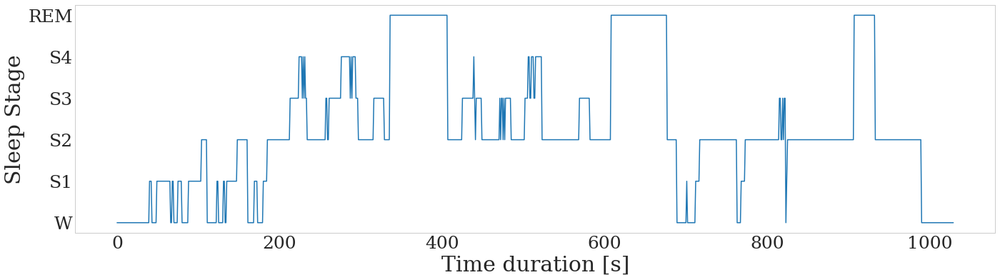

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4291_hypno shape (1091, 14)


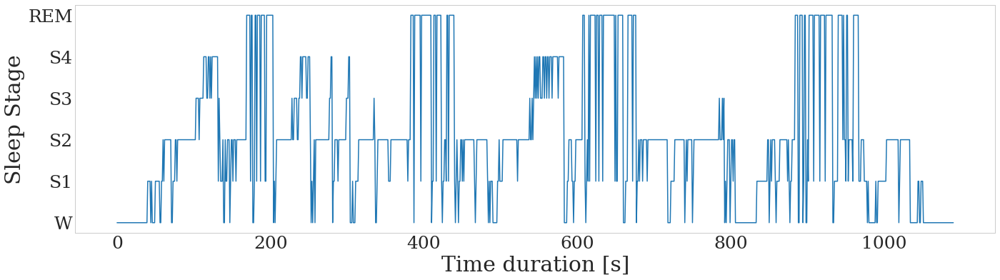

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4292_hypno shape (1033, 14)


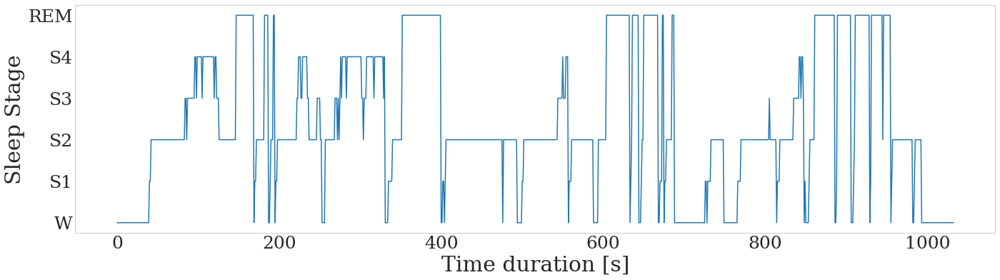

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4301_hypno shape (891, 14)


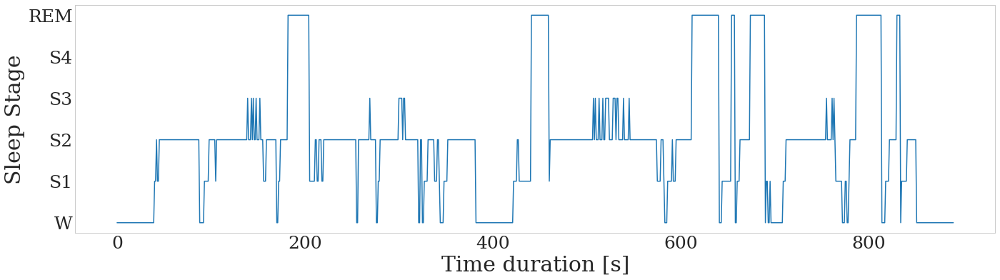

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4302_hypno shape (814, 14)


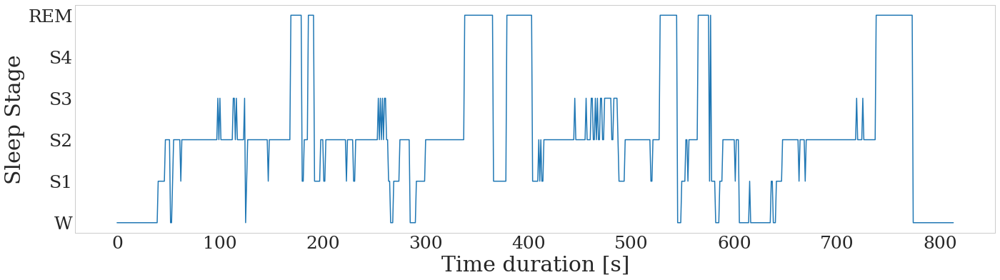

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4311_hypno shape (1014, 14)


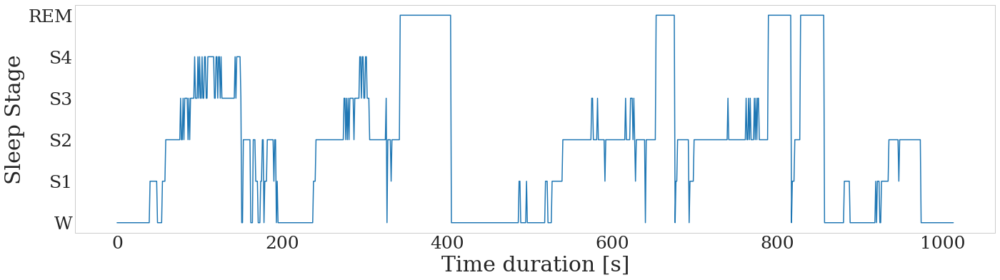

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4312_hypno shape (1141, 14)


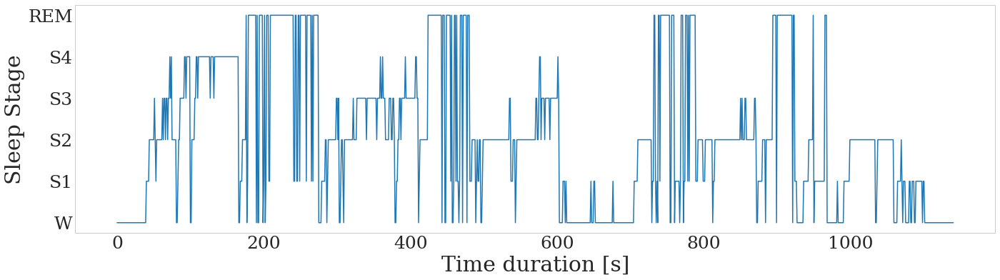

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4321_hypno shape (921, 14)


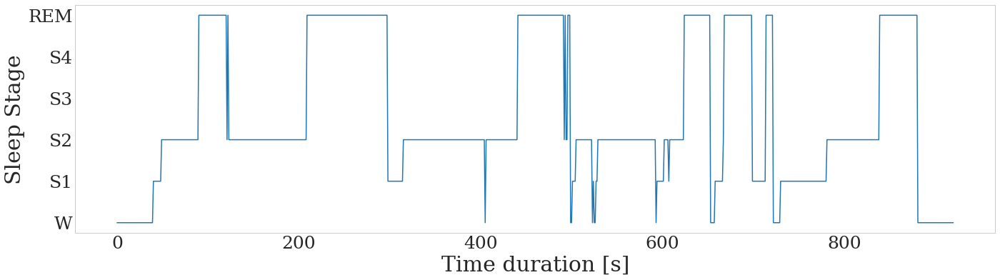

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4322_hypno shape (981, 14)


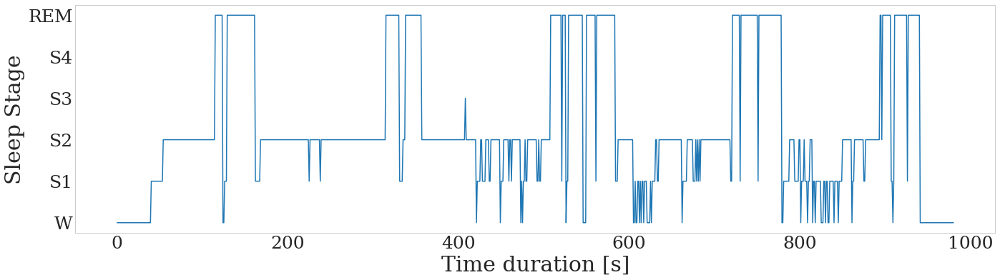

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4331_hypno shape (948, 14)


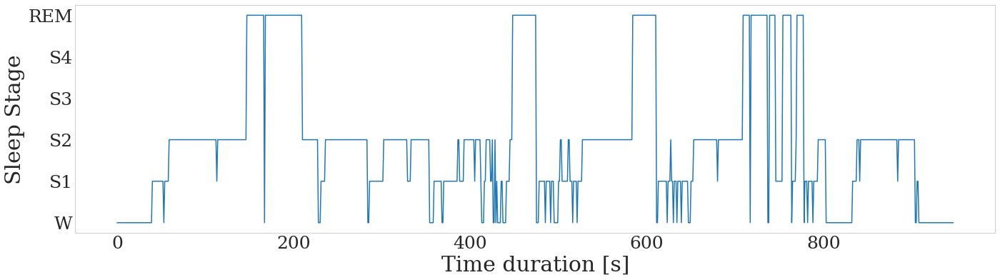

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4332_hypno shape (1274, 14)


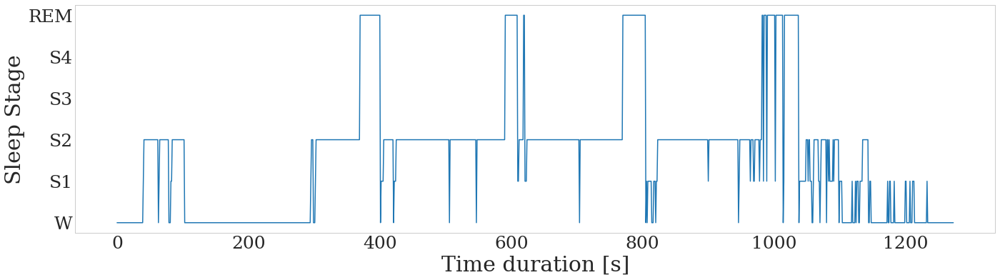

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4341_hypno shape (973, 14)


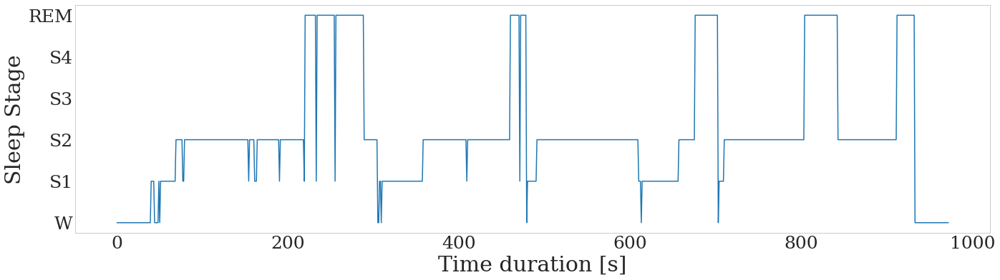

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4342_hypno shape (985, 14)


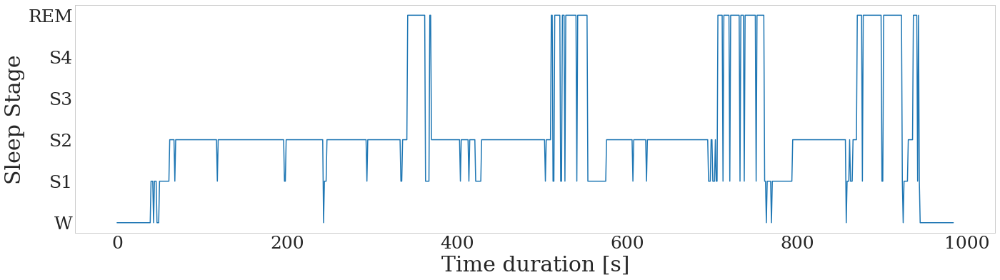

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4351_hypno shape (936, 14)


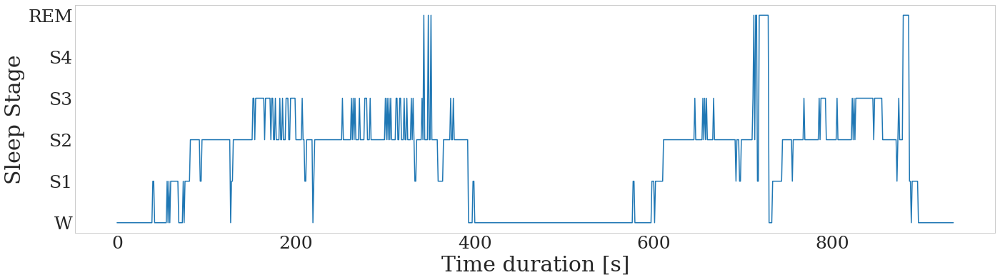

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4352_hypno shape (925, 14)


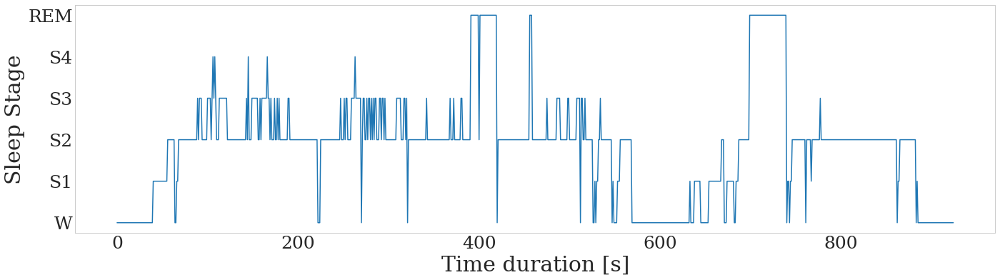

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4362_hypno shape (784, 14)


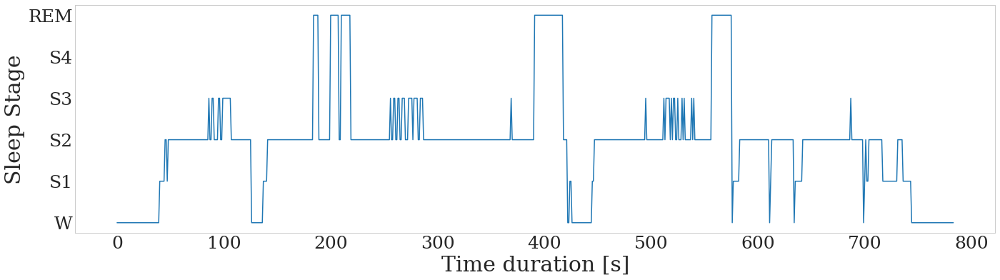

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4371_hypno shape (878, 14)


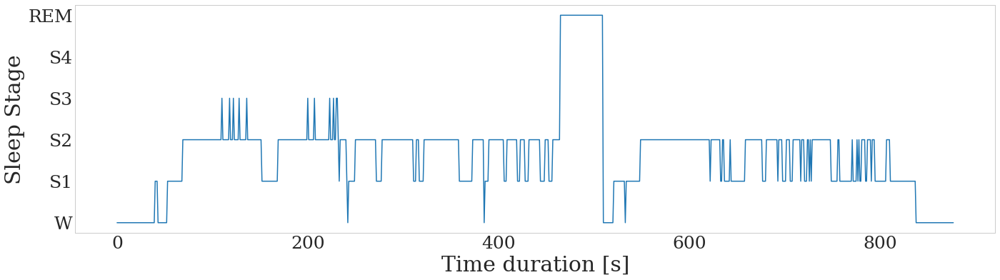

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4372_hypno shape (865, 14)


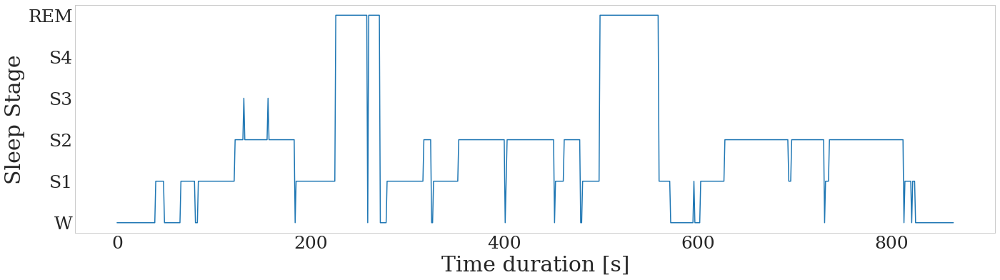

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4381_hypno shape (989, 14)


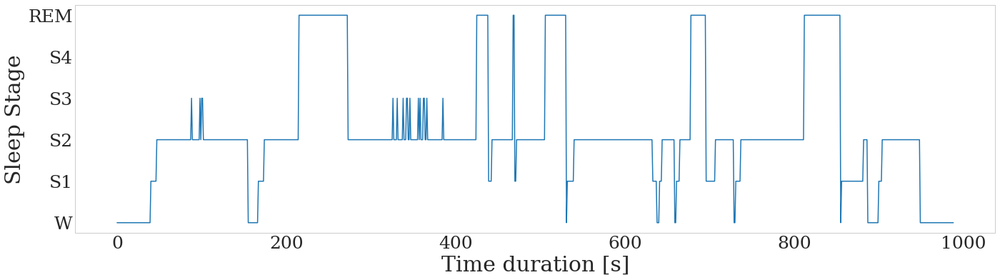

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4382_hypno shape (994, 14)


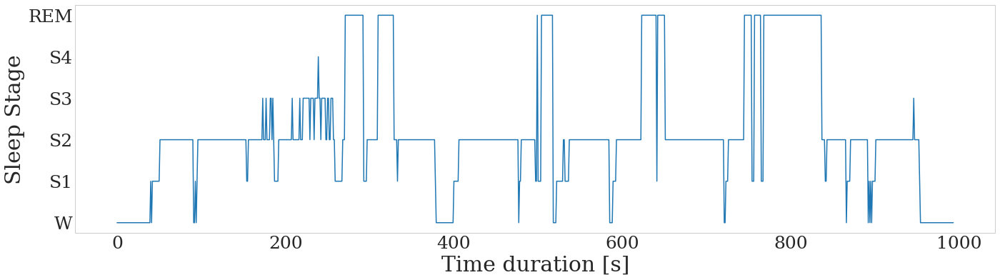

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4401_hypno shape (1024, 14)


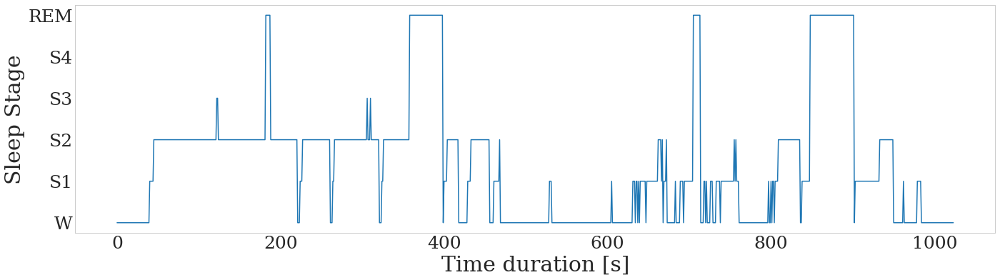

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4402_hypno shape (1032, 14)


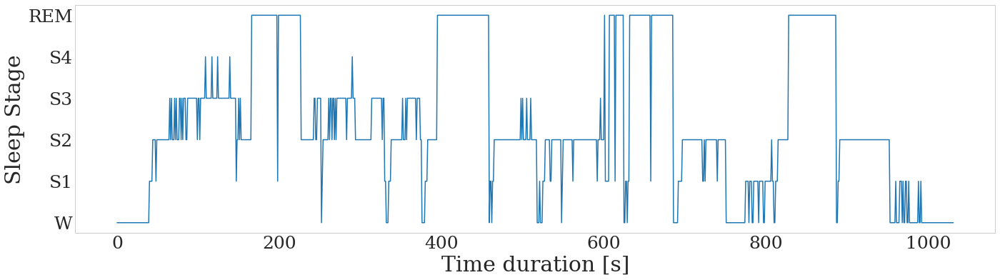

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4411_hypno shape (1038, 14)


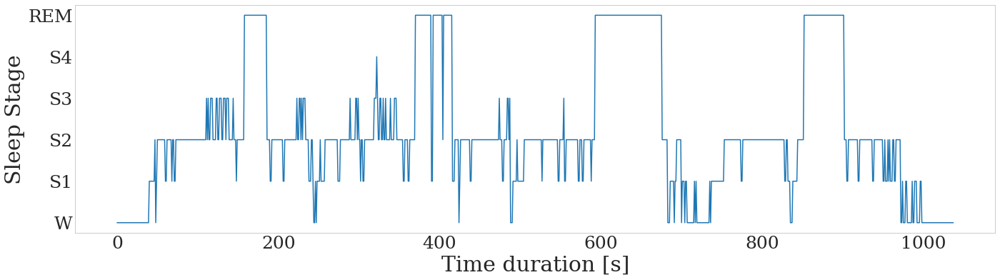

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4412_hypno shape (884, 14)


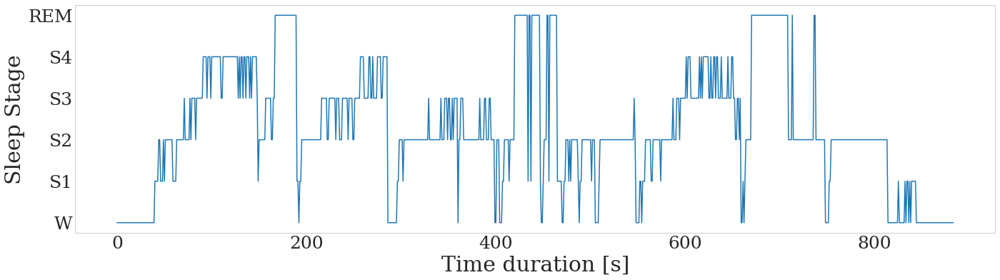

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4421_hypno shape (745, 14)


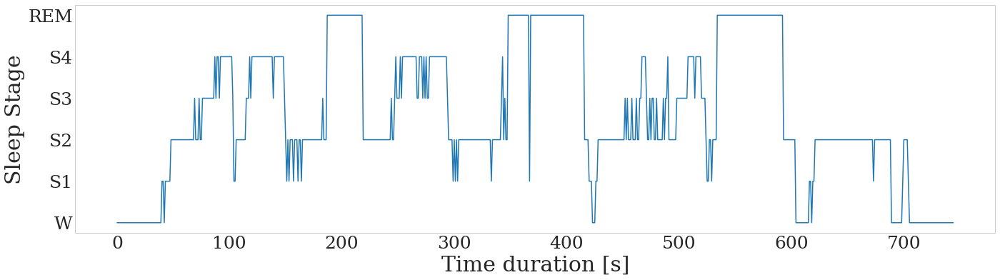

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4422_hypno shape (844, 14)


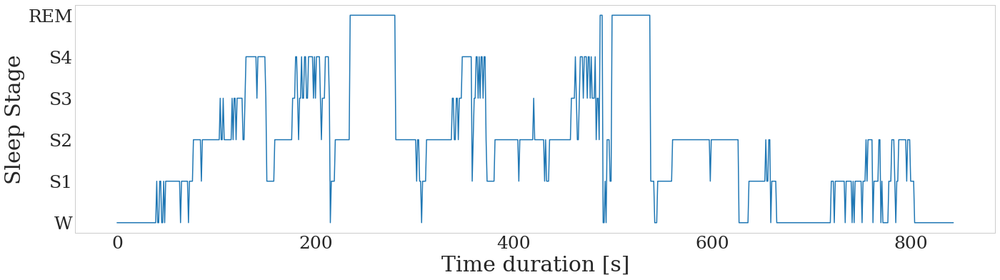

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4431_hypno shape (659, 14)


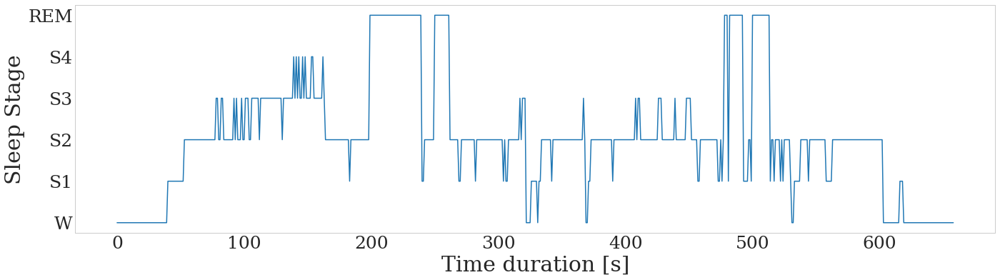

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4432_hypno shape (922, 14)


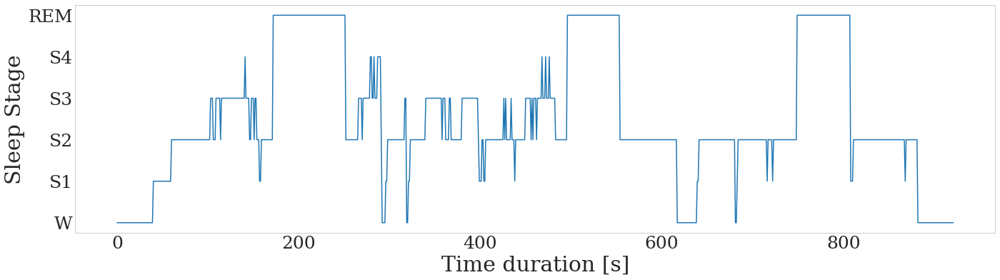

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4441_hypno shape (1155, 14)


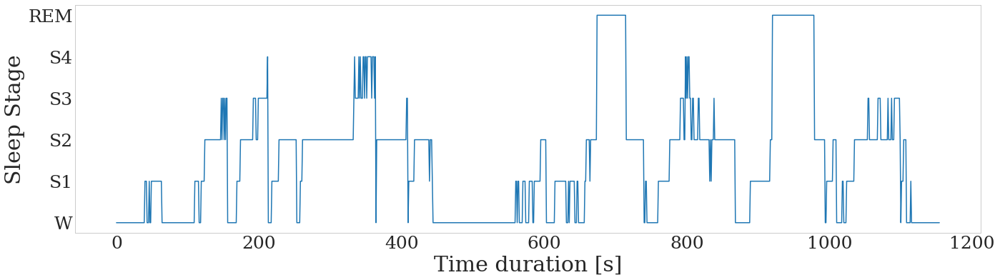

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4442_hypno shape (1052, 14)


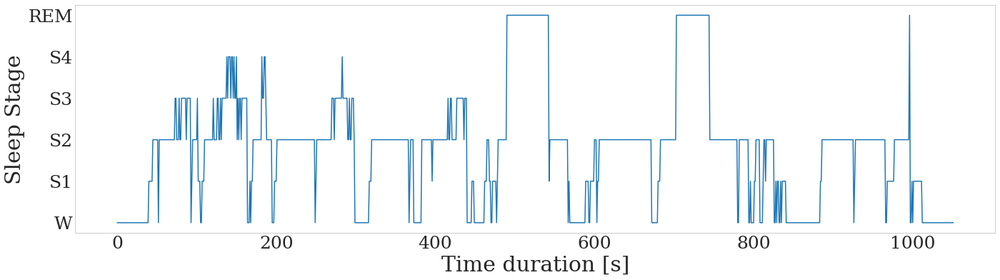

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4451_hypno shape (1168, 14)


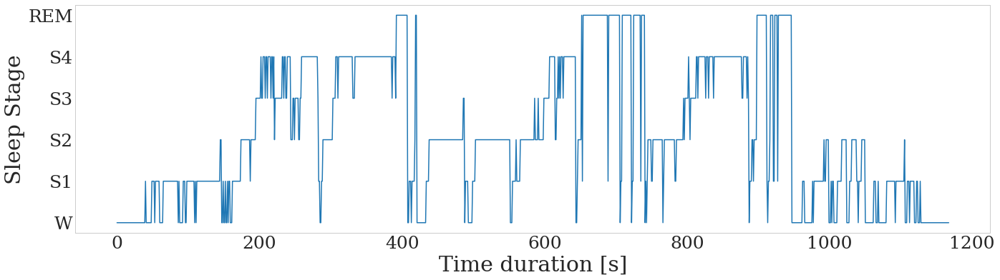

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4452_hypno shape (1126, 14)


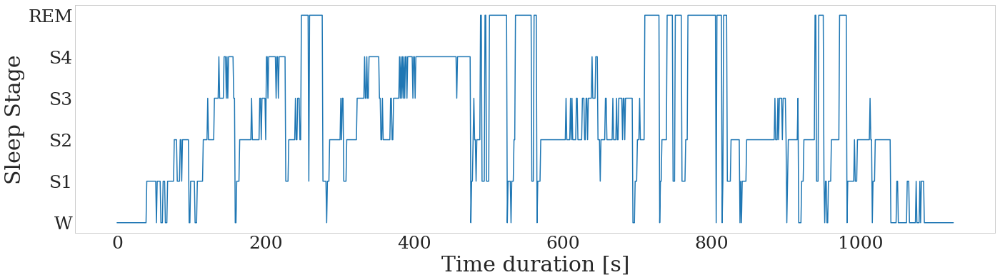

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4461_hypno shape (944, 14)


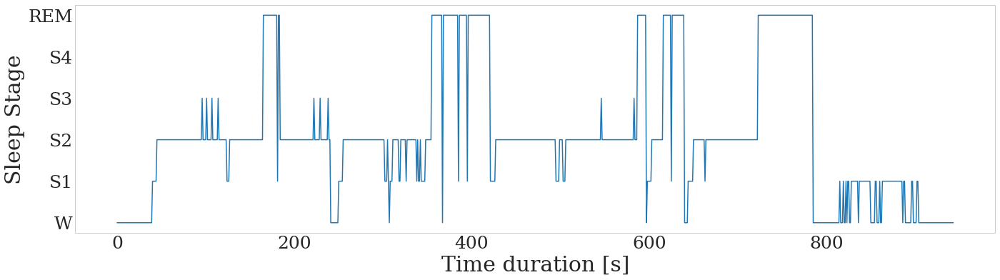

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4462_hypno shape (984, 14)


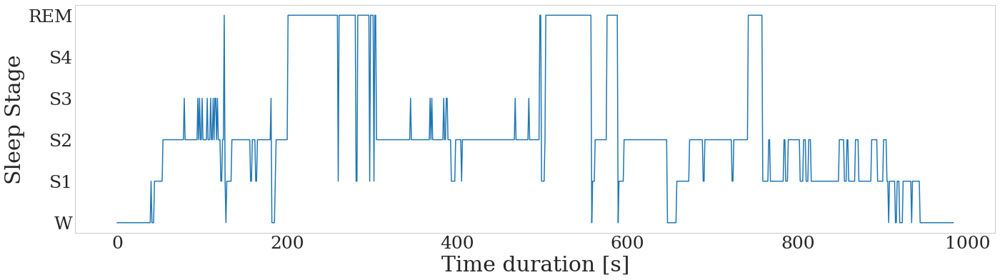

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4471_hypno shape (1148, 14)


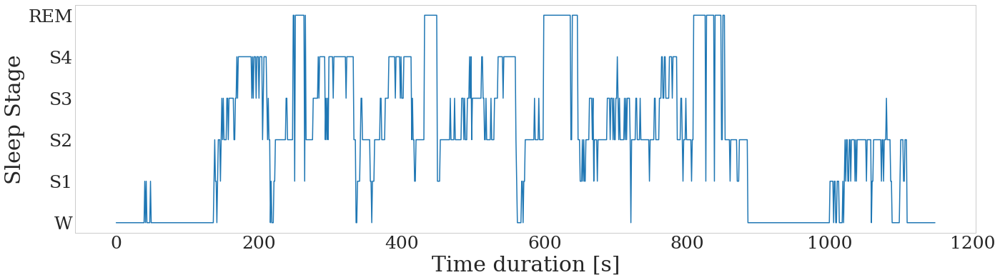

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4472_hypno shape (1212, 14)


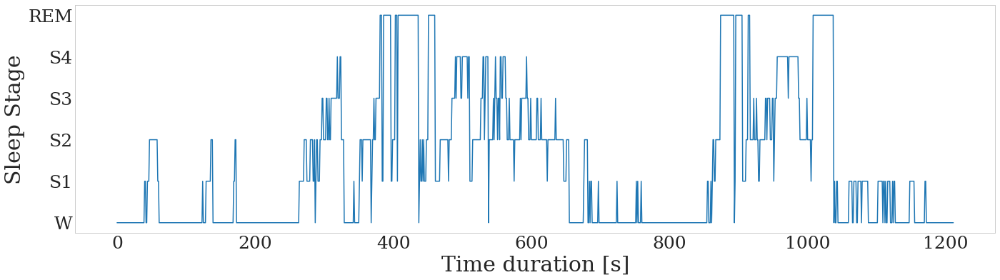

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4481_hypno shape (1198, 14)


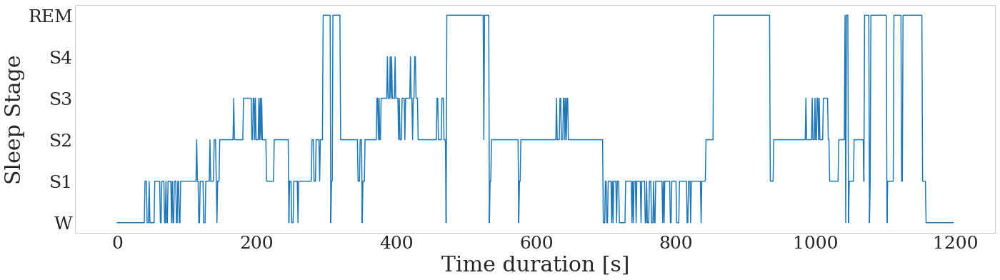

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4482_hypno shape (1046, 14)


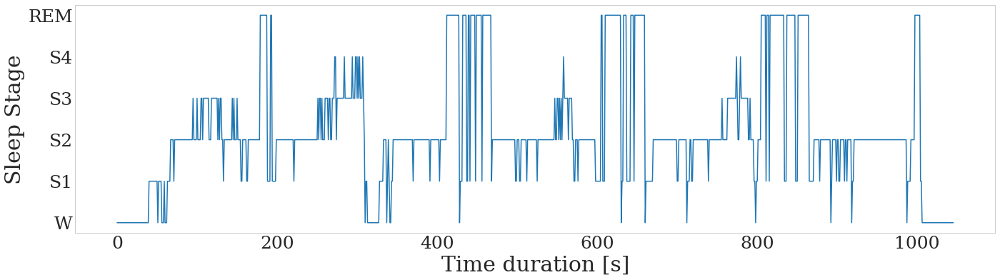

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4491_hypno shape (1061, 14)


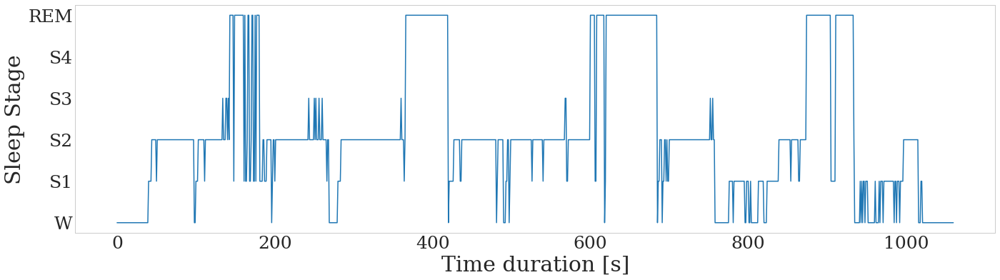

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4492_hypno shape (1001, 14)


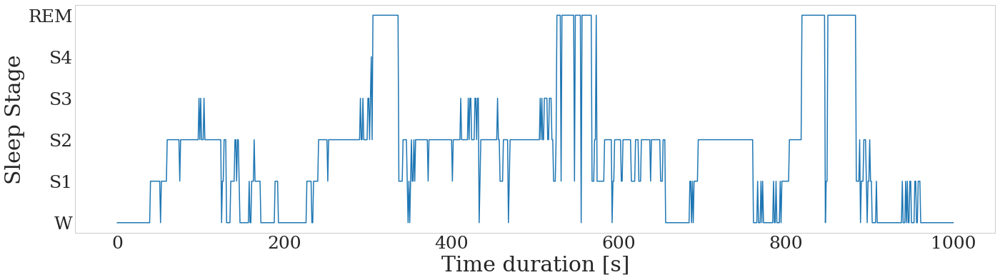

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4501_hypno shape (1286, 14)


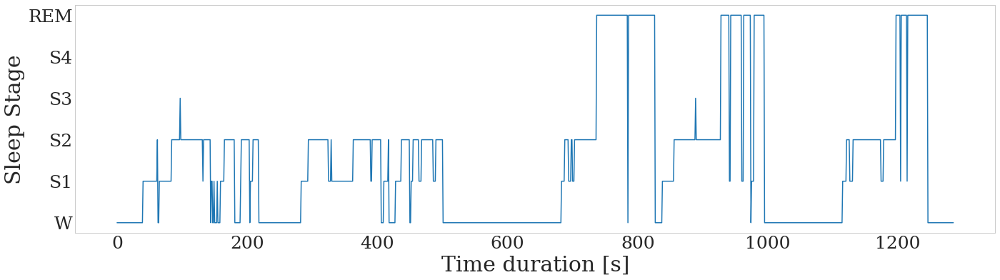

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4502_hypno shape (1063, 14)


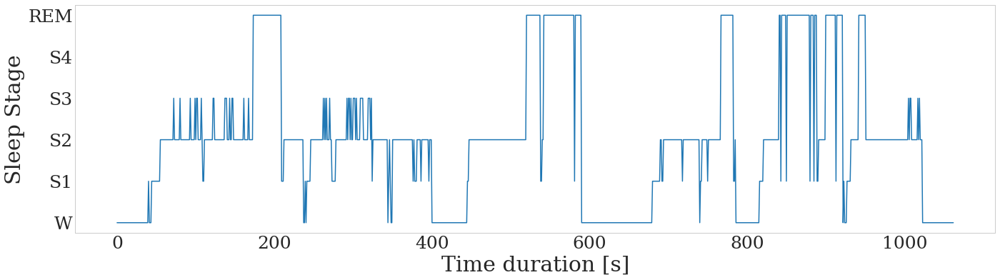

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4511_hypno shape (1047, 14)


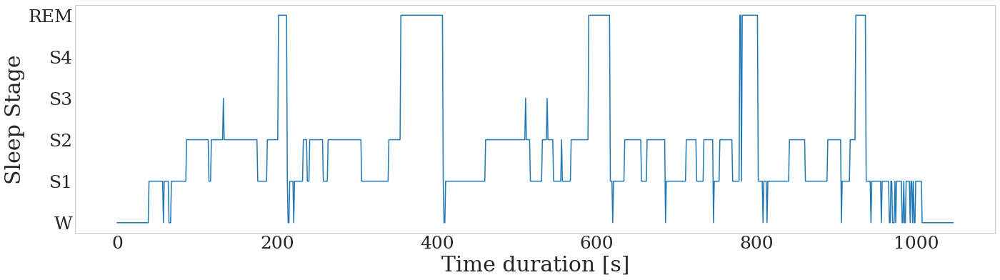

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4512_hypno shape (914, 14)


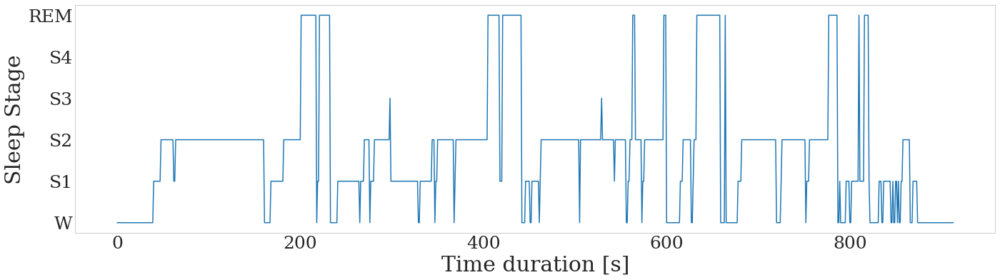

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4522_hypno shape (957, 14)


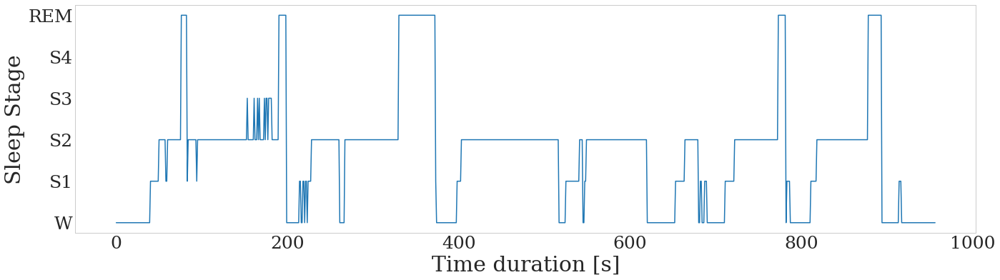

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4531_hypno shape (1056, 14)


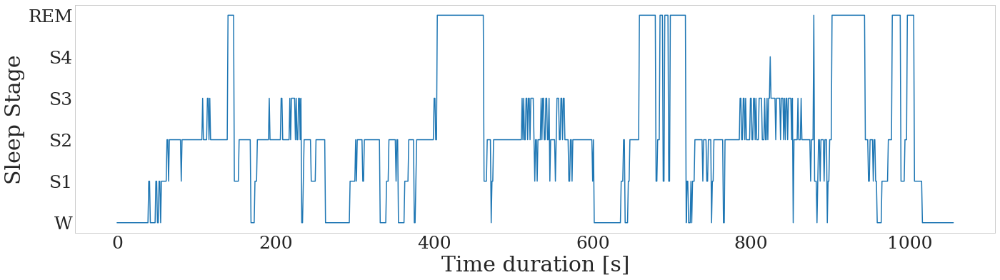

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4532_hypno shape (1016, 14)


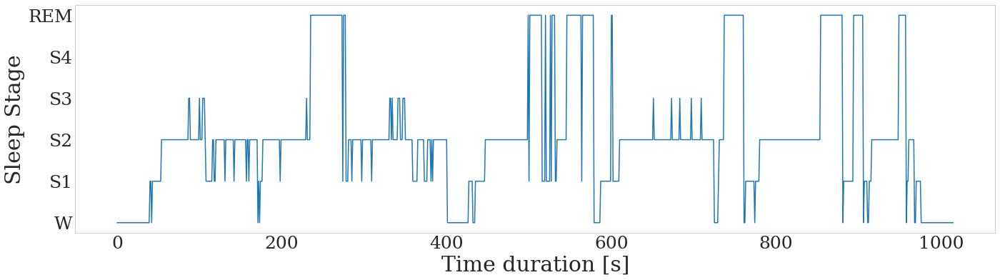

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4541_hypno shape (1677, 14)


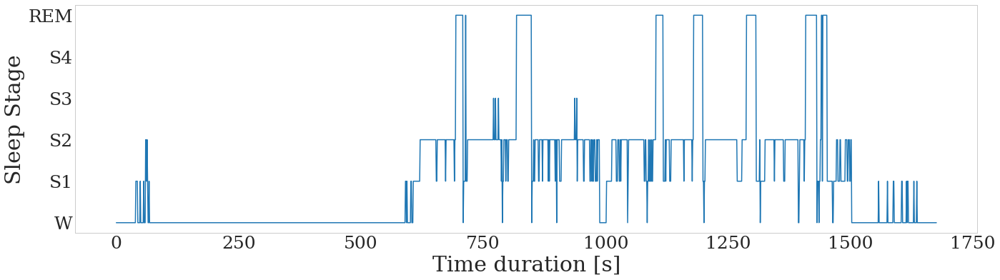

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4542_hypno shape (1108, 14)


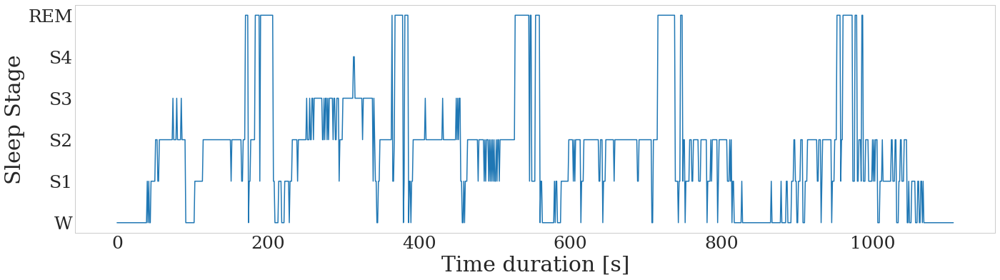

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4551_hypno shape (1007, 14)


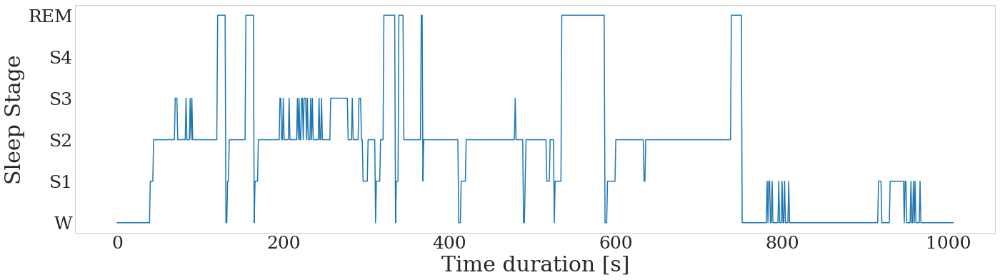

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4552_hypno shape (1050, 14)


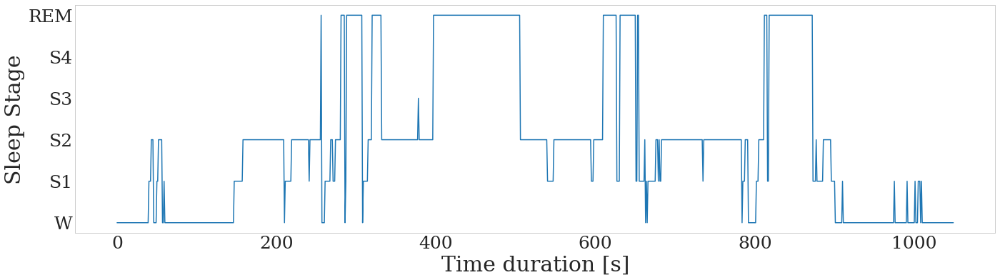

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4561_hypno shape (1199, 14)


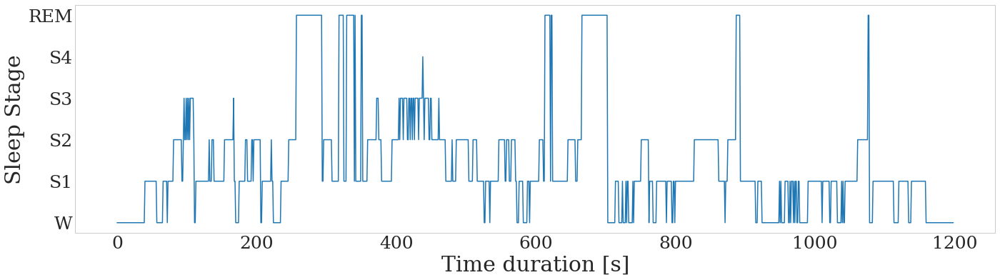

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4562_hypno shape (1108, 14)


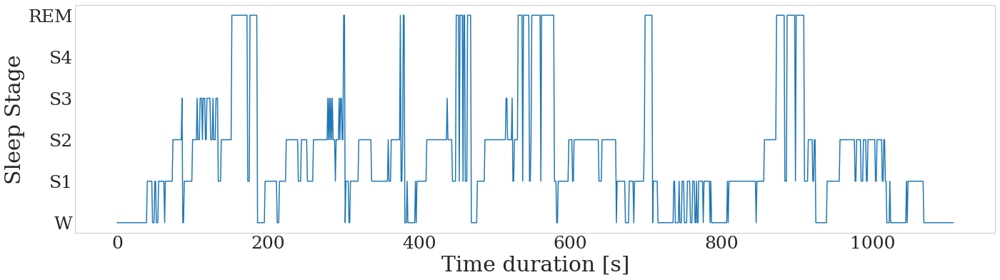

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4571_hypno shape (1196, 14)


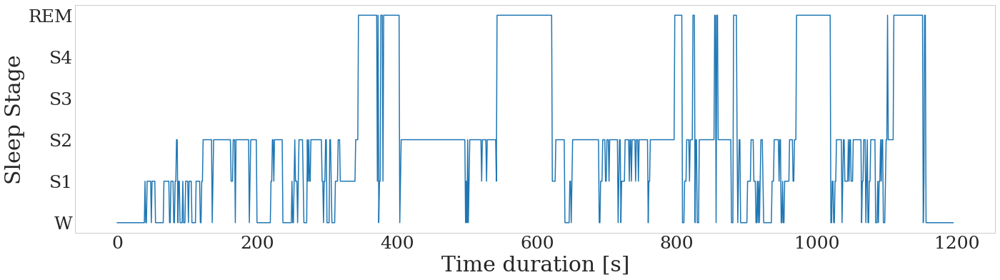

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4572_hypno shape (1062, 14)


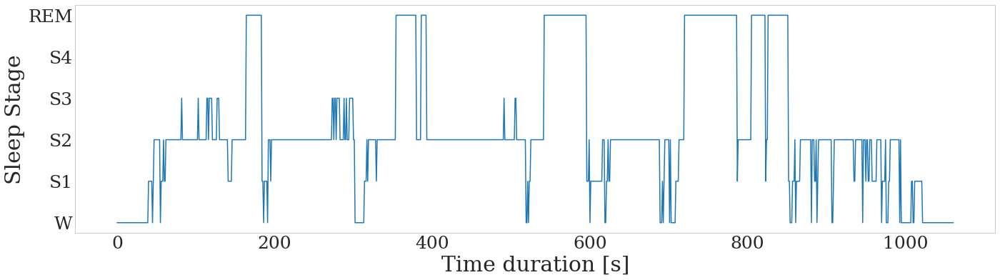

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4581_hypno shape (1055, 14)


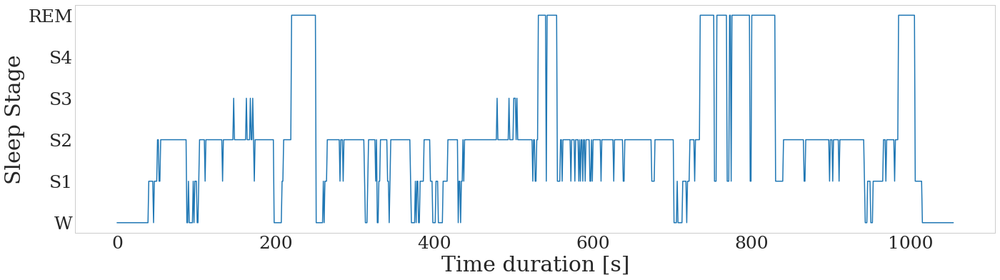

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4582_hypno shape (1135, 14)


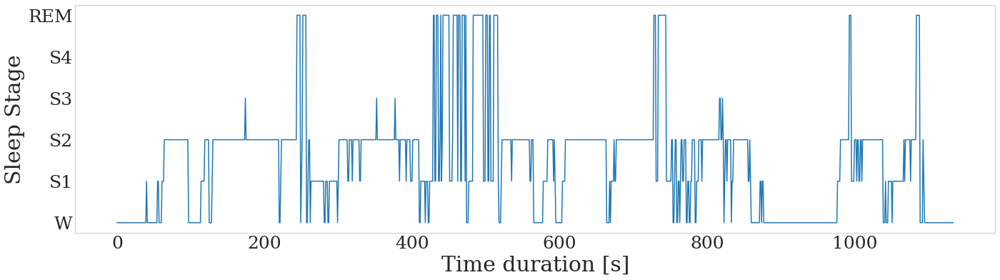

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4591_hypno shape (1081, 14)


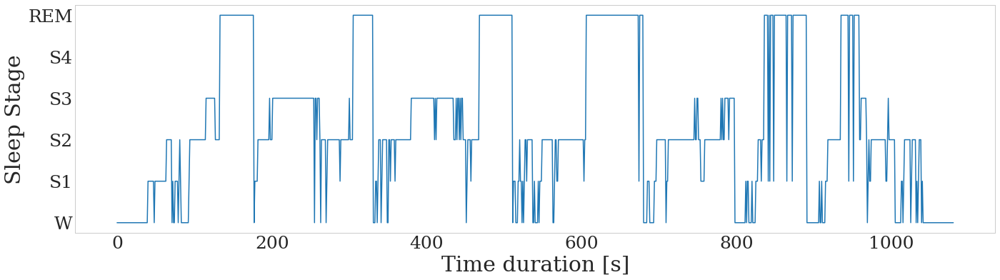

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4592_hypno shape (1225, 14)


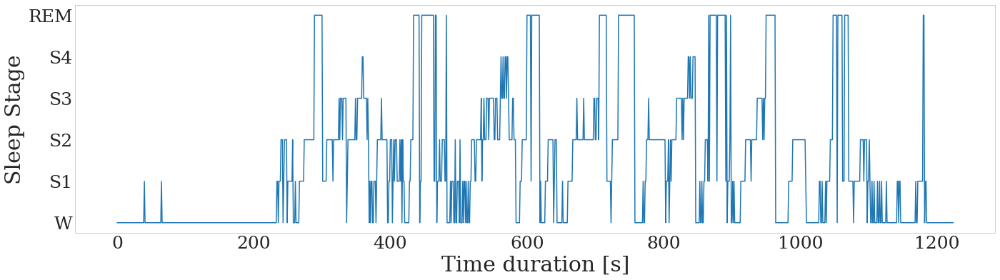

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4601_hypno shape (1309, 14)


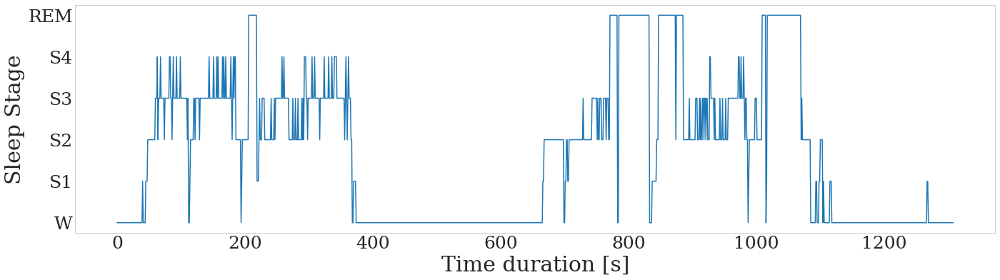

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4602_hypno shape (1126, 14)


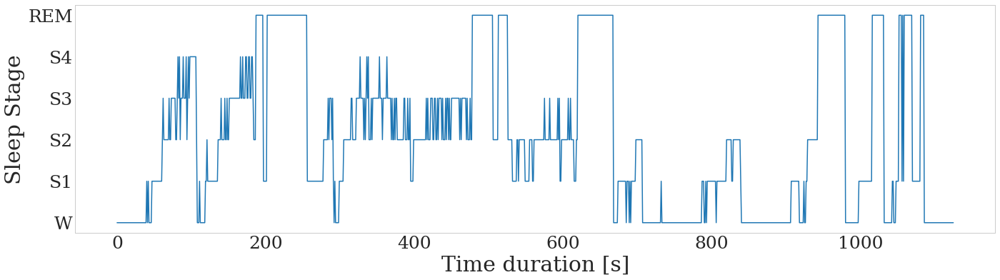

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4611_hypno shape (1063, 14)


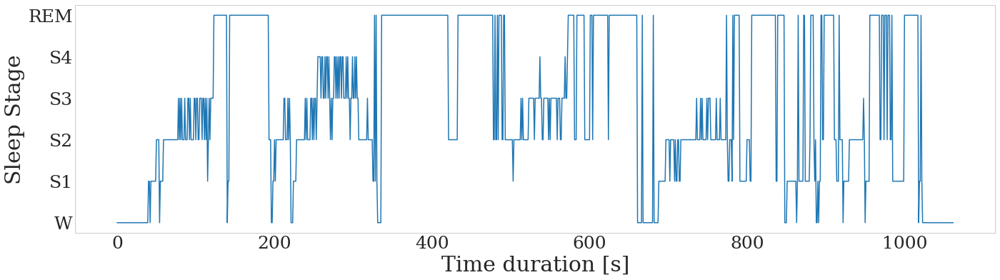

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4612_hypno shape (1022, 14)


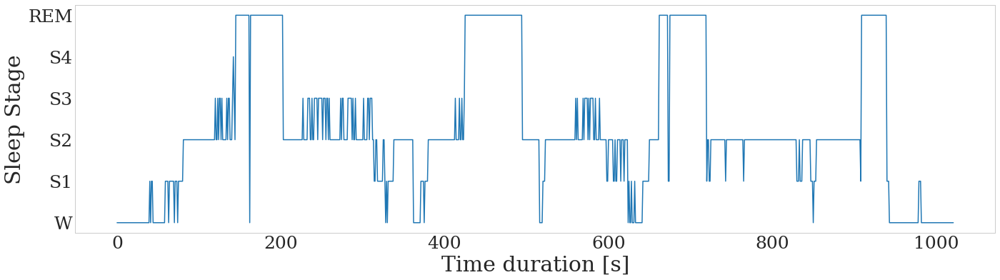

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4621_hypno shape (1405, 14)


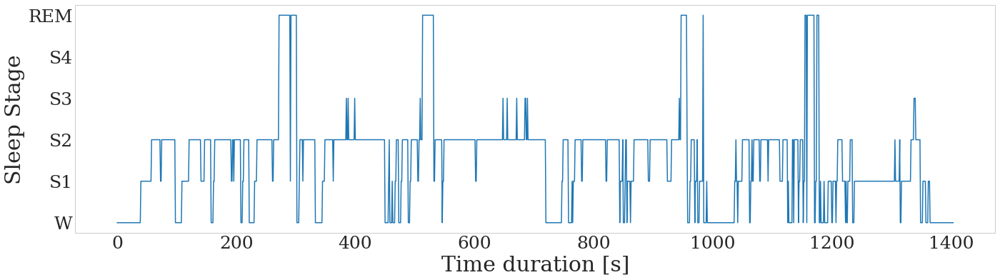

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4622_hypno shape (1783, 14)


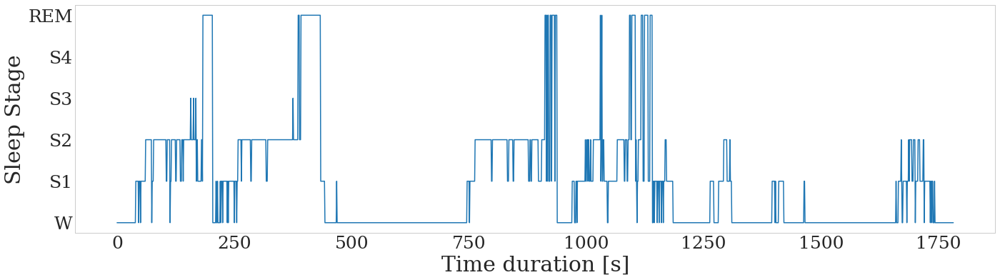

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4631_hypno shape (1023, 14)


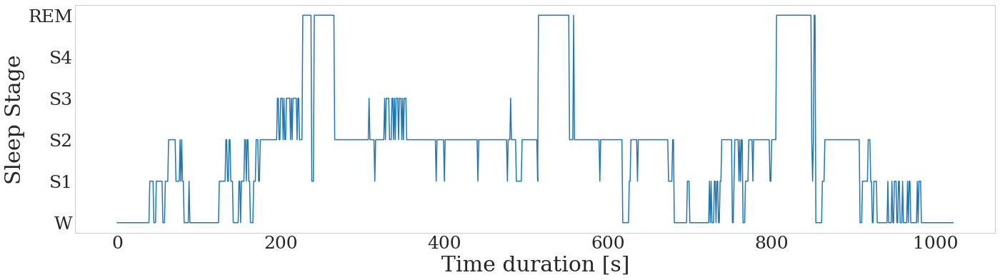

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4632_hypno shape (1067, 14)


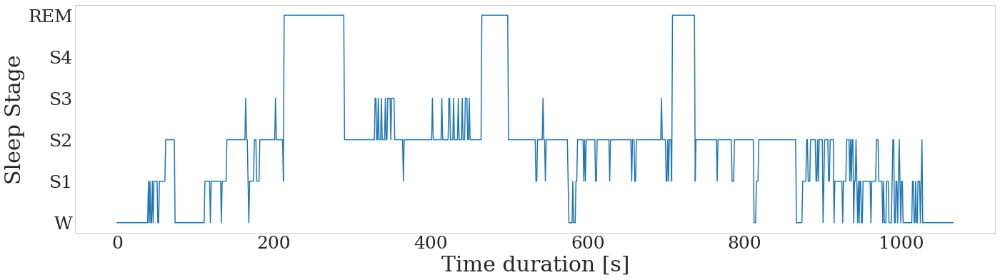

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4641_hypno shape (1231, 14)


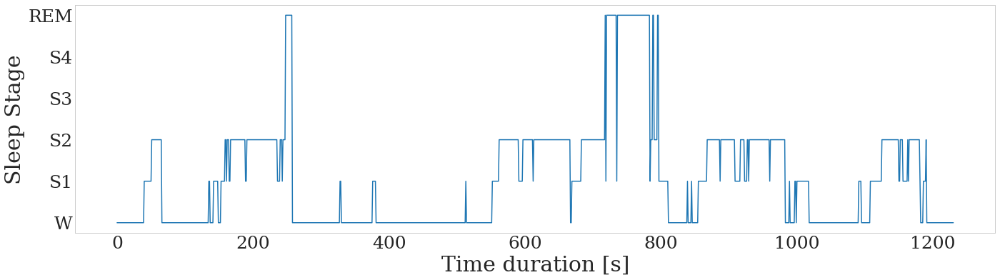

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4642_hypno shape (1211, 14)


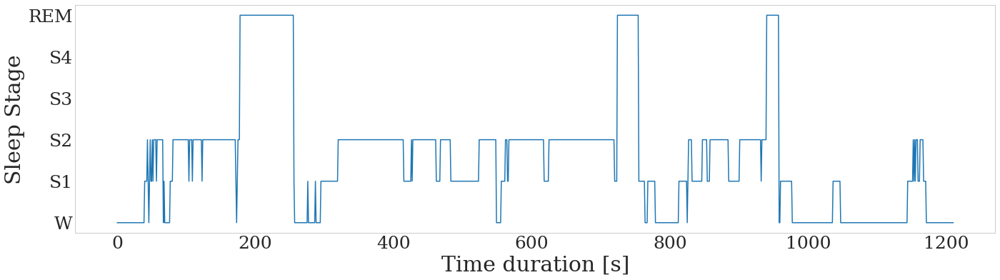

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4651_hypno shape (2092, 14)


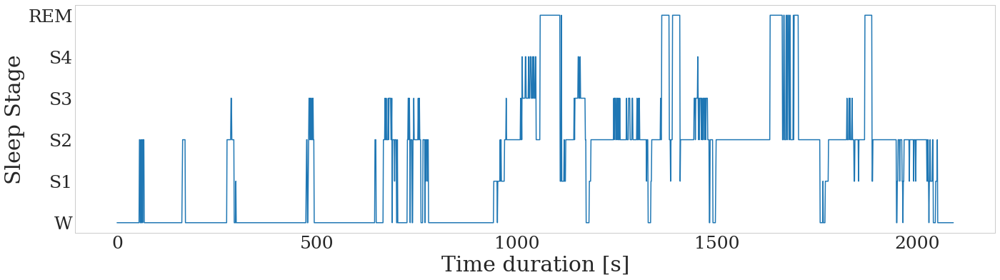

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4652_hypno shape (1891, 14)


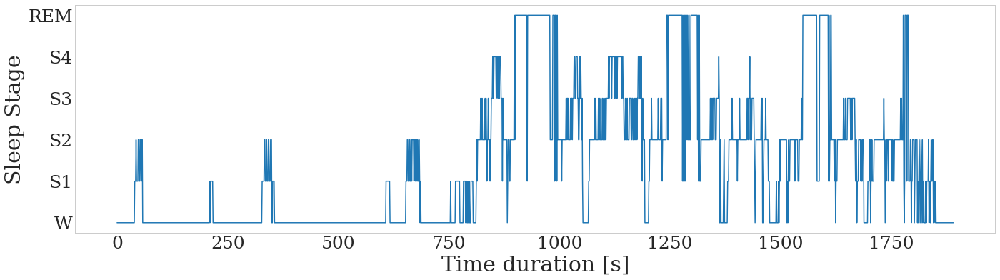

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4661_hypno shape (1232, 14)


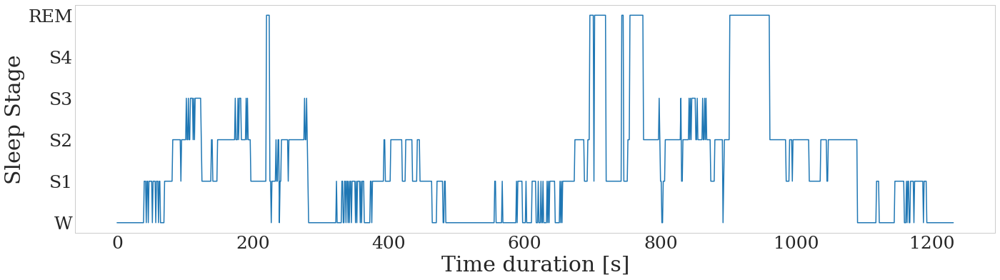

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4662_hypno shape (1254, 14)


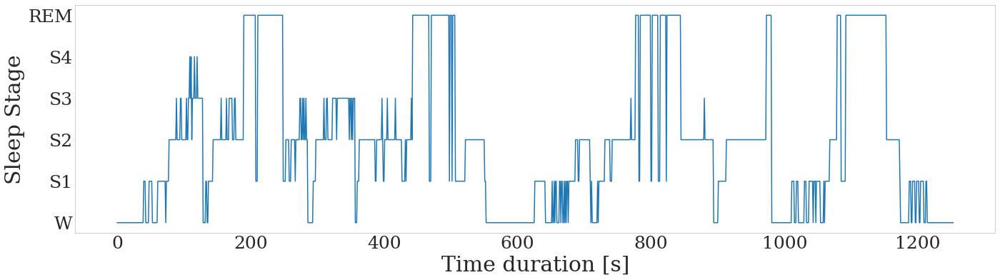

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4671_hypno shape (1196, 14)


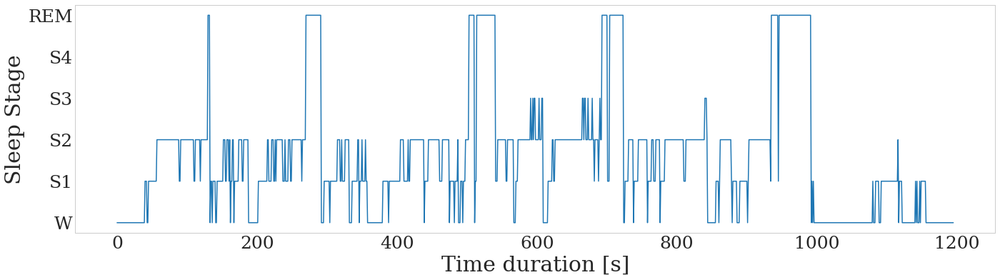

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4672_hypno shape (981, 14)


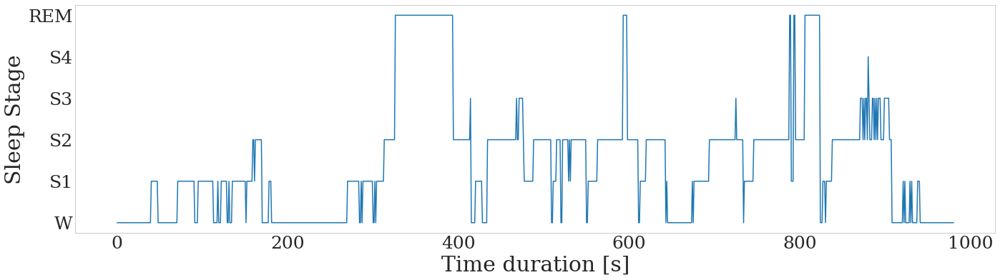

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4701_hypno shape (1406, 14)


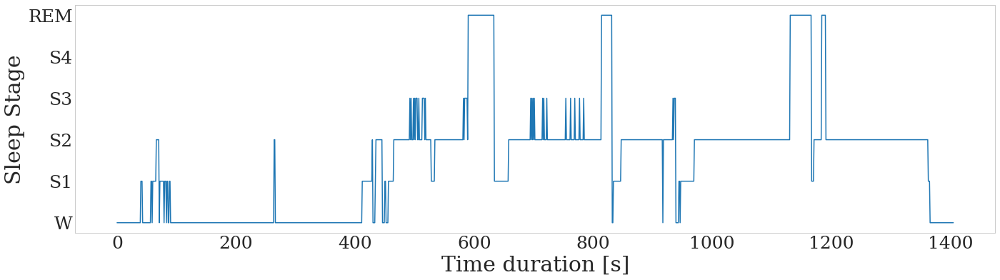

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4702_hypno shape (914, 14)


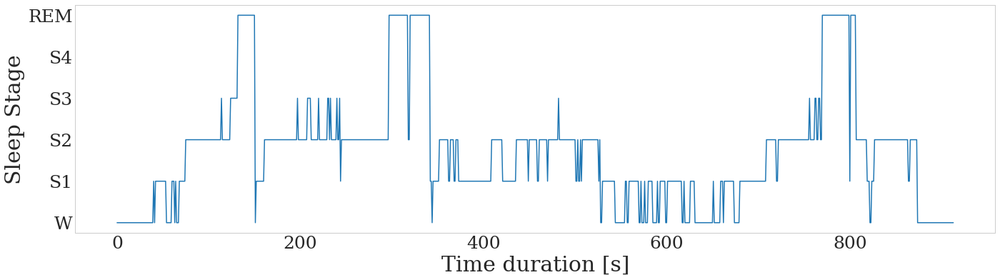

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4711_hypno shape (1373, 14)


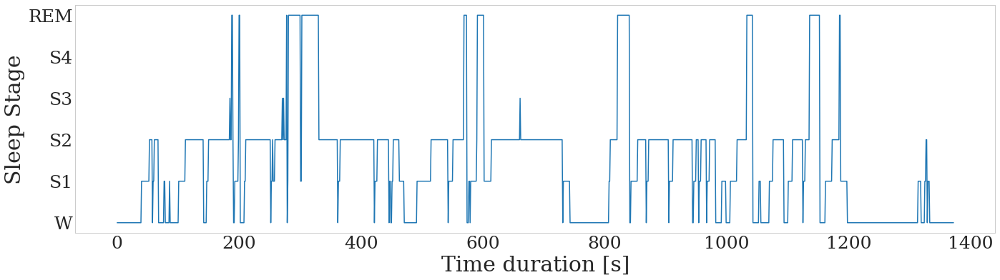

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4712_hypno shape (1201, 14)


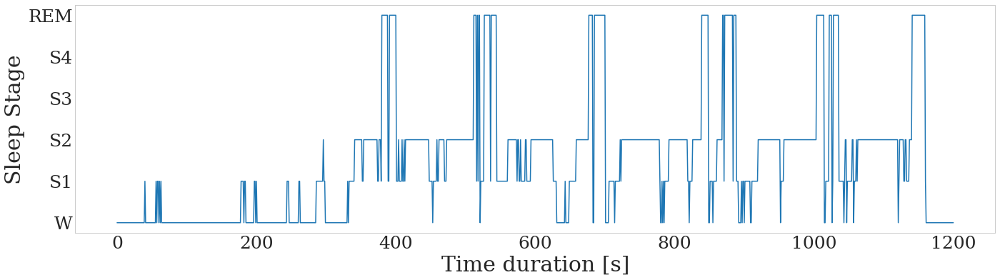

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4721_hypno shape (991, 14)


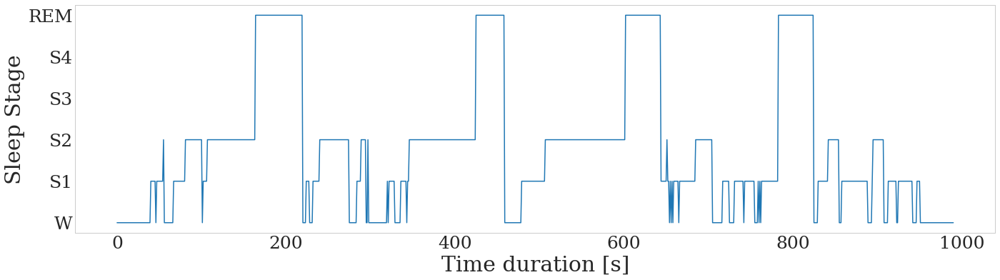

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4722_hypno shape (1090, 14)


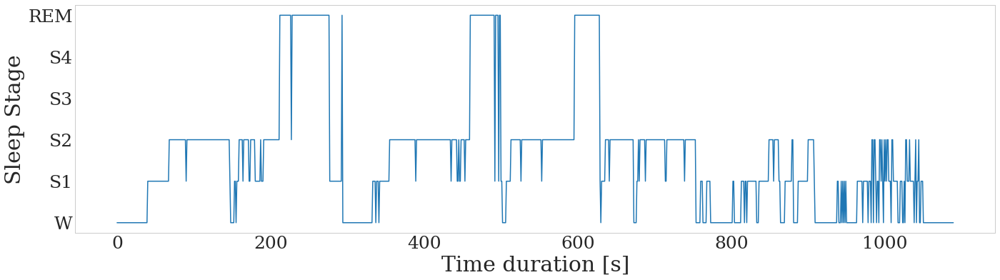

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4731_hypno shape (944, 14)


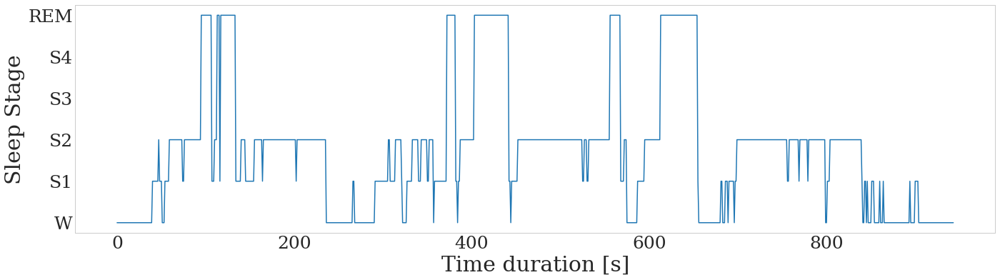

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4732_hypno shape (2332, 14)


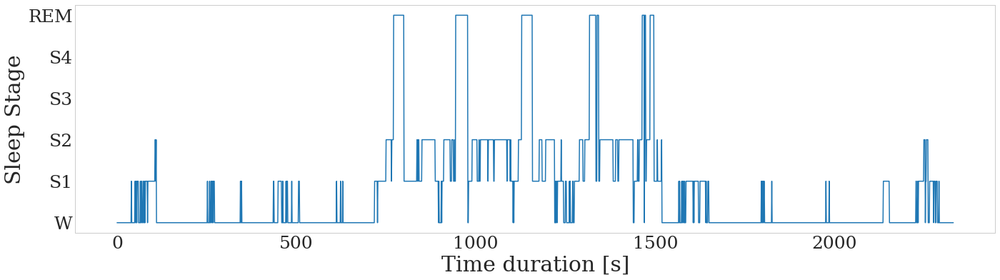

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4741_hypno shape (1396, 14)


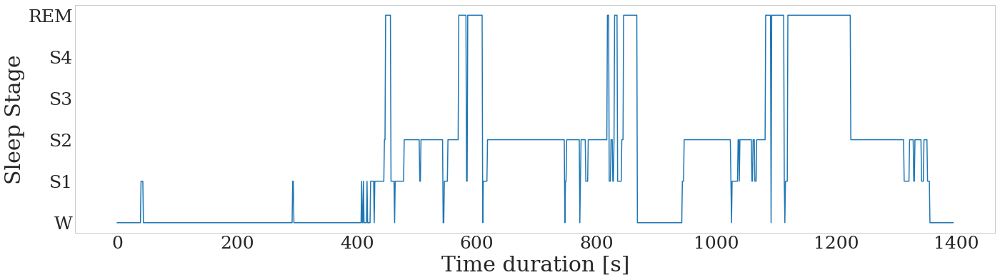

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4742_hypno shape (1023, 14)


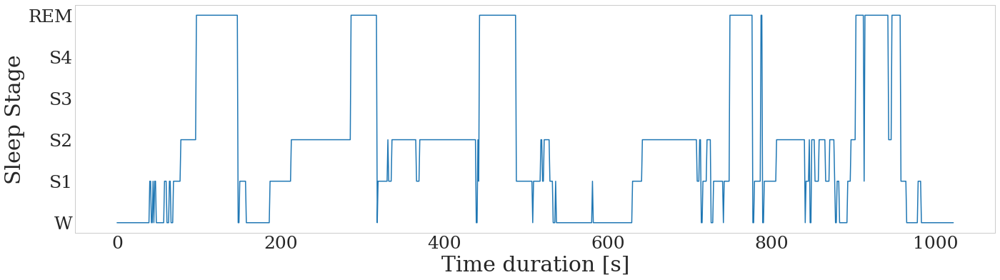

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4751_hypno shape (1139, 14)


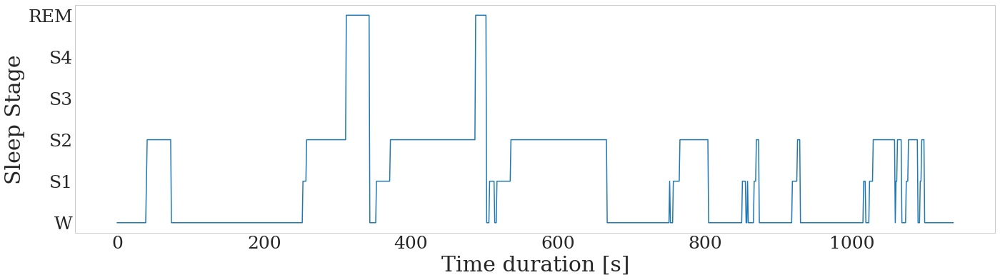

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4752_hypno shape (1009, 14)


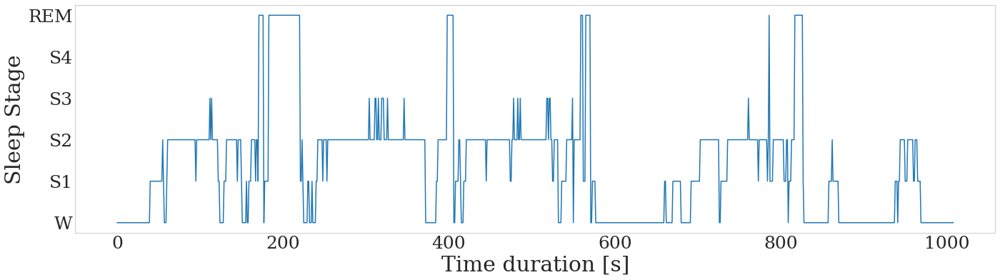

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4761_hypno shape (1017, 14)


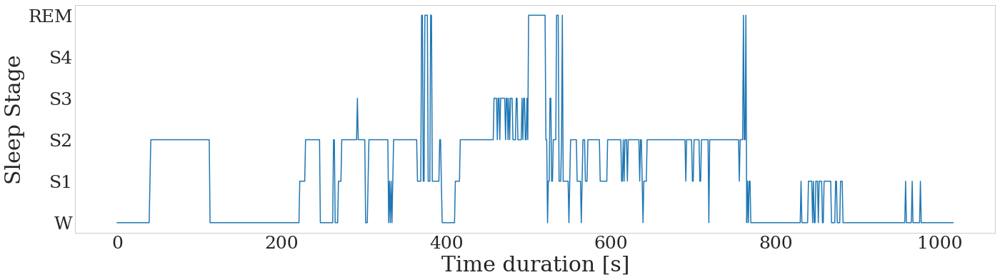

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4762_hypno shape (1436, 14)


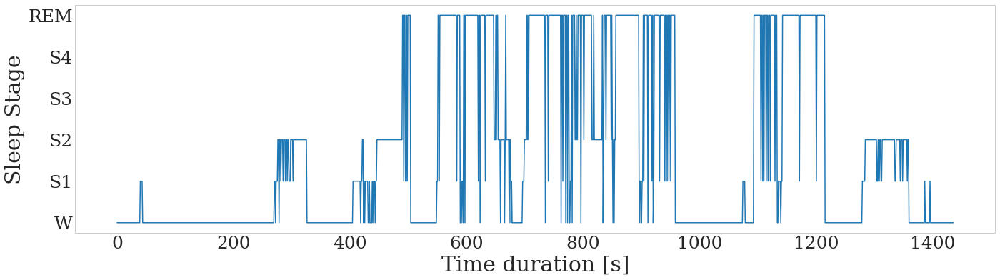

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4771_hypno shape (1285, 14)


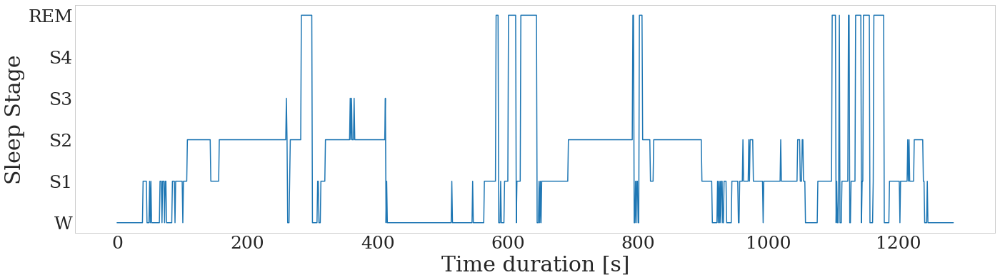

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4772_hypno shape (1284, 14)


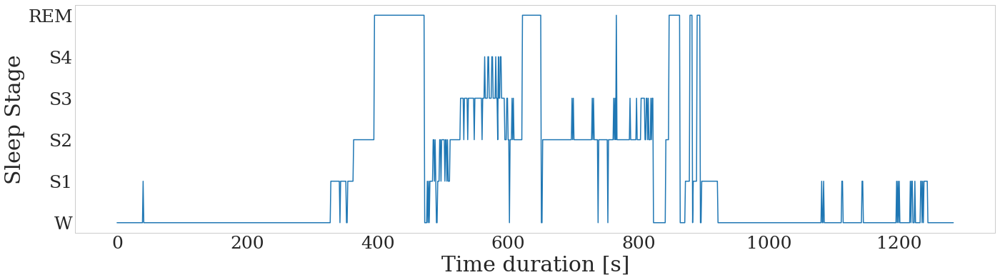

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4801_hypno shape (1201, 14)


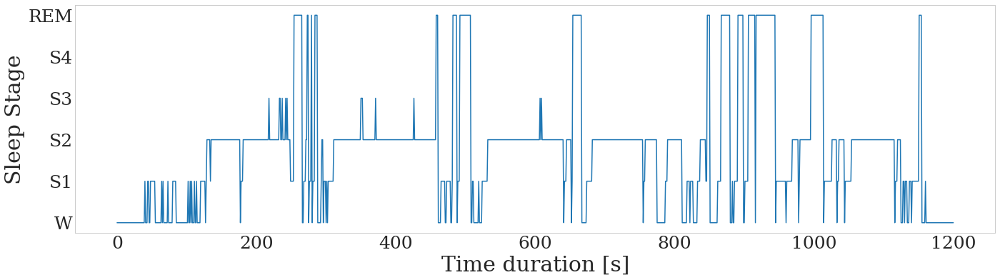

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4802_hypno shape (1189, 14)


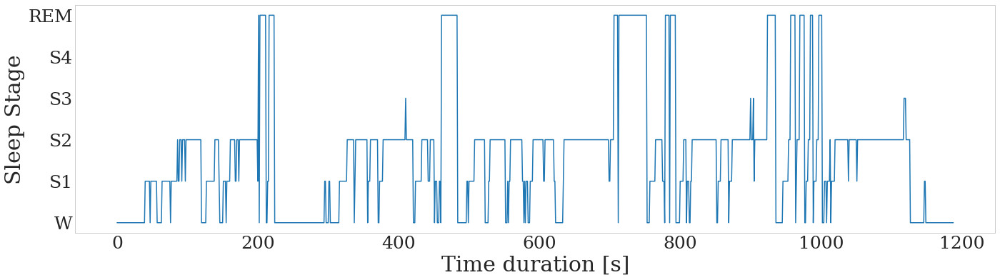

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4811_hypno shape (1253, 14)


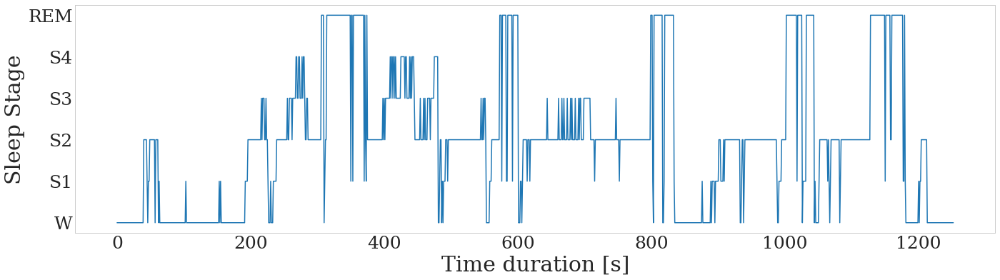

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4812_hypno shape (1145, 14)


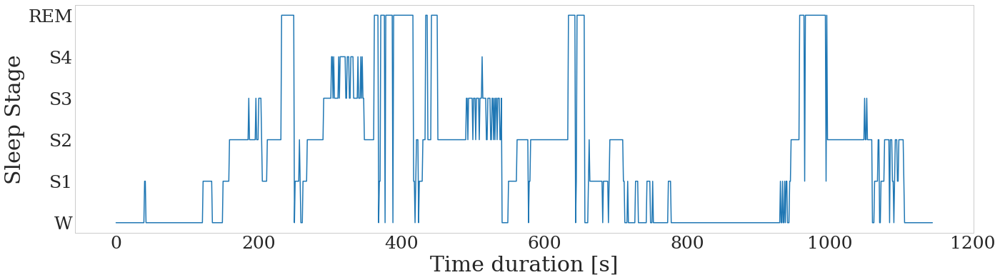

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4821_hypno shape (988, 14)


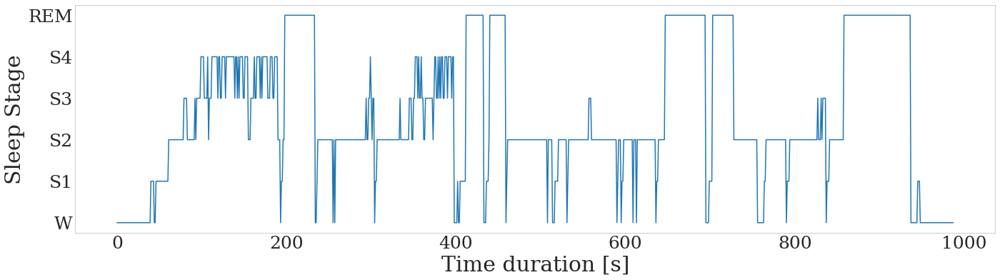

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/SC4822_hypno shape (1326, 14)


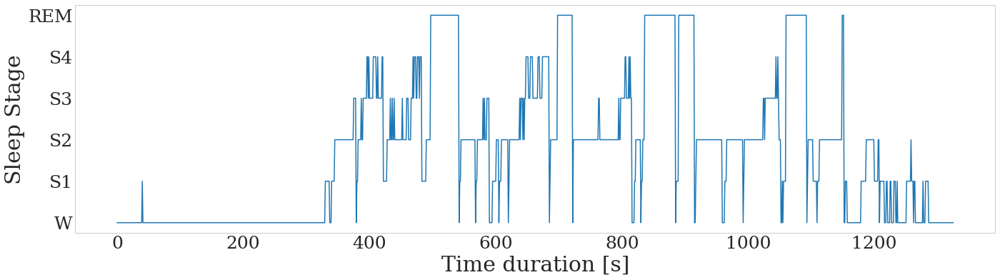

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7011_hypno shape (1091, 14)


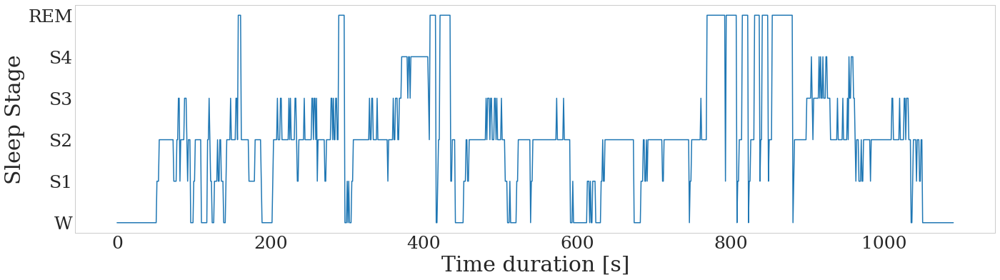

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7012_hypno shape (1039, 14)


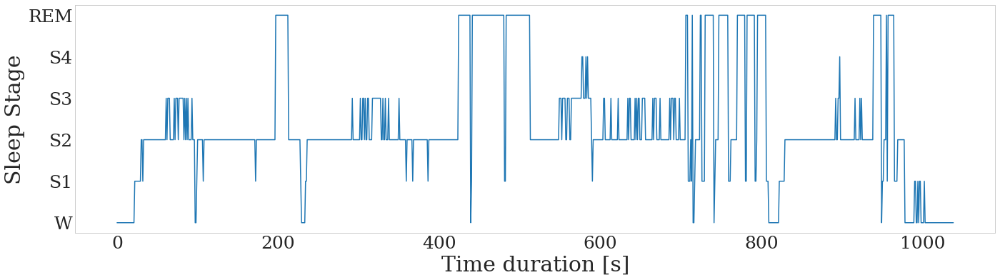

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7021_hypno shape (919, 14)


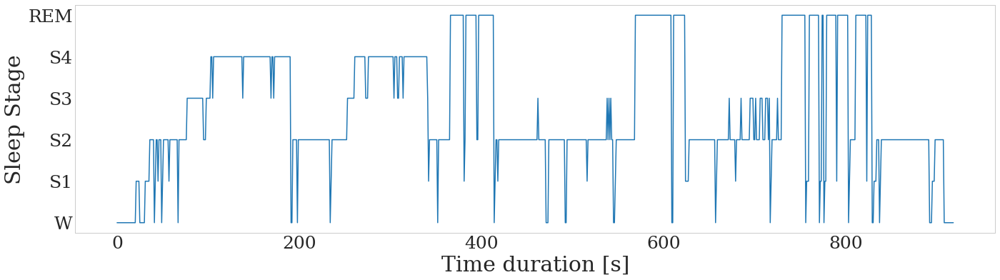

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7022_hypno shape (943, 14)


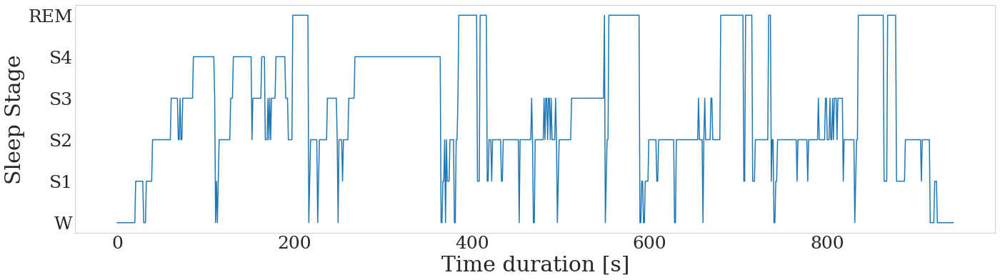

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7041_hypno shape (1007, 14)


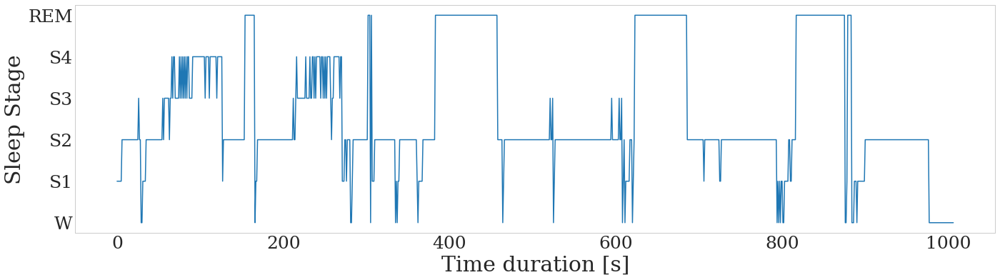

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7042_hypno shape (1130, 14)


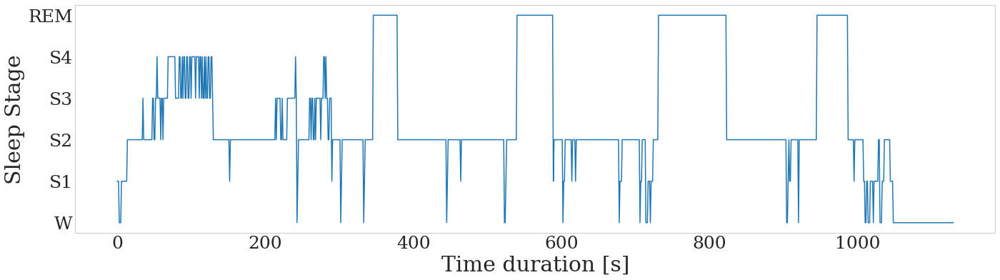

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7051_hypno shape (1017, 14)


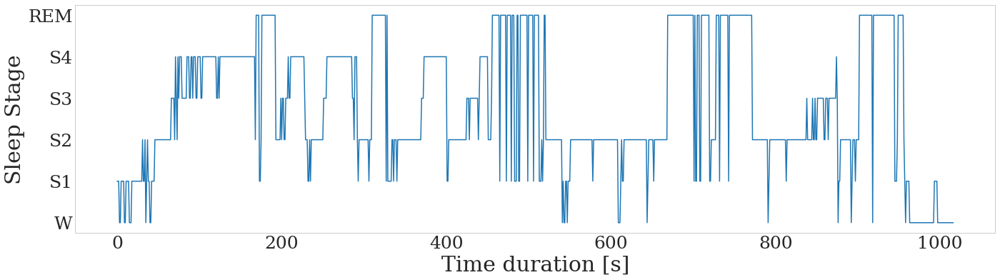

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7052_hypno shape (1033, 14)


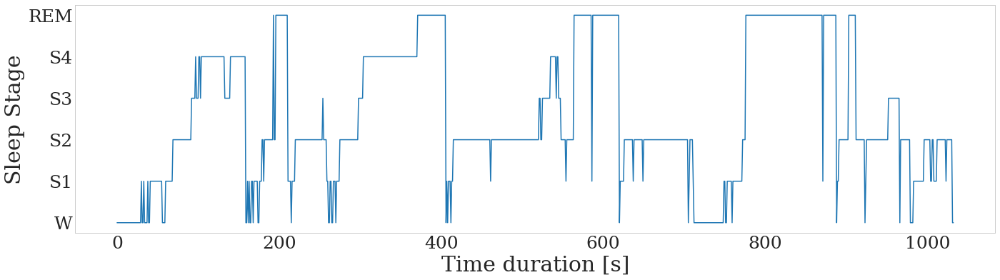

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7061_hypno shape (1007, 14)


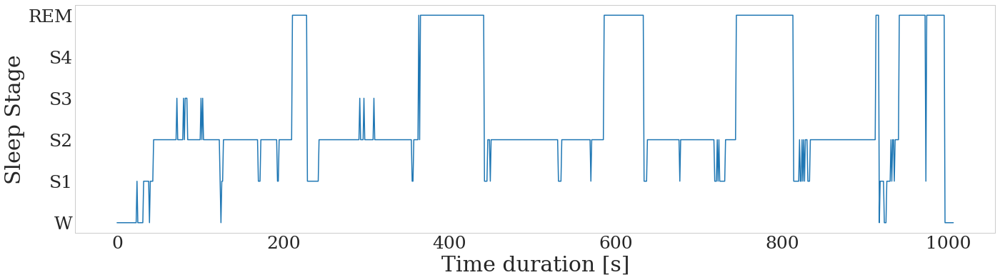

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7062_hypno shape (951, 14)


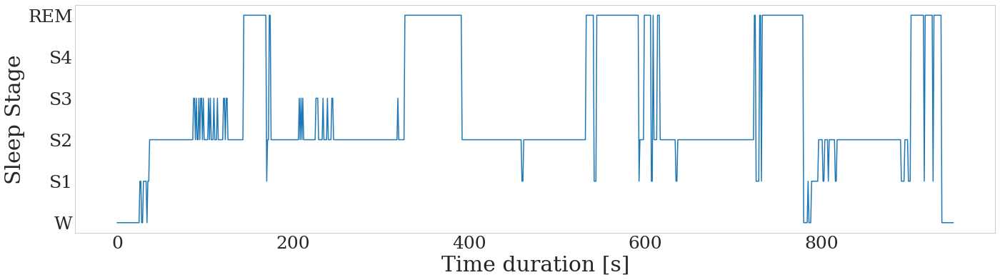

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7071_hypno shape (820, 14)


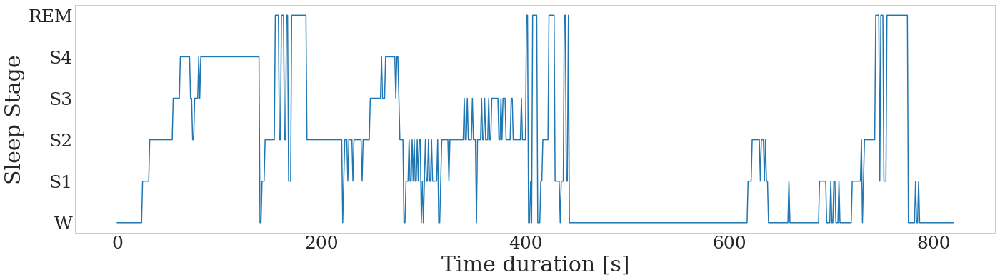

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7072_hypno shape (914, 14)


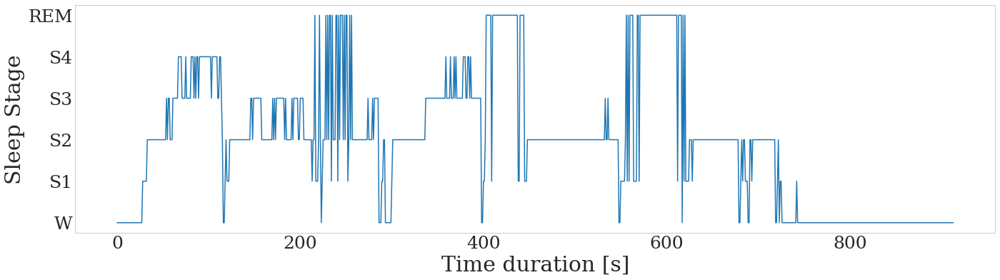

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7081_hypno shape (966, 14)


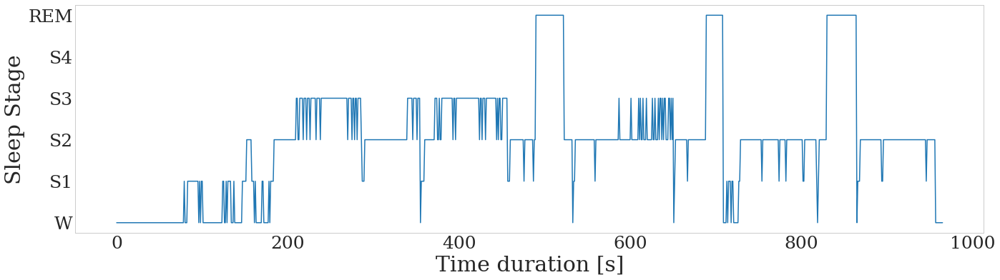

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7082_hypno shape (930, 14)


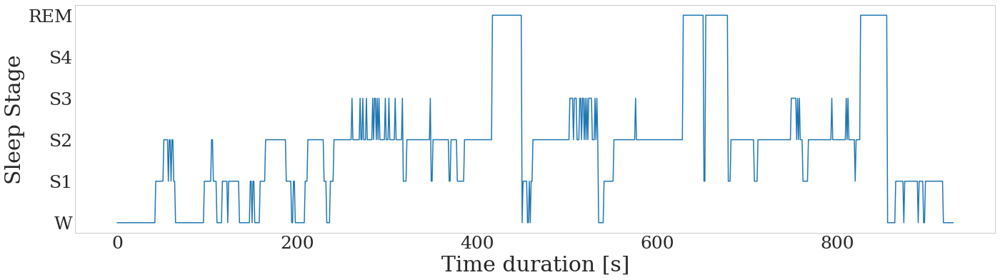

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7091_hypno shape (942, 14)


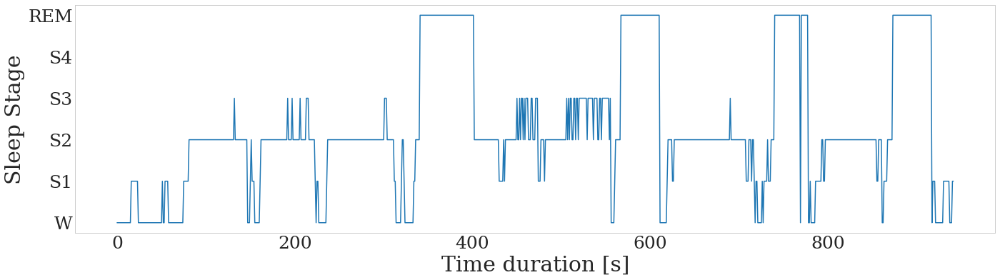

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7092_hypno shape (922, 14)


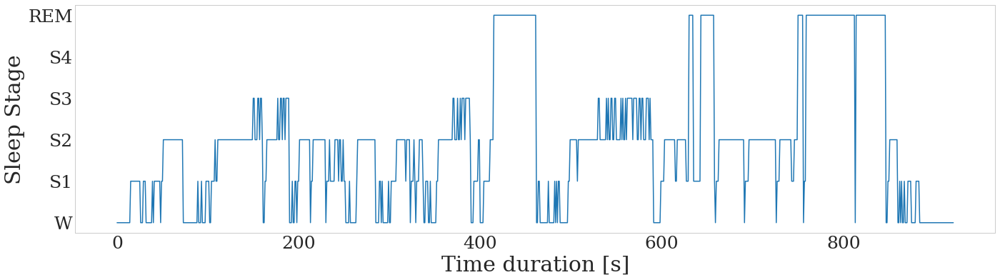

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7101_hypno shape (1048, 14)


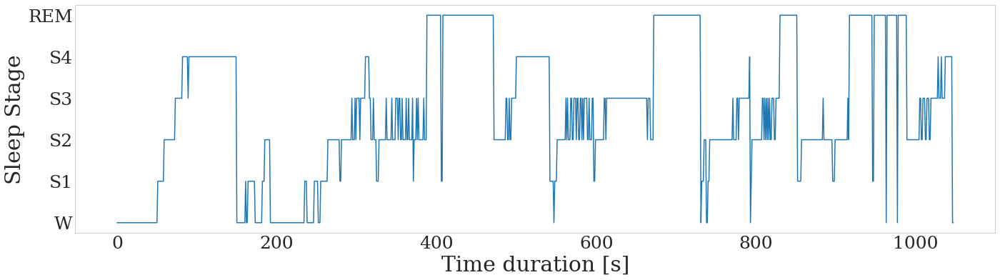

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7102_hypno shape (985, 14)


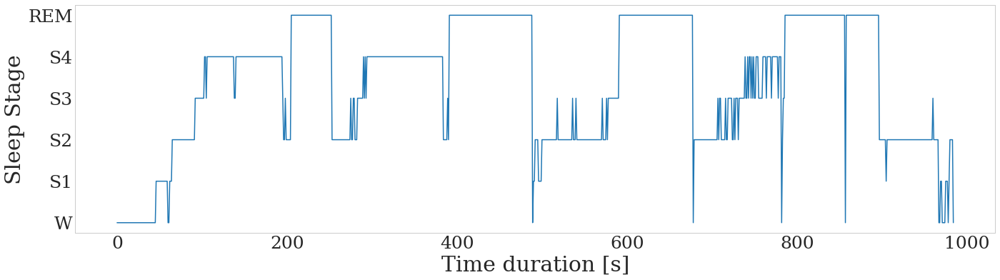

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7111_hypno shape (1022, 14)


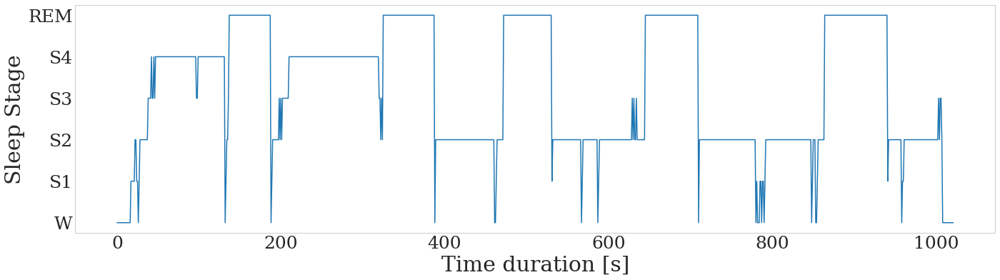

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7112_hypno shape (985, 14)


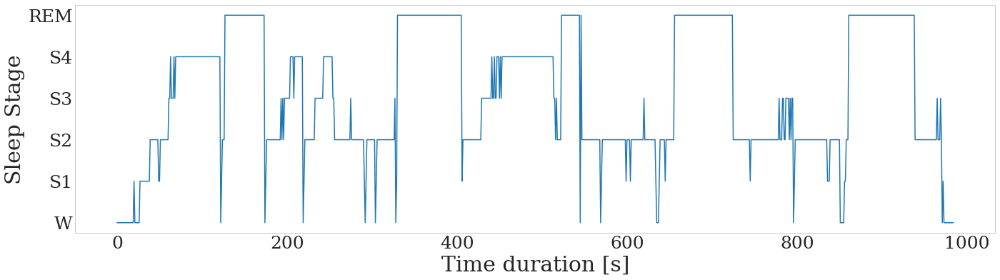

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7121_hypno shape (1034, 14)


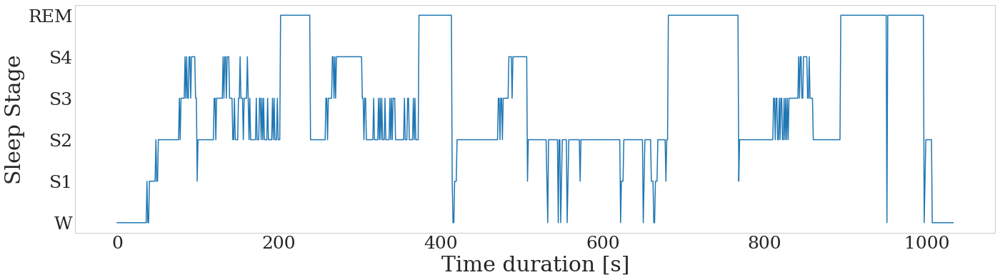

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7122_hypno shape (968, 14)


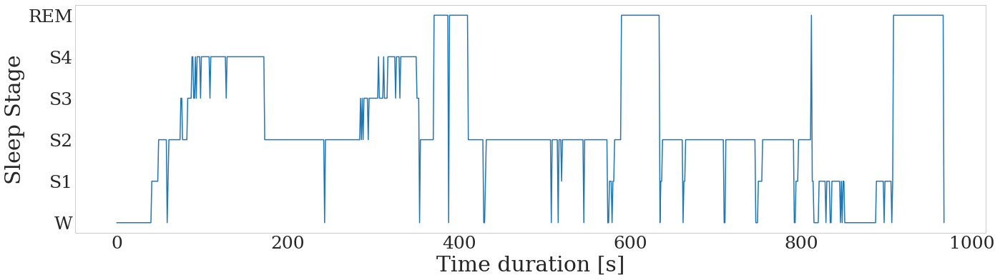

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7131_hypno shape (858, 14)


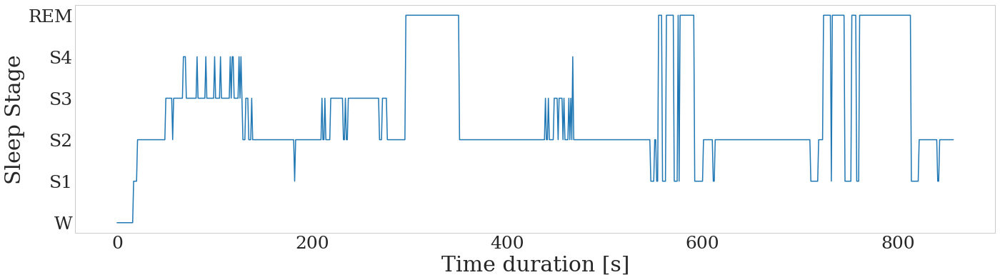

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7132_hypno shape (851, 14)


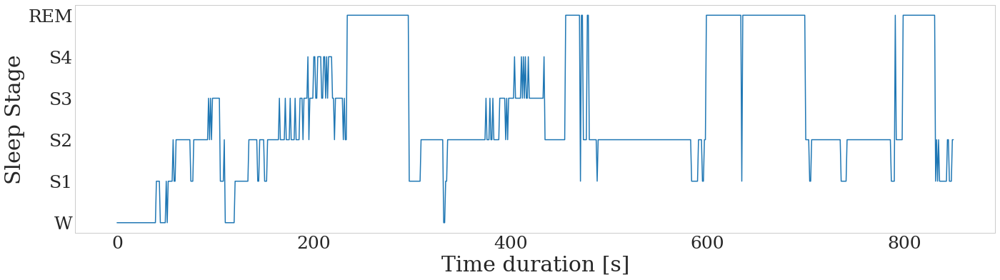

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7141_hypno shape (861, 14)


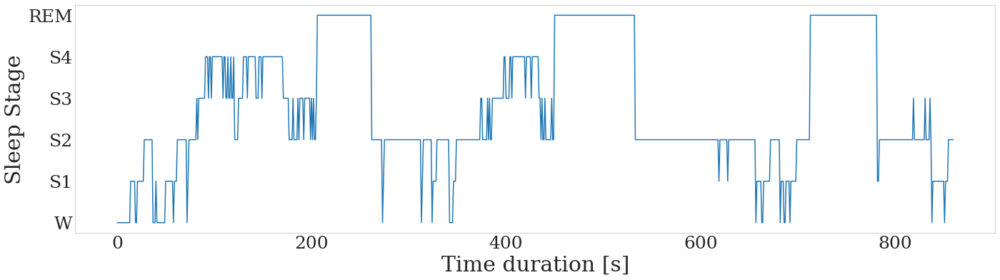

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7142_hypno shape (881, 14)


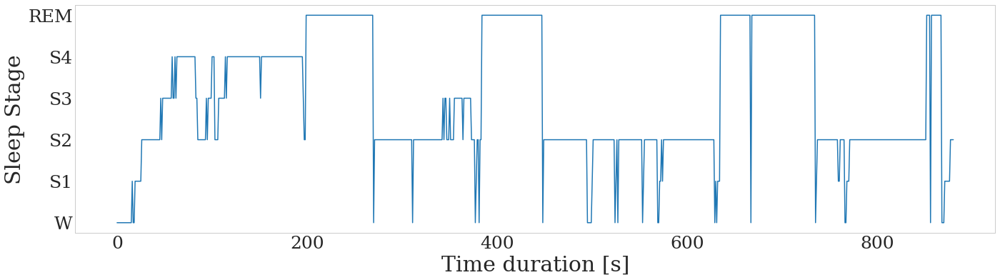

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7151_hypno shape (896, 14)


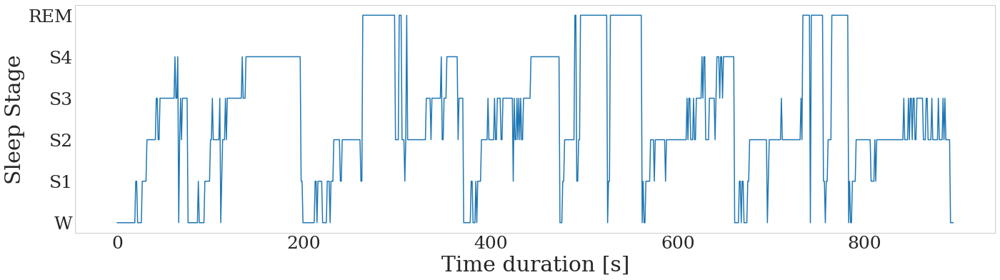

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7152_hypno shape (1044, 14)


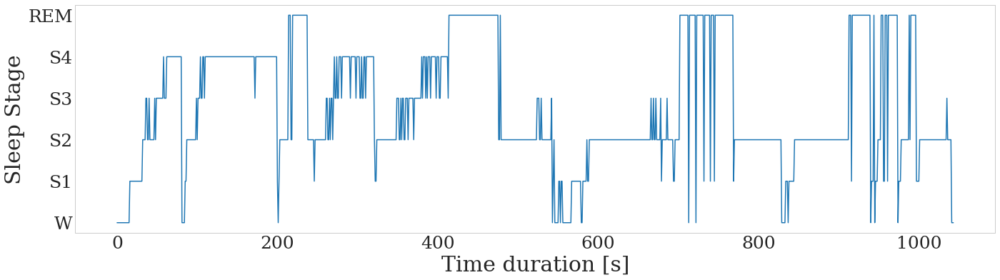

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7161_hypno shape (1056, 14)


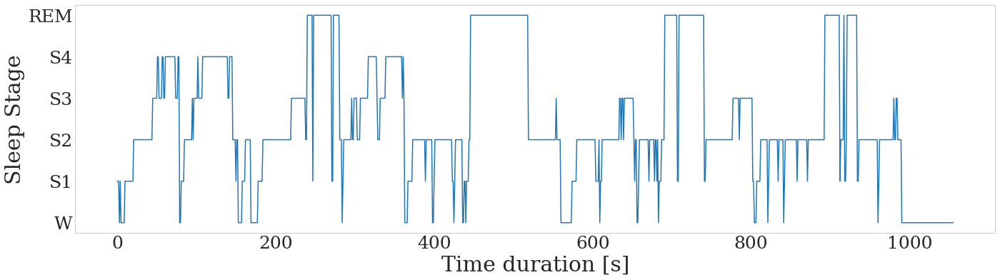

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7162_hypno shape (987, 14)


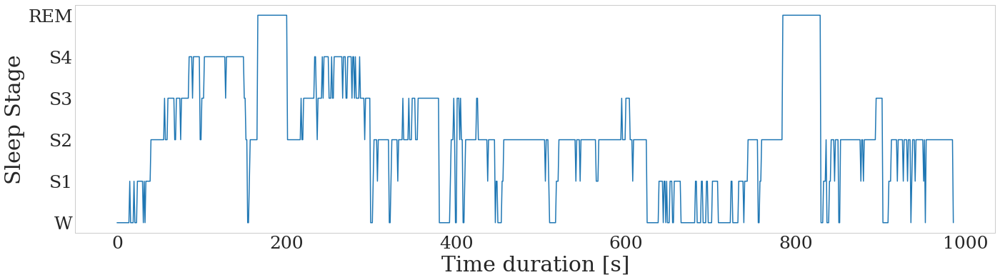

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7171_hypno shape (964, 14)


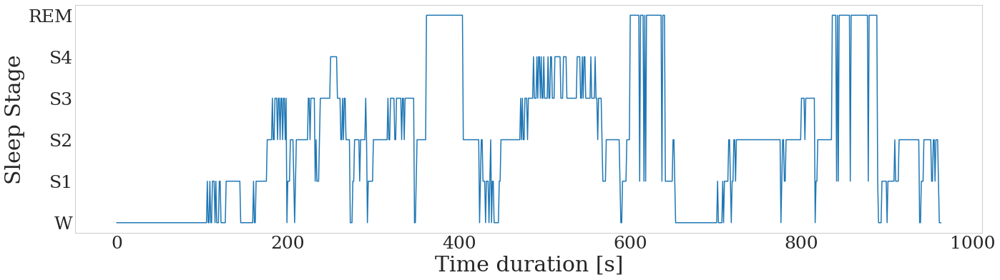

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7172_hypno shape (1005, 14)


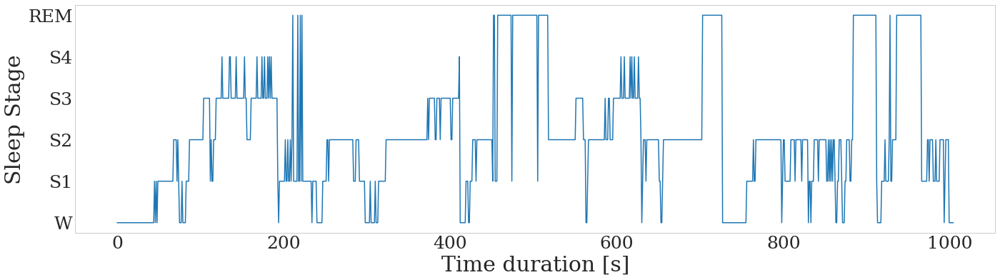

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7181_hypno shape (958, 14)


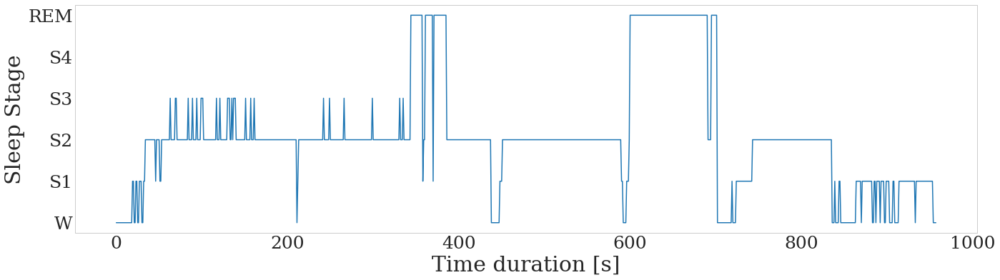

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7182_hypno shape (966, 14)


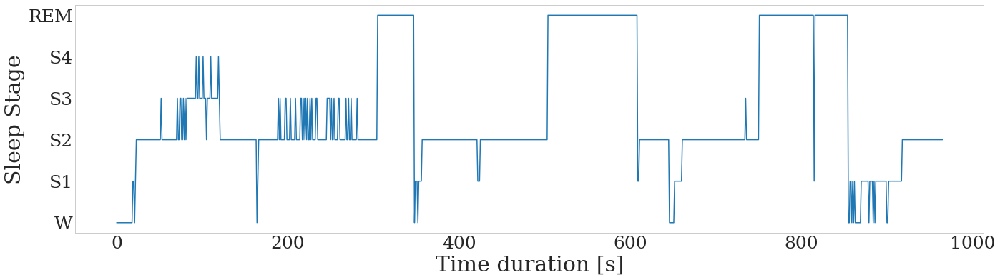

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7191_hypno shape (954, 14)


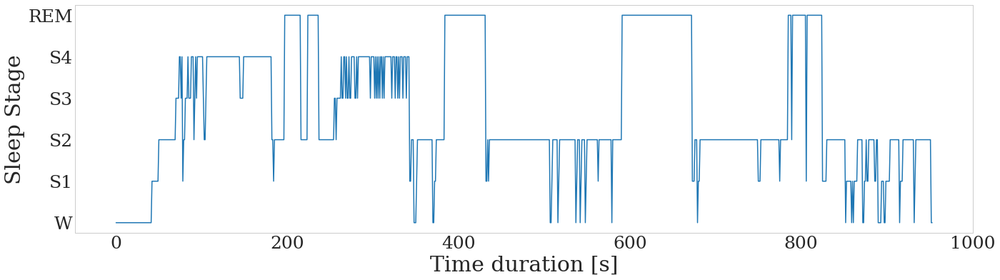

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7192_hypno shape (930, 14)


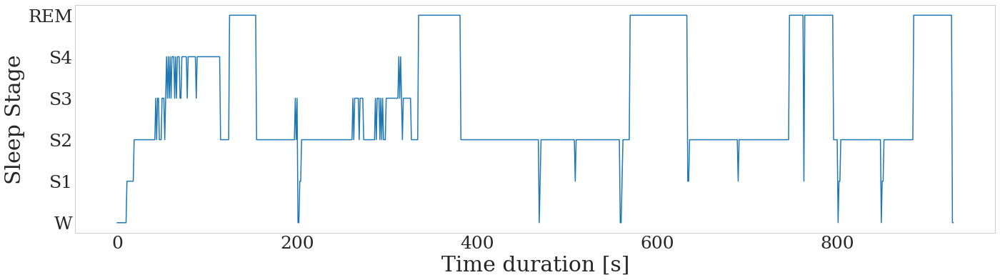

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7201_hypno shape (923, 14)


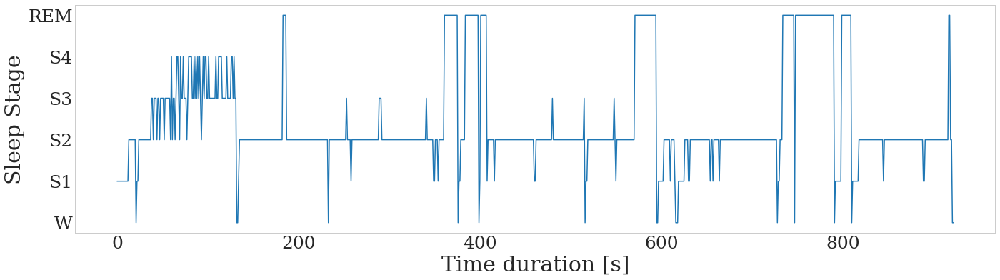

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7202_hypno shape (899, 14)


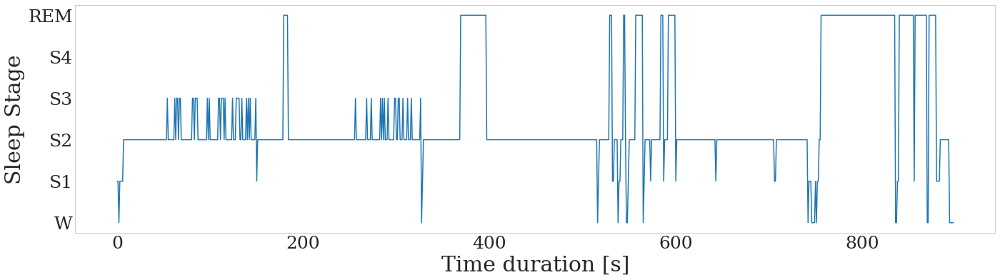

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7211_hypno shape (1076, 14)


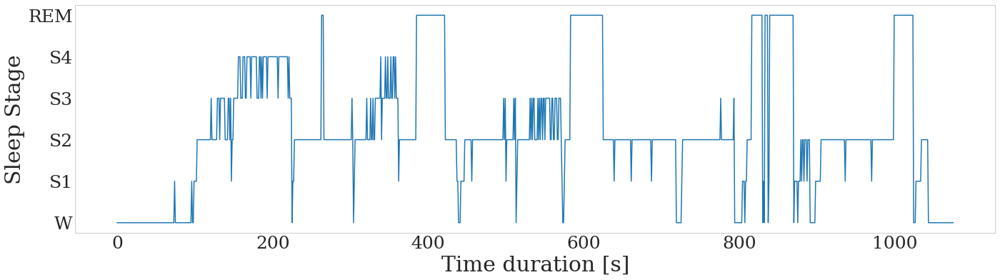

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7212_hypno shape (1009, 14)


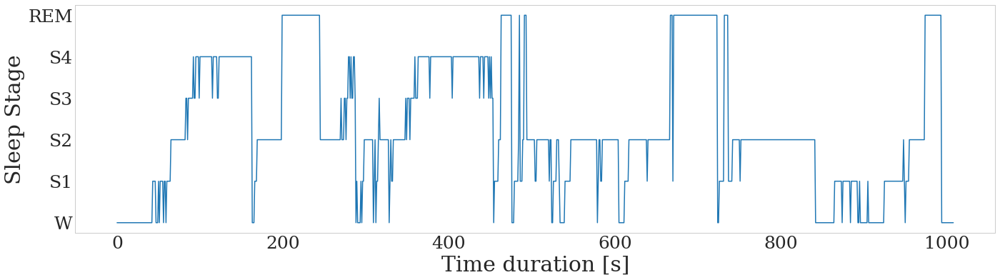

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7221_hypno shape (1032, 14)


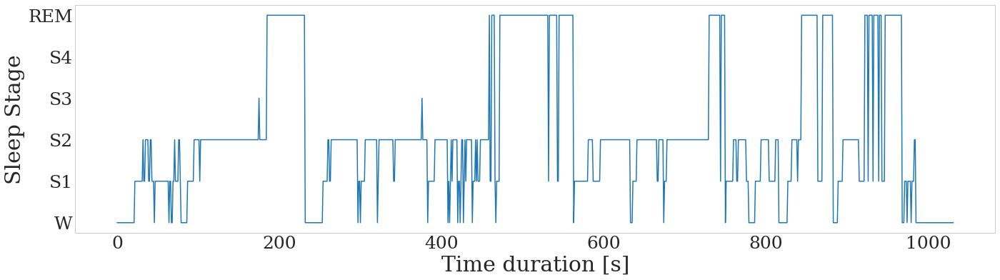

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7222_hypno shape (950, 14)


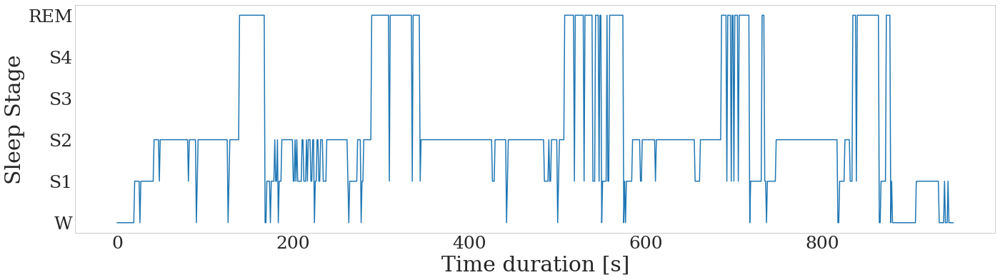

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7241_hypno shape (1023, 14)


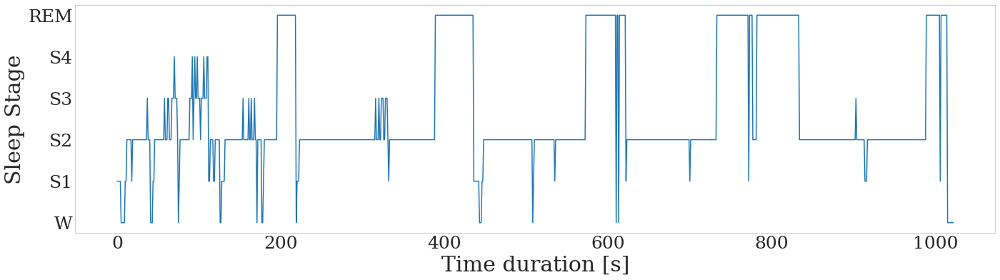

====== ./Results/Sleep_EDFX/STP_From_All_Stages/Hypnograms_TrimW/ST7242_hypno shape (939, 14)


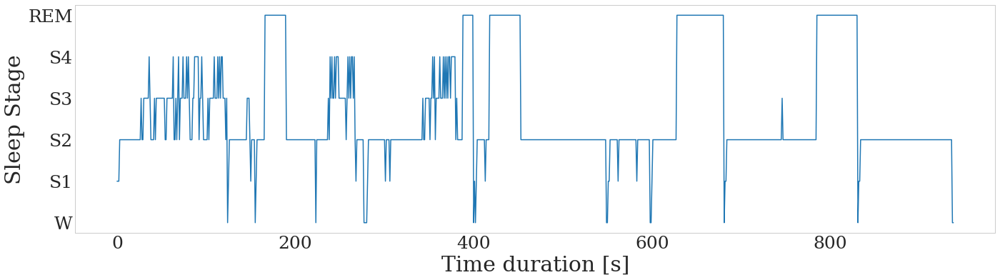

In [638]:
draw_all_hypnograms()

##### Check the annotation symbols in all files

In [639]:
# for annot_csv in list_of_annot_csvs:
#     annot_df = pd.read_csv(annot_csv)
#     print(annot_csv, annot_df["Sleep Stage"].unique())

### Sample hypnogram

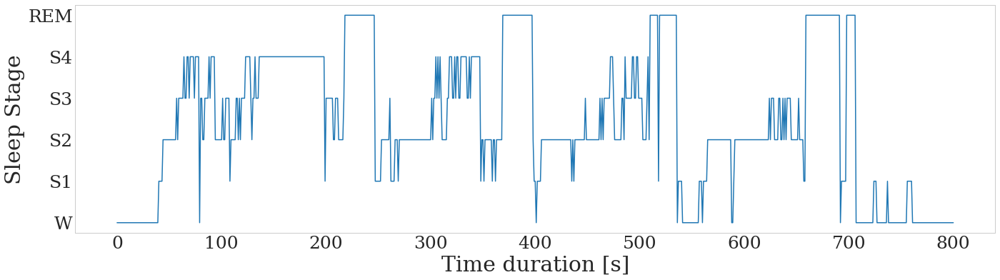

In [640]:
# list_of_files[0]
save_file_name_test, annot_df_test = get_annot_data_for_hypnogram(all_annot_df, "SC4001") 
draw_hypnogram(save_file_name_test, annot_df_test) 

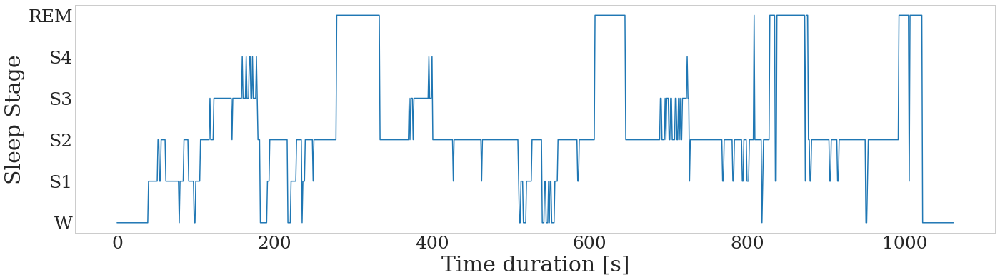

In [641]:
# list_of_files[3]
save_file_name_test, annot_df_test = get_annot_data_for_hypnogram(all_annot_df, "SC4011") 
draw_hypnogram(save_file_name_test, annot_df_test) 

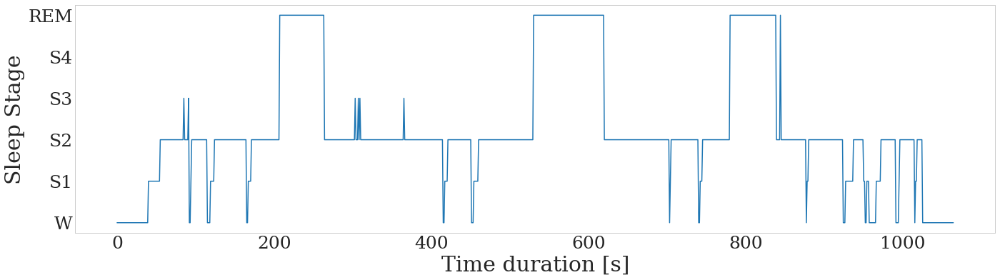

In [642]:
# list_of_files[3]
save_file_name_test, annot_df_test = get_annot_data_for_hypnogram(all_annot_df, "SC4101") 
draw_hypnogram(save_file_name_test, annot_df_test) 

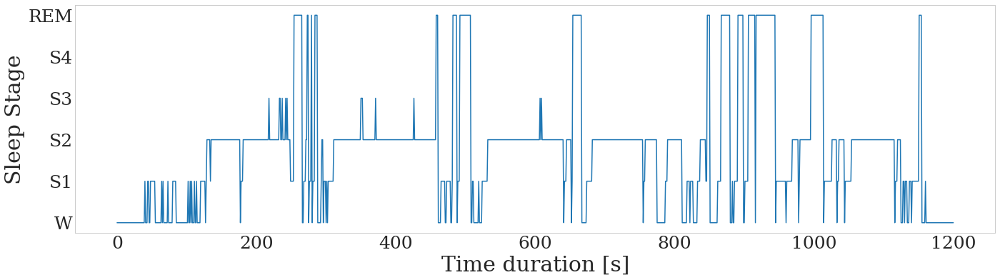

In [643]:
# list_of_files[92]
save_file_name_test, annot_df_test = get_annot_data_for_hypnogram(all_annot_df, "SC4801") 
draw_hypnogram(save_file_name_test, annot_df_test) 

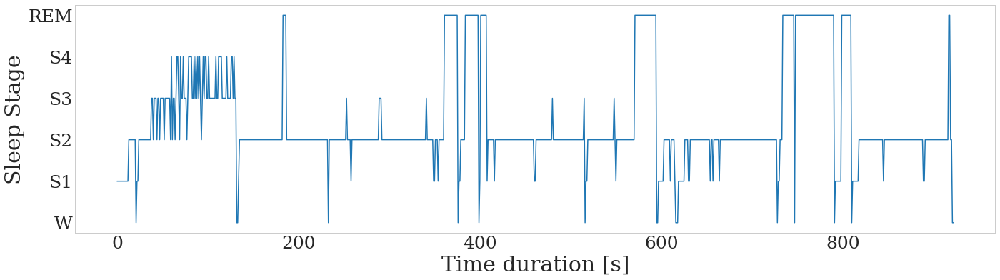

In [644]:
save_file_name_test, annot_df_test = get_annot_data_for_hypnogram(all_annot_df, "ST7201") #all_annot_df[all_annot_df['Category']=='ST7201']
draw_hypnogram(save_file_name_test, annot_df_test) 

## Sequence calculation - Save annotation sequence

In [645]:
all_annot_df

,File_Name,Category,Subject_ID,Sleep_Stage,Position,Time,Event,Duration,Location,Event_Type,Event_Level,Signal_Type,Channel
0,SC4001,n,400,W,Unknown,08:10:30,SLEEP-S0,30.0,Unknown,SLEEP,S0,EC,Unknown
1,SC4001,n,400,W,Unknown,08:11:00,SLEEP-S0,30.0,Unknown,SLEEP,S0,EC,Unknown
2,SC4001,n,400,W,Unknown,08:11:30,SLEEP-S0,30.0,Unknown,SLEEP,S0,EC,Unknown
3,SC4001,n,400,W,Unknown,08:12:00,SLEEP-S0,30.0,Unknown,SLEEP,S0,EC,Unknown
4,SC4001,n,400,W,Unknown,08:12:30,SLEEP-S0,30.0,Unknown,SLEEP,S0,EC,Unknown
...,...,...,...,...,...,...,...,...,...,...,...,...,...
207974,ST7242,n,724,S2,Unknown,08:06:30,SLEEP-S2,30.0,Unknown,SLEEP,S2,JO,Unknown
207975,ST7242,n,724,S2,Unknown,08:07:00,SLEEP-S2,30.0,Unknown,SLEEP,S2,JO,Unknown
207976,ST7242,n,724,S2,Unknown,08:07:30,SLEEP-S2,30.0,Unknown,SLEEP,S2,JO,Unknown
207977,ST7242,n,724,W,Unknown,08:08:00,SLEEP-S0,30.0,Unknown,SLEEP,S0,JO,Unknown


In [24]:
def sequencer_func(x):
    result = {"File_Name":x["File_Name"].head(1).values[0], "Category":x["Category"].head(1).values[0], "Subject_ID":x["Subject_ID"].head(1).values[0], "Sleep_Stage":x["Sleep_Stage_Number"].head(1).values[0], "Stage_Count": x.shape[0], "Duration": x["Duration"].sum()}
    return pd.Series(result, name="index")


def get_annotation_sequence(annot_df):
    # print(annot_df.columns)
    annot_df["Sleep_Stage_Number"] = annot_df["Sleep_Stage"]
    annot_df["Count"] = (annot_df["Sleep_Stage_Number"] != annot_df["Sleep_Stage_Number"].shift(1)).cumsum()
    annot_seq_df = annot_df.groupby("Count",as_index=False).apply(sequencer_func)
    annot_seq_df.insert(loc=4, column="Sequence", value=annot_seq_df["Count"].values.tolist())
    annot_seq_df = annot_seq_df.drop("Count", axis=1)
    return annot_seq_df

In [25]:
def get_all_annotation_sequence():
    all_annot_seq_df = pd.DataFrame()
    for file in list_of_files:
        save_file_name, annot_df = get_annot_data_for_hypnogram(all_annot_df, file) 
        annot_seq_df = get_annotation_sequence(annot_df.copy()) 
        
        # print('======', save_file_name, "shape", annot_seq_df.shape)
        all_annot_seq_df = pd.concat([all_annot_seq_df, annot_seq_df], axis=0)
    return all_annot_seq_df

In [646]:
all_annot_seq_df = get_all_annotation_sequence()
all_annot_seq_df

index,File_Name,Category,Subject_ID,Sequence,Sleep_Stage,Stage_Count,Duration
0,SC4001,n,400,1,W,40,1200.0
1,SC4001,n,400,2,S1,4,120.0
2,SC4001,n,400,3,S2,13,390.0
3,SC4001,n,400,4,S3,1,30.0
4,SC4001,n,400,5,S2,1,30.0
...,...,...,...,...,...,...,...
141,ST7242,n,724,142,R,46,1380.0
142,ST7242,n,724,143,W,1,30.0
143,ST7242,n,724,144,S1,2,60.0
144,ST7242,n,724,145,S2,103,3090.0


In [647]:
all_annot_seq_df

index,File_Name,Category,Subject_ID,Sequence,Sleep_Stage,Stage_Count,Duration
0,SC4001,n,400,1,W,40,1200.0
1,SC4001,n,400,2,S1,4,120.0
2,SC4001,n,400,3,S2,13,390.0
3,SC4001,n,400,4,S3,1,30.0
4,SC4001,n,400,5,S2,1,30.0
...,...,...,...,...,...,...,...
141,ST7242,n,724,142,R,46,1380.0
142,ST7242,n,724,143,W,1,30.0
143,ST7242,n,724,144,S1,2,60.0
144,ST7242,n,724,145,S2,103,3090.0


In [648]:
all_annot_seq_df.to_csv(f"{result_directory}/annot_sequence{'_TrimW' if trimW_states else ''}.csv", index=False)

## Transition analysis

### Annotation to transition sequence (successive annotations are merged) conversion

In [26]:
all_annot_seq_df = pd.read_csv(f"{result_directory}/annot_sequence{'_TrimW' if trimW_states else ''}.csv")
all_annot_seq_df

,File_Name,Category,Subject_ID,Sequence,Sleep_Stage,Stage_Count,Duration
0,SC4001,n,400,1,W,1021,30630.0
1,SC4001,n,400,2,S1,4,120.0
2,SC4001,n,400,3,S2,13,390.0
3,SC4001,n,400,4,S3,1,30.0
4,SC4001,n,400,5,S2,1,30.0
...,...,...,...,...,...,...,...
28336,ST7242,n,724,142,R,46,1380.0
28337,ST7242,n,724,143,W,1,30.0
28338,ST7242,n,724,144,S1,2,60.0
28339,ST7242,n,724,145,S2,103,3090.0


In [27]:
all_annot_seq_df.Sleep_Stage.unique()

array(['W', 'S1', 'S2', 'S3', 'S4', 'R'], dtype=object)

In [651]:
# df['prev_value'] = df.groupby('object')['value'].shift(-1, fill_value="X")
# all_annot_seq_df['next_code'] = all_annot_seq_df.groupby('Subject_ID')['Sleep_Stage'].shift(-1, fill_value="W")
all_annot_seq_df['next_code'] = all_annot_seq_df.groupby('File_Name')['Sleep_Stage'].shift(-1, fill_value="W")
# all_annot_seq_df['next_code'] = all_annot_seq_df.groupby('File_Name')['Sleep_Stage'].shift(-1)
# all_annot_seq_df['next_code'] = all_annot_seq_df.groupby('Subject_ID')['Stages'].shift(-1).fillna('END')
all_annot_seq_df

,File_Name,Category,Subject_ID,Sequence,Sleep_Stage,Stage_Count,Duration,next_code
0,SC4001,n,400,1,W,40,1200.0,S1
1,SC4001,n,400,2,S1,4,120.0,S2
2,SC4001,n,400,3,S2,13,390.0,S3
3,SC4001,n,400,4,S3,1,30.0,S2
4,SC4001,n,400,5,S2,1,30.0,S3
...,...,...,...,...,...,...,...,...
27878,ST7242,n,724,142,R,46,1380.0,W
27879,ST7242,n,724,143,W,1,30.0,S1
27880,ST7242,n,724,144,S1,2,60.0,S2
27881,ST7242,n,724,145,S2,103,3090.0,W


In [652]:
all_annot_seq_df["next_code"].unique()

array(['S1', 'S2', 'S3', 'S4', 'W', 'R'], dtype=object)

In [653]:
# all_annot_seq_df[(all_annot_seq_df['File_Name']=="ST7201")]

In [654]:
all_annot_seq_df.insert(loc=5, column="Next_Stage", value=all_annot_seq_df["next_code"].values.tolist())
all_annot_seq_df = all_annot_seq_df.drop("next_code", axis=1)
all_annot_seq_df

,File_Name,Category,Subject_ID,Sequence,Sleep_Stage,Next_Stage,Stage_Count,Duration
0,SC4001,n,400,1,W,S1,40,1200.0
1,SC4001,n,400,2,S1,S2,4,120.0
2,SC4001,n,400,3,S2,S3,13,390.0
3,SC4001,n,400,4,S3,S2,1,30.0
4,SC4001,n,400,5,S2,S3,1,30.0
...,...,...,...,...,...,...,...,...
27878,ST7242,n,724,142,R,W,46,1380.0
27879,ST7242,n,724,143,W,S1,1,30.0
27880,ST7242,n,724,144,S1,S2,2,60.0
27881,ST7242,n,724,145,S2,W,103,3090.0


In [655]:
all_annot_seq_df.Next_Stage.unique()

array(['S1', 'S2', 'S3', 'S4', 'W', 'R'], dtype=object)

In [656]:
# all_annot_seq_df[(all_annot_seq_df['File_Name']=="ST7201")]

In [657]:
all_annot_seq_df = get_annotation_sequence(all_annot_seq_df.copy())
all_annot_seq_df

index,File_Name,Category,Subject_ID,Sequence,Sleep_Stage,Stage_Count,Duration
0,SC4001,n,400,1,W,1,1200.0
1,SC4001,n,400,2,S1,1,120.0
2,SC4001,n,400,3,S2,1,390.0
3,SC4001,n,400,4,S3,1,30.0
4,SC4001,n,400,5,S2,1,30.0
...,...,...,...,...,...,...,...
27696,ST7242,n,724,27697,R,1,1380.0
27697,ST7242,n,724,27698,W,1,30.0
27698,ST7242,n,724,27699,S1,1,60.0
27699,ST7242,n,724,27700,S2,1,3090.0


In [658]:
all_annot_seq_df['Sequence'] = all_annot_seq_df.groupby(['File_Name']).cumcount(['Sequence']).values
all_annot_seq_df

index,File_Name,Category,Subject_ID,Sequence,Sleep_Stage,Stage_Count,Duration
0,SC4001,n,400,0,W,1,1200.0
1,SC4001,n,400,1,S1,1,120.0
2,SC4001,n,400,2,S2,1,390.0
3,SC4001,n,400,3,S3,1,30.0
4,SC4001,n,400,4,S2,1,30.0
...,...,...,...,...,...,...,...
27696,ST7242,n,724,141,R,1,1380.0
27697,ST7242,n,724,142,W,1,30.0
27698,ST7242,n,724,143,S1,1,60.0
27699,ST7242,n,724,144,S2,1,3090.0


In [659]:
## Test for the repeatation of sequence
# tseq = all_annot_seq_df['Sleep_Stage'].values.tolist()
tseq = all_annot_seq_df['Sleep_Stage'].values.tolist() 
tseq

for i, v in enumerate(tseq[:-1]):
    if v==tseq[i+1]:
        print(i, v, all_annot_seq_df['Next_Stage'].values.tolist()[i], tseq[i+1]) 

In [660]:
sleep_stage_labels

['W', 'S1', 'S2', 'S3', 'S4', 'REM']

In [661]:
all_annot_seq_df.to_csv(f"{result_directory}/transition_sequence{'_TrimW' if trimW_states else ''}.csv", index=False)

### Transition count, probability and duration matrix

In [28]:
def fill_missing_stage_values(arr, indx):
    
    for i in indx: 
        column_to_be_added = np.zeros(arr.shape[0])
        arr2 = np.insert(arr, i, column_to_be_added, axis=0)
        column_to_be_added = np.zeros(arr.shape[0]+1)
        arr3 = np.insert(arr2, i, column_to_be_added, axis=1)
        arr = arr3.copy()
    return arr.tolist()


def create_zero_matrix(n, st):
    mat = None
    if n>1:
        inmat = [0 for _ in range(n)]
        tmpmat = inmat.copy()
        for i in range(st-1):
            inmat = [copy.deepcopy(inmat) for _ in range(n)]
        mat = copy.deepcopy(inmat)
    else:
        print("\nNo transition is set...")
    return mat

def create_transition_matrix(transitions, duration, tran_count, tran_dura, tran_step=2):
    # now get transition count and duration
    #print(transitions, duration, zip(transitions[:-(tran_step-1)], duration[:-(tran_step-1)]))
    #for i, (t, d) in enumerate(zip(transitions[:-(tran_step-1)], duration[:-(tran_step-1)])):
    for i, (t, d) in enumerate(zip(transitions[:-(tran_step-1)], duration[:-(tran_step-1)])):
        stats = f"{t}"
        # print(i, t, d)        
        tmp_count = f"tran_count[{t}]" 
        tmp_dura = f"tran_dura[{t}]" 
        for j in range(tran_step-1):
            nt = transitions[i+j+1]
            stats += f"->{nt}"
            # print(nt)            
            tmp_count = f"{tmp_count}[{nt}]"
            tmp_dura = f"{tmp_dura}[{nt}]"  
            if (tran_step>2) and j<(tran_step-2):
                d += duration[i+j+1]
            
        exec(f"tc={tmp_count}+{1}")
        exec(f"td={tmp_dura}+{d}")  
        tmp_count = f"{tmp_count}={tmp_count}+{1}"
        tmp_dura = f"{tmp_dura}={tmp_dura}+{d}"  
        # print("=======\n", tmp_count, tmp_dura)
        exec(tmp_count)
        exec(tmp_dura)           
        # exec("print(tc)")
        # print(t, stats, tmp_count, tmp_dura, "\n================\n")
        # print(stats, tc, td, "\n================\n")
        # print("=======\n", tran_count, tran_dura)
    return tran_count, tran_dura


# #### Probability based on total transition from the same stage 
# def create_transition_probability_for_a_matrix(tran_p):    
#     tran_proba = tran_p.copy() 
#     for row in tran_proba:
#         s = sum(row)
#         if s > 0:
#             row[:] = [f/s for f in row] 
#     return tran_proba


# # #### Probability based on total transition from all the stage 
# def create_transition_probability_for_a_matrix(tran_p): 
#     tran_p = np.array(tran_p) 
# #     tran_proba = np.zeros(tran_p.shape) #.copy() 
#     total_count = tran_p.sum()
#     tran_proba = np.round(tran_p/total_count, 4).tolist() 
# #     for row in tran_proba:
# # #         s = sum(row)
# #         if s > 0:
# #             row[:] = [f/s for f in row] 
#     return tran_proba


# #### Probability based on total transition from all the stage/same stage 
def create_transition_probability_for_a_matrix(tran_p): 
    tran_proba = list()
    if prob_cal_from_all: 
        tran_p = np.array(tran_p) 
        total_count = tran_p.sum()
        tran_proba = np.round(tran_p/total_count, 4).tolist() 
    else: 
        tran_proba = tran_p.copy() 
        for row in tran_proba:
            s = sum(row)
            if s > 0:
                row[:] = [f/s for f in row] 
    return tran_proba


def create_transition_probability(tran_p):    
    tran_proba = []     
    if type(tran_p[0][0])!=list:
        ttp = create_transition_probability_for_a_matrix(tran_p)
        # tran_proba.append(ttp)
        return ttp
    for i, tp in enumerate(tran_p):
        ttp = create_transition_probability(tp)   
        tran_proba.append(ttp)
    return tran_proba


def print_a_matrix(tran_info, decimal):
    # print(tran_info)
    num_digits = len(str( np.amax(np.array(tran_info)) ))
    formatter_str = '{0:'+str(num_digits+4)+'.2f}' if decimal else '{0:'+str(num_digits+2)+'}' 
    for row in tran_info: print(' '.join(formatter_str.format(x) for x in row)) 
        
        
def print_nested_matrix(big_mat, decimal, msg=None):
    if type(big_mat[0][0])!=list:
        print_a_matrix(big_mat, decimal)
        return 
    for i, mat in enumerate(big_mat):
        mm = f"stage{i}->" if not msg else f"{msg}stage{i}->"
        print(mm)
        print_nested_matrix(mat, decimal, msg=mm)        


def print_transition_info(tran_info, decimal=False, tran_step=2): 
    original_sleep_stages = sleep_stage_labels_dict 
    tr_st = "->".join(f"step{i}" for i in range(1, tran_step+1))
    print(f"{tran_step} Step transition ({tr_st}). The index of the data corresponds to the sleep stages: {original_sleep_stages}")
    if tran_step<2:
        print("Wrong transition matrix...")
    else:
        print_nested_matrix(tran_info, decimal)
        


# Markov transition probability matrix
# https://stackoverflow.com/questions/46657221/generating-markov-transition-matrix-in-python#:~:text=In%20order%20to%20obtain%20a,transpose()%20.
def transition_count_and_probability_matrix(all_annot_df, missing_labels, sleep_label_column, duration_column, tran_step=2, show_results=False):
    transitions = all_annot_df[sleep_label_column].values  
    duration = all_annot_df[duration_column].values 
    original_sleep_stages = list(sleep_stage_labels_dict.keys())
    ind = list([original_sleep_stages.index(ss) for ss in missing_labels])
    ind.sort()
    # print("1111---", ind, missing_labels)
    tran_count = None 
    tran_dura = None 
    tran_proba = None
    # n = 1+ max(transitions) #number of states
    n = len(list(sleep_stage_labels_dict.keys()))
    
    tran_count = create_zero_matrix(n, tran_step)
    tran_dura = create_zero_matrix(n, tran_step)
    # print("000---", n, no_of_stats_in_transition, np.unique(transitions), tran_count, tran_dura)
    u_stg = np.unique(transitions) 
    
    print(f"Transition steps: {tran_step}")
    print(f"Original stages: {sleep_stage_labels_dict}")
    print(f"Unique sleep stages available: {u_stg}")
    print(f"| {[original_sleep_stages[si] for si in u_stg]}")
    print(f"| {u_stg}")
    print(f"Transition steps: {tran_step}, Original stages: {sleep_stage_labels_dict}, Unique sleep stages available: {u_stg} | {[original_sleep_stages[si] for si in u_stg]}")
    
    print(f"Transition steps: {tran_step}, Original stages: {sleep_stage_labels_dict}, Unique sleep stages available: {u_stg} | {[original_sleep_stages[si] for si in u_stg]}")
    
    # print("======> ", transitions)
    
    # now get transition count and duration
    tran_count, tran_dura = create_transition_matrix(transitions, duration, tran_count, tran_dura, tran_step=tran_step)
    
    # now convert to probabilities
    tran_proba = create_transition_probability(copy.deepcopy(tran_count))
    ##########################################################################################
    if show_results:
        # print(f"\nTransition Count: {(no_of_stats_in_transition)}")
        print(f"\nTransition Count\n====================================")
        print_transition_info(tran_count, tran_step=tran_step)  

        # print(f"\nTransition Duration: {(no_of_stats_in_transition)}")
        print(f"\nTransition Duration\n====================================")
        print_transition_info(tran_dura, tran_step=tran_step)  

        # print(f"\nTransition Probability: {(no_of_stats_in_transition)}")
        print(f"\nTransition Probability\n====================================")
        print_transition_info(tran_proba, decimal=True, tran_step=tran_step)
    
    #Deal with missing data    
    #original_sleep_stages = list(sleep_stage_labels_dict.keys())
    #print("2222-", len(tran_count), len(tran_proba), len(tran_dura))
    
    return tran_count, tran_proba, tran_dura

In [572]:
# sleep_stage_names_dict

In [573]:
# tran_count = create_zero_matrix(6, 2) 
# tran_dura = create_zero_matrix(6, 2) 
# tran_count, tran_dura = create_transition_matrix([0, 1, 2, 1, 2, 2, 5, 4], [5, 7, 6, 2, 3, 5, 10, 0], tran_count, tran_dura, tran_step=2)
# tran_count, tran_dura

In [574]:
# all_annot_df
# tmp_df = all_annot_df[all_annot_df['File_Name']=='ST7201']#.iloc[50:100, :].copy()

# count, proba, dura = transition_count_and_probability_matrix(tmp_df, [], sleep_label_column="Sleep Stage Label", duration_column="Duration [s]", tran_step=2) 

In [575]:
# count
# # tmp_df = all_annot_df[all_annot_df['File_Name']=='ST7201'] 
# # tmp_df 
# # # all_annot_df["Sleep Stage"].values.unique()
# # # all_annot_df["Sleep Stage"].values
# # # np.unique(transitions) 
# # all_annot_df

In [183]:
# count, proba, dura = transition_count_and_probability_matrix(tmp_df, [], sleep_label_column="Sleep Stage Label", duration_column="Duration [s]", tran_step=2, show_results=True) 

In [184]:
# tmp_df[modified_label].values
# %whos


# def addition(string):
#     exec(string)
# #     return d
# addition("a=10\nb=11\nd=a+b")
# d

In [ ]:
all_annot_df

In [663]:
##3 TEST PURPOSE
# tmp_df = all_annot_df.copy()
tmp_df = all_annot_df.iloc[275:300, :].copy()
# tmp_df = all_annot_df[all_annot_df['File_Name']=='ST7201'].iloc[250:300, :].copy()
tmp_df = all_annot_df[all_annot_df['File_Name']=='ST7201'].iloc[250:300, :].copy()
# tmp_df = all_annot_df[all_annot_df['File_Name']=='ST7201'].iloc[270:290, :].copy()
# tmp_df = all_annot_df[all_annot_df['File_Name']=='ST7201'].iloc[700:790, :].copy()
tmp_df

modified_label = "Sleep_Stage_Label"
tmp_df[modified_label] = tmp_df["Sleep_Stage"]
tmp_stage_names = sleep_stage_name_to_value_conversion(list(tmp_df[modified_label].unique()))
tmp_df.replace({modified_label: tmp_stage_names}, inplace=True)
tmp_df

count, proba, dura = transition_count_and_probability_matrix(tmp_df, [], sleep_label_column="Sleep_Stage_Label", duration_column="Duration", tran_step=2, show_results=True) 
# count, proba, dura = transition_count_and_probability_matrix(tmp_df, ['REM'], sleep_label_column="Sleep Stage Label", duration_column="Duration [s]") 

Transition steps: 2
Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
Unique sleep stages available: [1 2 3]
| ['S1', 'S2', 'S3']
| [1 2 3]
Transition steps: 2, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [1 2 3] | ['S1', 'S2', 'S3']
Transition steps: 2, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [1 2 3] | ['S1', 'S2', 'S3']

Transition Count
2 Step transition (step1->step2). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
   0    0    0    0    0    0
   0    0    1    0    0    0
   0    1   41    2    0    0
   0    0    2    2    0    0
   0    0    0    0    0    0
   0    0    0    0    0    0

Transition Duration
2 Step transition (step1->step2). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
       0        0      

In [664]:
sleep_stage_labels_dict

{'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}

### Get annotation data for transition matrix

In [105]:
## trimW_states: pre-process to remove leading and trailing Ws {'_TrimW' if trimW_states else ''}
f"{result_directory}/all_annotations{'_TrimW' if trimW_states else ''}.csv"

'./Results/Sleep_EDFX/STP_From_All_Stages/all_annotations_TrimW.csv'

In [106]:
all_annot_df =  pd.read_csv(f"{result_directory}/all_annotations{'_TrimW' if trimW_states else ''}.csv")
all_annot_df

,File_Name,Category,Subject_ID,Sleep_Stage,Position,Time,Event,Duration,Location,Event_Type,Event_Level,Signal_Type,Channel
0,SC4001,n,400,W,Unknown,08:10:30,SLEEP-S0,30.0,Unknown,SLEEP,S0,EC,Unknown
1,SC4001,n,400,W,Unknown,08:11:00,SLEEP-S0,30.0,Unknown,SLEEP,S0,EC,Unknown
2,SC4001,n,400,W,Unknown,08:11:30,SLEEP-S0,30.0,Unknown,SLEEP,S0,EC,Unknown
3,SC4001,n,400,W,Unknown,08:12:00,SLEEP-S0,30.0,Unknown,SLEEP,S0,EC,Unknown
4,SC4001,n,400,W,Unknown,08:12:30,SLEEP-S0,30.0,Unknown,SLEEP,S0,EC,Unknown
...,...,...,...,...,...,...,...,...,...,...,...,...,...
207974,ST7242,n,724,S2,Unknown,08:06:30,SLEEP-S2,30.0,Unknown,SLEEP,S2,JO,Unknown
207975,ST7242,n,724,S2,Unknown,08:07:00,SLEEP-S2,30.0,Unknown,SLEEP,S2,JO,Unknown
207976,ST7242,n,724,S2,Unknown,08:07:30,SLEEP-S2,30.0,Unknown,SLEEP,S2,JO,Unknown
207977,ST7242,n,724,W,Unknown,08:08:00,SLEEP-S0,30.0,Unknown,SLEEP,S0,JO,Unknown


### Create and save transition count, probability and duration - for annotation and sequence (successive annotations are merged)

In [32]:
list(sleep_stage_labels_dict.keys()), list(sleep_stage_names_dict.keys()), 

(['W', 'S1', 'S2', 'S3', 'S4', 'REM'], ['W', 'S1', 'S2', 'S3', 'S4', 'R'])

In [33]:
# def organise_sleep_stage_transition_matrix(m, stage_names = list(sleep_stage_labels_dict.keys())):
#     # sleep_stage_labels = ['W', 'S1', 'S2', 'S3', 'S4', 'REM', 'ART']
    
#     # print("3333-", len(m), len(m[0]), len(stage_names))
    
#     transition_matrix_df = pd.DataFrame(columns=stage_names, data=m)
#     transition_matrix_df.index = stage_names
    
#     return transition_matrix_df

In [54]:
def organise_a_matrix(tran_info, stage_names, from_stages=None):
    if from_stages==None:
        for i, ti in enumerate(tran_info):
            ti.insert(0, stage_names[i+1])
    else:
        for i, ti in enumerate(tran_info):
            ti.insert(0, f"{from_stages}{stage_names[i+1]}")
    t_mat = pd.DataFrame(columns=stage_names, data=tran_info)
    print(t_mat)
    return t_mat
        
        
def organise_transition_matrix(big_mat, msg=None, tran_step=2, timer=2, stage_names=[]):
    original_sleep_stages_names = list(sleep_stage_labels_dict.keys())
    tran_mat_df = pd.DataFrame()
    original_sleep_stages = sleep_stage_labels_dict
    if type(big_mat[0][0])!=list:
        t_mat = organise_a_matrix(big_mat, stage_names=stage_names, from_stages=msg)
        return t_mat
    for i, mat in enumerate(big_mat):
        mm = f"{original_sleep_stages_names[i]}->" if not msg else f"{msg}{original_sleep_stages_names[i]}->"  
        print(f"### Transition from: {mm}")
        t_mat = organise_transition_matrix(mat, msg=mm, tran_step=tran_step, timer=timer-1, stage_names=stage_names)
        tran_mat_df = pd.concat([tran_mat_df, t_mat])
    return tran_mat_df
        

def organise_sleep_stage_transition_matrix(tran_info, stage_names = ["From"]+list(sleep_stage_labels_dict.keys()), tran_step=2):
    transition_matrix_df = pd.DataFrame()
    print(stage_names)
    
    original_sleep_stages = sleep_stage_labels_dict 
#     original_sleep_stages = list(sleep_stage_labels_dict.keys())
    tr_st = "->".join(f"step{i}" for i in range(1, tran_step+1))
    print(f"{tran_step} Step transition ({tr_st}). The index of the data corresponds to the sleep stages: {original_sleep_stages}")
    if tran_step<2:
        print("Wrong transition matrix...")
    else:
        transition_matrix_df = organise_transition_matrix(tran_info, tran_step=tran_step, timer=tran_step, stage_names=stage_names)
#         transition_matrix_df.index = stage_names
    
    return transition_matrix_df

In [55]:
def create_and_save_transition_information(all_annot_df, sleep_label_column, duration_column, save_path, file_name, tran_step=2):
    modified_label = "Sleep_Stage_Number"
    all_annot_df[modified_label] = all_annot_df[sleep_label_column]
    available_stages = list(all_annot_df[modified_label].unique()) 
    # available_stages = np.unique(np.concatenate((ttt['Sleep_Stage'].unique(), ttt['Next_Stage'].unique()))).tolist()    
    original_sleep_stages = list(sleep_stage_labels_dict.keys())
    missing_labels = list( set(original_sleep_stages).difference(set(available_stages)) )
    tmp_stage_names = sleep_stage_name_to_value_conversion(available_stages)
    print("===", file_name, available_stages, sleep_label_column, missing_labels, tmp_stage_names)
    # sleep_stage_labels_dict
    all_annot_df.replace({modified_label: tmp_stage_names}, inplace=True)
    # print(all_annot_df)
    
    count, proba, dura = transition_count_and_probability_matrix(all_annot_df, missing_labels, sleep_label_column=modified_label, duration_column=duration_column, tran_step=tran_step, show_results=False) 
    
    print("Processing for saving\n===================================")
    
    file_path = f"{save_path}/{file_name}_transition{tran_step}"
    
    print(f"\nTransition Count\n====================================")
    count_df = organise_sleep_stage_transition_matrix(count, tran_step=tran_step)
    print(f"\nTransition Duration\n====================================")
    dura_df = organise_sleep_stage_transition_matrix(dura, tran_step=tran_step)
    print(f"\nTransition Probability\n====================================")
    proba_df = organise_sleep_stage_transition_matrix(proba, tran_step=tran_step)
    
    print("Started saving\n===================================")
    count_df.to_csv(f"{file_path}_count.csv", index=False)
    dura_df.to_csv(f"{file_path}_dura.csv", index=False)
    proba_df.to_csv(f"{file_path}_proba.csv", index=False)
    print("Finished saving\n===================================")
    
    return count_df, proba_df, dura_df


In [585]:
# count, proba, dura = create_and_save_transition_information(tmp_df, sleep_label_column="Sleep_Stage", duration_column="Duration", 
#                                                             save_path=f"{result_directory}/Transition_Matrices", file_name="test_annot", tran_step=2) 


In [56]:
all_annot_df

,File_Name,Category,Subject_ID,Sleep_Stage,Position,Time,Event,Duration,Location,Event_Type,Event_Level,Signal_Type,Channel
0,SC4001,n,400,W,Unknown,00:00:00,SLEEP-S0,30.0,Unknown,SLEEP,S0,EC,Unknown
1,SC4001,n,400,W,Unknown,00:00:30,SLEEP-S0,30.0,Unknown,SLEEP,S0,EC,Unknown
2,SC4001,n,400,W,Unknown,00:01:00,SLEEP-S0,30.0,Unknown,SLEEP,S0,EC,Unknown
3,SC4001,n,400,W,Unknown,00:01:30,SLEEP-S0,30.0,Unknown,SLEEP,S0,EC,Unknown
4,SC4001,n,400,W,Unknown,00:02:00,SLEEP-S0,30.0,Unknown,SLEEP,S0,EC,Unknown
...,...,...,...,...,...,...,...,...,...,...,...,...,...
483414,ST7242,n,724,S2,Unknown,08:07:00,SLEEP-S2,30.0,Unknown,SLEEP,S2,JO,Unknown
483415,ST7242,n,724,S2,Unknown,08:07:30,SLEEP-S2,30.0,Unknown,SLEEP,S2,JO,Unknown
483416,ST7242,n,724,W,Unknown,08:08:00,SLEEP-S0,30.0,Unknown,SLEEP,S0,JO,Unknown
483417,ST7242,n,724,W,Unknown,08:08:30,SLEEP-S0,30.0,Unknown,SLEEP,S0,JO,Unknown


In [107]:
count, proba, dura = create_and_save_transition_information(all_annot_df.copy(), sleep_label_column="Sleep_Stage", duration_column="Duration", 
                                                            save_path=f"{result_directory}/Transition_Matrices{'_TrimW' if trimW_states else ''}", 
                                                            file_name="all_annot", tran_step=tran_step) 
all_matrices = {'all_annot': (count, proba, dura)}

=== all_annot ['W', 'S1', 'S2', 'S3', 'S4', 'R'] Sleep_Stage ['REM'] {'w': 0, 'W': 0, 'WAKE': 0, 'Wake': 0, 'wake': 0, 's1': 1, 'S1': 1, 'n1': 1, 'N1': 1, 's2': 2, 'S2': 2, 'n2': 2, 'N2': 2, 's3': 3, 'S3': 3, 'n3': 3, 'N3': 3, 's4': 4, 'S4': 4, 'n4': 4, 'N4': 4, 'sws': 4, 'SWS': 4, 'rem': 5, 'REM': 5, 'r': 5, 'R': 5}
Transition steps: 3
Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
Unique sleep stages available: [0 1 2 3 4 5]
| ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
| [0 1 2 3 4 5]
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 4 5] | ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 4 5] | ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The ind

In [108]:
count

,From,W,S1,S2,S3,S4,REM
0,W->W,35224,2336,89,2,0,29
1,W->S1,718,2672,505,0,0,50
2,W->S2,15,11,216,5,0,2
3,W->S3,0,0,3,7,0,0
4,W->S4,0,0,0,0,0,0
5,W->REM,4,2,2,0,0,128
0,S1->W,1350,815,13,0,0,7
1,S1->S1,1289,13019,2679,2,0,345
2,S1->S2,82,366,3649,20,0,64
3,S1->S3,0,0,7,2,0,0


In [109]:
def create_and_save_cat_transition_information(all_annot_df, sleep_label_column, duration_column, save_path, file_name, tran_step=2):
    disease_names = ["n"]
    all_matrices = {}
    
    for dis in disease_names:
        print(f"Creating and saving the transition matrices for {dis}")
        tmp_annot_df = all_annot_df[(all_annot_df["Category"]==dis)].copy()
        file_name1 = f"{file_name}_{dis}"
        count, proba, dura = create_and_save_transition_information(tmp_annot_df, sleep_label_column=sleep_label_column, duration_column=duration_column, save_path=save_path, file_name=file_name1, tran_step=tran_step) 
        all_matrices[dis] = (count, proba, dura)
    return all_matrices


In [110]:
cat_matrices = create_and_save_cat_transition_information(all_annot_df, sleep_label_column="Sleep_Stage", duration_column="Duration", 
                                                          save_path=f"{result_directory}/Transition_Matrices{'_TrimW' if trimW_states else ''}", 
                                                          file_name="cat_annot", tran_step=tran_step)


Creating and saving the transition matrices for n
=== cat_annot_n ['W', 'S1', 'S2', 'S3', 'S4', 'R'] Sleep_Stage ['REM'] {'w': 0, 'W': 0, 'WAKE': 0, 'Wake': 0, 'wake': 0, 's1': 1, 'S1': 1, 'n1': 1, 'N1': 1, 's2': 2, 'S2': 2, 'n2': 2, 'N2': 2, 's3': 3, 'S3': 3, 'n3': 3, 'N3': 3, 's4': 4, 'S4': 4, 'n4': 4, 'N4': 4, 'sws': 4, 'SWS': 4, 'rem': 5, 'REM': 5, 'r': 5, 'R': 5}
Transition steps: 3
Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
Unique sleep stages available: [0 1 2 3 4 5]
| ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
| [0 1 2 3 4 5]
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 4 5] | ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 4 5] | ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'RE

In [111]:
def create_and_save_record_transition_information(all_annot_df, sleep_label_column, duration_column, save_path, file_name, tran_step=2):
    record_names = ["SC", "ST"]
    all_matrices = {}
    
    for dis in record_names:
        print(f"Creating and saving the transition matrices for {dis}")
        tmp_annot_df = all_annot_df[(all_annot_df["File_Name"].str.startswith(dis, na=False))].copy()
        file_name1 = f"{file_name}_{dis}"
        count, proba, dura = create_and_save_transition_information(tmp_annot_df, sleep_label_column=sleep_label_column, duration_column=duration_column, save_path=save_path, file_name=file_name1, tran_step=tran_step) 
        all_matrices[dis] = (count, proba, dura)
    return all_matrices


In [112]:
record_matrices = create_and_save_record_transition_information(all_annot_df, sleep_label_column="Sleep_Stage", duration_column="Duration", 
                                                          save_path=f"{result_directory}/Transition_Matrices{'_TrimW' if trimW_states else ''}", 
                                                                file_name="record_annot", tran_step=tran_step)


Creating and saving the transition matrices for SC
=== record_annot_SC ['W', 'S1', 'S2', 'S3', 'S4', 'R'] Sleep_Stage ['REM'] {'w': 0, 'W': 0, 'WAKE': 0, 'Wake': 0, 'wake': 0, 's1': 1, 'S1': 1, 'n1': 1, 'N1': 1, 's2': 2, 'S2': 2, 'n2': 2, 'N2': 2, 's3': 3, 'S3': 3, 'n3': 3, 'N3': 3, 's4': 4, 'S4': 4, 'n4': 4, 'N4': 4, 'sws': 4, 'SWS': 4, 'rem': 5, 'REM': 5, 'r': 5, 'R': 5}
Transition steps: 3
Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
Unique sleep stages available: [0 1 2 3 4 5]
| ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
| [0 1 2 3 4 5]
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 4 5] | ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 4 5] | ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4'

In [113]:
# list_of_files

In [114]:
def create_and_save_subject_transition_information(all_annot_df, sleep_label_column, duration_column, save_path, file_name, tran_step=2):
    all_matrices = {}
    
    list_of_subj = []
    list_of_subj = [ss[:-1] for ss in list_of_files]
    list_of_subj = list( np.unique( np.array(list_of_subj) ) )
#     print(list_of_subj)
    
    for init_file in list_of_subj:
#         file_set = [ss for ss in list_of_files for jj in list_of_subj if ss.startswith(jj)]
        r = re.compile(f"^{init_file}\d")
        file_set = list( filter(r.match, list_of_files) ) 
        print(f"Creating and saving the transition matrices for fileset: {init_file} | {file_set}")
        
        tmp_annot_df = pd.DataFrame() 
        for file in file_set:
            print(f"Creating and saving the transition matrices for {file}")
            tmp_df = all_annot_df[(all_annot_df["File_Name"]==file)].copy()
            tmp_annot_df = pd.concat([tmp_annot_df, tmp_df])
            
        file_name1 = f"{file_name}_{init_file}"
        count, proba, dura = create_and_save_transition_information(tmp_annot_df, sleep_label_column=sleep_label_column, duration_column=duration_column, save_path=save_path, file_name=file_name1, tran_step=tran_step) 
#         all_matrices[file] = (count, proba, dura)
        all_matrices[init_file] = (count, proba, dura)
    return all_matrices

In [115]:
sub_matrices = create_and_save_subject_transition_information(all_annot_df, sleep_label_column="Sleep_Stage", duration_column="Duration", 
                                                                          save_path=f"{result_directory}/Transition_Matrices{'_TrimW' if trimW_states else ''}", 
                                                              file_name="sub_annot", tran_step=tran_step)


Creating and saving the transition matrices for fileset: SC400 | ['SC4001', 'SC4002']
Creating and saving the transition matrices for SC4001
Creating and saving the transition matrices for SC4002
=== sub_annot_SC400 ['W', 'S1', 'S2', 'S3', 'S4', 'R'] Sleep_Stage ['REM'] {'w': 0, 'W': 0, 'WAKE': 0, 'Wake': 0, 'wake': 0, 's1': 1, 'S1': 1, 'n1': 1, 'N1': 1, 's2': 2, 'S2': 2, 'n2': 2, 'N2': 2, 's3': 3, 'S3': 3, 'n3': 3, 'N3': 3, 's4': 4, 'S4': 4, 'n4': 4, 'N4': 4, 'sws': 4, 'SWS': 4, 'rem': 5, 'REM': 5, 'r': 5, 'R': 5}
Transition steps: 3
Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
Unique sleep stages available: [0 1 2 3 4 5]
| ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
| [0 1 2 3 4 5]
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 4 5] | ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep st

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  174  19   0   0   0    0
1   W->S1    1  21   4   0   0    0
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  4   0   0   0   0    0
1   S1->S1  2  92  32   0   0    0
2   S1->S2  0   2  49   0   0    1
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  0   0   0   0   0    0
### Transition from: S2->
      From   W  S1    S2  S3  S4  REM
0    S2->W  13   6     0   0   0    0
1   S2->S1   1  13    16   0   0    0
2   S2->S2  19  28  1142  11   0    6
3   S2->S3   2   0    11   3   0    0


C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  351  20   0   0   0    0
1   W->S1    3  20   2   0   0    0
2   W->S2    0   0   1   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From   W   S1  S2  S3  S4  REM
0    S1->W  11    2   0   0   0    0
1   S1->S1  10  101  15   0   0    0
2   S1->S2   0    0  20   0   0    0
3   S1->S3   0    0   0   0   0    0
4   S1->S4   0    0   0   0   0    0
5  S1->REM   0    0   0   0   0    0
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  4   1    1   0   0    0
1   S2->S1  0   3    3   0   0    0
2   S2->S2  6   6  966   3   0   11
3   S2->S3  0   0    2   1   0  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  241  17   0   0   0    0
1   W->S1    3  19   0   0   0    0
2   W->S2    0   0   3   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From  W   S1  S2  S3  S4  REM
0    S1->W  7    3   0   0   0    0
1   S1->S1  7  128  17   0   0    1
2   S1->S2  0    0  18   0   0    0
3   S1->S3  0    0   0   0   0    0
4   S1->S4  0    0   0   0   0    0
5  S1->REM  0    0   0   0   0    1
### Transition from: S2->
      From   W  S1   S2  S3  S4  REM
0    S2->W   8   1    3   0   0    0
1   S2->S1   0   5    1   0   0    0
2   S2->S2  12   6  791  34   0    6
3   S2->S3   1   0   28  19   0    

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  176  11   1   0   0    0
1   W->S1    4  24   2   0   0    1
2   W->S2    0   0   3   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    4
### Transition from: S1->
      From   W   S1  S2  S3  S4  REM
0    S1->W   8   12   1   0   0    0
1   S1->S1  15  338  50   0   0    6
2   S1->S2   0   12  49   0   0    0
3   S1->S3   0    0   0   0   0    0
4   S1->S4   0    0   0   0   0    0
5  S1->REM   0    1   0   0   0    9
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  3   4    0   0   0    0
1   S2->S1  2  33    9   0   0    3
2   S2->S2  7  34  475   8   0   13
3   S2->S3  0   1    8   2   0  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  347  23   0   0   0    0
1   W->S1   12  21   2   0   0    0
2   W->S2    0   0   2   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From   W  S1  S2  S3  S4  REM
0    S1->W  13   7   0   0   0    0
1   S1->S1   7  58  19   0   0    3
2   S1->S2   0   2  24   0   0    1
3   S1->S3   0   0   0   0   0    0
4   S1->S4   0   0   0   0   0    0
5  S1->REM   0   0   2   0   0    7
### Transition from: S2->
      From   W  S1   S2  S3  S4  REM
0    S2->W   8   2    2   0   0    0
1   S2->S1   1   4    6   0   0    0
2   S2->S2  11   8  926  10   0    8
3   S2->S3   0   0    8  11   0    

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  249  24   2   0   0    0
1   W->S1    2  22   3   0   0    0
2   W->S2    0   0   2   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From   W   S1  S2  S3  S4  REM
0    S1->W  10    0   0   0   0    0
1   S1->S1   6  101  34   0   0    3
2   S1->S2   0    4  43   0   0    0
3   S1->S3   0    0   0   0   0    0
4   S1->S4   0    0   0   0   0    0
5  S1->REM   0    1   0   0   0    3
### Transition from: S2->
      From   W  S1   S2  S3  S4  REM
0    S2->W  11   0    0   0   0    0
1   S2->S1   2  15    9   0   0    0
2   S2->S2  11  20  718  28   0   11
3   S2->S3   1   0   27  11 

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  168  13   0   0   0    1
1   W->S1    5  28   0   0   0    1
2   W->S2    0   0   1   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    1
### Transition from: S1->
      From   W   S1  S2  S3  S4  REM
0    S1->W   5   11   0   0   0    0
1   S1->S1  11  152  30   0   0    4
2   S1->S2   0    6  31   0   0    1
3   S1->S3   0    0   0   0   0    0
4   S1->S4   0    0   0   0   0    0
5  S1->REM   0    0   0   0   0   10
### Transition from: S2->
      From   W  S1   S2  S3  S4  REM
0    S2->W   1   9    1   0   0    0
1   S2->S1   0  11    8   0   0    0
2   S2->S2  11  13  811   1   0   11
3   S2->S3   0   0    1   0 

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  465  31   1   0   0    1
1   W->S1    8  41   7   0   0    1
2   W->S2    1   0   4   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    3
### Transition from: S1->
      From   W   S1  S2  S3  S4  REM
0    S1->W  20   15   0   0   0    0
1   S1->S1  26  142  27   0   0    1
2   S1->S2   1    3  40   0   0    1
3   S1->S3   0    0   0   0   0    0
4   S1->S4   0    0   0   0   0    0
5  S1->REM   0    0   0   0   0    5
### Transition from: S2->
      From   W  S1   S2  S3  S4  REM
0    S2->W  10   5    4   0   0    0
1   S2->S1   1  10   11   0   0    0
2   S2->S2  17  19  974   0   0    9
3   S2->S3   0   0    0   0 

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  158   5   0   0   0    0
1   W->S1    1  15   0   0   0    0
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From  W   S1  S2  S3  S4  REM
0    S1->W  3    7   0   0   0    0
1   S1->S1  7  193  19   0   0    5
2   S1->S2  0    2  28   0   0    0
3   S1->S3  0    0   0   0   0    0
4   S1->S4  0    0   0   0   0    0
5  S1->REM  0    1   0   0   0   17
### Transition from: S2->
      From  W  S1    S2  S3  S4  REM
0    S2->W  1   2     0   0   0    0
1   S2->S1  0  10    11   0   0    1
2   S2->S2  3  20  1093   0   0    8
3   S2->S3  0   0     0   0   0    

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  102   4   0   0   0    0
1   W->S1    0   6   2   0   0    0
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  2   0   0   0   0    0
1   S1->S1  2  32   7   0   0    0
2   S1->S2  0   1   9   0   0    0
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  0   0   0   0   0    0
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  2   3    0   0   0    0
1   S2->S1  0   3    1   0   0    0
2   S2->S2  5   3  432  17   0    5
3   S2->S3  0   0   12  11   0    0
4   S2->S4

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  218  11   0   0   0    0
1   W->S1    1  18   1   0   0    0
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    1
### Transition from: S1->
      From  W   S1  S2  S3  S4  REM
0    S1->W  7    3   0   0   0    0
1   S1->S1  8  385  34   0   0    2
2   S1->S2  0    5  38   0   0    0
3   S1->S3  0    0   0   0   0    0
4   S1->S4  0    0   0   0   0    0
5  S1->REM  0    0   0   0   0    2
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  2   6    0   0   0    0
1   S2->S1  1  25    8   0   0    0
2   S2->S2  8  28  739  12   0    1
3   S2->S3  0   0   11   1   0    0
4  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide



### Transition from: S1->
      From   W   S1  S2  S3  S4  REM
0    S1->W  13    7   0   0   0    0
1   S1->S1  13  199  35   0   0    1
2   S1->S2   0    3  36   0   0    1
3   S1->S3   0    0   0   0   0    0
4   S1->S4   0    0   0   0   0    0
5  S1->REM   0    0   0   0   0    8
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  2   0    0   0   0    0
1   S2->S1  1  23    4   0   0    0
2   S2->S2  2  25  830  22   0   10
3   S2->S3  1   0   23   2   0    0
4   S2->S4  0   0    0   0   0    0
5  S2->REM  0   1    0   0   0   10
### Transition from: S3->
      From  W  S1  S2  S3  S4  REM
0    S3->W  1   0   0   0   0    0
1   S3->S1  0   0   0   0   0    0
2   S3->S2  0   0  21   4   0    0
3   S3->S3  0   0   2   0   0    0
4   S3->S4  0   0   0   0   0    0
5  S3->REM  0   0   0   0   0    0
### Transition from: S4->
      From  W  S1  S2  S3  S4  REM
0    S4->W  0   0   0   0   0    0
1   S4->S1  0   0   0   0   0    0
2   S4->S2  0   0   0   0   0    0

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  706  20   1   0   0    0
1   W->S1    5  20   2   0   0    0
2   W->S2    0   0   1   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    1
### Transition from: S1->
      From  W   S1  S2  S3  S4  REM
0    S1->W  6    1   0   0   0    0
1   S1->S1  1  167  35   0   0    3
2   S1->S2  3    3  38   0   0    0
3   S1->S3  0    0   0   0   0    0
4   S1->S4  0    0   0   0   0    0
5  S1->REM  0    0   0   0   0   11
### Transition from: S2->
      From   W  S1   S2  S3  S4  REM
0    S2->W  11   4    0   0   0    0
1   S2->S1   1  13    6   0   0    0
2   S2->S2  12  16  761  21   0   10
3   S2->S3   0   1   20   9   0    

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide



### Transition from: S1->
      From       W       S1      S2  S3  S4    REM
0    S1->W  1140.0    780.0     0.0   0   0    0.0
1   S1->S1  1380.0  27180.0  1920.0   0   0  300.0
2   S1->S2     0.0     60.0  2160.0   0   0    0.0
3   S1->S3     0.0      0.0     0.0   0   0    0.0
4   S1->S4     0.0      0.0     0.0   0   0    0.0
5  S1->REM     0.0     60.0     0.0   0   0  300.0
### Transition from: S2->
      From      W     S1       S2     S3  S4    REM
0    S2->W  300.0  480.0     60.0    0.0   0    0.0
1   S2->S1    0.0  780.0     60.0    0.0   0    0.0
2   S2->S2  840.0  780.0  44880.0  300.0   0  600.0
3   S2->S3    0.0   60.0    240.0    0.0   0    0.0
4   S2->S4    0.0    0.0      0.0    0.0   0    0.0
5  S2->REM    0.0    0.0      0.0    0.0   0  600.0
### Transition from: S3->
      From  W    S1     S2  S3  S4  REM
0    S3->W  0   0.0    0.0   0   0    0
1   S3->S1  0  60.0    0.0   0   0    0
2   S3->S2  0   0.0  240.0   0   0    0
3   S3->S3  0   0.0    0.0   0   0    0


C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  212  12   1   0   0    0
1   W->S1    0  15   0   0   0    0
2   W->S2    0   0   1   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  6   2   0   0   0    0
1   S1->S1  7  54   9   0   0    0
2   S1->S2  0   0  11   0   0    0
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  0   0   0   0   0    0
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  5   0    0   0   0    0
1   S2->S1  0   1    1   0   0    0
2   S2->S2  5   2  495   4   0    5
3   S2->S3  0   0    5   2   0    0
4   S2->S4

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  498  27   0   0   0    0
1   W->S1   17  22   1   0   0    1
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From   W   S1  S2  S3  S4  REM
0    S1->W  18    5   0   0   0    0
1   S1->S1   6  111  25   0   0    5
2   S1->S2   1    2  27   0   0    0
3   S1->S3   0    0   0   0   0    0
4   S1->S4   0    0   0   0   0    0
5  S1->REM   0    0   0   0   0    6
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  5   5    0   0   0    0
1   S2->S1  0   9    3   0   0    0
2   S2->S2  9  10  782  16   0   11
3   S2->S3  0   0   15   6   0  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  264  37   3   0   0    1
1   W->S1   10  41  17   0   0    1
2   W->S2    3   1   7   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    2
### Transition from: S1->
      From   W   S1  S2  S3  S4  REM
0    S1->W  18   12   2   0   0    0
1   S1->S1  19  113  42   0   0    1
2   S1->S2   5    7  66   0   0    0
3   S1->S3   0    0   0   0   0    0
4   S1->S4   0    0   0   0   0    0
5  S1->REM   1    0   0   0   0    4
### Transition from: S2->
      From   W  S1   S2  S3  S4  REM
0    S2->W  20  17    5   0   0    0
1   S2->S1   3  17   17   0   0    1
2   S2->S2  33  30  888  10   0   14
3   S2->S3   0   0    5   8 

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  355  41   1   0   0    0
1   W->S1    8  39  12   0   0    0
2   W->S2    0   1   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From   W   S1  S2  S3  S4  REM
0    S1->W  23   13   0   0   0    0
1   S1->S1  21  138  39   0   0   11
2   S1->S2   1    7  75   0   0    4
3   S1->S3   0    0   0   0   0    0
4   S1->S4   0    0   0   0   0    0
5  S1->REM   1    0   0   0   0   14
### Transition from: S2->
      From   W  S1   S2  S3  S4  REM
0    S2->W  15   4    0   0   0    0
1   S2->S1   6  16   35   0   0    0
2   S2->S2  17  48  935  12   0    8
3   S2->S3   0   0   11   2 

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From     W  S1  S2  S3  S4  REM
0    W->W  1038  49   1   0   0    0
1   W->S1    15  67   3   0   0    0
2   W->S2     0   0   2   0   0    0
3   W->S3     0   0   0   0   0    0
4   W->S4     0   0   0   0   0    0
5  W->REM     0   0   0   0   0    1
### Transition from: S1->
      From   W   S1  S2  S3  S4  REM
0    S1->W  25   25   0   0   0    0
1   S1->S1  33  362  73   0   0    6
2   S1->S2   4    9  73   0   0    1
3   S1->S3   0    0   0   0   0    0
4   S1->S4   0    0   0   0   0    0
5  S1->REM   1    1   0   0   0   10
### Transition from: S2->
      From   W  S1   S2  S3  S4  REM
0    S2->W  18  11    1   0   0    0
1   S2->S1   2  39    8   0   0    1
2   S2->S2  25  41  979  15   0   10
3   S2->S3   0   1   

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide



### Transition from: S3->
      From  W  S1      S2      S3  S4  REM
0    S3->W  0   0     0.0     0.0   0    0
1   S3->S1  0   0     0.0     0.0   0    0
2   S3->S2  0   0  1440.0   660.0   0    0
3   S3->S3  0   0   900.0  1020.0   0    0
4   S3->S4  0   0     0.0     0.0   0    0
5  S3->REM  0   0     0.0     0.0   0    0
### Transition from: S4->
      From  W  S1  S2  S3  S4  REM
0    S4->W  0   0   0   0   0    0
1   S4->S1  0   0   0   0   0    0
2   S4->S2  0   0   0   0   0    0
3   S4->S3  0   0   0   0   0    0
4   S4->S4  0   0   0   0   0    0
5  S4->REM  0   0   0   0   0    0
### Transition from: REM->
       From     W     S1     S2  S3  S4      REM
0    REM->W  60.0    0.0    0.0   0   0      0.0
1   REM->S1   0.0   60.0   60.0   0   0      0.0
2   REM->S2   0.0   60.0  300.0   0   0      0.0
3   REM->S3   0.0    0.0    0.0   0   0      0.0
4   REM->S4   0.0    0.0    0.0   0   0      0.0
5  REM->REM  60.0  120.0  300.0   0   0  14580.0

Transition Probability
['From'

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  860  28   0   0   0    0
1   W->S1    7  23   3   0   0    0
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From   W   S1  S2  S3  S4  REM
0    S1->W  21    4   0   0   0    0
1   S1->S1  14  296  30   0   0    1
2   S1->S2   1    7  42   0   0    0
3   S1->S3   0    0   0   0   0    0
4   S1->S4   0    0   0   0   0    0
5  S1->REM   0    0   0   0   0    3
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  5   1    0   0   0    0
1   S2->S1  3  20   16   0   0    0
2   S2->S2  5  32  801   0   0    6
3   S2->S3  0   0    0   0   0  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  541  27   1   0   0    0
1   W->S1    7  29   1   0   0    0
2   W->S2    0   0   2   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From   W   S1  S2  S3  S4  REM
0    S1->W  21    8   0   0   0    0
1   S1->S1  22  253  22   0   0    0
2   S1->S2   2    2  24   0   0    0
3   S1->S3   0    0   0   0   0    0
4   S1->S4   0    0   0   0   0    0
5  S1->REM   0    0   0   0   0    1
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  5   1    1   0   0    0
1   S2->S1  0  12    4   0   0    0
2   S2->S2  5  14  973  26   0    6
3   S2->S3  0   1   27   9   0  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  688  37   0   0   0    1
1   W->S1   11  58   2   0   0    2
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    1
### Transition from: S1->
      From   W   S1  S2  S3  S4  REM
0    S1->W  23   16   0   0   0    0
1   S1->S1  26  271  53   0   0    4
2   S1->S2   0    9  48   0   0    2
3   S1->S3   0    0   0   0   0    0
4   S1->S4   0    0   0   0   0    0
5  S1->REM   0    1   0   0   0   11
### Transition from: S2->
      From   W  S1   S2  S3  S4  REM
0    S2->W   6  17    0   0   0    0
1   S2->S1   1  17    4   0   0    1
2   S2->S2  22  14  934   3   0   13
3   S2->S3   0   0    4   0 

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  382  35   1   0   0    0
1   W->S1   10  48   2   0   0    0
2   W->S2    1   1   5   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From   W   S1  S2  S3  S4  REM
0    S1->W  21   23   5   0   0    0
1   S1->S1  34  339  27   0   0    2
2   S1->S2   3    7  34   0   0    0
3   S1->S3   0    0   0   0   0    0
4   S1->S4   0    0   0   0   0    0
5  S1->REM   1    0   0   0   0    3
### Transition from: S2->
      From   W  S1   S2  S3  S4  REM
0    S2->W  11   2    1   0   0    0
1   S2->S1   4  12   15   0   0    0
2   S2->S2  10  23  694   0   0    6
3   S2->S3   0   0    0   0 

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From     W  S1  S2  S3  S4  REM
0    W->W  1441  63   0   0   0    0
1   W->S1    41  53   0   0   0    0
2   W->S2     0   0   0   0   0    0
3   W->S3     0   0   0   0   0    0
4   W->S4     0   0   0   0   0    0
5  W->REM     0   0   0   0   0    1
### Transition from: S1->
      From   W   S1  S2  S3  S4  REM
0    S1->W  54   29   0   0   0    0
1   S1->S1  39  388  48   0   0    3
2   S1->S2   2    6  49   0   0    0
3   S1->S3   0    0   0   0   0    0
4   S1->S4   0    0   0   0   0    0
5  S1->REM   0    0   0   0   0    4
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  8   2    0   0   0    0
1   S2->S1  2  26    9   0   0    0
2   S2->S2  8  31  676   0   0   10
3   S2->S3  0   0    0   

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  738  25   2   0   0    0
1   W->S1    6  30   1   0   0    0
2   W->S2    0   1   1   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    1
### Transition from: S1->
      From   W   S1  S2  S3  S4  REM
0    S1->W  18    7   0   0   0    0
1   S1->S1  16  222  32   0   0    4
2   S1->S2   1    1  31   0   0    1
3   S1->S3   0    0   0   0   0    0
4   S1->S4   0    0   0   0   0    0
5  S1->REM   0    0   0   0   0    6
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  5   3    0   0   0    0
1   S2->S1  2  16    1   0   0    1
2   S2->S2  7  18  780   0   0    9
3   S2->S3  0   0    0   0   0    0
4   S2->S4  0   0    0   0   0    0


C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  829  34   0   0   0    0
1   W->S1    4  32   2   0   0    0
2   W->S2    0   0   1   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From   W   S1  S2  S3  S4  REM
0    S1->W  19    1   0   0   0    0
1   S1->S1  11  129  30   0   0    2
2   S1->S2   0    3  36   0   0    1
3   S1->S3   0    0   0   0   0    0
4   S1->S4   0    0   0   0   0    0
5  S1->REM   0    0   0   0   0    3
### Transition from: S2->
      From   W  S1   S2  S3  S4  REM
0    S2->W  11   2    0   0   0    0
1   S2->S1   4   8    8   0   0    1
2   S2->S2  13  18  766  13   0    5
3   S2->S3   1   0   10   4 

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From     W  S1  S2  S3  S4  REM
0    W->W  1031  29   1   0   0    1
1   W->S1    14  30   5   0   0    1
2   W->S2     1   0   6   0   0    2
3   W->S3     0   0   0   0   0    0
4   W->S4     0   0   0   0   0    0
5  W->REM     0   0   0   0   0   11
### Transition from: S1->
      From   W  S1  S2  S3  S4  REM
0    S1->W  19  14   0   0   0    1
1   S1->S1  18  82  22   1   0    8
2   S1->S2   0   2  37   0   0    1
3   S1->S3   0   0   0   1   0    0
4   S1->S4   0   0   0   0   0    0
5  S1->REM   2   3   0   0   0   28
### Transition from: S2->
      From   W  S1   S2  S3  S4  REM
0    S2->W   6   4    7   0   0    0
1   S2->S1   2  12   13   0   0    0
2   S2->S2  15  25  492   5   0   11
3   S2->S3   0   0    4   7 

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  395  54   0   0   0    0
1   W->S1   15  70   6   0   0    2
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    6
### Transition from: S1->
      From   W   S1  S2  S3  S4  REM
0    S1->W  27   17   0   0   0    2
1   S1->S1  30  215  40   0   0   10
2   S1->S2   1    1  51   0   0    0
3   S1->S3   0    0   0   0   0    0
4   S1->S4   0    0   0   0   0    0
5  S1->REM   2    0   0   0   0   11
### Transition from: S2->
      From   W  S1    S2  S3  S4  REM
0    S2->W  10  15     0   0   0    0
1   S2->S1   1  10     6   0   0    1
2   S2->S2  24  17  1008  12   0    9
3   S2->S3   0   1    10

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From   W  S1  S2  S3  S4  REM
0    W->W  79   7   0   0   0    0
1   W->S1   2   9   0   0   0    0
2   W->S2   0   0   0   0   0    0
3   W->S3   0   0   0   0   0    0
4   W->S4   0   0   0   0   0    0
5  W->REM   0   0   0   0   0    0
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  4   3   0   0   0    0
1   S1->S1  4  58  22   0   0    4
2   S1->S2  0   6  27   0   0    0
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  0   0   1   0   0    7
### Transition from: S2->
      From  W  S1    S2  S3  S4  REM
0    S2->W  0   0     0   0   0    0
1   S2->S1  1  14     9   0   0    0
2   S2->S2  0  18  1056  18   0   13
3   S2->S3  0   0    20   7   0    0
4   S2->S4  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  252  22   0   0   0    0
1   W->S1    8  30   2   0   0    0
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From   W   S1  S2  S3  S4  REM
0    S1->W  18   13   0   0   0    0
1   S1->S1  22  134  24   0   0    1
2   S1->S2   0    0  37   0   0    0
3   S1->S3   0    0   0   0   0    0
4   S1->S4   0    0   0   0   0    0
5  S1->REM   0    0   0   0   0    1
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  2   1    0   0   0    0
1   S2->S1  1  12   11   0   0    0
2   S2->S2  2  23  752  33   0    6
3   S2->S3  1   2   33  33   0  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  221  47   0   0   0    0
1   W->S1   17  42   7   0   0    0
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    2
### Transition from: S1->
      From   W  S1  S2  S3  S4  REM
0    S1->W  32  12   0   0   0    0
1   S1->S1  21  90  35   0   0    3
2   S1->S2   0   7  41   0   0    0
3   S1->S3   0   0   0   0   0    0
4   S1->S4   0   0   0   0   0    0
5  S1->REM   0   0   0   0   0    3
### Transition from: S2->
      From   W  S1   S2  S3  S4  REM
0    S2->W   9   5    0   0   0    0
1   S2->S1   5  15    6   0   0    0
2   S2->S2  12  19  655  29   0    6
3   S2->S3   1   0   19  31   0    

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


      From      W       S1      S2  S3  S4     REM
0    S1->W  420.0    780.0     0.0   0   0     0.0
1   S1->S1  720.0  13200.0  2760.0   0   0   720.0
2   S1->S2   60.0    660.0  3180.0   0   0     0.0
3   S1->S3    0.0      0.0     0.0   0   0     0.0
4   S1->S4    0.0      0.0     0.0   0   0     0.0
5  S1->REM    0.0     60.0     0.0   0   0  1560.0
### Transition from: S2->
      From       W      S1       S2     S3  S4    REM
0    S2->W   240.0   900.0      0.0    0.0   0    0.0
1   S2->S1   120.0  1560.0    600.0    0.0   0    0.0
2   S2->S2  1080.0  1620.0  47460.0  120.0   0  480.0
3   S2->S3     0.0     0.0    120.0    0.0   0    0.0
4   S2->S4     0.0     0.0      0.0    0.0   0    0.0
5  S2->REM     0.0    60.0      0.0    0.0   0  420.0
### Transition from: S3->
      From  W  S1     S2  S3  S4  REM
0    S3->W  0   0    0.0   0   0    0
1   S3->S1  0   0    0.0   0   0    0
2   S3->S2  0   0  120.0   0   0    0
3   S3->S3  0   0    0.0   0   0    0
4   S3->S4  0   0    0.

In [116]:
def create_and_save_file_transition_information(all_annot_df, sleep_label_column, duration_column, save_path, file_name, tran_step=2):
    all_matrices = {}
    
    for file in list_of_files:
        print(f"Creating and saving the transition matrices for {file}")
        tmp_annot_df = all_annot_df[(all_annot_df["File_Name"]==file)].copy()
        file_name1 = f"{file_name}_{file}"
        count, proba, dura = create_and_save_transition_information(tmp_annot_df, sleep_label_column=sleep_label_column, duration_column=duration_column, save_path=save_path, file_name=file_name1, tran_step=tran_step) 
        all_matrices[file] = (count, proba, dura)
    return all_matrices

In [117]:
file_matrices = create_and_save_file_transition_information(all_annot_df, sleep_label_column="Sleep_Stage", duration_column="Duration", 
                                                                          save_path=f"{result_directory}/Transition_Matrices{'_TrimW' if trimW_states else ''}", 
                                                            file_name="file_annot", tran_step=tran_step)


Creating and saving the transition matrices for SC4001
=== file_annot_SC4001 ['W', 'S1', 'S2', 'S3', 'S4', 'R'] Sleep_Stage ['REM'] {'w': 0, 'W': 0, 'WAKE': 0, 'Wake': 0, 'wake': 0, 's1': 1, 'S1': 1, 'n1': 1, 'N1': 1, 's2': 2, 'S2': 2, 'n2': 2, 'N2': 2, 's3': 3, 'S3': 3, 'n3': 3, 'N3': 3, 's4': 4, 'S4': 4, 'n4': 4, 'N4': 4, 'sws': 4, 'SWS': 4, 'rem': 5, 'REM': 5, 'r': 5, 'R': 5}
Transition steps: 3
Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
Unique sleep stages available: [0 1 2 3 4 5]
| ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
| [0 1 2 3 4 5]
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 4 5] | ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 4 5] | ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3'

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  113  14   0   0   0    2
1   W->S1    0  13   5   0   0    1
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0   11
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  4   0   0   0   0    0
1   S1->S1  4  93  21   0   0    5
2   S1->S2  1   1  31   0   0    0
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  0   0   0   0   0    6
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  6   3    0   0   0    0
1   S2->S1  0   9    7   0   0    0
2   S2->S2  8  15  532  11   0    7
3   S2->S3  0   0   10   5   0    0
4   S2->S4

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From   W  S1  S2  S3  S4  REM
0    W->W  89  11   0   0   0    0
1   W->S1   0  11   3   0   0    0
2   W->S2   0   0   0   0   0    0
3   W->S3   0   0   0   0   0    0
4   W->S4   0   0   0   0   0    0
5  W->REM   0   0   0   0   0    0
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  2   0   0   0   0    0
1   S1->S1  2  38  10   0   0    0
2   S1->S2  0   0  13   0   0    0
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  0   0   0   0   0    0
### Transition from: S2->
      From   W  S1   S2  S3  S4  REM
0    S2->W   8   3    0   0   0    0
1   S2->S1   0   1    0   0   0    0
2   S2->S2  11   1  628   5   0    4
3   S2->S3   1   0    5   0   0    0
4   S2->S4  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From   W  S1  S2  S3  S4  REM
0    W->W  83   8   0   0   0    0
1   W->S1   1  10   1   0   0    0
2   W->S2   0   0   0   0   0    0
3   W->S3   0   0   0   0   0    0
4   W->S4   0   0   0   0   0    0
5  W->REM   0   0   0   0   0    0
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  2   0   0   0   0    0
1   S1->S1  0  54  22   0   0    0
2   S1->S2  0   2  36   0   0    1
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  0   0   0   0   0    0
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  5   3    0   0   0    0
1   S2->S1  1  12   16   0   0    0
2   S2->S2  8  27  514   6   0    2
3   S2->S3  1   0    6   3   0    0
4   S2->S4  0   0

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  196  11   0   0   0    0
1   W->S1    2  10   2   0   0    0
2   W->S2    0   0   1   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  4   1   0   0   0    0
1   S1->S1  3  14   7   0   0    0
2   S1->S2  0   0  10   0   0    0
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  0   0   0   0   0    0
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  4   0    1   0   0    0
1   S2->S1  0   0    1   0   0    0
2   S2->S2  5   1  509   3   0    6
3   S2->S3  0   0    2   1   0    0
4   S2->S4

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  153   9   0   0   0    0
1   W->S1    1  10   0   0   0    0
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  7   1   0   0   0    0
1   S1->S1  7  87   8   0   0    0
2   S1->S2  0   0  10   0   0    0
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  0   0   0   0   0    0
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  0   1    0   0   0    0
1   S2->S1  0   3    2   0   0    0
2   S2->S2  1   5  457   0   0    5
3   S2->S3  0   0    0   0   0    0
4   S2->S4

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  107  10   0   0   0    0
1   W->S1    3  11   0   0   0    0
2   W->S2    0   0   3   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  2   3   0   0   0    0
1   S1->S1  2  68   9   0   0    1
2   S1->S2  0   0   9   0   0    0
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  0   0   0   0   0    1
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  6   0    3   0   0    0
1   S2->S1  0   1    0   0   0    0
2   S2->S2  9   1  444  19   0    4
3   S2->S3  1   0   18   9   0    0
4   S2->S4

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  132   7   0   0   0    0
1   W->S1    0   8   0   0   0    0
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  5   0   0   0   0    0
1   S1->S1  5  60   8   0   0    0
2   S1->S2  0   0   9   0   0    0
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  0   0   0   0   0    0
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  2   1    0   0   0    0
1   S2->S1  0   4    1   0   0    0
2   S2->S2  3   5  347  15   0    2
3   S2->S3  0   0   10  10   0    0
4   S2->S4

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From   W  S1  S2  S3  S4  REM
0    W->W  76   2   0   0   0    0
1   W->S1   2   7   1   0   0    0
2   W->S2   0   0   0   0   0    0
3   W->S3   0   0   0   0   0    0
4   W->S4   0   0   0   0   0    0
5  W->REM   0   0   0   0   0    0
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  2   4   0   0   0    0
1   S1->S1  4  66  24   0   0    5
2   S1->S2  0   3  26   0   0    0
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  0   0   0   0   0    5
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  0   2    0   0   0    0
1   S2->S1  0  17    4   0   0    0
2   S2->S2  2  18  342   7   0    6
3   S2->S3  0   0    8   2   0    0
4   S2->S4  0   0

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From   W  S1  S2  S3  S4  REM
0    W->W  98   9   1   0   0    0
1   W->S1   2  17   1   0   0    1
2   W->S2   0   0   3   0   0    0
3   W->S3   0   0   0   0   0    0
4   W->S4   0   0   0   0   0    0
5  W->REM   0   0   0   0   0    4
### Transition from: S1->
      From   W   S1  S2  S3  S4  REM
0    S1->W   6    8   1   0   0    0
1   S1->S1  11  272  26   0   0    1
2   S1->S2   0    9  23   0   0    0
3   S1->S3   0    0   0   0   0    0
4   S1->S4   0    0   0   0   0    0
5  S1->REM   0    1   0   0   0    4
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  3   2    0   0   0    0
1   S2->S1  2  16    5   0   0    3
2   S2->S2  5  16  133   1   0    7
3   S2->S3  0   1    0   0   0    0
4  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  136   7   0   0   0    0
1   W->S1    3   8   0   0   0    0
2   W->S2    0   0   2   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  3   2   0   0   0    0
1   S1->S1  2  31  10   0   0    0
2   S1->S2  0   0  10   0   0    0
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  0   0   0   0   0    0
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  3   1    2   0   0    0
1   S2->S1  0   2    0   0   0    0
2   S2->S2  6   2  455   8   0    3
3   S2->S3  0   0    7  10   0    0
4   S2->S4

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  209  16   0   0   0    0
1   W->S1    9  13   2   0   0    0
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From   W  S1  S2  S3  S4  REM
0    S1->W  10   5   0   0   0    0
1   S1->S1   5  27   9   0   0    3
2   S1->S2   0   2  14   0   0    1
3   S1->S3   0   0   0   0   0    0
4   S1->S4   0   0   0   0   0    0
5  S1->REM   0   0   2   0   0    7
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  5   1    0   0   0    0
1   S2->S1  1   2    6   0   0    0
2   S2->S2  5   6  471   2   0    5
3   S2->S3  0   0    1   1   0    0
4  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From   W  S1  S2  S3  S4  REM
0    W->W  84   3   0   0   0    0
1   W->S1   1   3   0   0   0    0
2   W->S2   0   0   0   0   0    0
3   W->S3   0   0   0   0   0    0
4   W->S4   0   0   0   0   0    0
5  W->REM   0   0   0   0   0    0
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  2   1   0   0   0    0
1   S1->S1  2  68  12   0   0    1
2   S1->S2  0   1  14   0   0    0
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  0   0   0   0   0    1
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  0   0    0   0   0    0
1   S2->S1  0  10    2   0   0    0
2   S2->S2  0  11  509   9   0    6
3   S2->S3  0   0   11   4   0    0
4   S2->S4  0   0

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  135  15   2   0   0    0
1   W->S1    1  15   1   0   0    0
2   W->S2    0   0   2   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  6   0   0   0   0    0
1   S1->S1  3  53  20   0   0    2
2   S1->S2  0   2  21   0   0    0
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  0   0   0   0   0    2
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  8   0    0   0   0    0
1   S2->S1  2   9    1   0   0    0
2   S2->S2  8   9  375  15   0    5
3   S2->S3  0   0   15   5   0    0
4   S2->S4

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  112   9   0   0   0    0
1   W->S1    1   7   2   0   0    0
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  4   0   0   0   0    0
1   S1->S1  3  48  14   0   0    1
2   S1->S2  0   2  22   0   0    0
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  0   1   0   0   0    1
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  3   0    0   0   0    0
1   S2->S1  0   6    8   0   0    0
2   S2->S2  3  11  343  13   0    6
3   S2->S3  1   0   12   6   0    0
4   S2->S4

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From   W  S1  S2  S3  S4  REM
0    W->W  85   5   0   0   0    0
1   W->S1   1   6   0   0   0    0
2   W->S2   0   0   1   0   0    0
3   W->S3   0   0   0   0   0    0
4   W->S4   0   0   0   0   0    0
5  W->REM   0   0   0   0   0    0
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  1   0   0   0   0    0
1   S1->S1  0  99   7   0   0    1
2   S1->S2  0   0   7   0   0    1
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  0   0   0   0   0    1
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  0   2    1   0   0    0
1   S2->S1  0   0    1   0   0    0
2   S2->S2  3   1  395   0   0    6
3   S2->S3  0   0    0   0   0    0
4   S2->S4  0   0

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From   W  S1  S2  S3  S4  REM
0    W->W  81   8   0   0   0    1
1   W->S1   4  22   0   0   0    1
2   W->S2   0   0   0   0   0    0
3   W->S3   0   0   0   0   0    0
4   W->S4   0   0   0   0   0    0
5  W->REM   0   0   0   0   0    1
### Transition from: S1->
      From   W  S1  S2  S3  S4  REM
0    S1->W   4  11   0   0   0    0
1   S1->S1  11  53  23   0   0    3
2   S1->S2   0   6  24   0   0    0
3   S1->S3   0   0   0   0   0    0
4   S1->S4   0   0   0   0   0    0
5  S1->REM   0   0   0   0   0    9
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  1   7    0   0   0    0
1   S2->S1  0  11    7   0   0    0
2   S2->S2  8  12  416   1   0    5
3   S2->S3  0   0    1   0   0    0
4   S2->S4

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  118  14   1   0   0    1
1   W->S1    1  27   0   0   0    0
2   W->S2    1   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    3
### Transition from: S1->
      From   W   S1  S2  S3  S4  REM
0    S1->W   7   11   0   0   0    0
1   S1->S1  16  115  17   0   0    1
2   S1->S2   1    1  19   0   0    1
3   S1->S3   0    0   0   0   0    0
4   S1->S4   0    0   0   0   0    0
5  S1->REM   0    0   0   0   0    1
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  6   1    0   0   0    0
1   S2->S1  1   6    5   0   0    0
2   S2->S2  5  11  378   0   0    4
3   S2->S3  0   0    0   0   0  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  345  17   0   0   0    0
1   W->S1    7  14   7   0   0    1
2   W->S2    0   0   4   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From   W  S1  S2  S3  S4  REM
0    S1->W  13   4   0   0   0    0
1   S1->S1  10  27  10   0   0    0
2   S1->S2   0   2  21   0   0    0
3   S1->S3   0   0   0   0   0    0
4   S1->S4   0   0   0   0   0    0
5  S1->REM   0   0   0   0   0    4
### Transition from: S2->
      From   W  S1   S2  S3  S4  REM
0    S2->W   4   4    4   0   0    0
1   S2->S1   0   4    6   0   0    0
2   S2->S2  12   8  596   0   0    5
3   S2->S3   0   0    0   0   0    

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From   W  S1  S2  S3  S4  REM
0    W->W  79   3   0   0   0    0
1   W->S1   1   7   0   0   0    0
2   W->S2   0   0   0   0   0    0
3   W->S3   0   0   0   0   0    0
4   W->S4   0   0   0   0   0    0
5  W->REM   0   0   0   0   0    0
### Transition from: S1->
      From  W   S1  S2  S3  S4  REM
0    S1->W  1    3   0   0   0    0
1   S1->S1  3  120   7   0   0    0
2   S1->S2  0    0  10   0   0    0
3   S1->S3  0    0   0   0   0    0
4   S1->S4  0    0   0   0   0    0
5  S1->REM  0    0   0   0   0    4
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  1   0    0   0   0    0
1   S2->S1  0   3    3   0   0    1
2   S2->S2  1   7  537   0   0    4
3   S2->S3  0   0    0   0   0    0
4   S2->S4

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Transition steps: 3
Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
Unique sleep stages available: [0 1 2 3 5]
| ['W', 'S1', 'S2', 'S3', 'REM']
| [0 1 2 3 5]
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 5] | ['W', 'S1', 'S2', 'S3', 'REM']
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 5] | ['W', 'S1', 'S2', 'S3', 'REM']
Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  288   7   0   0   0    0
1   W->S1    3  10   1   0   0    0
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide



      From    W      S1      S2      S3   S4     REM
0    S3->W  0.0  0.0000  0.0000  0.0000  0.0  0.0000
1   S3->S1  0.0  0.0000  0.0000  0.0000  0.0  0.0000
2   S3->S2  0.0  0.0096  0.2596  0.1442  0.0  0.0096
3   S3->S3  0.0  0.0000  0.1154  0.4519  0.0  0.0000
4   S3->S4  0.0  0.0000  0.0000  0.0000  0.0  0.0000
5  S3->REM  0.0  0.0000  0.0096  0.0000  0.0  0.0000
### Transition from: S4->
      From   W  S1  S2  S3  S4  REM
0    S4->W NaN NaN NaN NaN NaN  NaN
1   S4->S1 NaN NaN NaN NaN NaN  NaN
2   S4->S2 NaN NaN NaN NaN NaN  NaN
3   S4->S3 NaN NaN NaN NaN NaN  NaN
4   S4->S4 NaN NaN NaN NaN NaN  NaN
5  S4->REM NaN NaN NaN NaN NaN  NaN
### Transition from: REM->
       From       W      S1     S2   S3   S4     REM
0    REM->W  0.0417  0.0000  0.000  0.0  0.0  0.0000
1   REM->S1  0.0000  0.0833  0.000  0.0  0.0  0.0000
2   REM->S2  0.0000  0.0000  0.125  0.0  0.0  0.0417
3   REM->S3  0.0000  0.0000  0.000  0.0  0.0  0.0000
4   REM->S4  0.0000  0.0000  0.000  0.0  0.0  0.0000
5  RE

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  102   4   0   0   0    0
1   W->S1    0   6   2   0   0    0
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  2   0   0   0   0    0
1   S1->S1  2  32   7   0   0    0
2   S1->S2  0   1   9   0   0    0
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  0   0   0   0   0    0
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  2   3    0   0   0    0
1   S2->S1  0   3    1   0   0    0
2   S2->S2  5   3  432  17   0    5
3   S2->S3  0   0   12  11   0    0
4   S2->S4

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From   W  S1  S2  S3  S4  REM
0    W->W  93   3   0   0   0    0
1   W->S1   0   6   0   0   0    0
2   W->S2   0   0   0   0   0    0
3   W->S3   0   0   0   0   0    0
4   W->S4   0   0   0   0   0    0
5  W->REM   0   0   0   0   0    0
### Transition from: S1->
      From  W   S1  S2  S3  S4  REM
0    S1->W  2    2   0   0   0    0
1   S1->S1  3  165  27   0   0    0
2   S1->S2  0    5  30   0   0    0
3   S1->S3  0    0   0   0   0    0
4   S1->S4  0    0   0   0   0    0
5  S1->REM  0    0   0   0   0    0
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  0   1    0   0   0    0
1   S2->S1  1  24    8   0   0    0
2   S2->S2  1  27  400  10   0    1
3   S2->S3  0   0    9   1   0    0
4   S2->S4

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  123   8   0   0   0    0
1   W->S1    1  12   1   0   0    0
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    1
### Transition from: S1->
      From  W   S1  S2  S3  S4  REM
0    S1->W  5    1   0   0   0    0
1   S1->S1  5  220   7   0   0    2
2   S1->S2  0    0   8   0   0    0
3   S1->S3  0    0   0   0   0    0
4   S1->S4  0    0   0   0   0    0
5  S1->REM  0    0   0   0   0    2
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  2   5    0   0   0    0
1   S2->S1  0   1    0   0   0    0
2   S2->S2  7   1  339   2   0    0
3   S2->S3  0   0    2   0   0    0
4  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From   W  S1  S2  S3  S4  REM
0    W->W  98   6   0   0   0    0
1   W->S1   0   8   0   0   0    0
2   W->S2   0   0   0   0   0    0
3   W->S3   0   0   0   0   0    0
4   W->S4   0   0   0   0   0    0
5  W->REM   0   0   0   0   0    0
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  1   0   0   0   0    0
1   S1->S1  1  63  11   0   0    0
2   S1->S2  0   0  11   0   0    0
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  0   0   0   0   0    0
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  5   0    0   0   0    0
1   S2->S1  0   1    0   0   0    0
2   S2->S2  5   1  564  11   0    6
3   S2->S3  0   0   10   3   0    0
4   S2->S4  0   0

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  318  19   0   0   0    0
1   W->S1    7  24   0   0   0    0
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From   W   S1  S2  S3  S4  REM
0    S1->W   9    9   0   0   0    0
1   S1->S1  11  104  12   0   0    2
2   S1->S2   3    2   9   0   0    0
3   S1->S3   0    0   0   0   0    0
4   S1->S4   0    0   0   0   0    0
5  S1->REM   0    0   0   0   0    2
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  9   1    0   0   0    0
1   S2->S1  0   1    2   0   0    0
2   S2->S2  7   1  346   3   0    2
3   S2->S3  0   0    2   1   0  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  125  12   0   0   0    0
1   W->S1    4  13   0   0   0    0
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    1
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  9   4   0   0   0    0
1   S1->S1  8  64  13   0   0    0
2   S1->S2  0   3  13   0   0    0
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  0   0   0   0   0    4
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  1   0    0   0   0    0
1   S2->S1  1   7    3   0   0    0
2   S2->S2  1   8  435   9   0    5
3   S2->S3  0   0    9   0   0    0
4   S2->S4

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From   W  S1  S2  S3  S4  REM
0    W->W  90   6   0   0   0    0
1   W->S1   1   9   1   0   0    0
2   W->S2   0   0   0   0   0    0
3   W->S3   0   0   0   0   0    0
4   W->S4   0   0   0   0   0    0
5  W->REM   0   0   0   0   0    0
### Transition from: S1->
      From  W   S1  S2  S3  S4  REM
0    S1->W  4    3   0   0   0    0
1   S1->S1  5  135  22   0   0    1
2   S1->S2  0    0  23   0   0    1
3   S1->S3  0    0   0   0   0    0
4   S1->S4  0    0   0   0   0    0
5  S1->REM  0    0   0   0   0    4
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  1   0    0   0   0    0
1   S2->S1  0  16    1   0   0    0
2   S2->S2  1  17  395  13   0    5
3   S2->S3  1   0   14   2   0    0
4   S2->S4

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  126  13   0   0   0    0
1   W->S1    5  20   3   0   0    1
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From   W  S1  S2  S3  S4  REM
0    S1->W   7   9   0   0   0    0
1   S1->S1  11  66  17   0   0    3
2   S1->S2   0   1  25   0   0    3
3   S1->S3   0   0   0   0   0    0
4   S1->S4   0   0   0   0   0    0
5  S1->REM   0   2   0   0   0    5
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  6   4    0   0   0    0
1   S2->S1  0   4    9   0   0    0
2   S2->S2  9  12  438  10   0    2
3   S2->S3  0   0   10   2   0    0
4  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  467  13   0   0   0    0
1   W->S1    2  13   1   0   0    0
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    1
### Transition from: S1->
      From  W   S1  S2  S3  S4  REM
0    S1->W  3    0   0   0   0    0
1   S1->S1  1  136  20   0   0    3
2   S1->S2  2    1  19   0   0    0
3   S1->S3  0    0   0   0   0    0
4   S1->S4  0    0   0   0   0    0
5  S1->REM  0    0   0   0   0    5
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  7   2    0   0   0    0
1   S2->S1  0   9    1   0   0    0
2   S2->S2  7   9  357   2   0    3
3   S2->S3  0   0    2   0   0    0
4  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  237   7   1   0   0    0
1   W->S1    3   7   1   0   0    0
2   W->S2    0   0   1   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  3   1   0   0   0    0
1   S1->S1  0  31  15   0   0    0
2   S1->S2  1   2  19   0   0    0
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  0   0   0   0   0    6
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  4   2    0   0   0    0
1   S2->S1  1   4    5   0   0    0
2   S2->S2  5   7  404  19   0    7
3   S2->S3  0   1   18   9   0    0
4   S2->S4

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From   W  S1  S2  S3  S4  REM
0    W->W  78   9   0   0   0    0
1   W->S1   3  19   0   0   0    0
2   W->S2   0   0   0   0   0    0
3   W->S3   0   0   0   0   0    0
4   W->S4   0   0   0   0   0    0
5  W->REM   0   0   0   0   0    0
### Transition from: S1->
      From   W   S1  S2  S3  S4  REM
0    S1->W   9   10   0   0   0    0
1   S1->S1  14  335  19   0   0    1
2   S1->S2   0    1  18   0   0    0
3   S1->S3   0    0   0   0   0    0
4   S1->S4   0    0   0   0   0    0
5  S1->REM   0    0   0   0   0    2
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  0   3    0   0   0    0
1   S2->S1  0  12    0   0   0    0
2   S2->S2  3  11  355   3   0    4
3   S2->S3  0   0    3   0   0    0
4  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  132  20   0   0   0    1
1   W->S1    3  22   4   0   0    0
2   W->S2    0   0   1   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    1   0   0   0   0    0
### Transition from: S1->
      From   W   S1  S2  S3  S4  REM
0    S1->W  10    3   0   0   0    0
1   S1->S1   9  118  13   0   0    4
2   S1->S2   0    0  18   0   0    0
3   S1->S3   0    0   0   0   0    0
4   S1->S4   0    0   0   0   0    0
5  S1->REM   0    1   0   0   0    3
### Transition from: S2->
      From   W  S1   S2  S3  S4  REM
0    S2->W   5   5    1   0   0    0
1   S2->S1   0   1    1   0   0    0
2   S2->S2  11   2  393   2   0    6
3   S2->S3   0   1    1   0 

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  212  12   1   0   0    0
1   W->S1    0  15   0   0   0    0
2   W->S2    0   0   1   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  6   2   0   0   0    0
1   S1->S1  7  54   9   0   0    0
2   S1->S2  0   0  11   0   0    0
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  0   0   0   0   0    0
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  5   0    0   0   0    0
1   S2->S1  0   1    1   0   0    0
2   S2->S2  5   2  495   4   0    5
3   S2->S3  0   0    5   2   0    0
4   S2->S4

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  110   8   0   0   0    0
1   W->S1    1  13   1   0   0    0
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  3   3   0   0   0    0
1   S1->S1  5  87  13   0   0    4
2   S1->S2  0   1  23   0   0    0
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  0   2   0   0   0    6
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  3   1    0   0   0    0
1   S2->S1  0   4   10   0   0    0
2   S2->S2  4  12  472  12   0    6
3   S2->S3  0   0    8   5   0    0
4   S2->S4

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  731  17   1   0   0    0
1   W->S1    9  17   2   0   0    0
2   W->S2    0   0   2   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From   W  S1  S2  S3  S4  REM
0    S1->W  15   5   0   0   0    0
1   S1->S1  10  78  34   0   0    1
2   S1->S2   2  10  42   0   0    0
3   S1->S3   0   0   0   0   0    0
4   S1->S4   0   0   0   0   0    0
5  S1->REM   0   1   0   0   0    1
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  3   3    1   0   0    0
1   S2->S1  1  23   17   0   0    0
2   S2->S2  5  31  449   5   0    7
3   S2->S3  0   1    4   0   0    0
4  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  233  16   0   0   0    0
1   W->S1   10  12   1   0   0    0
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From   W  S1  S2  S3  S4  REM
0    S1->W  11   3   0   0   0    0
1   S1->S1   4  49   9   0   0    2
2   S1->S2   0   0  11   0   0    0
3   S1->S3   0   0   0   0   0    0
4   S1->S4   0   0   0   0   0    0
5  S1->REM   0   0   0   0   0    2
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  2   2    0   0   0    0
1   S2->S1  0   3    0   0   0    0
2   S2->S2  4   3  428  15   0    5
3   S2->S3  0   0   14   6   0    0
4  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  263  11   0   0   0    0
1   W->S1    7  10   0   0   0    1
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  7   2   0   0   0    0
1   S1->S1  2  62  16   0   0    3
2   S1->S2  1   2  16   0   0    0
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  0   0   0   0   0    4
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  3   3    0   0   0    0
1   S2->S1  0   6    3   0   0    0
2   S2->S2  5   7  354   1   0    6
3   S2->S3  0   0    1   0   0    0
4   S2->S4

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  184  23   0   0   0    0
1   W->S1    8  26   0   0   0    0
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From   W   S1  S2  S3  S4  REM
0    S1->W  18    8   0   0   0    0
1   S1->S1  18  253  27   0   0    4
2   S1->S2   0    1  24   0   0    3
3   S1->S3   0    0   0   0   0    0
4   S1->S4   0    0   0   0   0    0
5  S1->REM   0    0   0   0   0    9
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  1   1    0   0   0    0
1   S2->S1  0  14    1   0   0    0
2   S2->S2  2  14  262  11   0    5
3   S2->S3  1   1    8   6   0  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  158  26   3   0   0    1
1   W->S1    8  27  13   0   0    1
2   W->S2    1   1   4   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    2
### Transition from: S1->
      From   W  S1  S2  S3  S4  REM
0    S1->W  15   8   1   0   0    0
1   S1->S1  13  69  24   0   0    1
2   S1->S2   1   4  45   0   0    0
3   S1->S3   0   0   0   0   0    0
4   S1->S4   0   0   0   0   0    0
5  S1->REM   1   0   0   0   0    4
### Transition from: S2->
      From   W  S1   S2  S3  S4  REM
0    S2->W  12  12    1   0   0    0
1   S2->S1   3  10   13   0   0    1
2   S2->S2  22  22  403   0   0    7
3   S2->S3   0   0    0   0   0    

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  104  11   0   0   0    0
1   W->S1    2  14   4   0   0    0
2   W->S2    2   0   3   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  3   4   1   0   0    0
1   S1->S1  6  44  18   0   0    0
2   S1->S2  4   3  21   0   0    0
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  0   0   0   0   0    0
### Transition from: S2->
      From   W  S1   S2  S3  S4  REM
0    S2->W   8   5    4   0   0    0
1   S2->S1   0   7    4   0   0    0
2   S2->S2  11   8  485  10   0    7
3   S2->S3   0   0    5   8   0    0
4   S

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  112  16   0   0   0    0
1   W->S1    5  16   3   0   0    0
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From   W  S1  S2  S3  S4  REM
0    S1->W  11   7   0   0   0    0
1   S1->S1  10  55  17   0   0    3
2   S1->S2   1   3  40   0   0    0
3   S1->S3   0   0   0   0   0    0
4   S1->S4   0   0   0   0   0    0
5  S1->REM   0   0   0   0   0    5
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  4   1    0   0   0    0
1   S2->S1  3   8   24   0   0    0
2   S2->S2  4  31  480   7   0    4
3   S2->S3  0   0    7   1   0    0
4  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  241  25   1   0   0    0
1   W->S1    3  23   9   0   0    0
2   W->S2    0   1   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From   W  S1  S2  S3  S4  REM
0    S1->W  12   6   0   0   0    0
1   S1->S1  11  83  22   0   0    8
2   S1->S2   0   4  35   0   0    4
3   S1->S3   0   0   0   0   0    0
4   S1->S4   0   0   0   0   0    0
5  S1->REM   1   0   0   0   0    9
### Transition from: S2->
      From   W  S1   S2  S3  S4  REM
0    S2->W  11   3    0   0   0    0
1   S2->S1   3   8   11   0   0    0
2   S2->S2  13  17  455   5   0    4
3   S2->S3   0   0    4   1   0    

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  133  17   1   0   0    0
1   W->S1   10  15  12   0   0    0
2   W->S2    0   0   2   0   0    0
3   W->S3    0   0   0   1   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From   W  S1  S2  S3  S4  REM
0    S1->W  10   9   0   0   0    0
1   S1->S1   8  32  12   0   0    0
2   S1->S2   0   3  27   1   0    0
3   S1->S3   0   0   0   0   0    0
4   S1->S4   0   0   0   0   0    0
5  S1->REM   0   1   0   0   0    7
### Transition from: S2->
      From   W  S1   S2  S3  S4  REM
0    S2->W   4   9    1   0   0    0
1   S2->S1   1   5    7   0   0    0
2   S2->S2  12  10  271  11   0    6
3   S2->S3   0   0    9  11   0    

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  214  30   1   0   0    0
1   W->S1    7  32   3   0   0    0
2   W->S2    0   0   2   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    1
### Transition from: S1->
      From  W   S1  S2  S3  S4  REM
0    S1->W  9    5   0   0   0    0
1   S1->S1  7  163  39   0   0    3
2   S1->S2  4    3  39   0   0    0
3   S1->S3  0    0   0   0   0    0
4   S1->S4  0    0   0   0   0    0
5  S1->REM  1    0   0   0   0    3
### Transition from: S2->
      From   W  S1   S2  S3  S4  REM
0    S2->W  18   7    1   0   0    0
1   S2->S1   0  16    4   0   0    0
2   S2->S2  21  17  633  11   0    3
3   S2->S3   0   0    9   2   0    

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  822  19   0   0   0    0
1   W->S1    8  35   0   0   0    0
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From   W   S1  S2  S3  S4  REM
0    S1->W  16   20   0   0   0    0
1   S1->S1  26  199  34   0   0    3
2   S1->S2   0    6  34   0   0    1
3   S1->S3   0    0   0   0   0    0
4   S1->S4   0    0   0   0   0    0
5  S1->REM   0    1   0   0   0    7
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  0   4    0   0   0    0
1   S2->S1  2  23    4   0   0    1
2   S2->S2  4  24  346   4   0    7
3   S2->S3  0   1    3   0   0  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  197  24   0   0   0    0
1   W->S1    8  20   1   0   0    0
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From   W  S1  S2  S3  S4  REM
0    S1->W  18   5   0   0   0    0
1   S1->S1  15  46  15   0   0    1
2   S1->S2   0   3  25   0   0    1
3   S1->S3   0   0   0   0   0    0
4   S1->S4   0   0   0   0   0    0
5  S1->REM   0   0   0   0   0    2
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  5   0    0   0   0    0
1   S2->S1  0  10   13   0   0    1
2   S2->S2  5  20  396   7   0    3
3   S2->S3  0   0    7  10   0    0
4  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  136  15   0   0   0    0
1   W->S1    7  20   4   0   0    0
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From   W  S1  S2  S3  S4  REM
0    S1->W  10  13   0   0   0    0
1   S1->S1  12  68  18   0   0    0
2   S1->S2   1   6  27   0   0    0
3   S1->S3   0   0   0   0   0    0
4   S1->S4   0   0   0   0   0    0
5  S1->REM   0   0   0   0   0    2
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  5   3    0   0   0    0
1   S2->S1  4  10   11   0   0    2
2   S2->S2  7  21  458  17   0    1
3   S2->S3  0   0   13   5   0    0
4  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  555  17   0   0   0    0
1   W->S1    4  14   0   0   0    0
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From   W   S1  S2  S3  S4  REM
0    S1->W  12    1   0   0   0    0
1   S1->S1   8  118  15   0   0    0
2   S1->S2   1    1  21   0   0    0
3   S1->S3   0    0   0   0   0    0
4   S1->S4   0    0   0   0   0    0
5  S1->REM   0    0   0   0   0    2
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  4   0    0   0   0    0
1   S2->S1  1   8    7   0   0    0
2   S2->S2  3  15  336   0   0    4
3   S2->S3  0   0    0   0   0  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  303  11   0   0   0    0
1   W->S1    3   9   3   0   0    0
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From  W   S1  S2  S3  S4  REM
0    S1->W  9    3   0   0   0    0
1   S1->S1  6  178  15   0   0    1
2   S1->S2  0    6  21   0   0    0
3   S1->S3  0    0   0   0   0    0
4   S1->S4  0    0   0   0   0    0
5  S1->REM  0    0   0   0   0    1
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  1   1    0   0   0    0
1   S2->S1  2  12    9   0   0    0
2   S2->S2  2  17  465   0   0    2
3   S2->S3  0   0    0   0   0    0
4  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  298  23   0   0   0    0
1   W->S1   15  32   1   0   0    0
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From   W   S1  S2  S3  S4  REM
0    S1->W  22   23   0   0   0    0
1   S1->S1  29  229  19   0   0    2
2   S1->S2   0    1  22   0   0    0
3   S1->S3   0    0   0   0   0    0
4   S1->S4   0    0   0   0   0    0
5  S1->REM   0    0   0   0   0    3
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  1   2    0   0   0    0
1   S2->S1  1  14    3   0   0    0
2   S2->S2  3  14  283  14   0    3
3   S2->S3  0   1   16   4   0  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  233  18   0   0   0    0
1   W->S1    6  33   2   0   0    0
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From   W   S1  S2  S3  S4  REM
0    S1->W  10   11   0   0   0    0
1   S1->S1  14  172  39   0   0    2
2   S1->S2   3    6  37   1   0    0
3   S1->S3   0    0   0   0   0    0
4   S1->S4   0    0   0   0   0    0
5  S1->REM   0    0   0   0   0    4
### Transition from: S2->
      From   W  S1   S2  S3  S4  REM
0    S2->W   5   9    0   0   0    0
1   S2->S1   1  20    6   0   0    1
2   S2->S2  10  22  341   8   0    4
3   S2->S3   0   0    6   5 

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  413   9   1   0   0    0
1   W->S1    0  13   1   0   0    0
2   W->S2    0   0   2   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  5   4   0   0   0    0
1   S1->S1  9  94   8   0   0    0
2   S1->S2  1   0   8   0   0    0
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  0   0   0   0   0    0
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  3   1    1   0   0    0
1   S2->S1  0   2    0   0   0    0
2   S2->S2  4   2  638  14   0    3
3   S2->S3  0   0   20   4   0    0
4   S2->S4

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  126  18   0   0   0    0
1   W->S1    7  16   0   0   0    0
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From   W   S1  S2  S3  S4  REM
0    S1->W  16    4   0   0   0    0
1   S1->S1  13  159  14   0   0    0
2   S1->S2   1    2  16   0   0    0
3   S1->S3   0    0   0   0   0    0
4   S1->S4   0    0   0   0   0    0
5  S1->REM   0    0   0   0   0    1
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  2   0    0   0   0    0
1   S2->S1  0  10    4   0   0    0
2   S2->S2  1  12  335  12   0    3
3   S2->S3  0   1    7   5   0  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  353  21   0   0   0    0
1   W->S1    1  34   0   0   0    1
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From   W   S1  S2  S3  S4  REM
0    S1->W  10    1   0   0   0    0
1   S1->S1  10  154  28   0   0    1
2   S1->S2   0    1  25   0   0    2
3   S1->S3   0    0   0   0   0    0
4   S1->S4   0    0   0   0   0    0
5  S1->REM   0    0   0   0   0    2
### Transition from: S2->
      From   W  S1   S2  S3  S4  REM
0    S2->W   6  13    0   0   0    0
1   S2->S1   0   2    0   0   0    0
2   S2->S2  18   1  542   3   0    7
3   S2->S3   0   0    4   0 

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  333  16   0   0   0    1
1   W->S1   10  24   2   0   0    1
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    1
### Transition from: S1->
      From   W   S1  S2  S3  S4  REM
0    S1->W  13   15   0   0   0    0
1   S1->S1  16  117  25   0   0    3
2   S1->S2   0    8  23   0   0    0
3   S1->S3   0    0   0   0   0    0
4   S1->S4   0    0   0   0   0    0
5  S1->REM   0    1   0   0   0    9
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  0   4    0   0   0    0
1   S2->S1  1  15    4   0   0    1
2   S2->S2  4  13  392   0   0    6
3   S2->S3  0   0    0   0   0  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  168  17   1   0   0    0
1   W->S1    5  22   1   0   0    0
2   W->S2    1   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From   W   S1  S2  S3  S4  REM
0    S1->W   8   10   0   0   0    0
1   S1->S1  13  205  10   0   0    1
2   S1->S2   1    1   9   0   0    0
3   S1->S3   0    0   0   0   0    0
4   S1->S4   0    0   0   0   0    0
5  S1->REM   0    0   0   0   0    1
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  7   1    0   0   0    0
1   S2->S1  0   1    0   0   0    0
2   S2->S2  6   0  320   0   0    3
3   S2->S3  0   0    0   0   0  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  212  18   0   0   0    0
1   W->S1    5  26   1   0   0    0
2   W->S2    0   1   5   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From   W   S1  S2  S3  S4  REM
0    S1->W  13   13   5   0   0    0
1   S1->S1  21  134  17   0   0    1
2   S1->S2   2    6  25   0   0    0
3   S1->S3   0    0   0   0   0    0
4   S1->S4   0    0   0   0   0    0
5  S1->REM   1    0   0   0   0    2
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  4   1    1   0   0    0
1   S2->S1  4  11   15   0   0    0
2   S2->S2  4  23  374   0   0    3
3   S2->S3  0   0    0   0   0  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  200  15   0   0   0    0
1   W->S1    4  17   0   0   0    0
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From   W  S1  S2  S3  S4  REM
0    S1->W  12   5   0   0   0    0
1   S1->S1  10  78  20   0   0    1
2   S1->S2   0   1  23   0   0    0
3   S1->S3   0   0   0   0   0    0
4   S1->S4   0   0   0   0   0    0
5  S1->REM   0   0   0   0   0    2
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  3   1    0   0   0    0
1   S2->S1  2   9    4   0   0    0
2   S2->S2  4  14  372   0   0    5
3   S2->S3  0   0    0   0   0    0
4  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From     W  S1  S2  S3  S4  REM
0    W->W  1239  48   0   0   0    0
1   W->S1    37  36   0   0   0    0
2   W->S2     0   0   0   0   0    0
3   W->S3     0   0   0   0   0    0
4   W->S4     0   0   0   0   0    0
5  W->REM     0   0   0   0   0    1
### Transition from: S1->
      From   W   S1  S2  S3  S4  REM
0    S1->W  42   24   0   0   0    0
1   S1->S1  29  310  28   0   0    2
2   S1->S2   2    5  26   0   0    0
3   S1->S3   0    0   0   0   0    0
4   S1->S4   0    0   0   0   0    0
5  S1->REM   0    0   0   0   0    2
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  5   1    0   0   0    0
1   S2->S1  0  17    5   0   0    0
2   S2->S2  4  17  304   0   0    5
3   S2->S3  0   0    0   

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  513   8   0   0   0    0
1   W->S1    3  11   1   0   0    0
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    1
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  6   4   0   0   0    0
1   S1->S1  5  77  17   0   0    2
2   S1->S2  0   0  18   0   0    1
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  0   0   0   0   0    2
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  1   2    0   0   0    0
1   S2->S1  1   9    1   0   0    0
2   S2->S2  3  11  473   0   0    5
3   S2->S3  0   0    0   0   0    0
4   S2->S4

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  223  17   2   0   0    0
1   W->S1    3  19   0   0   0    0
2   W->S2    0   1   1   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From   W   S1  S2  S3  S4  REM
0    S1->W  12    3   0   0   0    0
1   S1->S1  11  145  15   0   0    2
2   S1->S2   1    1  13   0   0    0
3   S1->S3   0    0   0   0   0    0
4   S1->S4   0    0   0   0   0    0
5  S1->REM   0    0   0   0   0    4
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  4   1    0   0   0    0
1   S2->S1  1   7    0   0   0    1
2   S2->S2  4   7  307   0   0    4
3   S2->S3  0   0    0   0   0  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  533  15   0   0   0    0
1   W->S1    2  13   1   0   0    0
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  5   0   0   0   0    0
1   S1->S1  3  63  10   0   0    0
2   S1->S2  0   0  11   0   0    0
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  0   0   0   0   0    0
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  8   1    0   0   0    0
1   S2->S1  0   0    0   0   0    0
2   S2->S2  9   0  412   0   0    2
3   S2->S3  0   0    0   0   0    0
4   S2->S4

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  294  19   0   0   0    0
1   W->S1    2  19   1   0   0    0
2   W->S2    0   0   1   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From   W  S1  S2  S3  S4  REM
0    S1->W  14   1   0   0   0    0
1   S1->S1   8  66  20   0   0    2
2   S1->S2   0   3  25   0   0    1
3   S1->S3   0   0   0   0   0    0
4   S1->S4   0   0   0   0   0    0
5  S1->REM   0   0   0   0   0    3
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  3   1    0   0   0    0
1   S2->S1  4   8    8   0   0    1
2   S2->S2  4  18  354  13   0    3
3   S2->S3  1   0   10   4   0    0
4  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  370  14   1   0   0    0
1   W->S1    8  12   5   0   0    0
2   W->S2    0   0   2   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From   W  S1  S2  S3  S4  REM
0    S1->W  11   8   0   0   0    0
1   S1->S1   9  55  12   1   0    3
2   S1->S2   0   1  20   0   0    1
3   S1->S3   0   0   0   1   0    0
4   S1->S4   0   0   0   0   0    0
5  S1->REM   0   0   0   0   0    3
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  4   2    1   0   0    0
1   S2->S1  2   7    5   0   0    0
2   S2->S2  7  13  351   5   0    3
3   S2->S3  0   0    4   7   0    0
4  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  659  15   0   0   0    1
1   W->S1    6  18   0   0   0    1
2   W->S2    1   0   4   0   0    2
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0   11
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  8   6   0   0   0    1
1   S1->S1  9  27  10   0   0    5
2   S1->S2  0   1  17   0   0    0
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  2   3   0   0   0   25
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  2   2    6   0   0    0
1   S2->S1  0   5    8   0   0    0
2   S2->S2  8  12  141   0   0    8
3   S2->S3  0   0    0   0   0    0
4   S2->S4

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  291  25   0   0   0    1
1   W->S1   14  25   1   0   0    2
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    1
### Transition from: S1->
      From   W   S1  S2  S3  S4  REM
0    S1->W  17   13   0   0   0    0
1   S1->S1  16  259  12   0   0    7
2   S1->S2   0    5  10   0   0    0
3   S1->S3   0    0   0   0   0    0
4   S1->S4   0    0   0   0   0    0
5  S1->REM   1    0   0   0   0    8
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  1   0    0   0   0    0
1   S2->S1  0  10    2   0   0    0
2   S2->S2  0   7  428   4   0    2
3   S2->S3  1   0    4   0   0  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  162  30   0   0   0    0
1   W->S1   13  35   3   0   0    2
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    1
### Transition from: S1->
      From   W   S1  S2  S3  S4  REM
0    S1->W  18    9   0   0   0    0
1   S1->S1  14  110  14   0   0    9
2   S1->S2   0    0  18   0   0    0
3   S1->S3   0    0   0   0   0    0
4   S1->S4   0    0   0   0   0    0
5  S1->REM   1    0   0   0   0   10
### Transition from: S2->
      From   W  S1   S2  S3  S4  REM
0    S2->W   3   9    0   0   0    0
1   S2->S1   0   2    1   0   0    0
2   S2->S2  12   3  541   8   0    3
3   S2->S3   0   0    8   2 

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  231  24   0   0   0    0
1   W->S1    2  35   3   0   0    0
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    5
### Transition from: S1->
      From   W   S1  S2  S3  S4  REM
0    S1->W   9    8   0   0   0    2
1   S1->S1  16  105  26   0   0    1
2   S1->S2   1    1  33   0   0    0
3   S1->S3   0    0   0   0   0    0
4   S1->S4   0    0   0   0   0    0
5  S1->REM   1    0   0   0   0    1
### Transition from: S2->
      From   W  S1   S2  S3  S4  REM
0    S2->W   7   6    0   0   0    0
1   S2->S1   1   8    5   0   0    1
2   S2->S2  12  14  467   4   0    6
3   S2->S3   0   1    2   1 

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From   W  S1  S2  S3  S4  REM
0    W->W  37   3   0   0   0    0
1   W->S1   1   5   0   0   0    0
2   W->S2   0   0   0   0   0    0
3   W->S3   0   0   0   0   0    0
4   W->S4   0   0   0   0   0    0
5  W->REM   0   0   0   0   0    0
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  2   2   0   0   0    0
1   S1->S1  2  44  15   0   0    0
2   S1->S2  0   6  17   0   0    0
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  0   0   0   0   0    1
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  0   0    0   0   0    0
1   S2->S1  1   8    8   0   0    0
2   S2->S2  0  11  534   6   0    6
3   S2->S3  0   0    7   1   0    0
4   S2->S4  0   0

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From   W  S1  S2  S3  S4  REM
0    W->W  40   4   0   0   0    0
1   W->S1   1   4   0   0   0    0
2   W->S2   0   0   0   0   0    0
3   W->S3   0   0   0   0   0    0
4   W->S4   0   0   0   0   0    0
5  W->REM   0   0   0   0   0    0
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  2   1   0   0   0    0
1   S1->S1  2  14   7   0   0    4
2   S1->S2  0   0  10   0   0    0
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  0   0   1   0   0    6
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  0   0    0   0   0    0
1   S2->S1  0   6    1   0   0    0
2   S2->S2  0   7  522  12   0    7
3   S2->S3  0   0   13   6   0    0
4   S2->S4  0   0

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  129  10   0   0   0    0
1   W->S1    7  13   2   0   0    0
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  8   8   0   0   0    0
1   S1->S1  8  25  10   0   0    0
2   S1->S2  0   0  20   0   0    0
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  0   0   0   0   0    0
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  1   1    0   0   0    0
1   S2->S1  1   4    8   0   0    0
2   S2->S2  2  12  377  16   0    3
3   S2->S3  1   0   13  26   0    0
4   S2->S4

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  121  12   0   0   0    0
1   W->S1    1  17   0   0   0    0
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From   W   S1  S2  S3  S4  REM
0    S1->W  10    5   0   0   0    0
1   S1->S1  14  109  14   0   0    1
2   S1->S2   0    0  17   0   0    0
3   S1->S3   0    0   0   0   0    0
4   S1->S4   0    0   0   0   0    0
5  S1->REM   0    0   0   0   0    1
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  1   0    0   0   0    0
1   S2->S1  0   8    3   0   0    0
2   S2->S2  0  11  375  17   0    3
3   S2->S3  0   2   20   7   0  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  100  17   0   0   0    0
1   W->S1    3  12   6   0   0    0
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    1
### Transition from: S1->
      From   W  S1  S2  S3  S4  REM
0    S1->W  11   3   0   0   0    0
1   S1->S1   8  34  12   0   0    0
2   S1->S2   0   3  18   0   0    0
3   S1->S3   0   0   0   0   0    0
4   S1->S4   0   0   0   0   0    0
5  S1->REM   0   0   0   0   0    0
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  2   0    0   0   0    0
1   S2->S1  3   8    3   0   0    0
2   S2->S2  2  11  388  14   0    4
3   S2->S3  1   0   10  14   0    0
4  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  121  30   0   0   0    0
1   W->S1   14  30   1   0   0    0
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    1
### Transition from: S1->
      From   W  S1  S2  S3  S4  REM
0    S1->W  20   9   0   0   0    0
1   S1->S1  12  56  23   0   0    3
2   S1->S2   0   4  23   0   0    0
3   S1->S3   0   0   0   0   0    0
4   S1->S4   0   0   0   0   0    0
5  S1->REM   0   0   0   0   0    3
### Transition from: S2->
      From   W  S1   S2  S3  S4  REM
0    S2->W   7   5    0   0   0    0
1   S2->S1   2   7    3   0   0    0
2   S2->S2  10   8  267  15   0    2
3   S2->S3   0   0    9  17   0    

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From   W  S1  S2  S3  S4  REM
0    W->W  70  15   0   0   0    0
1   W->S1   2  17   1   0   0    0
2   W->S2   0   0   0   0   0    0
3   W->S3   0   0   0   0   0    0
4   W->S4   0   0   0   0   0    0
5  W->REM   0   0   0   0   0    0
### Transition from: S1->
      From   W  S1  S2  S3  S4  REM
0    S1->W  12   4   0   0   0    0
1   S1->S1  14  75   5   0   0    0
2   S1->S2   0   0   7   0   0    1
3   S1->S3   0   0   0   0   0    0
4   S1->S4   0   0   0   0   0    0
5  S1->REM   0   0   0   0   0    1
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  2   1    0   0   0    0
1   S2->S1  0   2    1   0   0    0
2   S2->S2  3   3  511  19   0    3
3   S2->S3  0   0   16   4   0    0
4   S2->S4

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From  W  S1  S2  S3  S4  REM
0    W->W  5   3   0   0   0    1
1   W->S1  1   5   4   0   0    0
2   W->S2  0   0   0   0   0    0
3   W->S3  0   0   0   0   0    0
4   W->S4  0   0   0   0   0    0
5  W->REM  0   0   0   0   0    1
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  1   2   0   0   0    0
1   S1->S1  2   5   6   0   0    1
2   S1->S2  0   0  15   0   0    0
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  0   0   0   0   0    2
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  2   3    0   0   0    0
1   S2->S1  0   1    2   0   0    0
2   S2->S2  4   3  542  21   0    8
3   S2->S3  1   1   20   9   0    0
4   S2->S4  0   0    0  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W  S1  S2  S3  S4  REM
0    W->W  112   9   0   0   0    0
1   W->S1    1  22   4   0   0    0
2   W->S2    0   0   0   0   0    0
3   W->S3    0   0   0   0   0    0
4   W->S4    0   0   0   0   0    0
5  W->REM    0   0   0   0   0    0
### Transition from: S1->
      From  W   S1  S2  S3  S4  REM
0    S1->W  3    8   0   0   0    0
1   S1->S1  8  116  25   0   0    6
2   S1->S2  0    6  28   0   0    0
3   S1->S3  0    0   0   0   0    0
4   S1->S4  0    0   0   0   0    0
5  S1->REM  0    0   0   0   0   11
### Transition from: S2->
      From   W  S1   S2  S3  S4  REM
0    S2->W   3   8    0   0   0    0
1   S2->S1   1  13    5   0   0    0
2   S2->S2  11  13  372   2   0    4
3   S2->S3   0   0    2   0   0    

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From   W  S1  S2  S3  S4  REM
0    W->W  52   7   0   0   0    0
1   W->S1   4  15   4   0   0    0
2   W->S2   0   0   0   0   0    0
3   W->S3   0   0   0   0   0    0
4   W->S4   0   0   0   0   0    0
5  W->REM   0   0   0   0   0    0
### Transition from: S1->
      From  W   S1  S2  S3  S4  REM
0    S1->W  4    5   0   0   0    0
1   S1->S1  4  104  21   0   0    6
2   S1->S2  1    5  25   0   0    0
3   S1->S3  0    0   0   0   0    0
4   S1->S4  0    0   0   0   0    0
5  S1->REM  0    1   0   0   0   15
### Transition from: S2->
      From  W  S1   S2  S3  S4  REM
0    S2->W  1   7    0   0   0    0
1   S2->S1  1  13    5   0   0    0
2   S2->S2  7  14  419   0   0    4
3   S2->S3  0   0    0   0   0    0
4   S2->S4

In [118]:
all_annot_df

,File_Name,Category,Subject_ID,Sleep_Stage,Position,Time,Event,Duration,Location,Event_Type,Event_Level,Signal_Type,Channel
0,SC4001,n,400,W,Unknown,08:10:30,SLEEP-S0,30.0,Unknown,SLEEP,S0,EC,Unknown
1,SC4001,n,400,W,Unknown,08:11:00,SLEEP-S0,30.0,Unknown,SLEEP,S0,EC,Unknown
2,SC4001,n,400,W,Unknown,08:11:30,SLEEP-S0,30.0,Unknown,SLEEP,S0,EC,Unknown
3,SC4001,n,400,W,Unknown,08:12:00,SLEEP-S0,30.0,Unknown,SLEEP,S0,EC,Unknown
4,SC4001,n,400,W,Unknown,08:12:30,SLEEP-S0,30.0,Unknown,SLEEP,S0,EC,Unknown
...,...,...,...,...,...,...,...,...,...,...,...,...,...
207974,ST7242,n,724,S2,Unknown,08:06:30,SLEEP-S2,30.0,Unknown,SLEEP,S2,JO,Unknown
207975,ST7242,n,724,S2,Unknown,08:07:00,SLEEP-S2,30.0,Unknown,SLEEP,S2,JO,Unknown
207976,ST7242,n,724,S2,Unknown,08:07:30,SLEEP-S2,30.0,Unknown,SLEEP,S2,JO,Unknown
207977,ST7242,n,724,W,Unknown,08:08:00,SLEEP-S0,30.0,Unknown,SLEEP,S0,JO,Unknown


##### For sequence's transition

In [119]:
transition_seq_df = pd.read_csv(f"{result_directory}/transition_sequence{'_TrimW' if trimW_states else ''}.csv")
transition_seq_df

,File_Name,Category,Subject_ID,Sequence,Sleep_Stage,Stage_Count,Duration
0,SC4001,n,400,0,W,1,1200.0
1,SC4001,n,400,1,S1,1,120.0
2,SC4001,n,400,2,S2,1,390.0
3,SC4001,n,400,3,S3,1,30.0
4,SC4001,n,400,4,S2,1,30.0
...,...,...,...,...,...,...,...
27696,ST7242,n,724,141,R,1,1380.0
27697,ST7242,n,724,142,W,1,30.0
27698,ST7242,n,724,143,S1,1,60.0
27699,ST7242,n,724,144,S2,1,3090.0


In [120]:
tseq = transition_seq_df['Sleep_Stage'].values.tolist()
tseq

for i, v in enumerate(tseq[:-1]):
    if v==tseq[i+1]:
        print(i, v, transition_seq_df['Next_Stage'].values.tolist()[i], tseq[i+1]) 

In [121]:
sleep_stage_labels

['W', 'S1', 'S2', 'S3', 'S4', 'REM']

In [122]:
count2, proba2, dura2 = create_and_save_transition_information(transition_seq_df.copy(), sleep_label_column="Sleep_Stage", duration_column="Duration", 
                                                               save_path=f"{result_directory}/Transition_Matrices{'_TrimW' if trimW_states else ''}", 
                                                               file_name="all_tran", tran_step=tran_step) 
all_tran_matrices = {'all_tran': (count2, proba2, dura2)} 

=== all_tran ['W', 'S1', 'S2', 'S3', 'S4', 'R'] Sleep_Stage ['REM'] {'w': 0, 'W': 0, 'WAKE': 0, 'Wake': 0, 'wake': 0, 's1': 1, 'S1': 1, 'n1': 1, 'N1': 1, 's2': 2, 'S2': 2, 'n2': 2, 'N2': 2, 's3': 3, 'S3': 3, 'n3': 3, 'N3': 3, 's4': 4, 'S4': 4, 'n4': 4, 'N4': 4, 'sws': 4, 'SWS': 4, 'rem': 5, 'REM': 5, 'r': 5, 'R': 5}
Transition steps: 3
Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
Unique sleep stages available: [0 1 2 3 4 5]
| ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
| [0 1 2 3 4 5]
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 4 5] | ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 4 5] | ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The inde

In [123]:
count2

,From,W,S1,S2,S3,S4,REM
0,W->W,0,0,0,0,0,0
1,W->S1,1774,0,2002,1,0,168
2,W->S2,87,58,0,67,0,37
3,W->S3,0,2,7,0,1,0
4,W->S4,0,0,0,0,0,0
5,W->REM,75,34,27,0,0,0
0,S1->W,0,2149,25,0,0,11
1,S1->S1,0,0,0,0,0,0
2,S1->S2,952,1820,0,741,1,667
3,S1->S3,0,1,8,0,0,0


In [124]:
cat_tran_matrices = create_and_save_cat_transition_information(transition_seq_df, sleep_label_column="Sleep_Stage", duration_column="Duration", 
                                                          save_path=f"{result_directory}/Transition_Matrices{'_TrimW' if trimW_states else ''}", 
                                                               file_name="cat_tran", tran_step=tran_step)


Creating and saving the transition matrices for n
=== cat_tran_n ['W', 'S1', 'S2', 'S3', 'S4', 'R'] Sleep_Stage ['REM'] {'w': 0, 'W': 0, 'WAKE': 0, 'Wake': 0, 'wake': 0, 's1': 1, 'S1': 1, 'n1': 1, 'N1': 1, 's2': 2, 'S2': 2, 'n2': 2, 'N2': 2, 's3': 3, 'S3': 3, 'n3': 3, 'N3': 3, 's4': 4, 'S4': 4, 'n4': 4, 'N4': 4, 'sws': 4, 'SWS': 4, 'rem': 5, 'REM': 5, 'r': 5, 'R': 5}
Transition steps: 3
Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
Unique sleep stages available: [0 1 2 3 4 5]
| ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
| [0 1 2 3 4 5]
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 4 5] | ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 4 5] | ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM

In [125]:
record_tran_matrices = create_and_save_record_transition_information(transition_seq_df, sleep_label_column="Sleep_Stage", duration_column="Duration", 
                                                          save_path=f"{result_directory}/Transition_Matrices{'_TrimW' if trimW_states else ''}", 
                                                                     file_name="record_tran", tran_step=tran_step)


Creating and saving the transition matrices for SC
=== record_tran_SC ['W', 'S1', 'S2', 'S3', 'S4', 'R'] Sleep_Stage ['REM'] {'w': 0, 'W': 0, 'WAKE': 0, 'Wake': 0, 'wake': 0, 's1': 1, 'S1': 1, 'n1': 1, 'N1': 1, 's2': 2, 'S2': 2, 'n2': 2, 'N2': 2, 's3': 3, 'S3': 3, 'n3': 3, 'N3': 3, 's4': 4, 'S4': 4, 'n4': 4, 'N4': 4, 'sws': 4, 'SWS': 4, 'rem': 5, 'REM': 5, 'r': 5, 'R': 5}
Transition steps: 3
Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
Unique sleep stages available: [0 1 2 3 4 5]
| ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
| [0 1 2 3 4 5]
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 4 5] | ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 4 5] | ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4',

In [126]:
sub_tran_matrices = create_and_save_subject_transition_information(transition_seq_df, sleep_label_column="Sleep_Stage", duration_column="Duration", 
                                                          save_path=f"{result_directory}/Transition_Matrices{'_TrimW' if trimW_states else ''}", 
                                                                   file_name="sub_tran", tran_step=tran_step)


Creating and saving the transition matrices for fileset: SC400 | ['SC4001', 'SC4002']
Creating and saving the transition matrices for SC4001
Creating and saving the transition matrices for SC4002
=== sub_tran_SC400 ['W', 'S1', 'S2', 'S3', 'S4', 'R'] Sleep_Stage ['REM'] {'w': 0, 'W': 0, 'WAKE': 0, 'Wake': 0, 'wake': 0, 's1': 1, 'S1': 1, 'n1': 1, 'N1': 1, 's2': 2, 'S2': 2, 'n2': 2, 'N2': 2, 's3': 3, 'S3': 3, 'n3': 3, 'N3': 3, 's4': 4, 'S4': 4, 'n4': 4, 'N4': 4, 'sws': 4, 'SWS': 4, 'rem': 5, 'REM': 5, 'r': 5, 'R': 5}
Transition steps: 3
Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
Unique sleep stages available: [0 1 2 3 4 5]
| ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
| [0 1 2 3 4 5]
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 4 5] | ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep sta

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Creating and saving the transition matrices for SC4112
=== sub_tran_SC411 ['S1', 'W', 'S2', 'S3', 'S4', 'R'] Sleep_Stage ['REM'] {'w': 0, 'W': 0, 'WAKE': 0, 'Wake': 0, 'wake': 0, 's1': 1, 'S1': 1, 'n1': 1, 'N1': 1, 's2': 2, 'S2': 2, 'n2': 2, 'N2': 2, 's3': 3, 'S3': 3, 'n3': 3, 'N3': 3, 's4': 4, 'S4': 4, 'n4': 4, 'N4': 4, 'sws': 4, 'SWS': 4, 'rem': 5, 'REM': 5, 'r': 5, 'R': 5}
Transition steps: 3
Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
Unique sleep stages available: [0 1 2 3 4 5]
| ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
| [0 1 2 3 4 5]
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 4 5] | ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 4 5] | ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', '

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From  W  S1  S2  S3  S4  REM
0    W->W  0   0   0   0   0    0
1   W->S1  9   0  11   0   0    1
2   W->S2  0   1   0   1   0    1
3   W->S3  0   0   0   0   0    0
4   W->S4  0   0   0   0   0    0
5  W->REM  0   0   0   0   0    0
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  0   9   0   0   0    0
1   S1->S1  0   0   0   0   0    0
2   S1->S2  8   2   0   7   0    1
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  1   0   0   0   0    0
### Transition from: S2->
      From  W  S1  S2  S3  S4  REM
0    S2->W  0   9   3   0   0    0
1   S2->S1  1   0   5   0   0    0
2   S2->S2  0   0   0   0   0    0
3   S2->S3  1   0  47   0   0    0
4   S2->S4  0   0   0   0   0

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide



### Transition from: S1->
      From       W      S1      S2      S3   S4     REM
0    S1->W  0.0000  0.2065  0.0217  0.0000  0.0  0.0000
1   S1->S1  0.0000  0.0000  0.0000  0.0000  0.0  0.0000
2   S1->S2  0.0652  0.4348  0.0000  0.0435  0.0  0.1196
3   S1->S3  0.0000  0.0000  0.0000  0.0000  0.0  0.0000
4   S1->S4  0.0000  0.0000  0.0000  0.0000  0.0  0.0000
5  S1->REM  0.0326  0.0652  0.0109  0.0000  0.0  0.0000
### Transition from: S2->
      From       W      S1      S2   S3   S4     REM
0    S2->W  0.0000  0.0897  0.0000  0.0  0.0  0.0000
1   S2->S1  0.1026  0.0000  0.4615  0.0  0.0  0.0385
2   S2->S2  0.0000  0.0000  0.0000  0.0  0.0  0.0000
3   S2->S3  0.0000  0.0128  0.1282  0.0  0.0  0.0000
4   S2->S4  0.0000  0.0000  0.0000  0.0  0.0  0.0000
5  S2->REM  0.0385  0.0897  0.0385  0.0  0.0  0.0000
### Transition from: S3->
      From       W      S1      S2      S3   S4     REM
0    S3->W  0.0000  0.0000  0.0000  0.0000  0.0  0.0000
1   S3->S1  0.0000  0.0000  0.0909  0.0000  0.

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Transition steps: 3
Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
Unique sleep stages available: [0 1 2 3 4 5]
| ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
| [0 1 2 3 4 5]
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 4 5] | ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 4 5] | ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From   W  S1  S2  S3  S4  REM
0    W->W   0   0   0   0   0    0
1   W->S1  20   0  27   0   0    9
2   W->S2   1   2   0   2   0    2
3   W->S3   0   0   0   0   0    0
4   W->S4   0   

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


=== sub_tran_SC433 ['S1', 'W', 'S2', 'R'] Sleep_Stage ['REM', 'S4', 'S3'] {'w': 0, 'W': 0, 'WAKE': 0, 'Wake': 0, 'wake': 0, 's1': 1, 'S1': 1, 'n1': 1, 'N1': 1, 's2': 2, 'S2': 2, 'n2': 2, 'N2': 2, 's3': 3, 'S3': 3, 'n3': 3, 'N3': 3, 's4': 4, 'S4': 4, 'n4': 4, 'N4': 4, 'sws': 4, 'SWS': 4, 'rem': 5, 'REM': 5, 'r': 5, 'R': 5}
Transition steps: 3
Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
Unique sleep stages available: [0 1 2 5]
| ['W', 'S1', 'S2', 'REM']
| [0 1 2 5]
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 5] | ['W', 'S1', 'S2', 'REM']
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 5] | ['W', 'S1', 'S2', 'REM']
Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages:

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide



### Transition from: S2->
      From       W      S1      S2   S3   S4     REM
0    S2->W  0.0000  0.0909  0.0000  0.0  0.0  0.0000
1   S2->S1  0.0303  0.0000  0.5758  0.0  0.0  0.0606
2   S2->S2  0.0000  0.0000  0.0000  0.0  0.0  0.0000
3   S2->S3  0.0000  0.0000  0.0000  0.0  0.0  0.0000
4   S2->S4  0.0000  0.0000  0.0000  0.0  0.0  0.0000
5  S2->REM  0.0606  0.1515  0.0303  0.0  0.0  0.0000
### Transition from: S3->
      From   W  S1  S2  S3  S4  REM
0    S3->W NaN NaN NaN NaN NaN  NaN
1   S3->S1 NaN NaN NaN NaN NaN  NaN
2   S3->S2 NaN NaN NaN NaN NaN  NaN
3   S3->S3 NaN NaN NaN NaN NaN  NaN
4   S3->S4 NaN NaN NaN NaN NaN  NaN
5  S3->REM NaN NaN NaN NaN NaN  NaN
### Transition from: S4->
      From   W  S1  S2  S3  S4  REM
0    S4->W NaN NaN NaN NaN NaN  NaN
1   S4->S1 NaN NaN NaN NaN NaN  NaN
2   S4->S2 NaN NaN NaN NaN NaN  NaN
3   S4->S3 NaN NaN NaN NaN NaN  NaN
4   S4->S4 NaN NaN NaN NaN NaN  NaN
5  S4->REM NaN NaN NaN NaN NaN  NaN
### Transition from: REM->
       From       W

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Creating and saving the transition matrices for SC4372
=== sub_tran_SC437 ['S1', 'W', 'S2', 'S3', 'R'] Sleep_Stage ['REM', 'S4'] {'w': 0, 'W': 0, 'WAKE': 0, 'Wake': 0, 'wake': 0, 's1': 1, 'S1': 1, 'n1': 1, 'N1': 1, 's2': 2, 'S2': 2, 'n2': 2, 'N2': 2, 's3': 3, 'S3': 3, 'n3': 3, 'N3': 3, 's4': 4, 'S4': 4, 'n4': 4, 'N4': 4, 'sws': 4, 'SWS': 4, 'rem': 5, 'REM': 5, 'r': 5, 'R': 5}
Transition steps: 3
Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
Unique sleep stages available: [0 1 2 3 5]
| ['W', 'S1', 'S2', 'S3', 'REM']
| [0 1 2 3 5]
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 5] | ['W', 'S1', 'S2', 'S3', 'REM']
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 5] | ['W', 'S1', 'S2', 'S3', 'REM']
Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transit

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide



### Transition from: REM->
       From     W    S1    S2   S3   S4   REM
0    REM->W  0.00  0.25  0.00  0.0  0.0  0.05
1   REM->S1  0.05  0.00  0.15  0.0  0.0  0.40
2   REM->S2  0.00  0.00  0.00  0.1  0.0  0.00
3   REM->S3  0.00  0.00  0.00  0.0  0.0  0.00
4   REM->S4  0.00  0.00  0.00  0.0  0.0  0.00
5  REM->REM  0.00  0.00  0.00  0.0  0.0  0.00
Started saving
Finished saving
Creating and saving the transition matrices for fileset: SC447 | ['SC4471', 'SC4472']
Creating and saving the transition matrices for SC4471
Creating and saving the transition matrices for SC4472
=== sub_tran_SC447 ['S1', 'W', 'S2', 'S3', 'S4', 'R'] Sleep_Stage ['REM'] {'w': 0, 'W': 0, 'WAKE': 0, 'Wake': 0, 'wake': 0, 's1': 1, 'S1': 1, 'n1': 1, 'N1': 1, 's2': 2, 'S2': 2, 'n2': 2, 'N2': 2, 's3': 3, 'S3': 3, 'n3': 3, 'N3': 3, 's4': 4, 'S4': 4, 'n4': 4, 'N4': 4, 'sws': 4, 'SWS': 4, 'rem': 5, 'REM': 5, 'r': 5, 'R': 5}
Transition steps: 3
Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
Unique 

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide



Started saving
Finished saving
Creating and saving the transition matrices for fileset: SC451 | ['SC4511', 'SC4512']
Creating and saving the transition matrices for SC4511
Creating and saving the transition matrices for SC4512
=== sub_tran_SC451 ['S1', 'W', 'S2', 'S3', 'R'] Sleep_Stage ['REM', 'S4'] {'w': 0, 'W': 0, 'WAKE': 0, 'Wake': 0, 'wake': 0, 's1': 1, 'S1': 1, 'n1': 1, 'N1': 1, 's2': 2, 'S2': 2, 'n2': 2, 'N2': 2, 's3': 3, 'S3': 3, 'n3': 3, 'N3': 3, 's4': 4, 'S4': 4, 'n4': 4, 'N4': 4, 'sws': 4, 'SWS': 4, 'rem': 5, 'REM': 5, 'r': 5, 'R': 5}
Transition steps: 3
Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
Unique sleep stages available: [0 1 2 3 5]
| ['W', 'S1', 'S2', 'S3', 'REM']
| [0 1 2 3 5]
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 5] | ['W', 'S1', 'S2', 'S3', 'REM']
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Un

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide



Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
Unique sleep stages available: [0 1 2 3 4 5]
| ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
| [0 1 2 3 4 5]
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 4 5] | ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 4 5] | ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From   W  S1  S2  S3  S4  REM
0    W->W   0   0   0   0   0    0
1   W->S1  10   0  22   0   0    2
2   W->S2   0   0   0   2   0    0
3   W->S3   0   0   0   0   0    0
4   W->S4   0   0   0   0   0    0


C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide



### Transition from: S3->
      From       W      S1   S2      S3   S4     REM
0    S3->W  0.0000  0.0000  0.0  0.0000  0.0  0.0000
1   S3->S1  0.0000  0.0000  0.0  0.0000  0.0  0.0000
2   S3->S2  0.0476  0.0476  0.0  0.8095  0.0  0.0952
3   S3->S3  0.0000  0.0000  0.0  0.0000  0.0  0.0000
4   S3->S4  0.0000  0.0000  0.0  0.0000  0.0  0.0000
5  S3->REM  0.0000  0.0000  0.0  0.0000  0.0  0.0000
### Transition from: S4->
      From   W  S1  S2  S3  S4  REM
0    S4->W NaN NaN NaN NaN NaN  NaN
1   S4->S1 NaN NaN NaN NaN NaN  NaN
2   S4->S2 NaN NaN NaN NaN NaN  NaN
3   S4->S3 NaN NaN NaN NaN NaN  NaN
4   S4->S4 NaN NaN NaN NaN NaN  NaN
5  S4->REM NaN NaN NaN NaN NaN  NaN
### Transition from: REM->
       From    W      S1      S2      S3   S4     REM
0    REM->W  0.0  0.4706  0.0000  0.0000  0.0  0.0000
1   REM->S1  0.0  0.0000  0.1765  0.0000  0.0  0.1765
2   REM->S2  0.0  0.0588  0.0000  0.0588  0.0  0.0588
3   REM->S3  0.0  0.0000  0.0000  0.0000  0.0  0.0000
4   REM->S4  0.0  0.0000  0

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide



Started saving
Finished saving
Creating and saving the transition matrices for fileset: SC458 | ['SC4581', 'SC4582']
Creating and saving the transition matrices for SC4581
Creating and saving the transition matrices for SC4582
=== sub_tran_SC458 ['S1', 'W', 'S2', 'S3', 'R'] Sleep_Stage ['REM', 'S4'] {'w': 0, 'W': 0, 'WAKE': 0, 'Wake': 0, 'wake': 0, 's1': 1, 'S1': 1, 'n1': 1, 'N1': 1, 's2': 2, 'S2': 2, 'n2': 2, 'N2': 2, 's3': 3, 'S3': 3, 'n3': 3, 'N3': 3, 's4': 4, 'S4': 4, 'n4': 4, 'N4': 4, 'sws': 4, 'SWS': 4, 'rem': 5, 'REM': 5, 'r': 5, 'R': 5}
Transition steps: 3
Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
Unique sleep stages available: [0 1 2 3 5]
| ['W', 'S1', 'S2', 'S3', 'REM']
| [0 1 2 3 5]
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 5] | ['W', 'S1', 'S2', 'S3', 'REM']
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Un

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide



### Transition from: S3->
      From       W      S1   S2      S3   S4  REM
0    S3->W  0.0000  0.0000  0.0  0.0000  0.0  0.0
1   S3->S1  0.0000  0.0000  0.0  0.0000  0.0  0.0
2   S3->S2  0.1538  0.2308  0.0  0.6154  0.0  0.0
3   S3->S3  0.0000  0.0000  0.0  0.0000  0.0  0.0
4   S3->S4  0.0000  0.0000  0.0  0.0000  0.0  0.0
5  S3->REM  0.0000  0.0000  0.0  0.0000  0.0  0.0
### Transition from: S4->
      From   W  S1  S2  S3  S4  REM
0    S4->W NaN NaN NaN NaN NaN  NaN
1   S4->S1 NaN NaN NaN NaN NaN  NaN
2   S4->S2 NaN NaN NaN NaN NaN  NaN
3   S4->S3 NaN NaN NaN NaN NaN  NaN
4   S4->S4 NaN NaN NaN NaN NaN  NaN
5  S4->REM NaN NaN NaN NaN NaN  NaN
### Transition from: REM->
       From       W      S1      S2   S3   S4     REM
0    REM->W  0.0000  0.1481  0.0370  0.0  0.0  0.0000
1   REM->S1  0.0741  0.0000  0.2593  0.0  0.0  0.4815
2   REM->S2  0.0000  0.0000  0.0000  0.0  0.0  0.0000
3   REM->S3  0.0000  0.0000  0.0000  0.0  0.0  0.0000
4   REM->S4  0.0000  0.0000  0.0000  0.0  0.0  0

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


### Transition from: S2->
      From       W       S1       S2  S3  S4   REM
0    S2->W     0.0  12390.0     90.0   0   0   0.0
1   S2->S1  1500.0      0.0  21420.0   0   0  90.0
2   S2->S2     0.0      0.0      0.0   0   0   0.0
3   S2->S3     0.0    150.0   6720.0   0   0   0.0
4   S2->S4     0.0      0.0      0.0   0   0   0.0
5  S2->REM     0.0   4290.0    930.0   0   0   0.0
### Transition from: S3->
      From       W  S1    S2      S3  S4    REM
0    S3->W     0.0   0   0.0     0.0   0    0.0
1   S3->S1     0.0   0  60.0     0.0   0    0.0
2   S3->S2  2790.0   0   0.0  1980.0   0  540.0
3   S3->S3     0.0   0   0.0     0.0   0    0.0
4   S3->S4     0.0   0   0.0     0.0   0    0.0
5  S3->REM     0.0   0   0.0     0.0   0    0.0
### Transition from: S4->
      From  W  S1  S2  S3  S4  REM
0    S4->W  0   0   0   0   0    0
1   S4->S1  0   0   0   0   0    0
2   S4->S2  0   0   0   0   0    0
3   S4->S3  0   0   0   0   0    0
4   S4->S4  0   0   0   0   0    0
5  S4->REM  0   0  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide



      From  W  S1  S2  S3  S4  REM
0    S4->W  0   0   0   0   0    0
1   S4->S1  0   0   0   0   0    0
2   S4->S2  0   0   0   0   0    0
3   S4->S3  0   0   0   0   0    0
4   S4->S4  0   0   0   0   0    0
5  S4->REM  0   0   0   0   0    0
### Transition from: REM->
       From  W      S1     S2      S3  S4     REM
0    REM->W  0   300.0    0.0     0.0   0     0.0
1   REM->S1  0     0.0  900.0     0.0   0   420.0
2   REM->S2  0  4350.0    0.0  5490.0   0  1290.0
3   REM->S3  0     0.0    0.0     0.0   0     0.0
4   REM->S4  0     0.0    0.0     0.0   0     0.0
5  REM->REM  0     0.0    0.0     0.0   0     0.0

Transition Probability
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From       W   S1      S2   S3   S4  REM
0    W->W  0.0000  0.0  0.0000  0.0  0.0  0.0
1   W->S1  0.6102  0.0  0.3898  0.0  0.0

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


      From       W      S1      S2      S3   S4     REM
0    S1->W  0.0000  0.4828  0.0172  0.0000  0.0  0.0000
1   S1->S1  0.0000  0.0000  0.0000  0.0000  0.0  0.0000
2   S1->S2  0.1034  0.2069  0.0000  0.1207  0.0  0.0517
3   S1->S3  0.0000  0.0000  0.0000  0.0000  0.0  0.0000
4   S1->S4  0.0000  0.0000  0.0000  0.0000  0.0  0.0000
5  S1->REM  0.0000  0.0000  0.0172  0.0000  0.0  0.0000
### Transition from: S2->
      From       W      S1      S2   S3   S4     REM
0    S2->W  0.0000  0.0758  0.0152  0.0  0.0  0.0000
1   S2->S1  0.0303  0.0000  0.2121  0.0  0.0  0.0000
2   S2->S2  0.0000  0.0000  0.0000  0.0  0.0  0.0000
3   S2->S3  0.0152  0.0152  0.5152  0.0  0.0  0.0152
4   S2->S4  0.0000  0.0000  0.0000  0.0  0.0  0.0000
5  S2->REM  0.0152  0.0606  0.0303  0.0  0.0  0.0000
### Transition from: S3->
      From      W      S1     S2      S3   S4     REM
0    S3->W  0.000  0.0270  0.000  0.0000  0.0  0.0000
1   S3->S1  0.000  0.0000  0.027  0.0000  0.0  0.0000
2   S3->S2  0.000  0.05

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


      From       W      S1      S2   S3   S4     REM
0    S2->W  0.0000  0.3538  0.0000  0.0  0.0  0.0000
1   S2->S1  0.0923  0.0000  0.2462  0.0  0.0  0.0154
2   S2->S2  0.0000  0.0000  0.0000  0.0  0.0  0.0000
3   S2->S3  0.0000  0.0000  0.0615  0.0  0.0  0.0000
4   S2->S4  0.0000  0.0000  0.0000  0.0  0.0  0.0000
5  S2->REM  0.1385  0.0769  0.0154  0.0  0.0  0.0000
### Transition from: S3->
      From     W   S1   S2    S3   S4  REM
0    S3->W  0.00  0.0  0.0  0.00  0.0  0.0
1   S3->S1  0.00  0.0  0.0  0.00  0.0  0.0
2   S3->S2  0.25  0.0  0.0  0.25  0.0  0.5
3   S3->S3  0.00  0.0  0.0  0.00  0.0  0.0
4   S3->S4  0.00  0.0  0.0  0.00  0.0  0.0
5  S3->REM  0.00  0.0  0.0  0.00  0.0  0.0
### Transition from: S4->
      From   W  S1  S2  S3  S4  REM
0    S4->W NaN NaN NaN NaN NaN  NaN
1   S4->S1 NaN NaN NaN NaN NaN  NaN
2   S4->S2 NaN NaN NaN NaN NaN  NaN
3   S4->S3 NaN NaN NaN NaN NaN  NaN
4   S4->S4 NaN NaN NaN NaN NaN  NaN
5  S4->REM NaN NaN NaN NaN NaN  NaN
### Transition from: REM

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


 sub_tran_SC474 ['S1', 'W', 'S2', 'R'] Sleep_Stage ['REM', 'S4', 'S3'] {'w': 0, 'W': 0, 'WAKE': 0, 'Wake': 0, 'wake': 0, 's1': 1, 'S1': 1, 'n1': 1, 'N1': 1, 's2': 2, 'S2': 2, 'n2': 2, 'N2': 2, 's3': 3, 'S3': 3, 'n3': 3, 'N3': 3, 's4': 4, 'S4': 4, 'n4': 4, 'N4': 4, 'sws': 4, 'SWS': 4, 'rem': 5, 'REM': 5, 'r': 5, 'R': 5}
Transition steps: 3
Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
Unique sleep stages available: [0 1 2 5]
| ['W', 'S1', 'S2', 'REM']
| [0 1 2 5]
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 5] | ['W', 'S1', 'S2', 'REM']
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 5] | ['W', 'S1', 'S2', 'REM']
Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide



Started saving
Finished saving
Creating and saving the transition matrices for fileset: SC476 | ['SC4761', 'SC4762']
Creating and saving the transition matrices for SC4761
Creating and saving the transition matrices for SC4762
=== sub_tran_SC476 ['S1', 'S2', 'W', 'S3', 'R'] Sleep_Stage ['REM', 'S4'] {'w': 0, 'W': 0, 'WAKE': 0, 'Wake': 0, 'wake': 0, 's1': 1, 'S1': 1, 'n1': 1, 'N1': 1, 's2': 2, 'S2': 2, 'n2': 2, 'N2': 2, 's3': 3, 'S3': 3, 'n3': 3, 'N3': 3, 's4': 4, 'S4': 4, 'n4': 4, 'N4': 4, 'sws': 4, 'SWS': 4, 'rem': 5, 'REM': 5, 'r': 5, 'R': 5}
Transition steps: 3
Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
Unique sleep stages available: [0 1 2 3 5]
| ['W', 'S1', 'S2', 'S3', 'REM']
| [0 1 2 3 5]
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 5] | ['W', 'S1', 'S2', 'S3', 'REM']
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Un

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide



### Transition from: S3->
      From       W      S1      S2      S3   S4     REM
0    S3->W  0.0000  0.0000  0.0000  0.0000  0.0  0.0000
1   S3->S1  0.0000  0.0000  0.0714  0.0000  0.0  0.0000
2   S3->S2  0.2143  0.0714  0.0000  0.5714  0.0  0.0714
3   S3->S3  0.0000  0.0000  0.0000  0.0000  0.0  0.0000
4   S3->S4  0.0000  0.0000  0.0000  0.0000  0.0  0.0000
5  S3->REM  0.0000  0.0000  0.0000  0.0000  0.0  0.0000
### Transition from: S4->
      From   W  S1  S2  S3  S4  REM
0    S4->W NaN NaN NaN NaN NaN  NaN
1   S4->S1 NaN NaN NaN NaN NaN  NaN
2   S4->S2 NaN NaN NaN NaN NaN  NaN
3   S4->S3 NaN NaN NaN NaN NaN  NaN
4   S4->S4 NaN NaN NaN NaN NaN  NaN
5  S4->REM NaN NaN NaN NaN NaN  NaN
### Transition from: REM->
       From    W      S1   S2   S3   S4     REM
0    REM->W  0.0  0.8571  0.0  0.0  0.0  0.1429
1   REM->S1  0.0  0.0000  0.0  0.0  0.0  0.0000
2   REM->S2  0.0  0.0000  0.0  0.0  0.0  0.0000
3   REM->S3  0.0  0.0000  0.0  0.0  0.0  0.0000
4   REM->S4  0.0  0.0000  0.0  0.0  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From   W  S1  S2  S3  S4  REM
0    W->W   0   0   0   0   0    0
1   W->S1  11   0  18   0   0    1
2   W->S2   0   1   0   1   0    0
3   W->S3   0   0   0   0   0    0
4   W->S4   0   0   0   0   0    0
5  W->REM   1   1   0   0   0    0
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  0  11   1   0   0    1
1   S1->S1  0   0   0   0   0    0
2   S1->S2  7  18   0   7   0    9
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  3   9   3   0   0    0
### Transition from: S2->
      From  W  S1  S2  S3  S4  REM
0    S2->W  0  12   1   0   0    0
1   S2->S1  2   0  18   0   0    0
2   S2->S2  0   0   0   0   0    0
3   S2->S3  1   0  26   0   5    0
4   S2->S4  0   0   0 

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide



       From       W      S1     S2  S3  S4    REM
0    REM->W     0.0  3990.0    0.0   0   0    0.0
1   REM->S1     0.0     0.0  840.0   0   0  750.0
2   REM->S2  1290.0     0.0    0.0   0   0    0.0
3   REM->S3     0.0     0.0    0.0   0   0    0.0
4   REM->S4     0.0     0.0    0.0   0   0    0.0
5  REM->REM     0.0     0.0    0.0   0   0    0.0

Transition Probability
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From       W   S1      S2   S3   S4  REM
0    W->W  0.0000  0.0  0.0000  0.0  0.0  0.0
1   W->S1  0.6154  0.0  0.3846  0.0  0.0  0.0
2   W->S2  0.0000  0.0  0.0000  0.0  0.0  0.0
3   W->S3  0.0000  0.0  0.0000  0.0  0.0  0.0
4   W->S4  0.0000  0.0  0.0000  0.0  0.0  0.0
5  W->REM  0.0000  0.0  0.0000  0.0  0.0  0.0
### Transition from: S1->
      From       W      S1   S2      S3   S4     REM
0  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Finished saving
Creating and saving the transition matrices for fileset: ST724 | ['ST7241', 'ST7242']
Creating and saving the transition matrices for ST7241
Creating and saving the transition matrices for ST7242
=== sub_tran_ST724 ['S1', 'W', 'S2', 'S3', 'S4', 'R'] Sleep_Stage ['REM'] {'w': 0, 'W': 0, 'WAKE': 0, 'Wake': 0, 'wake': 0, 's1': 1, 'S1': 1, 'n1': 1, 'N1': 1, 's2': 2, 'S2': 2, 'n2': 2, 'N2': 2, 's3': 3, 'S3': 3, 'n3': 3, 'N3': 3, 's4': 4, 'S4': 4, 'n4': 4, 'N4': 4, 'sws': 4, 'SWS': 4, 'rem': 5, 'REM': 5, 'r': 5, 'R': 5}
Transition steps: 3
Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
Unique sleep stages available: [0 1 2 3 4 5]
| ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
| [0 1 2 3 4 5]
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 4 5] | ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, 

In [127]:
file_tran_matrices = create_and_save_file_transition_information(transition_seq_df, sleep_label_column="Sleep_Stage", duration_column="Duration", 
                                                          save_path=f"{result_directory}/Transition_Matrices{'_TrimW' if trimW_states else ''}", 
                                                                 file_name="file_tran", tran_step=tran_step)


Creating and saving the transition matrices for SC4001
=== file_tran_SC4001 ['W', 'S1', 'S2', 'S3', 'S4', 'R'] Sleep_Stage ['REM'] {'w': 0, 'W': 0, 'WAKE': 0, 'Wake': 0, 'wake': 0, 's1': 1, 'S1': 1, 'n1': 1, 'N1': 1, 's2': 2, 'S2': 2, 'n2': 2, 'N2': 2, 's3': 3, 'S3': 3, 'n3': 3, 'N3': 3, 's4': 4, 'S4': 4, 'n4': 4, 'N4': 4, 'sws': 4, 'SWS': 4, 'rem': 5, 'REM': 5, 'r': 5, 'R': 5}
Transition steps: 3
Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
Unique sleep stages available: [0 1 2 3 4 5]
| ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
| [0 1 2 3 4 5]
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 4 5] | ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 4 5] | ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3',

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Finished saving
Creating and saving the transition matrices for SC4042
=== file_tran_SC4042 ['S1', 'W', 'S2', 'S3', 'R', 'S4'] Sleep_Stage ['REM'] {'w': 0, 'W': 0, 'WAKE': 0, 'Wake': 0, 'wake': 0, 's1': 1, 'S1': 1, 'n1': 1, 'N1': 1, 's2': 2, 'S2': 2, 'n2': 2, 'N2': 2, 's3': 3, 'S3': 3, 'n3': 3, 'N3': 3, 's4': 4, 'S4': 4, 'n4': 4, 'N4': 4, 'sws': 4, 'SWS': 4, 'rem': 5, 'REM': 5, 'r': 5, 'R': 5}
Transition steps: 3
Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
Unique sleep stages available: [0 1 2 3 4 5]
| ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
| [0 1 2 3 4 5]
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 4 5] | ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 4 5] | ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
Processing for saving

Transition Count
['From', 'W', '

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


      From       W      S1   S2      S3   S4  REM
0    S1->W  0.0000  0.1333  0.0  0.0000  0.0  0.0
1   S1->S1  0.0000  0.0000  0.0  0.0000  0.0  0.0
2   S1->S2  0.5333  0.0667  0.0  0.0667  0.0  0.2
3   S1->S3  0.0000  0.0000  0.0  0.0000  0.0  0.0
4   S1->S4  0.0000  0.0000  0.0  0.0000  0.0  0.0
5  S1->REM  0.0000  0.0000  0.0  0.0000  0.0  0.0
### Transition from: S2->
      From       W      S1      S2   S3   S4  REM
0    S2->W  0.0000  0.4762  0.0000  0.0  0.0  0.0
1   S2->S1  0.0476  0.0000  0.0000  0.0  0.0  0.0
2   S2->S2  0.0000  0.0000  0.0000  0.0  0.0  0.0
3   S2->S3  0.0476  0.0000  0.2381  0.0  0.0  0.0
4   S2->S4  0.0000  0.0000  0.0000  0.0  0.0  0.0
5  S2->REM  0.0000  0.0000  0.1905  0.0  0.0  0.0
### Transition from: S3->
      From       W      S1   S2      S3   S4  REM
0    S3->W  0.0000  0.1667  0.0  0.0000  0.0  0.0
1   S3->S1  0.0000  0.0000  0.0  0.0000  0.0  0.0
2   S3->S2  0.1667  0.0000  0.0  0.6667  0.0  0.0
3   S3->S3  0.0000  0.0000  0.0  0.0000  0.0  0.

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


=== file_tran_SC4202 ['S1', 'W', 'S2', 'R'] Sleep_Stage ['REM', 'S4', 'S3'] {'w': 0, 'W': 0, 'WAKE': 0, 'Wake': 0, 'wake': 0, 's1': 1, 'S1': 1, 'n1': 1, 'N1': 1, 's2': 2, 'S2': 2, 'n2': 2, 'N2': 2, 's3': 3, 'S3': 3, 'n3': 3, 'N3': 3, 's4': 4, 'S4': 4, 'n4': 4, 'N4': 4, 'sws': 4, 'SWS': 4, 'rem': 5, 'REM': 5, 'r': 5, 'R': 5}
Transition steps: 3
Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
Unique sleep stages available: [0 1 2 5]
| ['W', 'S1', 'S2', 'REM']
| [0 1 2 5]
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 5] | ['W', 'S1', 'S2', 'REM']
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 5] | ['W', 'S1', 'S2', 'REM']
Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stage

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide



### Transition from: S4->
      From   W  S1  S2  S3  S4  REM
0    S4->W NaN NaN NaN NaN NaN  NaN
1   S4->S1 NaN NaN NaN NaN NaN  NaN
2   S4->S2 NaN NaN NaN NaN NaN  NaN
3   S4->S3 NaN NaN NaN NaN NaN  NaN
4   S4->S4 NaN NaN NaN NaN NaN  NaN
5  S4->REM NaN NaN NaN NaN NaN  NaN
### Transition from: REM->
       From    W   S1   S2   S3   S4  REM
0    REM->W  0.0  0.4  0.0  0.0  0.0  0.0
1   REM->S1  0.0  0.0  0.0  0.0  0.0  0.0
2   REM->S2  0.4  0.0  0.0  0.2  0.0  0.0
3   REM->S3  0.0  0.0  0.0  0.0  0.0  0.0
4   REM->S4  0.0  0.0  0.0  0.0  0.0  0.0
5  REM->REM  0.0  0.0  0.0  0.0  0.0  0.0
Started saving
Finished saving
Creating and saving the transition matrices for SC4212
=== file_tran_SC4212 ['S1', 'S2', 'W', 'S3', 'R'] Sleep_Stage ['REM', 'S4'] {'w': 0, 'W': 0, 'WAKE': 0, 'Wake': 0, 'wake': 0, 's1': 1, 'S1': 1, 'n1': 1, 'N1': 1, 's2': 2, 'S2': 2, 'n2': 2, 'N2': 2, 's3': 3, 'S3': 3, 'n3': 3, 'N3': 3, 's4': 4, 'S4': 4, 'n4': 4, 'N4': 4, 'sws': 4, 'SWS': 4, 'rem': 5, 'REM': 5, 'r':

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From  W  S1  S2  S3  S4  REM
0    W->W  0   0   0   0   0    0
1   W->S1  8   0  10   0   0    2
2   W->S2  0   2   0   0   0    1
3   W->S3  0   0   0   0   0    0
4   W->S4  0   0   0   0   0    0
5  W->REM  4   0   0   0   0    0
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  0  13   2   0   0    0
1   S1->S1  0   0   0   0   0    0
2   S1->S2  5  20   0   1   0    6
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  2   2   1   0   0    0
### Transition from: S2->
      From  W  S1  S2  S3  S4  REM
0    S2->W  0   5   0   0   0    0
1   S2->S1  6   0  17   0   0    3
2   S2->S2  0   0   0   0   0    0
3   S2->S3  0   1   0   0   0    0
4   S2->S4  0   0   0   0   0

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide



### Transition from: S1->
      From       W      S1     S2      S3  S4     REM
0    S1->W     0.0  4830.0    0.0     0.0   0     0.0
1   S1->S1     0.0     0.0    0.0     0.0   0     0.0
2   S1->S2  1800.0  3450.0    0.0  3540.0   0  4890.0
3   S1->S3     0.0     0.0    0.0     0.0   0     0.0
4   S1->S4     0.0     0.0    0.0     0.0   0     0.0
5  S1->REM   240.0  1740.0  120.0     0.0   0     0.0
### Transition from: S2->
      From       W      S1      S2  S3  S4    REM
0    S2->W     0.0  2820.0     0.0   0   0    0.0
1   S2->S1  1230.0     0.0  4200.0   0   0  120.0
2   S2->S2     0.0     0.0     0.0   0   0    0.0
3   S2->S3     0.0     0.0  3540.0   0   0    0.0
4   S2->S4     0.0     0.0     0.0   0   0    0.0
5  S2->REM  2730.0  4740.0   780.0   0   0    0.0
### Transition from: S3->
      From      W  S1  S2  S3  S4  REM
0    S3->W    0.0   0   0   0   0    0
1   S3->S1    0.0   0   0   0   0    0
2   S3->S2  270.0   0   0   0   0    0
3   S3->S3    0.0   0   0   0   0    

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide




Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From  W  S1  S2  S3  S4  REM
0    W->W  0   0   0   0   0    0
1   W->S1  8   0  15   0   0    0
2   W->S2  0   0   0   0   0    0
3   W->S3  0   0   0   0   0    0
4   W->S4  0   0   0   0   0    0
5  W->REM  1   0   0   0   0    0
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  0  13   0   0   0    0
1   S1->S1  0   0   0   0   0    0
2   S1->S2  7  22   0   4   0    2
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  0   0   0   0   0    0
### Transition from: S2->
      From  W  S1  S2  S3  S4  REM
0    S2->W  0   6   0   0   0    0
1   S2->S1  5   0  19   0   0    0
2   S2->S2  0   0   0   0   0    0
3   S2->S3  3   0  12   0   1    0
4   S2->S4  0   0   0   0   0    0
5  S2->REM  0  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


 file_tran_SC4302 ['S1', 'S2', 'W', 'S3', 'R'] Sleep_Stage ['REM', 'S4'] {'w': 0, 'W': 0, 'WAKE': 0, 'Wake': 0, 'wake': 0, 's1': 1, 'S1': 1, 'n1': 1, 'N1': 1, 's2': 2, 'S2': 2, 'n2': 2, 'N2': 2, 's3': 3, 'S3': 3, 'n3': 3, 'N3': 3, 's4': 4, 'S4': 4, 'n4': 4, 'N4': 4, 'sws': 4, 'SWS': 4, 'rem': 5, 'REM': 5, 'r': 5, 'R': 5}
Transition steps: 3
Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
Unique sleep stages available: [0 1 2 3 5]
| ['W', 'S1', 'S2', 'S3', 'REM']
| [0 1 2 3 5]
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 5] | ['W', 'S1', 'S2', 'S3', 'REM']
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 5] | ['W', 'S1', 'S2', 'S3', 'REM']
Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresp

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide




Transition Probability
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From       W     S1      S2   S3   S4     REM
0    W->W  0.0000  0.000  0.0000  0.0  0.0  0.0000
1   W->S1  0.4815  0.000  0.3704  0.0  0.0  0.1111
2   W->S2  0.0000  0.000  0.0000  0.0  0.0  0.0000
3   W->S3  0.0000  0.000  0.0000  0.0  0.0  0.0000
4   W->S4  0.0000  0.000  0.0000  0.0  0.0  0.0000
5  W->REM  0.0000  0.037  0.0000  0.0  0.0  0.0000
### Transition from: S1->
      From       W      S1   S2   S3   S4     REM
0    S1->W  0.0000  0.2778  0.0  0.0  0.0  0.0000
1   S1->S1  0.0000  0.0000  0.0  0.0  0.0  0.0000
2   S1->S2  0.1296  0.3333  0.0  0.0  0.0  0.0926
3   S1->S3  0.0000  0.0000  0.0  0.0  0.0  0.0000
4   S1->S4  0.0000  0.0000  0.0  0.0  0.0  0.0000
5  S1->REM  0.0741  0.0926  0.0  0.0  0.0  0.0000
### Transition from: 

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide



### Transition from: S4->
      From  W  S1  S2  S3  S4  REM
0    S4->W  0   0   0   0   0    0
1   S4->S1  0   0   0   0   0    0
2   S4->S2  0   0   0   0   0    0
3   S4->S3  0   0   0   0   0    0
4   S4->S4  0   0   0   0   0    0
5  S4->REM  0   0   0   0   0    0
### Transition from: REM->
       From  W  S1  S2  S3  S4  REM
0    REM->W  0   4   0   0   0    0
1   REM->S1  0   0   2   0   0    3
2   REM->S2  0   0   0   0   0    0
3   REM->S3  0   0   0   0   0    0
4   REM->S4  0   0   0   0   0    0
5  REM->REM  0   0   0   0   0    0

Transition Duration
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From       W    S1      S2  S3  S4     REM
0    W->W     0.0   0.0     0.0   0   0     0.0
1   W->S1  4050.0   0.0  7200.0   0   0    60.0
2   W->S2  1230.0  90.0     0.0   0   0  3300.0
3   W->S3     0

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide



### Transition from: S4->
      From  W  S1  S2  S3  S4  REM
0    S4->W  0   0   0   0   0    0
1   S4->S1  0   0   0   0   0    0
2   S4->S2  0   0   0   0   0    0
3   S4->S3  0   0   0   0   0    0
4   S4->S4  0   0   0   0   0    0
5  S4->REM  0   0   0   0   0    0
### Transition from: REM->
       From  W  S1  S2  S3  S4  REM
0    REM->W  0   0   0   0   0    0
1   REM->S1  3   0   1   0   0   13
2   REM->S2  0   1   0   0   0    0
3   REM->S3  0   0   0   0   0    0
4   REM->S4  0   0   0   0   0    0
5  REM->REM  0   0   0   0   0    0

Transition Duration
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From      W  S1      S2  S3  S4  REM
0    W->W    0.0   0     0.0   0   0    0
1   W->S1  300.0   0  1620.0   0   0    0
2   W->S2    0.0   0     0.0   0   0    0
3   W->S3    0.0   0     0.0   0   0   

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


      From   W  S1  S2  S3  S4  REM
0    S4->W NaN NaN NaN NaN NaN  NaN
1   S4->S1 NaN NaN NaN NaN NaN  NaN
2   S4->S2 NaN NaN NaN NaN NaN  NaN
3   S4->S3 NaN NaN NaN NaN NaN  NaN
4   S4->S4 NaN NaN NaN NaN NaN  NaN
5  S4->REM NaN NaN NaN NaN NaN  NaN
### Transition from: REM->
       From       W      S1   S2   S3   S4     REM
0    REM->W  0.0000  0.1429  0.0  0.0  0.0  0.0000
1   REM->S1  0.1429  0.0000  0.0  0.0  0.0  0.1429
2   REM->S2  0.0000  0.1429  0.0  0.0  0.0  0.4286
3   REM->S3  0.0000  0.0000  0.0  0.0  0.0  0.0000
4   REM->S4  0.0000  0.0000  0.0  0.0  0.0  0.0000
5  REM->REM  0.0000  0.0000  0.0  0.0  0.0  0.0000
Started saving
Finished saving
Creating and saving the transition matrices for SC4352
=== file_tran_SC4352 ['S1', 'S2', 'W', 'S3', 'S4', 'R'] Sleep_Stage ['REM'] {'w': 0, 'W': 0, 'WAKE': 0, 'Wake': 0, 'wake': 0, 's1': 1, 'S1': 1, 'n1': 1, 'N1': 1, 's2': 2, 'S2': 2, 'n2': 2, 'N2': 2, 's3': 3, 'S3': 3, 'n3': 3, 'N3': 3, 's4': 4, 'S4': 4, 'n4': 4, 'N4': 4, 'sws': 4

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide



      From  W  S1  S2  S3  S4  REM
0    S4->W  0   0   0   0   0    0
1   S4->S1  0   0   0   0   0    0
2   S4->S2  0   0   0   0   0    0
3   S4->S3  0   0   0   0   0    0
4   S4->S4  0   0   0   0   0    0
5  S4->REM  0   0   0   0   0    0
### Transition from: REM->
       From  W      S1  S2  S3  S4  REM
0    REM->W  0  1680.0   0   0   0    0
1   REM->S1  0     0.0   0   0   0    0
2   REM->S2  0     0.0   0   0   0    0
3   REM->S3  0     0.0   0   0   0    0
4   REM->S4  0     0.0   0   0   0    0
5  REM->REM  0     0.0   0   0   0    0

Transition Probability
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From    W   S1   S2   S3   S4  REM
0    W->W  0.0  0.0  0.0  0.0  0.0  0.0
1   W->S1  0.2  0.0  0.8  0.0  0.0  0.0
2   W->S2  0.0  0.0  0.0  0.0  0.0  0.0
3   W->S3  0.0  0.0  0.0  0.0  0.0  0.0
4 

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Finished saving
Creating and saving the transition matrices for SC4381
=== file_tran_SC4381 ['S1', 'S2', 'S3', 'W', 'R'] Sleep_Stage ['REM', 'S4'] {'w': 0, 'W': 0, 'WAKE': 0, 'Wake': 0, 'wake': 0, 's1': 1, 'S1': 1, 'n1': 1, 'N1': 1, 's2': 2, 'S2': 2, 'n2': 2, 'N2': 2, 's3': 3, 'S3': 3, 'n3': 3, 'N3': 3, 's4': 4, 'S4': 4, 'n4': 4, 'N4': 4, 'sws': 4, 'SWS': 4, 'rem': 5, 'REM': 5, 'r': 5, 'R': 5}
Transition steps: 3
Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
Unique sleep stages available: [0 1 2 3 5]
| ['W', 'S1', 'S2', 'S3', 'REM']
| [0 1 2 3 5]
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 5] | ['W', 'S1', 'S2', 'S3', 'REM']
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 5] | ['W', 'S1', 'S2', 'S3', 'REM']
Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'RE

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide



### Transition from: S4->
      From   W  S1  S2  S3  S4  REM
0    S4->W NaN NaN NaN NaN NaN  NaN
1   S4->S1 NaN NaN NaN NaN NaN  NaN
2   S4->S2 NaN NaN NaN NaN NaN  NaN
3   S4->S3 NaN NaN NaN NaN NaN  NaN
4   S4->S4 NaN NaN NaN NaN NaN  NaN
5  S4->REM NaN NaN NaN NaN NaN  NaN
### Transition from: REM->
       From     W    S1   S2   S3   S4  REM
0    REM->W  0.00  0.75  0.0  0.0  0.0  0.0
1   REM->S1  0.00  0.00  0.0  0.0  0.0  0.0
2   REM->S2  0.25  0.00  0.0  0.0  0.0  0.0
3   REM->S3  0.00  0.00  0.0  0.0  0.0  0.0
4   REM->S4  0.00  0.00  0.0  0.0  0.0  0.0
5  REM->REM  0.00  0.00  0.0  0.0  0.0  0.0
Started saving
Finished saving
Creating and saving the transition matrices for SC4402
=== file_tran_SC4402 ['S1', 'S2', 'S3', 'S4', 'R', 'W'] Sleep_Stage ['REM'] {'w': 0, 'W': 0, 'WAKE': 0, 'Wake': 0, 'wake': 0, 's1': 1, 'S1': 1, 'n1': 1, 'N1': 1, 's2': 2, 'S2': 2, 'n2': 2, 'N2': 2, 's3': 3, 'S3': 3, 'n3': 3, 'N3': 3, 's4': 4, 'S4': 4, 'n4': 4, 'N4': 4, 'sws': 4, 'SWS': 4, 'rem': 5, 

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From  W  S1  S2  S3  S4  REM
0    W->W  0   0   0   0   0    0
1   W->S1  4   0   6   0   0    0
2   W->S2  0   0   0   0   0    0
3   W->S3  0   0   0   0   0    0
4   W->S4  0   0   0   0   0    0
5  W->REM  0   0   0   0   0    0
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  0   6   0   0   0    0
1   S1->S1  0   0   0   0   0    0
2   S1->S2  1  15   0   3   0    5
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  0   3   1   0   0    0
### Transition from: S2->
      From  W  S1  S2  S3  S4  REM
0    S2->W  0   1   0   0   0    0
1   S2->S1  1   0  16   0   0    0
2   S2->S2  0   0   0   0   0    0
3   S2->S3  1   0  16   0   0    0
4   S2->S4  0   0   0   0   0

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide




Transition Duration
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From       W     S1      S2  S3  S4   REM
0    W->W     0.0    0.0     0.0   0   0   0.0
1   W->S1  5970.0    0.0  1980.0   0   0  90.0
2   W->S2     0.0    0.0     0.0   0   0   0.0
3   W->S3     0.0    0.0     0.0   0   0   0.0
4   W->S4     0.0    0.0     0.0   0   0   0.0
5  W->REM     0.0  390.0     0.0   0   0   0.0
### Transition from: S1->
      From       W      S1  S2      S3  S4    REM
0    S1->W     0.0  5850.0   0     0.0   0    0.0
1   S1->S1     0.0     0.0   0     0.0   0    0.0
2   S1->S2  3450.0  5370.0   0  3900.0   0  990.0
3   S1->S3     0.0     0.0   0     0.0   0    0.0
4   S1->S4     0.0     0.0   0     0.0   0    0.0
5  S1->REM   240.0  1560.0   0     0.0   0    0.0
### Transition from: S2->
      From       W      S1

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


### Transition from: S3->
      From  W  S1  S2  S3  S4  REM
0    S3->W  0   0   0   0   0    0
1   S3->S1  0   0   1   0   0    0
2   S3->S2  1   2   0  23   0    1
3   S3->S3  0   0   0   0   0    0
4   S3->S4  0   0   0   0   0    0
5  S3->REM  0   0   0   0   0    0
### Transition from: S4->
      From  W  S1  S2  S3  S4  REM
0    S4->W  0   0   0   0   0    0
1   S4->S1  0   0   0   0   0    0
2   S4->S2  0   0   0   0   0    0
3   S4->S3  0   0   0   0   0    0
4   S4->S4  0   0   0   0   0    0
5  S4->REM  0   0   0   0   0    0
### Transition from: REM->
       From  W  S1  S2  S3  S4  REM
0    REM->W  0   2   0   0   0    0
1   REM->S1  0   0   4   0   0    6
2   REM->S2  0   0   0   1   0    0
3   REM->S3  0   0   0   0   0    0
4   REM->S4  0   0   0   0   0    0
5  REM->REM  0   0   0   0   0    0

Transition Duration
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1,

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From   W  S1  S2  S3  S4  REM
0    W->W   0   0   0   0   0    0
1   W->S1  11   0  15   0   0    2
2   W->S2   0   0   0   1   0    0
3   W->S3   0   0   0   0   0    0
4   W->S4   0   0   0   0   0    0
5  W->REM   1   0   0   0   0    0
### Transition from: S1->
      From   W  S1  S2  S3  S4  REM
0    S1->W   0  12   0   0   0    0
1   S1->S1   0   0   0   0   0    0
2   S1->S2  10   1   0   1   0    6
3   S1->S3   0   0   0   0   0    0
4   S1->S4   0   0   0   0   0    0
5  S1->REM   2   2   0   0   0    0
### Transition from: S2->
      From  W  S1  S2  S3  S4  REM
0    S2->W  0  10   1   0   0    0
1   S2->S1  0   0   2   0   0    0
2   S2->S2  0   0   0   0   0    0
3   S2->S3  0   1   1   0   0    0
4   S2->S4  0  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide



### Transition from: S1->
      From   W  S1  S2  S3  S4  REM
0    S1->W   0   7   0   0   0    0
1   S1->S1   0   0   0   0   0    0
2   S1->S2  11  16   0   6   0    6
3   S1->S3   0   0   0   0   0    0
4   S1->S4   0   0   0   0   0    0
5  S1->REM   1   1   0   0   0    0
### Transition from: S2->
      From  W  S1  S2  S3  S4  REM
0    S2->W  0  10   1   0   0    0
1   S2->S1  1   0  19   0   0    0
2   S2->S2  0   0   0   0   0    0
3   S2->S3  2   1  37   0   1    0
4   S2->S4  0   0   0   0   0    0
5  S2->REM  0   7   1   0   0    0
### Transition from: S3->
      From  W  S1  S2  S3  S4  REM
0    S3->W  0   1   1   0   0    0
1   S3->S1  0   0   1   0   0    0
2   S3->S2  0   3   0  33   0    2
3   S3->S3  0   0   0   0   0    0
4   S3->S4  0   0   0   1   0    0
5  S3->REM  0   0   0   0   0    0
### Transition from: S4->
      From  W  S1  S2  S3  S4  REM
0    S4->W  0   0   0   0   0    0
1   S4->S1  0   0   0   0   0    0
2   S4->S2  0   0   0   0   0    0
3   S4->S3  0

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


=== file_tran_SC4541 ['S1', 'W', 'S2', 'R', 'S3'] Sleep_Stage ['REM', 'S4'] {'w': 0, 'W': 0, 'WAKE': 0, 'Wake': 0, 'wake': 0, 's1': 1, 'S1': 1, 'n1': 1, 'N1': 1, 's2': 2, 'S2': 2, 'n2': 2, 'N2': 2, 's3': 3, 'S3': 3, 'n3': 3, 'N3': 3, 's4': 4, 'S4': 4, 'n4': 4, 'N4': 4, 'sws': 4, 'SWS': 4, 'rem': 5, 'REM': 5, 'r': 5, 'R': 5}
Transition steps: 3
Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
Unique sleep stages available: [0 1 2 3 5]
| ['W', 'S1', 'S2', 'S3', 'REM']
| [0 1 2 3 5]
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 5] | ['W', 'S1', 'S2', 'S3', 'REM']
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 5] | ['W', 'S1', 'S2', 'S3', 'REM']
Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corr

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From  W  S1  S2  S3  S4  REM
0    W->W  0   0   0   0   0    0
1   W->S1  8   0   8   0   0    1
2   W->S2  0   0   0   0   0    0
3   W->S3  0   0   0   0   0    0
4   W->S4  0   0   0   0   0    0
5  W->REM  0   0   0   0   0    0
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  0   8   0   0   0    0
1   S1->S1  0   0   0   0   0    0
2   S1->S2  6   8   0   0   0    5
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  1   3   0   0   0    0
### Transition from: S2->
      From  W  S1  S2  S3  S4  REM
0    S2->W  0   6   0   0   0    0
1   S2->S1  1   0   8   0   0    0
2   S2->S2  0   0   0   0   0    0
3   S2->S3  0   0   1   0   0    0
4   S2->S4  0   0   0   0   0

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Finished saving
Creating and saving the transition matrices for SC4571
=== file_tran_SC4571 ['S1', 'W', 'S2', 'R'] Sleep_Stage ['REM', 'S4', 'S3'] {'w': 0, 'W': 0, 'WAKE': 0, 'Wake': 0, 'wake': 0, 's1': 1, 'S1': 1, 'n1': 1, 'N1': 1, 's2': 2, 'S2': 2, 'n2': 2, 'N2': 2, 's3': 3, 'S3': 3, 'n3': 3, 'N3': 3, 's4': 4, 'S4': 4, 'n4': 4, 'N4': 4, 'sws': 4, 'SWS': 4, 'rem': 5, 'REM': 5, 'r': 5, 'R': 5}
Transition steps: 3
Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
Unique sleep stages available: [0 1 2 5]
| ['W', 'S1', 'S2', 'REM']
| [0 1 2 5]
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 5] | ['W', 'S1', 'S2', 'REM']
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 5] | ['W', 'S1', 'S2', 'REM']
Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (ste

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide



### Transition from: S4->
      From  W  S1  S2  S3  S4  REM
0    S4->W  0   0   0   0   0    0
1   S4->S1  0   0   0   0   0    0
2   S4->S2  0   0   0   0   0    0
3   S4->S3  0   0   0   0   0    0
4   S4->S4  0   0   0   0   0    0
5  S4->REM  0   0   0   0   0    0
### Transition from: REM->
       From  W  S1  S2  S3  S4  REM
0    REM->W  0   1   0   0   0    0
1   REM->S1  1   0   2   0   0    5
2   REM->S2  0   0   0   0   0    0
3   REM->S3  0   0   0   0   0    0
4   REM->S4  0   0   0   0   0    0
5  REM->REM  0   0   0   0   0    0

Transition Duration
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From       W  S1      S2  S3  S4  REM
0    W->W     0.0   0     0.0   0   0    0
1   W->S1  1950.0   0  2280.0   0   0    0
2   W->S2     0.0   0     0.0   0   0    0
3   W->S3     0.0   0     0.0   0  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide



### Transition from: REM->
       From       W      S1      S2   S3   S4     REM
0    REM->W  0.0000  0.1667  0.0556  0.0  0.0  0.0000
1   REM->S1  0.0556  0.0000  0.2778  0.0  0.0  0.4444
2   REM->S2  0.0000  0.0000  0.0000  0.0  0.0  0.0000
3   REM->S3  0.0000  0.0000  0.0000  0.0  0.0  0.0000
4   REM->S4  0.0000  0.0000  0.0000  0.0  0.0  0.0000
5  REM->REM  0.0000  0.0000  0.0000  0.0  0.0  0.0000
Started saving
Finished saving
Creating and saving the transition matrices for SC4591
=== file_tran_SC4591 ['S1', 'W', 'S2', 'S3', 'R'] Sleep_Stage ['REM', 'S4'] {'w': 0, 'W': 0, 'WAKE': 0, 'Wake': 0, 'wake': 0, 's1': 1, 'S1': 1, 'n1': 1, 'N1': 1, 's2': 2, 'S2': 2, 'n2': 2, 'N2': 2, 's3': 3, 'S3': 3, 'n3': 3, 'N3': 3, 's4': 4, 'S4': 4, 'n4': 4, 'N4': 4, 'sws': 4, 'SWS': 4, 'rem': 5, 'REM': 5, 'r': 5, 'R': 5}
Transition steps: 3
Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
Unique sleep stages available: [0 1 2 3 5]
| ['W', 'S1', 'S2', 'S3', 'REM']
| [0 1 2 3 5]


C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide



### Transition from: S1->
      From       W       S1  S2      S3  S4     REM
0    S1->W     0.0  27600.0   0     0.0   0     0.0
1   S1->S1     0.0      0.0   0     0.0   0     0.0
2   S1->S2  1410.0  12300.0   0  2190.0   0  1470.0
3   S1->S3     0.0      0.0   0     0.0   0     0.0
4   S1->S4     0.0      0.0   0     0.0   0     0.0
5  S1->REM  1080.0    870.0   0     0.0   0     0.0
### Transition from: S2->
      From       W      S1       S2  S3  S4   REM
0    S2->W     0.0   870.0      0.0   0   0   0.0
1   S2->S1  1020.0     0.0  10320.0   0   0  90.0
2   S2->S2     0.0     0.0      0.0   0   0   0.0
3   S2->S3     0.0   150.0   2310.0   0   0   0.0
4   S2->S4     0.0     0.0      0.0   0   0   0.0
5  S2->REM     0.0  2790.0    570.0   0   0   0.0
### Transition from: S3->
      From  W  S1    S2     S3  S4    REM
0    S3->W  0   0   0.0    0.0   0    0.0
1   S3->S1  0   0  60.0    0.0   0    0.0
2   S3->S2  0   0   0.0  330.0   0  330.0
3   S3->S3  0   0   0.0    0.0   0    0

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Transition steps: 3
Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
Unique sleep stages available: [0 1 2 3 5]
| ['W', 'S1', 'S2', 'S3', 'REM']
| [0 1 2 3 5]
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 5] | ['W', 'S1', 'S2', 'S3', 'REM']
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 5] | ['W', 'S1', 'S2', 'S3', 'REM']
Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From   W  S1  S2  S3  S4  REM
0    W->W   0   0   0   0   0    0
1   W->S1  17   0  13   0   0    0
2   W->S2   0   0   0   0   0    0
3   W->S3   0   0   0   0   0    0
4   W->S4   0   0   0   0   0    0
5  W->R

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide



### Transition from: S2->
      From       W      S1       S2  S3  S4     REM
0    S2->W     0.0  1260.0      0.0   0   0     0.0
1   S2->S1  1800.0     0.0  13080.0   0   0  2970.0
2   S2->S2     0.0     0.0      0.0   0   0     0.0
3   S2->S3     0.0     0.0      0.0   0   0     0.0
4   S2->S4     0.0     0.0      0.0   0   0     0.0
5  S2->REM   750.0  2430.0      0.0   0   0     0.0
### Transition from: S3->
      From  W  S1  S2  S3  S4  REM
0    S3->W  0   0   0   0   0    0
1   S3->S1  0   0   0   0   0    0
2   S3->S2  0   0   0   0   0    0
3   S3->S3  0   0   0   0   0    0
4   S3->S4  0   0   0   0   0    0
5  S3->REM  0   0   0   0   0    0
### Transition from: S4->
      From  W  S1  S2  S3  S4  REM
0    S4->W  0   0   0   0   0    0
1   S4->S1  0   0   0   0   0    0
2   S4->S2  0   0   0   0   0    0
3   S4->S3  0   0   0   0   0    0
4   S4->S4  0   0   0   0   0    0
5  S4->REM  0   0   0   0   0    0
### Transition from: REM->
       From       W     S1  S2  S3  S4  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From   W  S1  S2  S3  S4  REM
0    W->W   0   0   0   0   0    0
1   W->S1  26   0   8   0   0    0
2   W->S2   0   0   0   0   0    0
3   W->S3   0   0   0   0   0    0
4   W->S4   0   0   0   0   0    0
5  W->REM   0   0   0   0   0    0
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  0  29   0   0   0    0
1   S1->S1  0   0   0   0   0    0
2   S1->S2  0   8   0   8   0    2
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  0   7   2   0   0    0
### Transition from: S2->
      From  W  S1  S2  S3  S4  REM
0    S2->W  0   2   0   0   0    0
1   S2->S1  3   0   8   0   0    0
2   S2->S2  0   0   0   0   0    0
3   S2->S3  1   0  23   0   2    0
4   S2->S4  0   0   0 

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From   W  S1  S2  S3  S4  REM
0    W->W   0   0   0   0   0    0
1   W->S1  20   0   8   0   0    0
2   W->S2   0   1   0   1   0    0
3   W->S3   0   0   0   0   0    0
4   W->S4   0   0   0   0   0    0
5  W->REM   0   0   0   0   0    0
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  0  19   1   0   0    0
1   S1->S1  0   0   0   0   0    0
2   S1->S2  5   2   0   2   0    3
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  0   0   1   0   0    0
### Transition from: S2->
      From  W  S1  S2  S3  S4  REM
0    S2->W  0   7   1   0   0    0
1   S2->S1  0   0   4   0   0    0
2   S2->S2  0   0   0   0   0    0
3   S2->S3  1   0  11   0   0    0
4   S2->S4  0   0   0 

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide



Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
Unique sleep stages available: [0 1 2 3 5]
| ['W', 'S1', 'S2', 'S3', 'REM']
| [0 1 2 3 5]
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 5] | ['W', 'S1', 'S2', 'S3', 'REM']
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 5] | ['W', 'S1', 'S2', 'S3', 'REM']
Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From   W  S1  S2  S3  S4  REM
0    W->W   0   0   0   0   0    0
1   W->S1  17   0   5   0   0    0
2   W->S2   0   0   0   0   0    0
3   W->S3   0   0   0   0   0    0
4   W->S4   0   0   0   0   0    0
5  W->REM   0   0   0   0 

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide



### Transition from: S2->
      From  W  S1  S2  S3  S4  REM
0    S2->W  0   4   0   0   0    0
1   S2->S1  5   0  15   0   0    1
2   S2->S2  0   0   0   0   0    0
3   S2->S3  0   0   0   0   0    0
4   S2->S4  0   0   0   0   0    0
5  S2->REM  3   3   0   0   0    0
### Transition from: S3->
      From  W  S1  S2  S3  S4  REM
0    S3->W  0   0   0   0   0    0
1   S3->S1  0   0   0   0   0    0
2   S3->S2  0   0   0   0   0    0
3   S3->S3  0   0   0   0   0    0
4   S3->S4  0   0   0   0   0    0
5  S3->REM  0   0   0   0   0    0
### Transition from: S4->
      From  W  S1  S2  S3  S4  REM
0    S4->W  0   0   0   0   0    0
1   S4->S1  0   0   0   0   0    0
2   S4->S2  0   0   0   0   0    0
3   S4->S3  0   0   0   0   0    0
4   S4->S4  0   0   0   0   0    0
5  S4->REM  0   0   0   0   0    0
### Transition from: REM->
       From  W  S1  S2  S3  S4  REM
0    REM->W  0   5   0   0   0    1
1   REM->S1  3   0   2   0   0    6
2   REM->S2  0   0   0   0   0    0
3   REM->S3  0 

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From   W  S1  S2  S3  S4  REM
0    W->W   0   0   0   0   0    0
1   W->S1  21   0  10   0   0    0
2   W->S2   1   5   0   0   0    0
3   W->S3   0   0   0   0   0    0
4   W->S4   0   0   0   0   0    0
5  W->REM   0   0   0   0   0    0
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  0  25   5   0   0    0
1   S1->S1  0   0   0   0   0    0
2   S1->S2  5  25   0   0   0    3
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  1   2   0   0   0    0
### Transition from: S2->
      From  W  S1  S2  S3  S4  REM
0    S2->W  0   5   1   0   0    0
1   S2->S1  8   0  22   0   0    0
2   S2->S2  0   0   0   0   0    0
3   S2->S3  0   0   0   0   0    0
4   S2->S4  0   0   0 

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Transition steps: 3
Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
Unique sleep stages available: [0 1 2 5]
| ['W', 'S1', 'S2', 'REM']
| [0 1 2 5]
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 5] | ['W', 'S1', 'S2', 'REM']
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 5] | ['W', 'S1', 'S2', 'REM']
Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From   W  S1  S2  S3  S4  REM
0    W->W   0   0   0   0   0    0
1   W->S1  62   0  10   0   0    0
2   W->S2   0   0   0   0   0    0
3   W->S3   0   0   0   0   0    0
4   W->S4   0   0   0   0   0    0
5  W->REM   0   1   0   0   0    

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide



### Transition from: S1->
      From       W      S1      S2   S3   S4     REM
0    S1->W  0.0000  0.4242  0.0000  0.0  0.0  0.0000
1   S1->S1  0.0000  0.0000  0.0000  0.0  0.0  0.0000
2   S1->S2  0.1515  0.2121  0.0000  0.0  0.0  0.0909
3   S1->S3  0.0000  0.0000  0.0000  0.0  0.0  0.0000
4   S1->S4  0.0000  0.0000  0.0000  0.0  0.0  0.0000
5  S1->REM  0.0606  0.0303  0.0303  0.0  0.0  0.0000
### Transition from: S2->
      From       W      S1      S2   S3   S4     REM
0    S2->W  0.0000  0.1667  0.1111  0.0  0.0  0.0000
1   S2->S1  0.1111  0.0000  0.3333  0.0  0.0  0.0556
2   S2->S2  0.0000  0.0000  0.0000  0.0  0.0  0.0000
3   S2->S3  0.0000  0.0000  0.0000  0.0  0.0  0.0000
4   S2->S4  0.0000  0.0000  0.0000  0.0  0.0  0.0000
5  S2->REM  0.1111  0.1111  0.0000  0.0  0.0  0.0000
### Transition from: S3->
      From   W  S1  S2  S3  S4  REM
0    S3->W NaN NaN NaN NaN NaN  NaN
1   S3->S1 NaN NaN NaN NaN NaN  NaN
2   S3->S2 NaN NaN NaN NaN NaN  NaN
3   S3->S3 NaN NaN NaN NaN NaN  NaN

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide



### Transition from: S2->
      From       W      S1      S2  S3  S4   REM
0    S2->W     0.0  2250.0     0.0   0   0   0.0
1   S2->S1  1080.0     0.0  5490.0   0   0  90.0
2   S2->S2     0.0     0.0     0.0   0   0   0.0
3   S2->S3   240.0     0.0  5550.0   0   0   0.0
4   S2->S4     0.0     0.0     0.0   0   0   0.0
5  S2->REM   570.0   810.0     0.0   0   0   0.0
### Transition from: S3->
      From      W     S1    S2      S3  S4  REM
0    S3->W    0.0    0.0  60.0     0.0   0    0
1   S3->S1    0.0    0.0   0.0     0.0   0    0
2   S3->S2  780.0  720.0   0.0  2610.0   0    0
3   S3->S3    0.0    0.0   0.0     0.0   0    0
4   S3->S4    0.0    0.0   0.0     0.0   0    0
5  S3->REM    0.0    0.0   0.0     0.0   0    0
### Transition from: S4->
      From  W  S1  S2  S3  S4  REM
0    S4->W  0   0   0   0   0    0
1   S4->S1  0   0   0   0   0    0
2   S4->S2  0   0   0   0   0    0
3   S4->S3  0   0   0   0   0    0
4   S4->S4  0   0   0   0   0    0
5  S4->REM  0   0   0   0   0   

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From   W  S1  S2  S3  S4  REM
0    W->W   0   0   0   0   0    0
1   W->S1  14   0   5   0   0    5
2   W->S2   3   1   0   0   0    3
3   W->S3   0   0   0   0   0    0
4   W->S4   0   0   0   0   0    0
5  W->REM   3   6   2   0   0    0
### Transition from: S1->
      From   W  S1  S2  S3  S4  REM
0    S1->W   0  12   0   0   0    2
1   S1->S1   0   0   0   0   0    0
2   S1->S2   4  12   0   0   0    2
3   S1->S3   0   0   0   0   0    0
4   S1->S4   0   0   0   0   0    0
5  S1->REM  11  18   1   0   0    0
### Transition from: S2->
      From  W  S1  S2  S3  S4  REM
0    S2->W  0   4   6   0   0    0
1   S2->S1  0   0  13   0   0    0
2   S2->S2  0   0   0   0   0    0
3   S2->S3  0   0   0   0   0    0
4   S2->S4  0  

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From   W  S1  S2  S3  S4  REM
0    W->W   0   0   0   0   0    0
1   W->S1  18   0   3   0   0    2
2   W->S2   1   0   0   3   0    1
3   W->S3   0   0   0   0   0    0
4   W->S4   0   0   0   0   0    0
5  W->REM   0   0   0   0   0    0
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  0  19   0   0   0    0
1   S1->S1  0   0   0   0   0    0
2   S1->S2  0   6   0   1   0    1
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  2   0   0   0   0    0
### Transition from: S2->
      From  W  S1  S2  S3  S4  REM
0    S2->W  0   0   3   0   0    0
1   S2->S1  1   0   5   0   0    0
2   S2->S2  0   0   0   0   0    0
3   S2->S3  1   0  19   0   1    0
4   S2->S4  0   0   0 

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


=== file_tran_SC4802 ['S1', 'W', 'S2', 'R', 'S3'] Sleep_Stage ['REM', 'S4'] {'w': 0, 'W': 0, 'WAKE': 0, 'Wake': 0, 'wake': 0, 's1': 1, 'S1': 1, 'n1': 1, 'N1': 1, 's2': 2, 'S2': 2, 'n2': 2, 'N2': 2, 's3': 3, 'S3': 3, 'n3': 3, 'N3': 3, 's4': 4, 'S4': 4, 'n4': 4, 'N4': 4, 'sws': 4, 'SWS': 4, 'rem': 5, 'REM': 5, 'r': 5, 'R': 5}
Transition steps: 3
Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
Unique sleep stages available: [0 1 2 3 5]
| ['W', 'S1', 'S2', 'S3', 'REM']
| [0 1 2 3 5]
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 5] | ['W', 'S1', 'S2', 'S3', 'REM']
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 5] | ['W', 'S1', 'S2', 'S3', 'REM']
Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corr

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Finished saving
Creating and saving the transition matrices for ST7062
=== file_tran_ST7062 ['S1', 'W', 'S2', 'S3', 'R'] Sleep_Stage ['REM', 'S4'] {'w': 0, 'W': 0, 'WAKE': 0, 'Wake': 0, 'wake': 0, 's1': 1, 'S1': 1, 'n1': 1, 'N1': 1, 's2': 2, 'S2': 2, 'n2': 2, 'N2': 2, 's3': 3, 'S3': 3, 'n3': 3, 'N3': 3, 's4': 4, 'S4': 4, 'n4': 4, 'N4': 4, 'sws': 4, 'SWS': 4, 'rem': 5, 'REM': 5, 'r': 5, 'R': 5}
Transition steps: 3
Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
Unique sleep stages available: [0 1 2 3 5]
| ['W', 'S1', 'S2', 'S3', 'REM']
| [0 1 2 3 5]
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 5] | ['W', 'S1', 'S2', 'S3', 'REM']
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 5] | ['W', 'S1', 'S2', 'S3', 'REM']
Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'RE

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide



### Transition from: S1->
      From       W      S1   S2      S3   S4     REM
0    S1->W  0.0000  0.4444  0.0  0.0000  0.0  0.0000
1   S1->S1  0.0000  0.0000  0.0  0.0000  0.0  0.0000
2   S1->S2  0.0278  0.3333  0.0  0.1111  0.0  0.0833
3   S1->S3  0.0000  0.0000  0.0  0.0000  0.0  0.0000
4   S1->S4  0.0000  0.0000  0.0  0.0000  0.0  0.0000
5  S1->REM  0.0000  0.0000  0.0  0.0000  0.0  0.0000
### Transition from: S2->
      From       W      S1      S2   S3   S4  REM
0    S2->W  0.0000  0.0175  0.0000  0.0  0.0  0.0
1   S2->S1  0.0351  0.0000  0.1930  0.0  0.0  0.0
2   S2->S2  0.0000  0.0000  0.0000  0.0  0.0  0.0
3   S2->S3  0.0351  0.0175  0.6491  0.0  0.0  0.0
4   S2->S4  0.0000  0.0000  0.0000  0.0  0.0  0.0
5  S2->REM  0.0351  0.0000  0.0175  0.0  0.0  0.0
### Transition from: S3->
      From    W     S1     S2   S3   S4  REM
0    S3->W  0.0  0.050  0.000  0.0  0.0  0.0
1   S3->S1  0.0  0.000  0.025  0.0  0.0  0.0
2   S3->S2  0.0  0.025  0.000  0.9  0.0  0.0
3   S3->S3  0.0  0.0

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide



      From       W      S1      S2  S3  S4    REM
0    S2->W     0.0  5700.0     0.0   0   0    0.0
1   S2->S1   300.0     0.0  2040.0   0   0  390.0
2   S2->S2     0.0     0.0     0.0   0   0    0.0
3   S2->S3   150.0     0.0  5520.0   0   0    0.0
4   S2->S4     0.0     0.0     0.0   0   0    0.0
5  S2->REM  1830.0     0.0     0.0   0   0    0.0
### Transition from: S3->
      From      W     S1  S2      S3  S4  REM
0    S3->W    0.0  210.0   0     0.0   0    0
1   S3->S1    0.0    0.0   0     0.0   0    0
2   S3->S2  390.0    0.0   0  2640.0   0    0
3   S3->S3    0.0    0.0   0     0.0   0    0
4   S3->S4    0.0    0.0   0     0.0   0    0
5  S3->REM    0.0    0.0   0     0.0   0    0
### Transition from: S4->
      From  W  S1  S2  S3  S4  REM
0    S4->W  0   0   0   0   0    0
1   S4->S1  0   0   0   0   0    0
2   S4->S2  0   0   0   0   0    0
3   S4->S3  0   0   0   0   0    0
4   S4->S4  0   0   0   0   0    0
5  S4->REM  0   0   0   0   0    0
### Transition from: REM->
   

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Finished saving
Creating and saving the transition matrices for ST7132
=== file_tran_ST7132 ['W', 'S1', 'S2', 'S3', 'S4', 'R'] Sleep_Stage ['REM'] {'w': 0, 'W': 0, 'WAKE': 0, 'Wake': 0, 'wake': 0, 's1': 1, 'S1': 1, 'n1': 1, 'N1': 1, 's2': 2, 'S2': 2, 'n2': 2, 'N2': 2, 's3': 3, 'S3': 3, 'n3': 3, 'N3': 3, 's4': 4, 'S4': 4, 'n4': 4, 'N4': 4, 'sws': 4, 'SWS': 4, 'rem': 5, 'REM': 5, 'r': 5, 'R': 5}
Transition steps: 3
Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
Unique sleep stages available: [0 1 2 3 4 5]
| ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
| [0 1 2 3 4 5]
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 4 5] | ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
Transition steps: 3, Original stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}, Unique sleep stages available: [0 1 2 3 4 5] | ['W', 'S1', 'S2', 'S3', 'S4', 'REM']
Processing for saving

Transition Count
['From', 'W', '

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide



### Transition from: S3->
      From     W   S1   S2   S3   S4   REM
0    S3->W  0.00  0.0  0.0  0.0  0.0  0.00
1   S3->S1  0.00  0.0  0.0  0.0  0.0  0.00
2   S3->S2  0.05  0.0  0.0  0.9  0.0  0.05
3   S3->S3  0.00  0.0  0.0  0.0  0.0  0.00
4   S3->S4  0.00  0.0  0.0  0.0  0.0  0.00
5  S3->REM  0.00  0.0  0.0  0.0  0.0  0.00
### Transition from: S4->
      From   W  S1  S2  S3  S4  REM
0    S4->W NaN NaN NaN NaN NaN  NaN
1   S4->S1 NaN NaN NaN NaN NaN  NaN
2   S4->S2 NaN NaN NaN NaN NaN  NaN
3   S4->S3 NaN NaN NaN NaN NaN  NaN
4   S4->S4 NaN NaN NaN NaN NaN  NaN
5  S4->REM NaN NaN NaN NaN NaN  NaN
### Transition from: REM->
       From    W   S1   S2   S3   S4  REM
0    REM->W  0.0  0.2  0.0  0.0  0.0  0.0
1   REM->S1  0.0  0.0  0.2  0.0  0.0  0.2
2   REM->S2  0.2  0.0  0.0  0.0  0.0  0.2
3   REM->S3  0.0  0.0  0.0  0.0  0.0  0.0
4   REM->S4  0.0  0.0  0.0  0.0  0.0  0.0
5  REM->REM  0.0  0.0  0.0  0.0  0.0  0.0
Started saving
Finished saving
Creating and saving the transition matrice

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide


Processing for saving

Transition Count
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From  W  S1  S2  S3  S4  REM
0    W->W  0   0   0   0   0    0
1   W->S1  4   0  11   0   0    1
2   W->S2  0   0   0   0   0    0
3   W->S3  0   0   0   0   0    0
4   W->S4  0   0   0   0   0    0
5  W->REM  1   0   0   0   0    0
### Transition from: S1->
      From  W  S1  S2  S3  S4  REM
0    S1->W  0   6   0   0   0    1
1   S1->S1  0   0   0   0   0    0
2   S1->S2  3   8   0   7   0    5
3   S1->S3  0   0   0   0   0    0
4   S1->S4  0   0   0   0   0    0
5  S1->REM  1   0   0   0   0    0
### Transition from: S2->
      From  W  S1  S2  S3  S4  REM
0    S2->W  0   3   0   0   0    0
1   S2->S1  2   0   9   0   0    0
2   S2->S2  0   0   0   0   0    0
3   S2->S3  2   2  22   0   3    0
4   S2->S4  0   0   0   0   0

C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide
C:\Users\aliem\.conda\envs\Python37Work\lib\site-packages\ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in true_divide




Transition Probability
['From', 'W', 'S1', 'S2', 'S3', 'S4', 'REM']
3 Step transition (step1->step2->step3). The index of the data corresponds to the sleep stages: {'W': 0, 'S1': 1, 'S2': 2, 'S3': 3, 'S4': 4, 'REM': 5}
### Transition from: W->
     From       W   S1      S2   S3   S4     REM
0    W->W  0.0000  0.0  0.0000  0.0  0.0  0.0000
1   W->S1  0.2727  0.0  0.5909  0.0  0.0  0.1364
2   W->S2  0.0000  0.0  0.0000  0.0  0.0  0.0000
3   W->S3  0.0000  0.0  0.0000  0.0  0.0  0.0000
4   W->S4  0.0000  0.0  0.0000  0.0  0.0  0.0000
5  W->REM  0.0000  0.0  0.0000  0.0  0.0  0.0000
### Transition from: S1->
      From       W      S1   S2   S3   S4     REM
0    S1->W  0.0000  0.1455  0.0  0.0  0.0  0.0000
1   S1->S1  0.0000  0.0000  0.0  0.0  0.0  0.0000
2   S1->S2  0.1455  0.3455  0.0  0.0  0.0  0.0727
3   S1->S3  0.0000  0.0000  0.0  0.0  0.0  0.0000
4   S1->S4  0.0000  0.0000  0.0  0.0  0.0  0.0000
5  S1->REM  0.0909  0.2000  0.0  0.0  0.0  0.0000
### Transition from: S2->
      Fro

In [128]:
all_annot_df 

,File_Name,Category,Subject_ID,Sleep_Stage,Position,Time,Event,Duration,Location,Event_Type,Event_Level,Signal_Type,Channel
0,SC4001,n,400,W,Unknown,08:10:30,SLEEP-S0,30.0,Unknown,SLEEP,S0,EC,Unknown
1,SC4001,n,400,W,Unknown,08:11:00,SLEEP-S0,30.0,Unknown,SLEEP,S0,EC,Unknown
2,SC4001,n,400,W,Unknown,08:11:30,SLEEP-S0,30.0,Unknown,SLEEP,S0,EC,Unknown
3,SC4001,n,400,W,Unknown,08:12:00,SLEEP-S0,30.0,Unknown,SLEEP,S0,EC,Unknown
4,SC4001,n,400,W,Unknown,08:12:30,SLEEP-S0,30.0,Unknown,SLEEP,S0,EC,Unknown
...,...,...,...,...,...,...,...,...,...,...,...,...,...
207974,ST7242,n,724,S2,Unknown,08:06:30,SLEEP-S2,30.0,Unknown,SLEEP,S2,JO,Unknown
207975,ST7242,n,724,S2,Unknown,08:07:00,SLEEP-S2,30.0,Unknown,SLEEP,S2,JO,Unknown
207976,ST7242,n,724,S2,Unknown,08:07:30,SLEEP-S2,30.0,Unknown,SLEEP,S2,JO,Unknown
207977,ST7242,n,724,W,Unknown,08:08:00,SLEEP-S0,30.0,Unknown,SLEEP,S0,JO,Unknown


## Visualise transition matrix

### Visualise transition matrix - transition - n (control subjects) 

In [690]:
demography_details_df

,File_Name,Category,Subject_ID,Gender,Age
0,SC4001,n,0,F,33
1,SC4002,n,0,F,33
2,SC4011,n,1,F,33
3,SC4012,n,1,F,33
4,SC4021,n,2,F,26
...,...,...,...,...,...
192,ST7212,n,21,M,34
193,ST7221,n,22,F,56
194,ST7222,n,22,F,56
195,ST7241,n,24,M,48


In [691]:
list(demography_details_df["Category"].unique())

['n']

In [692]:
def get_subjectwise_transition_count(annot_type):
    tran_step = 2
    a1 = ["annot", "tran"]
    print(a1)
    annot_or_tran = annot_type  #a1[1] #"tran", "annot"
    cat_list = [i for i in list(demography_details_df["Category"].unique())]
    print("---", cat_list)
    loc_list = [0, 2, 6, 15, 20, 60, 70, 92]
    cal_loc_dict = dict(zip(cat_list, loc_list))
    a2 = ["", "_sub"]+[f"_{i}" for i in cat_list]
    print(a2)
    all_or_cat_or_sub = a2[0] #"", "sub", i.e."ins"
    # a3 = [f"_{i}" for i in list(demography_details_df["File_Name"])]
    ### For this special dataset, special treatment is applied
    a3 = [f"_{i[:-1]}" for i in list(demography_details_df["File_Name"])]
    # print(a3, cat_list)
    # sub_type = "n"
    # cat_ind = (cat_list.index(sub_type))
    # st = loc_list[cat_ind] 
    # en = len(a3) if st==loc_list[-1]  else loc_list[cat_ind+1] 
    # print("+++++ ", st, en)
    # subject = a3[ st:en ]
    subject = [] 
    for s in a3:
        if s not in subject:
            subject.append( s )
    a4 = [f"_transition{tran_step}_count.csv", f"_transition{tran_step}_proba.csv", f"_transition{tran_step}_dura.csv"]
    print(a4)
    matrices_type = a4[0] #a4[0] #["_transition_count.csv", "_transition_proba.csv", "_transition_dura.csv"]
    main_file_name_structure = f"{result_directory}/Transition_Matrices{'_TrimW' if trimW_states else ''}/sub_{annot_or_tran}{all_or_cat_or_sub}"
    # f"{matrices_type}"
    print(main_file_name_structure)

    print('==========>', subject)

    all_metrix_files = [] 
    if len(subject)>0:
        for ss in subject:
            tstr = f"{main_file_name_structure}{ss}{matrices_type}"
            all_metrix_files.append(tstr)
    else:
        tstr = f"{main_file_name_structure}{matrices_type}"
        all_metrix_files.append(tstr)

    all_metrix_files

    return all_metrix_files
    
    
    
# def get_subjectwise_transition_count(annot_type):
#     tran_step = 2
#     a1 = ["annot", "tran"]
#     print(a1)
#     annot_or_tran = annot_type #a1[1] #"tran", "annot"
#     cat_list = [i for i in list(demography_details_df["Category"].unique())]
#     print("---", cat_list)
#     loc_list = [0, 2, 6, 15, 20, 60, 70, 92]
#     cal_loc_dict = dict(zip(cat_list, loc_list))
#     a2 = ["", "_sub"]+[f"_{i}" for i in cat_list]
#     print(a2)
#     all_or_cat_or_sub = a2[0] #"", "sub", i.e."ins"
#     a3 = [f"_{i}" for i in list(demography_details_df["File_Name"])]
#     print(a3)
#     sub_type = "n"
#     cat_ind = (cat_list.index(sub_type))
#     st = loc_list[cat_ind] 
#     en = len(a3) if st==loc_list[-1]  else loc_list[cat_ind+1] 
#     print("+++++ ", st, en)
#     subject = a3[ st:en ]
#     a4 = [f"_transition{tran_step}_count.csv", f"_transition{tran_step}_proba.csv", f"_transition{tran_step}_dura.csv"]
#     print(a4)
#     matrices_type = a4[0] #a4[0] #["_transition_count.csv", "_transition_proba.csv", "_transition_dura.csv"]
#     main_file_name_structure = f"{result_directory}/Transition_Matrices/sub_{annot_or_tran}{all_or_cat_or_sub}"
#     # f"{matrices_type}"
#     print('This: ', main_file_name_structure)

#     all_metrix_files = [] 
#     if len(subject)>0:
#         for ss in subject:
#             tstr = f"{main_file_name_structure}{ss}{matrices_type}"
#             all_metrix_files.append(tstr)
#     else:
#         tstr = f"{main_file_name_structure}{matrices_type}"
#         all_metrix_files.append(tstr)

#     return all_metrix_files
    

In [693]:
# plt.rcParams["figure.figsize"] = (20,6)
# plt.rcParams["figure.figsize"] = (5,4)
plt.rcParams["figure.figsize"] = (25,20)

# Graph settings
graph_font = 25 #35 #30
setup_mpl_graph_properties(
plot_style='seaborn-whitegrid', fig_size=(20,18), font_size=graph_font, bg_face_color='white', 
show_grid=False, border_top=True, border_bottom=True, border_left=True, border_right=True)

print(plt.rcParams['font.size'])
list(sleep_stage_names_dict.keys()), list(sleep_stage_labels_dict.keys())

Font size: 25
25.0


(['W', 'S1', 'S2', 'S3', 'S4', 'R'], ['W', 'S1', 'S2', 'S3', 'S4', 'REM'])

#### Heatmap for transition matrix 

In [694]:
# def plot_heatmap_for_transition_matrix(metrix_files, hms, cat, annot_type): 
#     fig, axes = plt.subplots(4, 4)
#     slp_lbl = list(sleep_stage_labels_dict.keys())

#     for i, dat_file in enumerate(metrix_files):
#         dat = pd.read_csv(dat_file)
#         # print(dat.iloc[:, 1:].dtypes)
#         data = dat.iloc[:, 1:].values 
#         slp_lbl_y = dat.iloc[:, 0].values 
#         x, y = (int)(i/4), i%4 
#         # print(i, x, y, data)
#         sns.heatmap(data, linewidth=0.5, ax=axes[x, y])
#         axes[x, y].set_title( (dat_file.split("/")[-1]).split(".")[0] )
#         axes[x, y].set_xticklabels(slp_lbl) 
#         #axes[x, y].xaxis.tick_top()
#         #axes[x, y].xaxis.set_ticks_position('top')
#         #axes[x, y].xaxis.set_position('top')
#         axes[x, y].set_xlabel("Sleep Stage (to)")
#         axes[x, y].set_yticklabels(slp_lbl_y)
#         axes[x, y].set_ylabel("Sleep Stage (from)")
#         #axes[x, y].set_yticklabels(slp_lbl)
# #     fig.suptitle(f"Subjectwise {annot_type} heatmap-{hms} (a set of 16 subjects)", va='top', fontsize=20) 
#     fig.suptitle(f"Subjectwise {annot_type} heatmap-{hms} (a set of 16 subjects)", va='top', fontsize=20, y=0.92) 
#     fig.savefig(f"{result_directory}/Analytical_Graphs/{cat}_{annot_type}_subjectwise_heatmap-{hms}.png") 
#     fig.savefig(f"{result_directory}/Analytical_Graphs/{cat}_{annot_type}_subjectwise_heatmap-{hms}.pdf") 
# #     plt.tight_layout()
#     plt.tight_layout(pad=2.0)
#     plt.show()
    
    
def plot_heatmap_for_transition_matrix(metrix_files, hms, cat, annot_type): 
    fig, axes = plt.subplots(4, 4)
    slp_lbl = list(sleep_stage_labels_dict.keys())

    for i, dat_file in enumerate(metrix_files):
        dat = pd.read_csv(dat_file)
        # print(dat.iloc[:, 1:].dtypes)
        data = dat.iloc[:, 1:].values 
        slp_lbl_y = dat.iloc[:, 0].values 
        x, y = (int)(i/4), i%4 
#         sns.set(font_scale=3)
        # print(i, x, y, data)
#         sns.heatmap(data, linewidth=0.5, ax=axes[x, y])
#         sns.heatmap(data, linewidth=0.5, ax=axes[x, y], annot=True, annot_kws={'size': plt.rcParams['font.size']-10}, cbar_kws={'shrink': 0.6})
        sns.heatmap(data, linewidth=0.5, ax=axes[x, y], cbar_kws={'shrink': 0.8})
#         sns.heatmap(data, linewidth=0.5, ax=axes[x, y], annot=True, annot_kws={'size': plt.rcParams['font.size']-10}, cbar=False)
        axes[x, y].set_title( (dat_file.split("/")[-1]).split(".")[0] , fontsize=plt.rcParams['font.size']-7, y=1.02)
        axes[x, y].set_xticklabels(slp_lbl, fontsize=plt.rcParams['font.size']-10) 
        #axes[x, y].xaxis.tick_top()
        #axes[x, y].xaxis.set_ticks_position('top')
        #axes[x, y].xaxis.set_position('top')
        axes[x, y].set_yticklabels(slp_lbl_y, fontsize=plt.rcParams['font.size']-10)
        axes[x, y].set_xlabel("Sleep Stage (to)", fontsize=plt.rcParams['font.size']-5)
        axes[x, y].set_ylabel("Sleep Stage (from)", fontsize=plt.rcParams['font.size']-5)
        #axes[x, y].set_yticklabels(slp_lbl)
#         cbar = plt.colorbar(im)
#         cbar.ax.tick_params(labelsize=plt.rcParams['font.size']-5)
#     fig.suptitle(f"Subjectwise {annot_type} heatmap-{hms} (a set of 16 subjects)", va='top', fontsize=20) 
    fig.suptitle(f"Subjectwise {annot_type} heatmap-{hms} (a set of 16 subjects)", va='top', fontsize=plt.rcParams['font.size']+5, y=1.0) 
#     fig.align_ylabels()
    plt.tight_layout()
#     plt.tight_layout(pad=2.0)
    fig.savefig(f"{result_directory}/Analytical_Graphs{'_TrimW' if trimW_states else ''}/{cat}_{annot_type}_subjectwise_heatmap-{hms}.png") 
    fig.savefig(f"{result_directory}/Analytical_Graphs{'_TrimW' if trimW_states else ''}/{cat}_{annot_type}_subjectwise_heatmap-{hms}.pdf") 
    plt.show()

In [695]:
def draw_all_heatmaps(all_metrix_files, cat="n", annot_type="annot"): 
    ind_lst = list(range(len(all_metrix_files))) 
    intr_ind_lst = ind_lst[::16]
    intr_ind_lst

    for i,ind in enumerate(intr_ind_lst): 
        lst_ind = intr_ind_lst[i+1] if ind!=intr_ind_lst[-1] else len(all_metrix_files)
        print(f"Drawing heatmap for index {ind}:{lst_ind}")
        plot_heatmap_for_transition_matrix(all_metrix_files[ind:lst_ind], i+1, cat, annot_type) 

#### Draw heatmap for transition matric (count) - annot

In [696]:
annot_type = "annot"
all_metrix_files = get_subjectwise_transition_count(annot_type = annot_type)
# all_metrix_files = [sc[:-1] for sc in all_metrix_files] 
all_metrix_files

['annot', 'tran']
--- ['n']
['', '_sub', '_n']
['_transition2_count.csv', '_transition2_proba.csv', '_transition2_dura.csv']
./Results/Sleep_EDFX/STP_From_All_Stages/Transition_Matrices_TrimW/sub_annot
==========> ['_SC400', '_SC401', '_SC402', '_SC403', '_SC404', '_SC405', '_SC406', '_SC407', '_SC408', '_SC409', '_SC410', '_SC411', '_SC412', '_SC413', '_SC414', '_SC415', '_SC416', '_SC417', '_SC418', '_SC419', '_SC420', '_SC421', '_SC422', '_SC423', '_SC424', '_SC425', '_SC426', '_SC427', '_SC428', '_SC429', '_SC430', '_SC431', '_SC432', '_SC433', '_SC434', '_SC435', '_SC436', '_SC437', '_SC438', '_SC440', '_SC441', '_SC442', '_SC443', '_SC444', '_SC445', '_SC446', '_SC447', '_SC448', '_SC449', '_SC450', '_SC451', '_SC452', '_SC453', '_SC454', '_SC455', '_SC456', '_SC457', '_SC458', '_SC459', '_SC460', '_SC461', '_SC462', '_SC463', '_SC464', '_SC465', '_SC466', '_SC467', '_SC470', '_SC471', '_SC472', '_SC473', '_SC474', '_SC475', '_SC476', '_SC477', '_SC480', '_SC481', '_SC482', '_ST7

['./Results/Sleep_EDFX/STP_From_All_Stages/Transition_Matrices_TrimW/sub_annot_SC400_transition2_count.csv',
 './Results/Sleep_EDFX/STP_From_All_Stages/Transition_Matrices_TrimW/sub_annot_SC401_transition2_count.csv',
 './Results/Sleep_EDFX/STP_From_All_Stages/Transition_Matrices_TrimW/sub_annot_SC402_transition2_count.csv',
 './Results/Sleep_EDFX/STP_From_All_Stages/Transition_Matrices_TrimW/sub_annot_SC403_transition2_count.csv',
 './Results/Sleep_EDFX/STP_From_All_Stages/Transition_Matrices_TrimW/sub_annot_SC404_transition2_count.csv',
 './Results/Sleep_EDFX/STP_From_All_Stages/Transition_Matrices_TrimW/sub_annot_SC405_transition2_count.csv',
 './Results/Sleep_EDFX/STP_From_All_Stages/Transition_Matrices_TrimW/sub_annot_SC406_transition2_count.csv',
 './Results/Sleep_EDFX/STP_From_All_Stages/Transition_Matrices_TrimW/sub_annot_SC407_transition2_count.csv',
 './Results/Sleep_EDFX/STP_From_All_Stages/Transition_Matrices_TrimW/sub_annot_SC408_transition2_count.csv',
 './Results/Sleep_E

Drawing heatmap for index 0:16


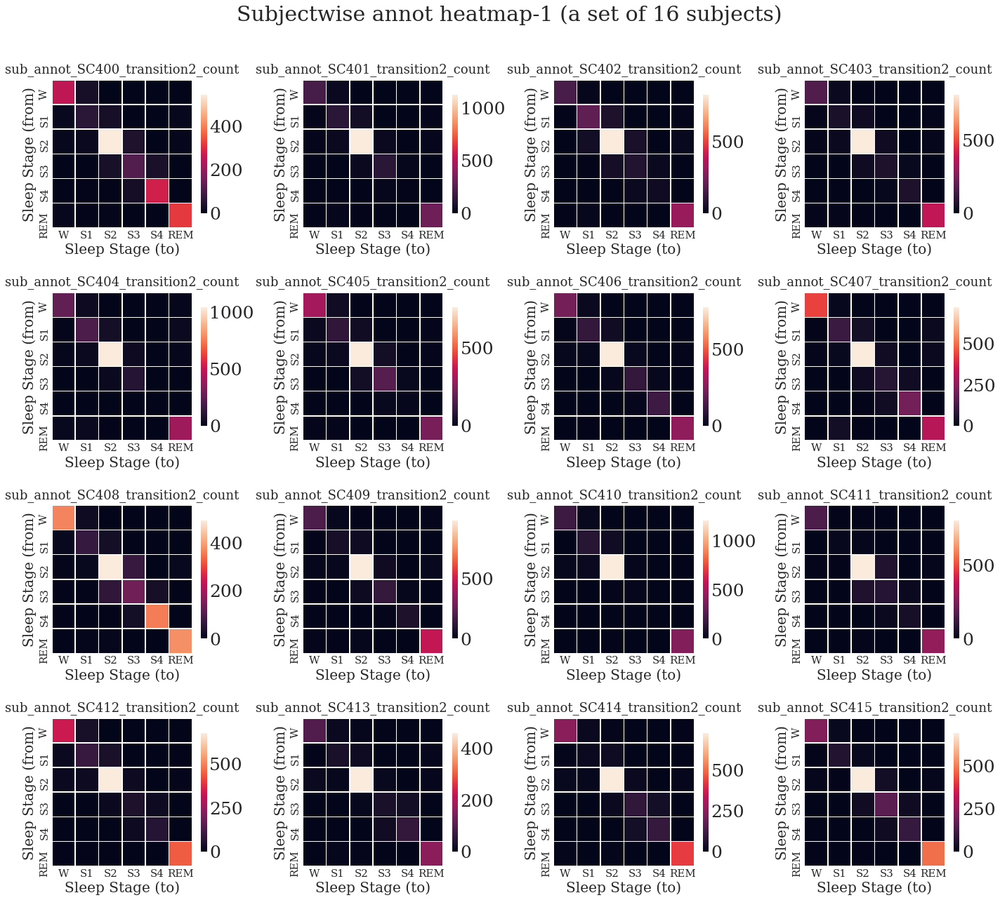

Drawing heatmap for index 16:32


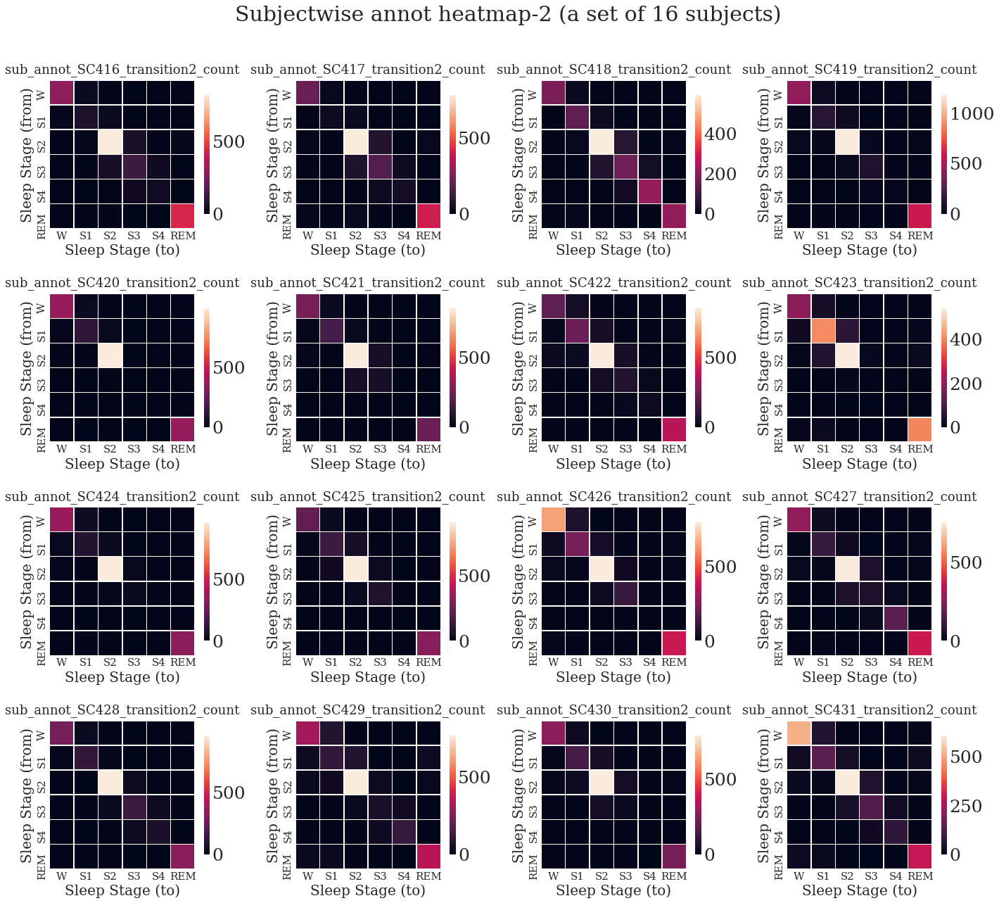

Drawing heatmap for index 32:48


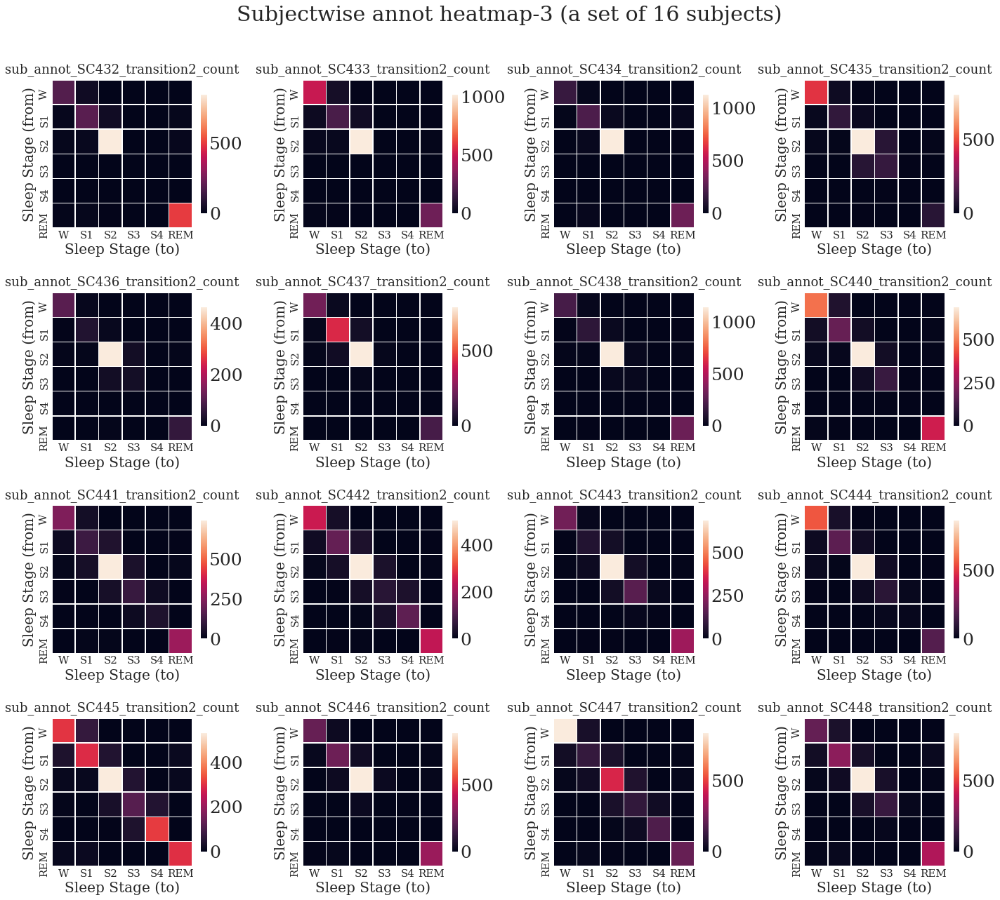

Drawing heatmap for index 48:64


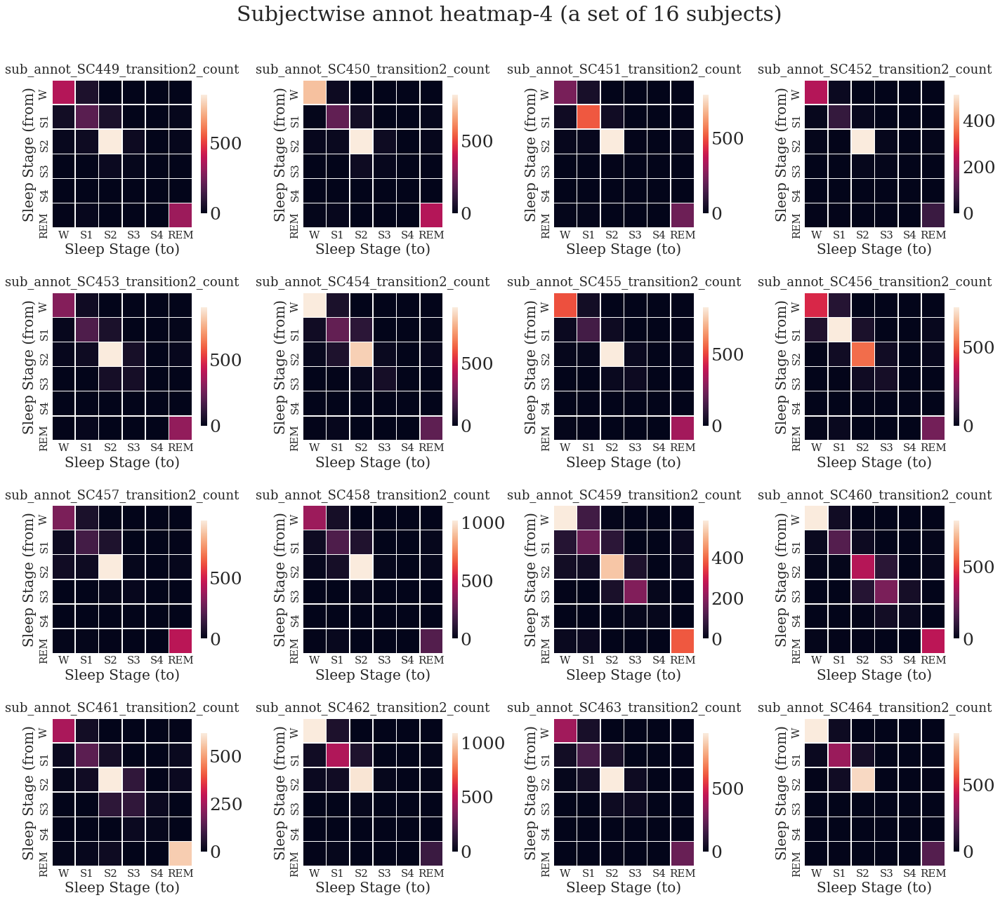

Drawing heatmap for index 64:80


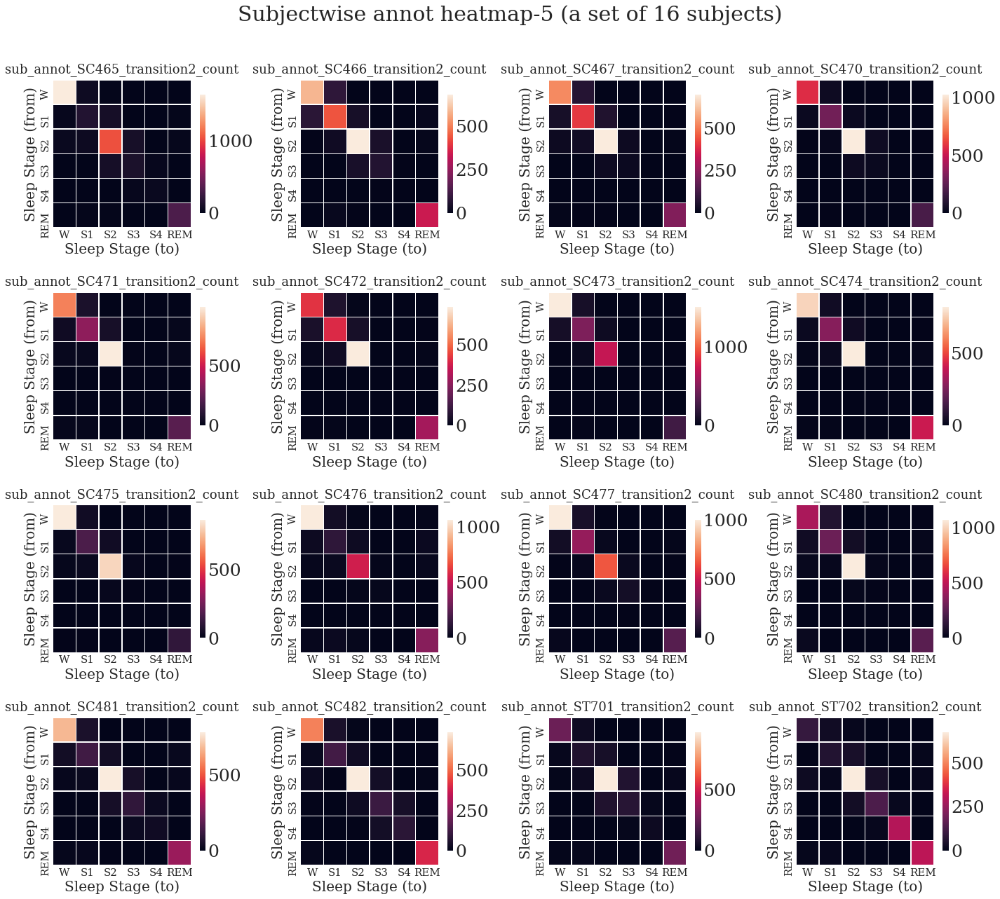

Drawing heatmap for index 80:96


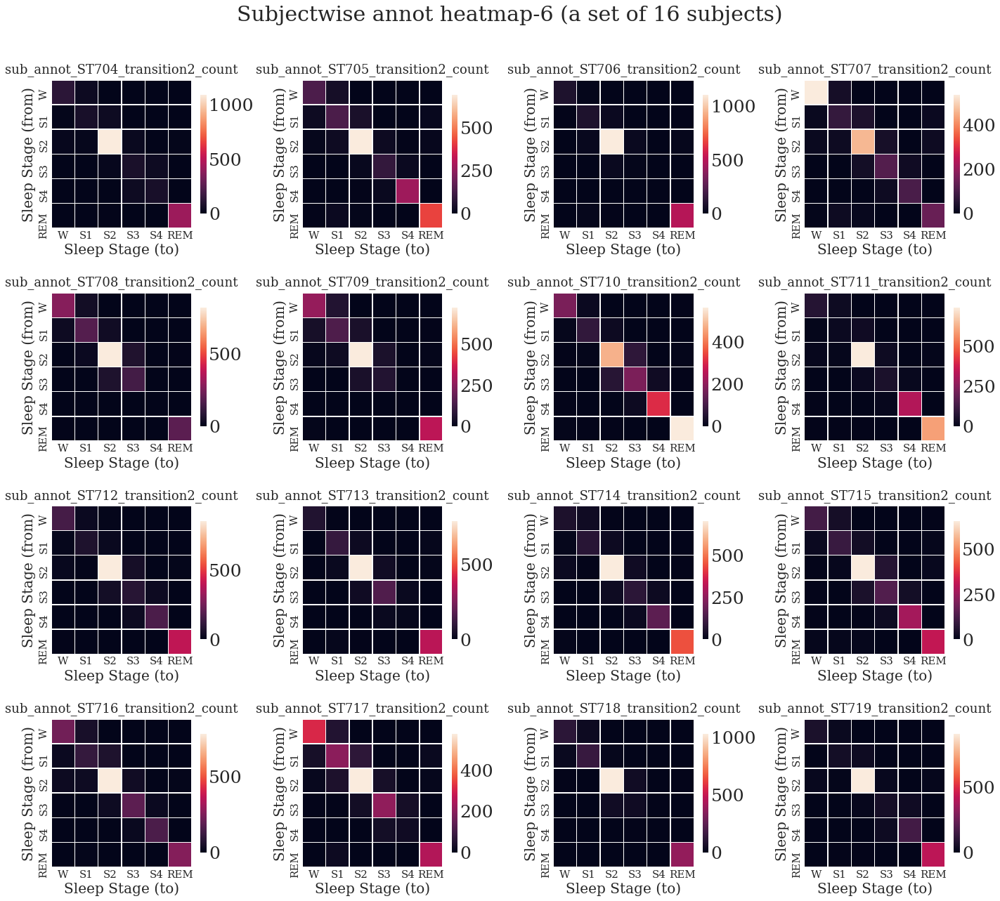

Drawing heatmap for index 96:100


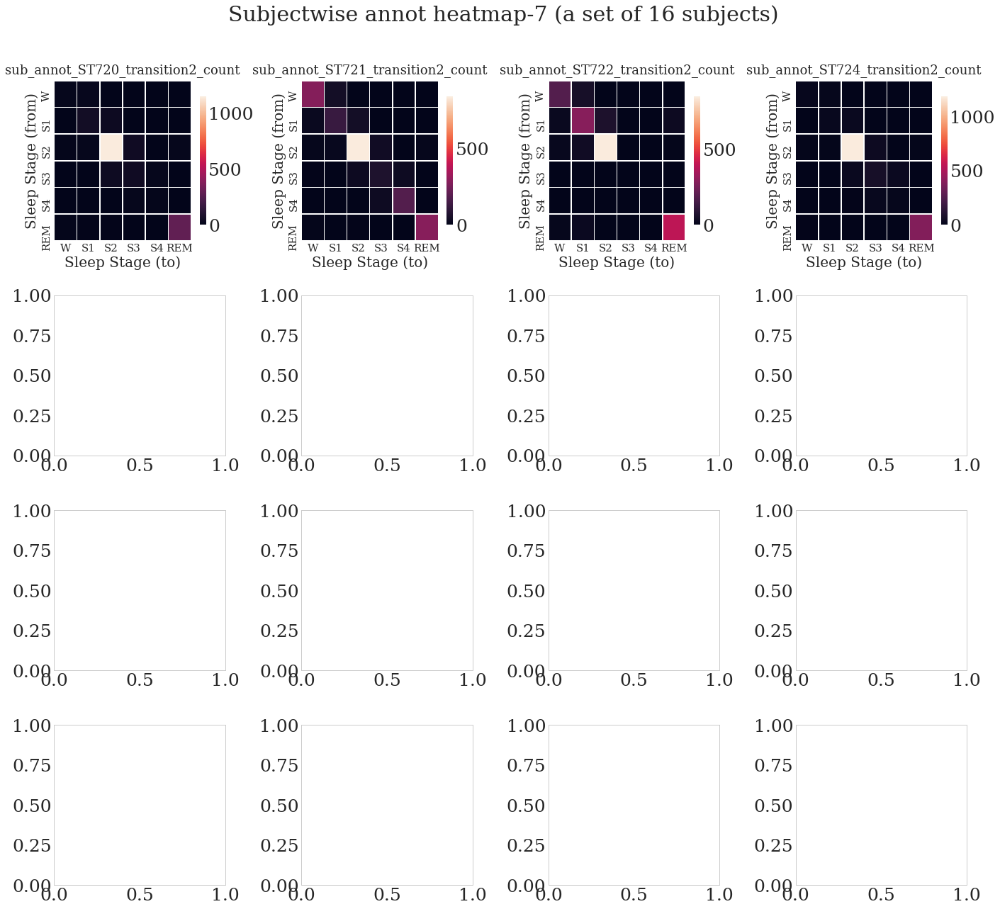

In [697]:
draw_all_heatmaps(all_metrix_files, cat="n", annot_type=annot_type)

#### Draw heatmap for transition matric (count) - tran

In [698]:
annot_type = "tran"
all_metrix_files = get_subjectwise_transition_count(annot_type = annot_type)
all_metrix_files

['annot', 'tran']
--- ['n']
['', '_sub', '_n']
['_transition2_count.csv', '_transition2_proba.csv', '_transition2_dura.csv']
./Results/Sleep_EDFX/STP_From_All_Stages/Transition_Matrices_TrimW/sub_tran
==========> ['_SC400', '_SC401', '_SC402', '_SC403', '_SC404', '_SC405', '_SC406', '_SC407', '_SC408', '_SC409', '_SC410', '_SC411', '_SC412', '_SC413', '_SC414', '_SC415', '_SC416', '_SC417', '_SC418', '_SC419', '_SC420', '_SC421', '_SC422', '_SC423', '_SC424', '_SC425', '_SC426', '_SC427', '_SC428', '_SC429', '_SC430', '_SC431', '_SC432', '_SC433', '_SC434', '_SC435', '_SC436', '_SC437', '_SC438', '_SC440', '_SC441', '_SC442', '_SC443', '_SC444', '_SC445', '_SC446', '_SC447', '_SC448', '_SC449', '_SC450', '_SC451', '_SC452', '_SC453', '_SC454', '_SC455', '_SC456', '_SC457', '_SC458', '_SC459', '_SC460', '_SC461', '_SC462', '_SC463', '_SC464', '_SC465', '_SC466', '_SC467', '_SC470', '_SC471', '_SC472', '_SC473', '_SC474', '_SC475', '_SC476', '_SC477', '_SC480', '_SC481', '_SC482', '_ST70

['./Results/Sleep_EDFX/STP_From_All_Stages/Transition_Matrices_TrimW/sub_tran_SC400_transition2_count.csv',
 './Results/Sleep_EDFX/STP_From_All_Stages/Transition_Matrices_TrimW/sub_tran_SC401_transition2_count.csv',
 './Results/Sleep_EDFX/STP_From_All_Stages/Transition_Matrices_TrimW/sub_tran_SC402_transition2_count.csv',
 './Results/Sleep_EDFX/STP_From_All_Stages/Transition_Matrices_TrimW/sub_tran_SC403_transition2_count.csv',
 './Results/Sleep_EDFX/STP_From_All_Stages/Transition_Matrices_TrimW/sub_tran_SC404_transition2_count.csv',
 './Results/Sleep_EDFX/STP_From_All_Stages/Transition_Matrices_TrimW/sub_tran_SC405_transition2_count.csv',
 './Results/Sleep_EDFX/STP_From_All_Stages/Transition_Matrices_TrimW/sub_tran_SC406_transition2_count.csv',
 './Results/Sleep_EDFX/STP_From_All_Stages/Transition_Matrices_TrimW/sub_tran_SC407_transition2_count.csv',
 './Results/Sleep_EDFX/STP_From_All_Stages/Transition_Matrices_TrimW/sub_tran_SC408_transition2_count.csv',
 './Results/Sleep_EDFX/STP_F

Drawing heatmap for index 0:16


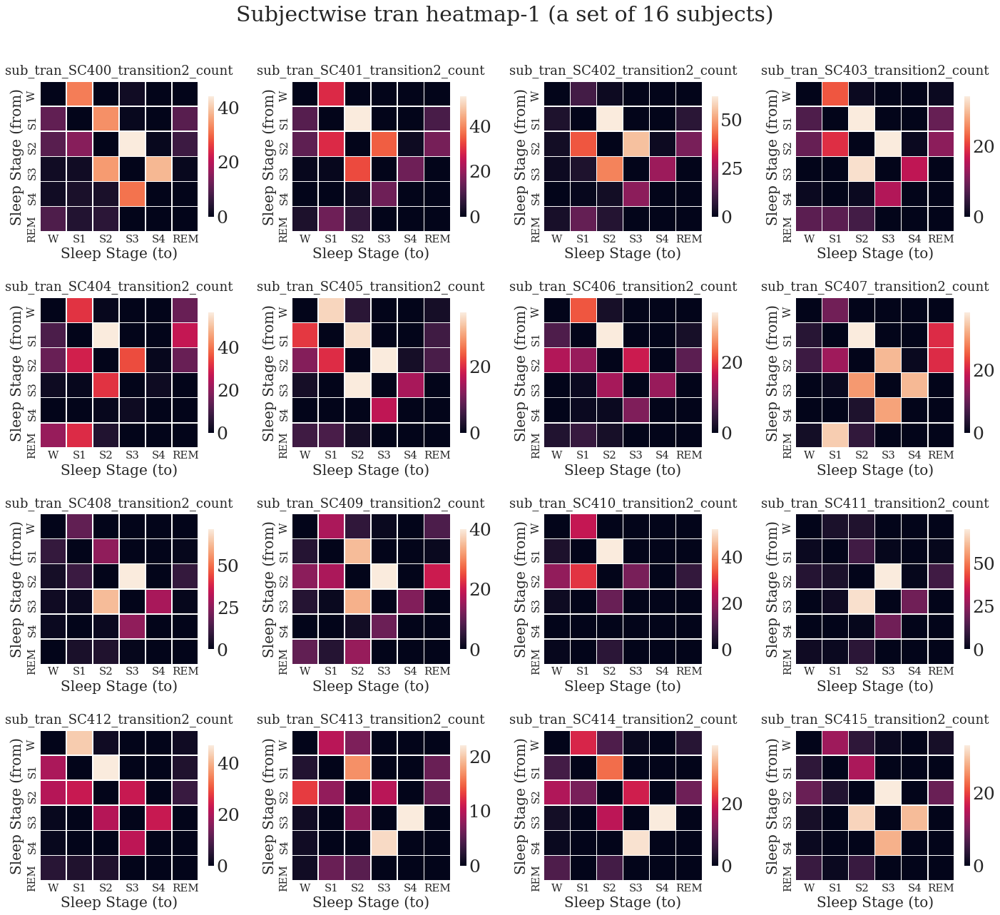

Drawing heatmap for index 16:32


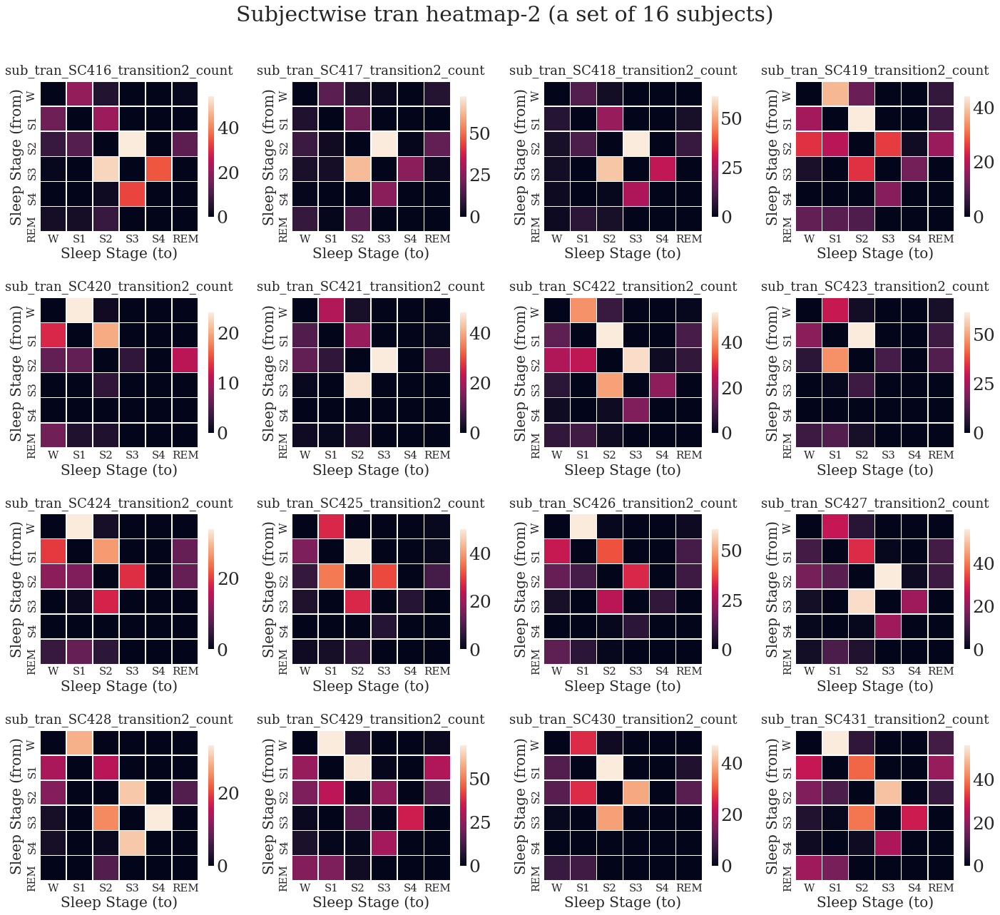

Drawing heatmap for index 32:48


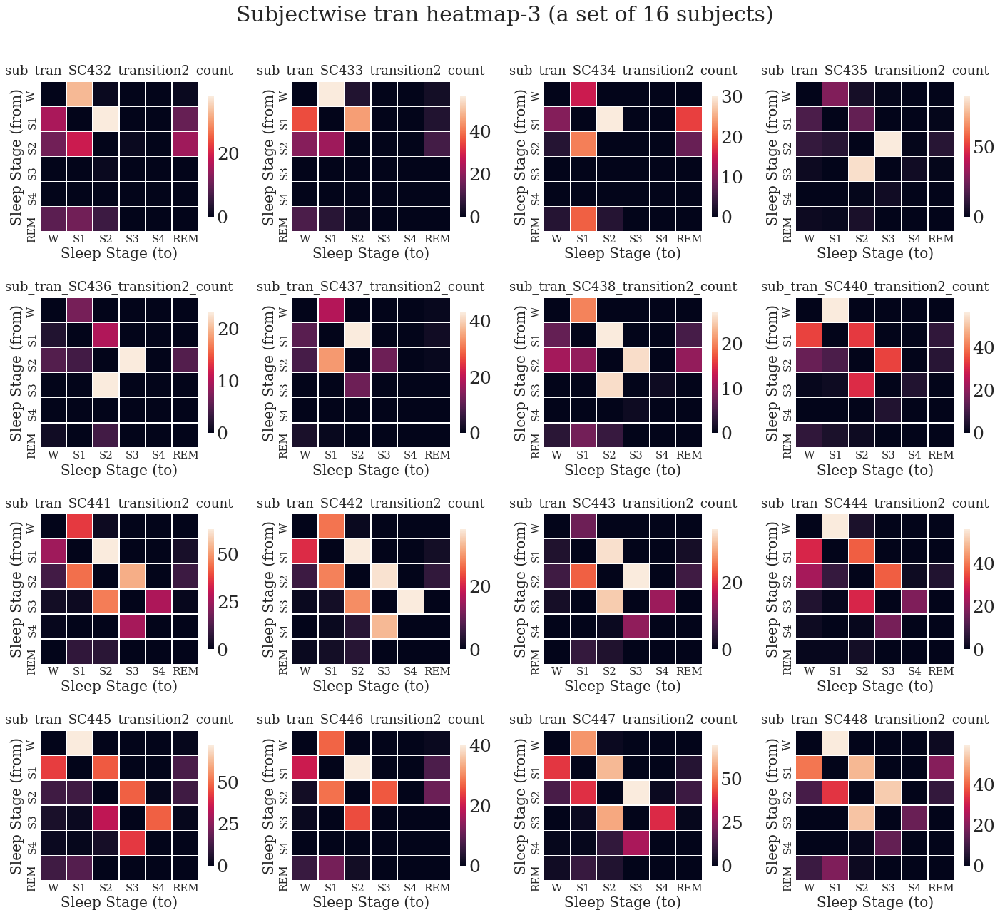

Drawing heatmap for index 48:64


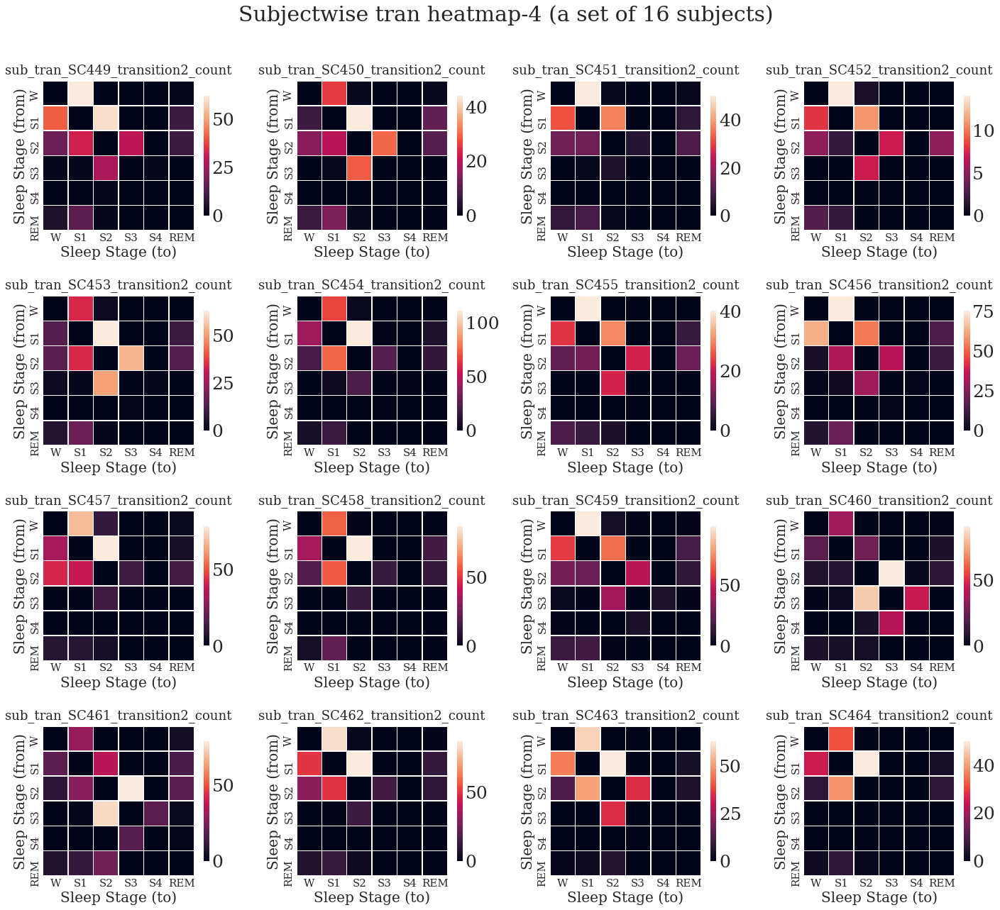

Drawing heatmap for index 64:80


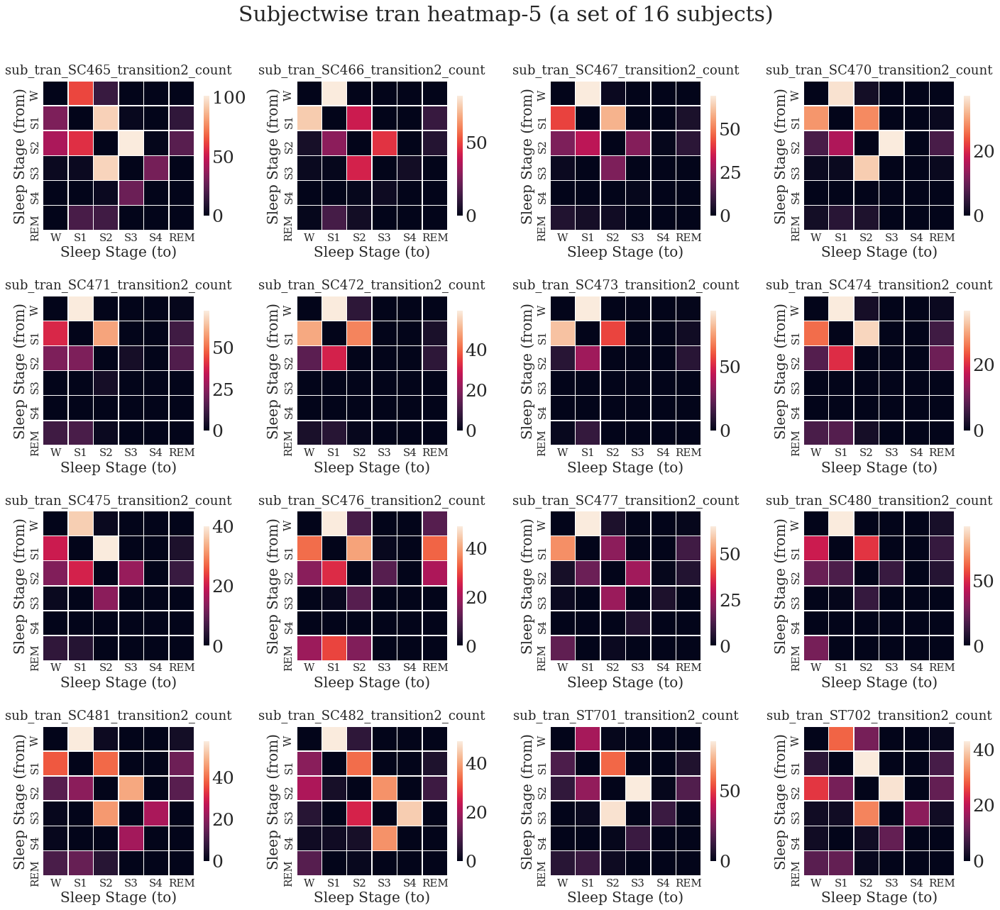

Drawing heatmap for index 80:96


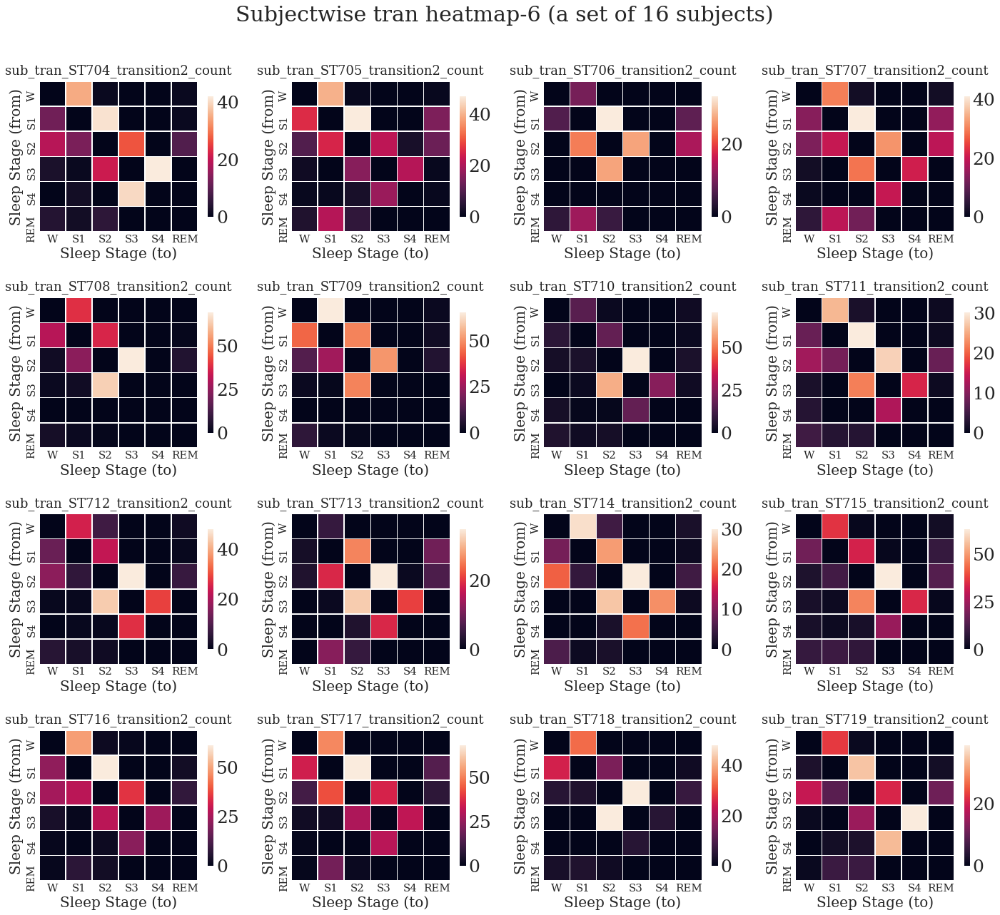

Drawing heatmap for index 96:100


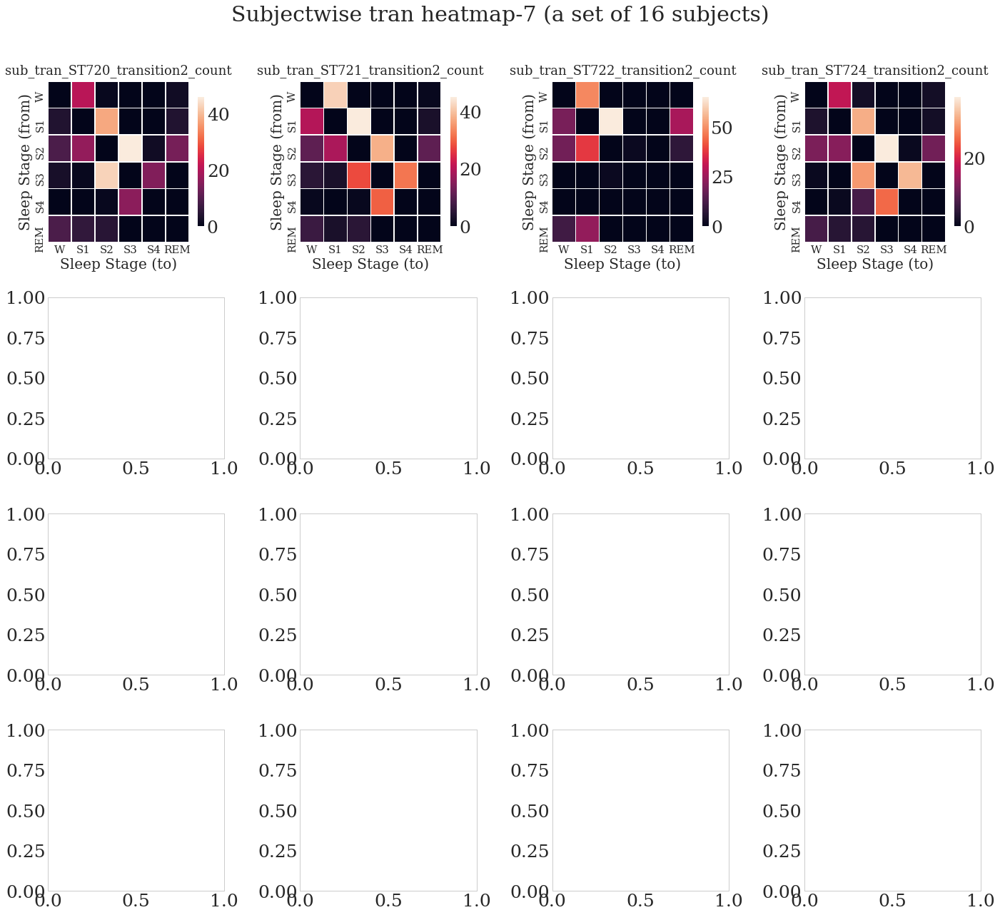

In [699]:
draw_all_heatmaps(all_metrix_files, cat="n", annot_type=annot_type)

# Extras

### Heatmap for transition matrix

In [753]:
def plot_heatmap_for_transition_matrix(metrix_files, hms): 
    fig, axes = plt.subplots(4, 4)
    slp_lbl = list(sleep_stage_labels_dict.keys())

    for i, dat_file in enumerate(metrix_files):
        dat = pd.read_csv(dat_file)
        # print(dat.iloc[:, 1:].dtypes)
        data = dat.iloc[:, 1:].values 
        slp_lbl_y = dat.iloc[:, 0].values 
        x, y = (int)(i/4), i%4 
        # print(i, x, y, data)
        sns.heatmap(data, linewidth=0.5, ax=axes[x, y])
        axes[x, y].set_title( (dat_file.split("/")[-1]).split(".")[0] )
        axes[x, y].set_ylabel("Sleep Stage (from)")
        axes[x, y].set_xlabel("Sleep Stage (to)")
        axes[x, y].set_yticklabels(slp_lbl_y)
        #axes[x, y].set_yticklabels(slp_lbl)
        axes[x, y].set_xticklabels(slp_lbl) 
    fig.suptitle(f"Subjectwise heatmap-{hms} (a set of 16 subjects)", va='top', fontsize=20, y=1.0) 
    fig.savefig(f"{result_directory}/Analytical_Graphs/n_subjectwise_heatmap-{hms}.png") 
    fig.savefig(f"{result_directory}/Analytical_Graphs/n_subjectwise_heatmap-{hms}.pdf") 
    plt.tight_layout(pad=2.0)
    plt.show()
    plt.close()
    plt.clf()

In [ ]:
ind_lst = list(range(len(all_metrix_files))) 
intr_ind_lst = ind_lst[::16]
intr_ind_lst

for i,ind in enumerate(intr_ind_lst): 
    lst_ind = intr_ind_lst[i+1] if ind!=intr_ind_lst[-1] else len(all_metrix_files)
    print(f"Drawing heatmap for index {ind}:{lst_ind}")
    plot_heatmap_for_transition_matrix(all_metrix_files[ind:lst_ind], i+1) 

### Markov model for transition matrix

In [ ]:
!pip install networkx
!pip install graphviz
# !pip install pygraphviz

In [ ]:
# modules from this repository
from markovchain import MarkovChain
plt.rcParams["figure.figsize"] = (25,20)

In [ ]:
all_metrix_files

In [ ]:
# plt.rcParams["figure.figsize"] = (20,6)
# plt.rcParams["figure.figsize"] = (5,4)
plt.rcParams["figure.figsize"] = (25,20)
list(sleep_stage_names_dict.keys()), list(sleep_stage_labels_dict.keys())

In [ ]:
# fig, axes = plt.subplots(4, 4)
# slp_lbl = list(sleep_stage_names_dict.keys())

# for i, dat_file in enumerate(all_metrix_files):
#     data = pd.read_csv(dat_file).values
#     x, y = (int)(i/4), i%4 
# #     print(i, x, y)
#     sns.heatmap(data, linewidth=0.5, ax=axes[x, y])
#     axes[x, y].set_title( (dat_file.split("/")[-1]).split(".")[0] )
#     axes[x, y].set_ylabel("Sleep Stage (from)")
#     axes[x, y].set_xlabel("Sleep Stage (to)")
#     axes[x, y].set_yticklabels(slp_lbl)
#     axes[x, y].set_xticklabels(slp_lbl) 
# fig.savefig(f"{result_directory}/Analytical_Graphs/n_subjectwise_heatmap.png") 
# fig.savefig(f"{result_directory}/Analytical_Graphs/n_subjectwise_heatmap.pdf") 
# plt.show()

In [ ]:
plt.rcParams["figure.figsize"] = (5,4)
# plt.rcParams["figure.figsize"] = (25,20)

In [ ]:
count_arr = pd.read_csv('./Results/Transition_Matrices/all_tran_sub_n1_transition_count.csv').values
count_arr

In [ ]:
mc = MarkovChain(count_arr, sleep_stage_labels) 
mc.draw("./all_annot_tDiagram_result_.png") 

In [ ]:
proba_arr = pd.read_csv('./Results/Transition_Matrices/all_tran_sub_n1_transition_proba.csv').values
proba_arr

In [ ]:
mc = MarkovChain(proba_arr, sleep_stage_labels) 
mc.draw("./all_annot_tDiagram_result_.png") 

### Visualise transition matrix - Network X

In [ ]:
import networkx as nx

# create state space and initial state probabilities

states = ['sleeping', 'eating', 'pooping']
pi = [0.35, 0.35, 0.3]
state_space = pd.Series(pi, index=states, name='states')
print(state_space)
print(state_space.sum())

In [ ]:
# create transition matrix
# equals transition probability matrix of changing states given a state
# matrix is size (M x M) where M is number of states

q_df = pd.DataFrame(columns=states, index=states)
q_df.loc[states[0]] = [0.4, 0.2, 0.4]
q_df.loc[states[1]] = [0.45, 0.45, 0.1]
q_df.loc[states[2]] = [0.45, 0.25, .3]

print(q_df)

q = q_df.values
print('\n', q, q.shape, '\n')
print(q_df.sum(axis=1))

In [ ]:
from pprint import pprint 

# create a function that maps transition probability dataframe 
# to markov edges and weights

def _get_markov_edges(Q):
    edges = {}
    for col in Q.columns:
        for idx in Q.index:
            edges[(idx,col)] = Q.loc[idx,col]
    return edges

edges_wts = _get_markov_edges(q_df)
pprint(edges_wts)

In [ ]:
# create graph object
G = nx.MultiDiGraph()

# nodes correspond to states
# G.add_nodes_from(states_)
G.add_nodes_from(edges_wts)
print(f'Nodes:\n{G.nodes()}\n')

# edges represent transition probabilities
for k, v in edges_wts.items():
    tmp_origin, tmp_destination = k[0], k[1]
    G.add_edge(tmp_origin, tmp_destination, weight=v, label=v)
print(f'Edges:')
pprint(G.edges(data=True))    

pos = nx.drawing.nx_pydot.graphviz_layout(G, prog='dot')
nx.draw_networkx(G, pos)

# create edge labels for jupyter plot but is not necessary
edge_labels = {(n1,n2):d['label'] for n1,n2,d in G.edges(data=True)}
nx.draw_networkx_edge_labels(G , pos, edge_labels=edge_labels)
nx.drawing.nx_pydot.write_dot(G, 'pet_dog_markov.dot')

In [ ]:
# plt.rcParams["figure.figsize"] = (25,20)

plt.rcParams["figure.figsize"] = (10,6)

In [ ]:
import networkx as nx

import matplotlib
matplotlib.use('Agg')
import matplotlib.pyplot as plt

def read_graph():
    graph_adjacency_list = { }
    for line in open("input.txt"):
        line = map(int, line.rstrip("\t\r\n").split("\t"))
        graph_adjacency_list.update({ line[0]: { e: 1 for e in line[1:] } })

    return graph_adjacency_list

graph_data = count_arr #read_graph()
G = nx.Graph(graph_data)
nx.draw_networkx(G, with_labels = True, node_color = "c", edge_color = "k", font_size = 8)

plt.axis('off')
plt.draw()
plt.savefig("graph.pdf")

In [ ]:
sleep_stage_labels_dict

In [ ]:
slp_stgs = list(sleep_stage_labels_dict.keys())
slp_stgs

In [ ]:
tst_arr = pd.read_csv('./Results/Transition_Matrices/all_tran_sub_n1_transition_count.csv')
tst_arr.index = slp_stgs
tst_arr

In [ ]:
tst_arr.at['W', 'S1']

In [ ]:
E = []
for i in slp_stgs:
    for j in slp_stgs:
        # print(tst_arr.at[i, j])
        if tst_arr.at[i, j]>0:
            E.append((i, j, tst_arr.at[i, j]))
        
E

In [ ]:
V = slp_stgs.copy()
V

In [ ]:
# E = [('A', 'B', 6), ('B', 'C', 7), ('C', 'D', 8), ('D','E', 4), ('E', 'F', 9), ('F','A', 6)]
E

In [ ]:
G =  nx.MultiDiGraph() 

In [ ]:
G.add_nodes_from(V)

In [ ]:
G.add_weighted_edges_from(E)

In [ ]:
G.nodes

In [ ]:
G.edges

In [ ]:
# G.__dict__
# nx.draw_networkx_edge_labels?

In [ ]:
pos = {'W':[1,1], 'S1':[2,2], 'S2':[3,1], 'S3':[3, 2], 'S4':[3,3], 'MT':[1,3], 'REM':[4,2]}

In [ ]:
weight = nx.get_edge_attributes(G, 'weight')
weight

In [ ]:
weight = {}
for u, v, keys, data in G.edges(keys=True, data=True):
    if 'weight' in data:
        if (u, v) in weight:
            weight[(u, v)].append(data['weight'])
        else:
            weight[(v, u)] = [data['weight']]
weight

In [ ]:
arc_size = 0.1

In [ ]:
nx.draw(G, pos=pos, with_labels=True, node_size=5000, node_color='r', edge_color='g', arrowsize=20, font_size=20, connectionstyle=f"arc3,rad={arc_size}")
# nx.draw_networkx_edge_labels(G, pos=nx.spring_layout(G), edge_labels=weight, font_size=15) #nx.spring_layout(G)
nx.draw_networkx_edge_labels(G, pos, edge_labels=weight, font_size=15) #nx.spring_layout(G)

In [ ]:
nx.draw_networkx_nodes?

In [ ]:
fig, ax = plt.subplots()
nx.draw_networkx_nodes(G, pos, ax=ax, node_size=5000, node_color='#ff0000')
nx.draw_networkx_labels(G, pos, ax=ax)
nx.draw_networkx_edges(G, pos, connectionstyle="arc3,rad=0.4") 

In [ ]:
nx.draw(G, pos=pos, with_labels=True,node_size=5000, node_color='r', edge_color='g', arrowsize=20, font_size=20)
# nx.draw_networkx_edge_labels(G, pos=nx.spring_layout(G), edge_labels=weight, font_size=15) #nx.spring_layout(G)
# nx.draw_networkx_edge_labels(G, pos, edge_labels=weight, font_size=15) #nx.spring_layout(G)


curved_edges = G.edges# [edge for edge in G.edges() if reversed(edge) in G.edges()]
# straight_edges = list(set(G.edges()) - set(curved_edges))
# nx.draw_networkx_edges(G, pos, ax=ax, edgelist=straight_edges)
arc_rad = 0.25
nx.draw_networkx_edges(G, pos, with_labels=True, connectionstyle="arc3,rad=0.4")

In [ ]:
G = nx.DiGraph()

pos = nx.spring_layout(G)
G.add_nodes_from([1, 2, 3, 4])
G.add_edges_from([(1, 2), (2, 4), (2, 3), (4, 1)])

nx.draw(G, with_labels=True, connectionstyle="arc3,rad=0.4")

plt.show()


In [ ]:
G = nx.DiGraph()
edge_list = [(1,2,{'w':'A1'}),(2,1,{'w':'A2'}),(2,3,{'w':'B'}),(3,1,{'w':'C'}),
             (3,4,{'w':'D1'}),(4,3,{'w':'D2'}),(1,5,{'w':'E1'}),(5,1,{'w':'E2'}),
             (3,5,{'w':'F'}),(5,4,{'w':'G'})]
G.add_edges_from(edge_list)
pos=nx.spring_layout(G,seed=5)
fig, ax = plt.subplots()
nx.draw_networkx_nodes(G, pos, ax=ax)
nx.draw_networkx_labels(G, pos, ax=ax)
fig.savefig("1.png", bbox_inches='tight',pad_inches=0)

In [ ]:
G = nx.DiGraph()
edge_list = [(1,2,{'w':'A1'}),(2,1,{'w':'A2'}),(2,3,{'w':'B'}),(3,1,{'w':'C'}),
             (3,4,{'w':'D1'}),(4,3,{'w':'D2'}),(1,5,{'w':'E1'}),(5,1,{'w':'E2'}),
             (3,5,{'w':'F'}),(5,4,{'w':'G'})]
G.add_edges_from(edge_list)
pos=nx.spring_layout(G,seed=5)
fig, ax = plt.subplots()
nx.draw_networkx_nodes(G, pos, ax=ax)
nx.draw_networkx_labels(G, pos, ax=ax)

curved_edges = [edge for edge in G.edges() if reversed(edge) in G.edges()]
straight_edges = list(set(G.edges()) - set(curved_edges))
nx.draw_networkx_edges(G, pos, ax=ax, edgelist=straight_edges)
arc_rad = 0.25
nx.draw_networkx_edges(G, pos, ax=ax, edgelist=curved_edges, connectionstyle=f'arc3, rad = {arc_rad}')
fig.savefig("2.png", bbox_inches='tight',pad_inches=0)

### Visualise transition matrix - Example

In [ ]:
!pip install networkx
!pip install graphviz
# !pip install pygraphviz

In [ ]:
# !pip install networkx
# !pip install graphviz
# !pip install pygraphviz

# modules from this repository
from markovchain import MarkovChain

In [ ]:
directory, result_directory

In [ ]:
trans_file_path = f"{result_directory}/Transition_Matrices/all_annot_transition{tran_step}"
count, proba, dura = pd.read_csv(f"{trans_file_path}_count.csv"), pd.read_csv(f"{trans_file_path}_proba.csv"), pd.read_csv(f"{trans_file_path}_dura.csv") 


In [ ]:
proba

In [ ]:
sleep_stage_labels

In [ ]:
proba_arr = proba.iloc[:, 1:].values
# count_arr = proba.values
proba_arr

In [ ]:
mc = MarkovChain(proba_arr, sleep_stage_labels)
mc.draw(f"{result_directory}/all_annot_tDiagram.png")

In [ ]:
trans_file_path = f"{result_directory}/Transition_Matrices/all_tran_transition{tran_step}"
count2, proba2, dura2 = pd.read_csv(f"{trans_file_path}_count.csv"), pd.read_csv(f"{trans_file_path}_proba.csv"), pd.read_csv(f"{trans_file_path}_dura.csv") 


In [ ]:
proba2

In [ ]:
sleep_stage_labels

In [ ]:
proba_arr2 = proba2.iloc[:, 1:].values
# proba_arr2 = proba2.values
proba_arr2

In [ ]:
mc = MarkovChain(proba_arr2, sleep_stage_labels)
mc.draw("./all_tran_tDiagram_result_.png")

In [ ]:
P = np.array([[0.8, 0.2], [0.1, 0.9]]) # Transition matrix
mc = MarkovChain(P, ['1', '2'])
mc.draw("./markov-chain-two-states.png")
# mc.draw("./markov-chain-two-states.pdf")

In [ ]:
P = np.array([
    [0.8, 0.1, 0.1, 0.0], 
    [0.1, 0.7, 0.0, 0.2],
    [0.1, 0.0, 0.7, 0.2],
    [0.1, 0.0, 0.7, 0.2]
])
mc = MarkovChain(P, ['1', '2', '3', '4'])
mc.draw("./markov-chain-four-states.png")

In [ ]:
P = np.array([
    [0.7, 0.1, 0.1, 0.0, 0.0, 0.1], 
    [0.1, 0.4, 0.0, 0.2, 0.1, 0.2],
    [0.1, 0.0, 0.5, 0.2, 0.0, 0.2],
    [0.1, 0.0, 0.4, 0.2, 0.3, 0.0],
    [0.6, 0.1, 0.1, 0.0, 0.2, 0.0], 
    [0.6, 0.1, 0.1, 0.0, 0.2, 0.0], 
])
mc = MarkovChain(P, ['1', '2', '3', '4', '5', '6'])
mc.draw("./markov-chain-six-states.png")

In [ ]:
P = np.array([
    [0.7, 0.1, 0.1, 0.0, 0.0, 0.1, 0.6], 
    [0.1, 0.4, 0.0, 0.2, 0.1, 0.2, 0.2],
    [0.1, 0.0, 0.5, 0.2, 0.0, 0.2, 0.8],
    [0.1, 0.0, 0.4, 0.2, 0.3, 0.0, 0.5],
    [0.6, 0.1, 0.1, 0.0, 0.2, 0.0, 0.4], 
    [0.6, 0.1, 0.1, 0.0, 0.2, 0.0, 0.0], 
    [0.2, 0.5, 0.6, 0.3, 0.0, 0.1, 0.3], 
])
mc = MarkovChain(P, ['1', '2', '3', '4', '5', '6', '7'])
mc.draw("./markov-chain-seven-states.png")

## Rough

In [55]:
directory = dataset_directory
directory

'E:/aliem/Sleep_EDFX_Dataset'

In [56]:
demo_files = get_list_of_paths_from_a_directory(directory, path_type=None, containes="subjects", extension="csv", exclude=exclude_contents_in_dataset_directory) 

demo_files

============> *subjects*.csv, None, E:/aliem/Sleep_EDFX_Dataset/*subjects*.csv


['E:/aliem/Sleep_EDFX_Dataset/SC-subjects.csv',
 'E:/aliem/Sleep_EDFX_Dataset/ST-subjects.csv']

In [68]:
list_of_edfs[:5]

['E:/aliem/Sleep_EDFX_Dataset/sleep-cassette/SC4001E0-PSG.edf',
 'E:/aliem/Sleep_EDFX_Dataset/sleep-cassette/SC4002E0-PSG.edf',
 'E:/aliem/Sleep_EDFX_Dataset/sleep-cassette/SC4011E0-PSG.edf',
 'E:/aliem/Sleep_EDFX_Dataset/sleep-cassette/SC4012E0-PSG.edf',
 'E:/aliem/Sleep_EDFX_Dataset/sleep-cassette/SC4021E0-PSG.edf']

In [60]:
list_of_annot_edfs[:5]

['E:/aliem/Sleep_EDFX_Dataset/sleep-cassette/SC4001EC-Hypnogram.edf',
 'E:/aliem/Sleep_EDFX_Dataset/sleep-cassette/SC4002EC-Hypnogram.edf',
 'E:/aliem/Sleep_EDFX_Dataset/sleep-cassette/SC4011EH-Hypnogram.edf',
 'E:/aliem/Sleep_EDFX_Dataset/sleep-cassette/SC4012EC-Hypnogram.edf',
 'E:/aliem/Sleep_EDFX_Dataset/sleep-cassette/SC4021EH-Hypnogram.edf']

In [72]:
file_name_list = [f.split("/")[-1][:6] for f in list_of_annot_edfs]
file_name_list[:5]

['SC4001', 'SC4002', 'SC4011', 'SC4012', 'SC4021']

In [178]:
demo_df1 = pd.read_csv(demo_files[0])
demo_df1

,subject,night,age,sex (F=1),LightsOff
0,0,1,33,1,0:38
1,0,2,33,1,21:57
2,1,1,33,1,22:44
3,1,2,33,1,22:15
4,2,1,26,1,22:50
...,...,...,...,...,...
148,80,2,54,1,23:18
149,81,1,57,1,22:00
150,81,2,57,1,21:56
151,82,1,56,1,23:59


In [179]:
demo_df2 = pd.read_csv(demo_files[1])
demo_df2

,Subject - age - sex,Unnamed: 1,Unnamed: 2,Placebo night,Unnamed: 4,Temazepam night,Unnamed: 6
0,Nr,Age,M1/F2,night nr,lights off,night nr,lights off
1,1,60,1,1,23:01,2,23:48
2,2,35,2,2,23:27,1,0:00
3,4,18,2,1,23:53,2,22:37
4,5,32,2,2,23:23,1,23:34
5,6,35,2,1,23:28,2,23:26
6,7,51,2,1,0:02,2,23:24
7,8,66,2,2,23:20,1,23:53
8,9,47,1,2,0:30,1,23:42
9,10,20,2,1,23:21,2,23:28


In [180]:
demo_df2 = demo_df2.iloc[1:23, :]
demo_df2

,Subject - age - sex,Unnamed: 1,Unnamed: 2,Placebo night,Unnamed: 4,Temazepam night,Unnamed: 6
1,1,60,1,1,23:01,2,23:48
2,2,35,2,2,23:27,1,0:00
3,4,18,2,1,23:53,2,22:37
4,5,32,2,2,23:23,1,23:34
5,6,35,2,1,23:28,2,23:26
6,7,51,2,1,0:02,2,23:24
7,8,66,2,2,23:20,1,23:53
8,9,47,1,2,0:30,1,23:42
9,10,20,2,1,23:21,2,23:28
10,11,21,2,2,23:52,1,23:38


In [181]:
demo_df3 = demo_df1.copy() 
demo_df3['Age'] = demo_df3['age']
demo_df3

,subject,night,age,sex (F=1),LightsOff,Age
0,0,1,33,1,0:38,33
1,0,2,33,1,21:57,33
2,1,1,33,1,22:44,33
3,1,2,33,1,22:15,33
4,2,1,26,1,22:50,26
...,...,...,...,...,...,...
148,80,2,54,1,23:18,54
149,81,1,57,1,22:00,57
150,81,2,57,1,21:56,57
151,82,1,56,1,23:59,56


In [182]:
demo_df3 = demo_df3.drop(columns=['night', 'age', 'LightsOff'])
demo_df3.columns = ['Subject_ID', 'Gender', 'Age']
demo_df3 = demo_df3.replace({'Gender': {1: 'F', 2: 'M'}})
demo_df3

,Subject_ID,Gender,Age
0,0,F,33
1,0,F,33
2,1,F,33
3,1,F,33
4,2,F,26
...,...,...,...
148,80,F,54
149,81,F,57
150,81,F,57
151,82,F,56


In [198]:
demo_df4 = demo_df2.copy()
demo_df4['Age'] = demo_df4['Unnamed: 1']
demo_df4 = demo_df4.drop(columns=['Placebo night', 'Unnamed: 1', 'Unnamed: 4', 'Temazepam night', 'Unnamed: 6'])
demo_df4.columns = ['Subject_ID', 'Gender', 'Age']
demo_df4 = demo_df4.astype({'Subject_ID': int, 'Age': int, 'Gender': int})
demo_df4
demo_df4 = demo_df4.replace({'Gender': {1: 'F', 2: 'M'}}) 
demo_df4
# demo_df4.replace({'Gender': {1: 'F', 2: 'M'}})

,Subject_ID,Gender,Age
1,1,F,60
2,2,M,35
3,4,M,18
4,5,M,32
5,6,M,35
6,7,M,51
7,8,M,66
8,9,F,47
9,10,M,20
10,11,M,21


In [199]:
# it has two records side by side in 'Temazepam night', 'Unnamed: 6' that we removed
demo_df6 = pd.DataFrame(np.repeat(demo_df4.values, 2, axis=0))
demo_df6.columns = demo_df4.columns
demo_df6

,Subject_ID,Gender,Age
0,1,F,60
1,1,F,60
2,2,M,35
3,2,M,35
4,4,M,18
5,4,M,18
6,5,M,32
7,5,M,32
8,6,M,35
9,6,M,35


In [200]:
demo_df3.reset_index(drop=True, inplace=True)
demo_df6.reset_index(drop=True, inplace=True)
demo_df7 = pd.concat([demo_df3, demo_df6], axis=0)
demo_df7

,Subject_ID,Gender,Age
0,0,F,33
1,0,F,33
2,1,F,33
3,1,F,33
4,2,F,26
...,...,...,...
39,21,M,34
40,22,F,56
41,22,F,56
42,24,M,48


In [201]:
len(file_name_list)

197

In [202]:
demo_df8 = demo_df7.copy()
demo_df8.insert(0, "File_Name", file_name_list, True)
demo_df8.insert(1, "Category", ['n']*demo_df7.shape[0], True)
demo_df8

,File_Name,Category,Subject_ID,Gender,Age
0,SC4001,n,0,F,33
1,SC4002,n,0,F,33
2,SC4011,n,1,F,33
3,SC4012,n,1,F,33
4,SC4021,n,2,F,26
...,...,...,...,...,...
39,ST7212,n,21,M,34
40,ST7221,n,22,F,56
41,ST7222,n,22,F,56
42,ST7241,n,24,M,48


In [203]:
demo_df8 = demo_df8.astype({'Subject_ID': int, 'Age': int})
demo_df8

,File_Name,Category,Subject_ID,Gender,Age
0,SC4001,n,0,F,33
1,SC4002,n,0,F,33
2,SC4011,n,1,F,33
3,SC4012,n,1,F,33
4,SC4021,n,2,F,26
...,...,...,...,...,...
39,ST7212,n,21,M,34
40,ST7221,n,22,F,56
41,ST7222,n,22,F,56
42,ST7241,n,24,M,48


In [204]:
directory = result_directory
directory

'./Results/Sleep_EDFX'

In [205]:
demo_df8.to_csv(f"{directory}/Demography_Details.csv", index=False)

In [209]:
demo_df8[(demo_df8['Gender']=='M')]
demo_df8[(demo_df8['Gender']=='F')]

,File_Name,Category,Subject_ID,Gender,Age
0,SC4001,n,0,F,33
1,SC4002,n,0,F,33
2,SC4011,n,1,F,33
3,SC4012,n,1,F,33
4,SC4021,n,2,F,26
...,...,...,...,...,...
25,ST7142,n,14,F,20
36,ST7201,n,20,F,24
37,ST7202,n,20,F,24
40,ST7221,n,22,F,56


In [210]:
np.min(demo_df8[['Age']].values), np.max(demo_df8[['Age']].values)

(18, 101)

In [212]:
np.min(demo_df8[(demo_df8['Gender']=='M')][['Age']].values), np.max(demo_df8[(demo_df8['Gender']=='M')][['Age']].values)

(18, 97)

In [213]:
np.min(demo_df8[(demo_df8['Gender']=='F')][['Age']].values), np.max(demo_df8[(demo_df8['Gender']=='F')][['Age']].values)

(20, 101)

In [145]:
demo_df8

,File_Name,Category,Subject_ID,Gender,Age
0,SC4001,n,0,F,33
1,SC4002,n,0,F,33
2,SC4011,n,1,F,33
3,SC4012,n,1,F,33
4,SC4021,n,2,F,26
...,...,...,...,...,...
39,ST7212,n,21,2,34
40,ST7221,n,22,1,56
41,ST7222,n,22,1,56
42,ST7241,n,24,2,48


In [223]:
tm = demo_df8[(demo_df8['File_Name'].str.startswith('SC', na=False))]
tm

,File_Name,Category,Subject_ID,Gender,Age
0,SC4001,n,0,F,33
1,SC4002,n,0,F,33
2,SC4011,n,1,F,33
3,SC4012,n,1,F,33
4,SC4021,n,2,F,26
...,...,...,...,...,...
148,SC4802,n,80,F,54
149,SC4811,n,81,F,57
150,SC4812,n,81,F,57
151,SC4821,n,82,F,56


In [217]:
np.min(tm[['Age']].values), np.max(tm[['Age']].values)

(25, 101)

In [228]:
ttm = tm[(tm['Gender']=='M')]
ttm
ttm.shape[0]
np.min(ttm[['Age']].values), np.max(ttm[['Age']].values)

ttm = tm[(tm['Gender']=='F')]
ttm
ttm.shape[0]
np.min(ttm[['Age']].values), np.max(ttm[['Age']].values)

(25, 101)

In [229]:
tm = demo_df8[(demo_df8['File_Name'].str.startswith('ST', na=False))]
tm

,File_Name,Category,Subject_ID,Gender,Age
0,ST7011,n,1,F,60
1,ST7012,n,1,F,60
2,ST7021,n,2,M,35
3,ST7022,n,2,M,35
4,ST7041,n,4,M,18
5,ST7042,n,4,M,18
6,ST7051,n,5,M,32
7,ST7052,n,5,M,32
8,ST7061,n,6,M,35
9,ST7062,n,6,M,35


In [230]:
np.min(tm[['Age']].values), np.max(tm[['Age']].values)

(18, 79)

In [234]:
ttm = tm[(tm['Gender']=='M')]
ttm
ttm.shape[0]
np.min(ttm[['Age']].values), np.max(ttm[['Age']].values)

ttm = tm[(tm['Gender']=='F')]
ttm
ttm.shape[0]
np.min(ttm[['Age']].values), np.max(ttm[['Age']].values)

(20, 60)